In [1]:
import numpy as np
import pandas as pd
import string
from time import time

directions = [(-1, -1), (-1, 0), (-1, 1), (0, -1), (0, 1), (1, -1),  (1, 0), (1, 1)]

class TrieNode:
    def __init__(self):
        self.children = {}
        self.is_word = False

class Trie:
    def __init__(self):
        self.root = TrieNode()

    def insert(self, word):
        node = self.root
        for char in word:
            if char not in node.children:
                node.children[char] = TrieNode()
            node = node.children[char]
        node.is_word = True

    def search(self, word):
        node = self.root
        for char in word:
            if char not in node.children:
                return False
            node = node.children[char]
        return node.is_word

    def starts_with(self, prefix):
        node = self.root
        for char in prefix:
            if char not in node.children:
                return False
            node = node.children[char]
        return True

trie = Trie()
with open('dictionary_actual_game.txt', 'r') as file:
    for word in file.read().splitlines():
        trie.insert(word)
        
keys = list(string.ascii_lowercase)
score = [1,3,3,2,1,4,2,4,3,8,5,5,3,2,1,3,10,1,1,1,2,4,4,8,4,10]
letter_to_int = dict(zip(keys, range(1, 27)))
letter_to_int["N"] = 0

dictionary_df = pd.read_csv("dictionary_df2.csv")
dictionary_df.loc[160413, "word"] = "null"
dictionary_df.loc[154353, "word"] = "nan"
dictionary_df = dictionary_df[dictionary_df.columns[1:]]
score_dict = dict(zip(dictionary_df["word"], dictionary_df["score"]))

def tiles_remove(tiles, board):
    board[tiles[:, 0], tiles[:, 1]] = "N"
    return board

def gravity(board_1):
    # Gravity down
    row_index, col_index = np.where(board_1 == "N")
    indices = list(zip(row_index, col_index))
    for r, c in indices:
        column = board_1[:r + 1, c].copy()
        if r > 0:
            column[1:] = column[:-1]
            column[0] = "N"
        board_1[:r + 1, c] = column
    # Gravity right
    row_index, col_index = np.where(board_1 == "N")
    indices = list(zip(row_index, col_index))
    for r, c in indices:
        row = board_1[r, :c + 1].copy()
        if c > 0:
            row[1:] = row[:-1]
            row[0] = "N"
        board_1[r, :c + 1] = row
    return board_1

class WordSoup_state:
    def __init__(self, board, S=0, word_lst=[], depth=0):
        self.board = board
        self.score = S
        self.word_lst = word_lst
        self.depth = depth
        self.board_array = np.array(board)

    def get_legal_actions(self):
        rows, cols = len(self.board), len(self.board[0])
        result = []

        def dfs(i, j, path, indices, visited, node):
            if node.is_word:
                result.append((path, indices))  # Store the word and its indices
            for dx, dy in directions:
                x, y = i + dx, j + dy
                if 0 <= x < rows and 0 <= y < cols and (x, y) not in visited:
                    char = self.board[x][y]
                    if char in node.children:
                        visited.add((x, y))
                        dfs(x, y, path + char, indices + [(x, y)], visited, node.children[char])
                        visited.remove((x, y))

        for i in range(rows):
            for j in range(cols):
                char = self.board[i][j]
                if char in trie.root.children:
                    dfs(i, j, char, [(i, j)], {(i, j)}, trie.root.children[char])

        return result

    def is_game_over(self):
        found_words = self.get_legal_actions()
        if len(found_words) > 0:
            return False
        return True

    def game_result(self, Score):
        if self.score >= Score:
            return 1
        return -1

    def move(self, action):
        word, indices = action
        _ = tiles_remove(np.array(indices), self.board_array.copy())
        new_board = gravity(_)
        new_score = self.score + score_dict[word]
        if np.sum(new_board != "N") == 0:
            new_score += 500
        new_board = new_board.tolist()
        new_word_lst = self.word_lst.copy()
        new_word_lst.append(word)

        return WordSoup_state(new_board, new_score, new_word_lst, self.depth+1)

In [2]:
def ExhaustiveSearch(state, step=1):
    L = 0
    for l in state.board:
        for i in l:
            L+=1
    untried_actions = state.get_legal_actions()
    untried_actions_sorted = sorted(untried_actions, key=lambda x: score_dict[x[0]], reverse=True)
    best_score_so_far = score_dict[untried_actions_sorted[0][0]]
    best_ = []
    for action in untried_actions_sorted:
        if score_dict[action[0]]==best_score_so_far:
            best_.append(action)
        else:
            break
    result = [state.move(action) for action in best_]
    if step == 1:
        return result
    else:
        queue = [state.move(action) for action in untried_actions_sorted]
        best = []
    
    while queue:
        state = queue.pop(0)
        y = best_score_so_far - state.score
        untried_actions = state.get_legal_actions()
        if len(untried_actions) == 0:
            continue
        length = 0
        for l in state.board:
            for i in l:
                if i != "N":
                    break
                length+=1
        
        def Score_Cal(x):
            if len(x[0])==(L-length):
                return score_dict[x[0]]+500
            else:
                return score_dict[x[0]]
        untried_actions_sorted = sorted(untried_actions, key=lambda x: Score_Cal(x), reverse=True)
        s_ = Score_Cal(untried_actions_sorted[0])
        if s_ > y:
            best_score_so_far = state.score + s_
            best = []
            for x in untried_actions_sorted:
                if Score_Cal(x)==s_:
                    best.append((state, x))
                else:
                    break
        if state.depth < step - 1:
            _ = [state.move(action) for action in untried_actions_sorted]
            if _:
                queue = _ + queue
            else:
                continue
    if best:
        result = [state.move(action) for state, action in best]
    return result

In [4]:
B_lst = []
filenames_lst = [f"game_0{i}_grid.txt" for i in range(1, 10)]
filenames_lst.append("game_10_grid.txt")
for filename in filenames_lst:
    with open("../sample_human_games/"+filename, "r") as file:
        B_lst.append(file.read().lower().splitlines())
_ = [[list(b) for b in B] for B in B_lst]
state_lst = [WordSoup_state(b) for b in _]

In [13]:
%%time
Best_result0 = []
n = 1
for initial_state in state_lst:
    print(f"Sample Board{n}:")
    R = []
    t0 = time()
    depth = 1
    queue = ExhaustiveSearch(initial_state, step=depth)
    t1 = time()
    print(f"Horizon: {depth},\nWords chosen: {[s.word_lst for s in queue]},\nScore: {[s.score for s in queue]},\nTime: {t1-t0} s")

    while queue:
        t0 = time()
        state = queue.pop(0)
        if state.is_game_over():
            R.append((state.word_lst, state.score))
            continue
        else:
            selected_lst = ExhaustiveSearch(state, step=1)
            queue = selected_lst + queue
            t1 = time()
            print(f"Horizon: {depth-1},\nWords chosen: {[s.word_lst for s in selected_lst]},\nScore: {[s.score for s in selected_lst]},\nTime: {t1-t0} s")
    Best_result0.append(sorted(R, key=lambda x: x[1], reverse=True)[0])
    n+=1

Sample Board1:
Horizon: 1,
Words chosen: [['mijnheer']],
Score: [184],
Time: 0.044339895248413086 s
Horizon: 0,
Words chosen: [['mijnheer', 'humorists'], ['mijnheer', 'humorists']],
Score: [337, 337],
Time: 0.05646014213562012 s
Horizon: 0,
Words chosen: [['mijnheer', 'humorists', 'hagbolts']],
Score: [481],
Time: 0.04102492332458496 s
Horizon: 0,
Words chosen: [['mijnheer', 'humorists', 'hagbolts', 'elaiosome']],
Score: [634],
Time: 0.03637194633483887 s
Horizon: 0,
Words chosen: [['mijnheer', 'humorists', 'hagbolts', 'elaiosome', 'ignominies']],
Score: [844],
Time: 0.026033878326416016 s
Horizon: 0,
Words chosen: [['mijnheer', 'humorists', 'hagbolts', 'elaiosome', 'ignominies', 'picayunes']],
Score: [1024],
Time: 0.017751693725585938 s
Horizon: 0,
Words chosen: [['mijnheer', 'humorists', 'hagbolts', 'elaiosome', 'ignominies', 'picayunes', 'jetlike']],
Score: [1192],
Time: 0.012925863265991211 s
Horizon: 0,
Words chosen: [['mijnheer', 'humorists', 'hagbolts', 'elaiosome', 'ignominies'

Horizon: 0,
Words chosen: [['hairstreak', 'nominately', 'settocentos', 'squashes', 'khoikhoi']],
Score: [950],
Time: 0.033315181732177734 s
Horizon: 0,
Words chosen: [['hairstreak', 'nominately', 'settocentos', 'squashes', 'khoikhoi', 'lightwood'], ['hairstreak', 'nominately', 'settocentos', 'squashes', 'khoikhoi', 'lightwood']],
Score: [1157, 1157],
Time: 0.029762983322143555 s
Horizon: 0,
Words chosen: [['hairstreak', 'nominately', 'settocentos', 'squashes', 'khoikhoi', 'lightwood', 'scrawlers']],
Score: [1319],
Time: 0.019870996475219727 s
Horizon: 0,
Words chosen: [['hairstreak', 'nominately', 'settocentos', 'squashes', 'khoikhoi', 'lightwood', 'scrawlers', 'gestation'], ['hairstreak', 'nominately', 'settocentos', 'squashes', 'khoikhoi', 'lightwood', 'scrawlers', 'sensation']],
Score: [1436, 1436],
Time: 0.012502908706665039 s
Horizon: 0,
Words chosen: [['hairstreak', 'nominately', 'settocentos', 'squashes', 'khoikhoi', 'lightwood', 'scrawlers', 'gestation', 'peplum'], ['hairstreak

Horizon: 0,
Words chosen: [['hairstreak', 'nominately', 'gallstone']],
Score: [591],
Time: 0.07433414459228516 s
Horizon: 0,
Words chosen: [['hairstreak', 'nominately', 'gallstone', 'unvisored']],
Score: [744],
Time: 0.04494810104370117 s
Horizon: 0,
Words chosen: [['hairstreak', 'nominately', 'gallstone', 'unvisored', 'autochthons'], ['hairstreak', 'nominately', 'gallstone', 'unvisored', 'autochthons'], ['hairstreak', 'nominately', 'gallstone', 'unvisored', 'autochthons'], ['hairstreak', 'nominately', 'gallstone', 'unvisored', 'autochthons']],
Score: [975, 975, 975, 975],
Time: 0.034455060958862305 s
Horizon: 0,
Words chosen: [['hairstreak', 'nominately', 'gallstone', 'unvisored', 'autochthons', 'outwrites']],
Score: [1110],
Time: 0.02288198471069336 s
Horizon: 0,
Words chosen: [['hairstreak', 'nominately', 'gallstone', 'unvisored', 'autochthons', 'outwrites', 'shoebox']],
Score: [1243],
Time: 0.013934135437011719 s
Horizon: 0,
Words chosen: [['hairstreak', 'nominately', 'gallstone', 

Horizon: 0,
Words chosen: [['hairstreak', 'nominately', 'gallstone', 'unvisored', 'autochthons', 'outwrites']],
Score: [1110],
Time: 0.023242950439453125 s
Horizon: 0,
Words chosen: [['hairstreak', 'nominately', 'gallstone', 'unvisored', 'autochthons', 'outwrites', 'shoebox']],
Score: [1243],
Time: 0.014868974685668945 s
Horizon: 0,
Words chosen: [['hairstreak', 'nominately', 'gallstone', 'unvisored', 'autochthons', 'outwrites', 'shoebox', 'poppies'], ['hairstreak', 'nominately', 'gallstone', 'unvisored', 'autochthons', 'outwrites', 'shoebox', 'poppies']],
Score: [1348, 1348],
Time: 0.01197195053100586 s
Horizon: 0,
Words chosen: [['hairstreak', 'nominately', 'gallstone', 'unvisored', 'autochthons', 'outwrites', 'shoebox', 'poppies', 'damasks'], ['hairstreak', 'nominately', 'gallstone', 'unvisored', 'autochthons', 'outwrites', 'shoebox', 'poppies', 'fatwaed'], ['hairstreak', 'nominately', 'gallstone', 'unvisored', 'autochthons', 'outwrites', 'shoebox', 'poppies', 'fatwaed'], ['hairstre

Horizon: 0,
Words chosen: [['hairstreak', 'nominately', 'gallstone', 'unvisored', 'autochthons', 'outwrites', 'appetises', 'fatwaed'], ['hairstreak', 'nominately', 'gallstone', 'unvisored', 'autochthons', 'outwrites', 'appetises', 'fatwaed'], ['hairstreak', 'nominately', 'gallstone', 'unvisored', 'autochthons', 'outwrites', 'appetises', 'fatwaed']],
Score: [1343, 1343, 1343],
Time: 0.011742830276489258 s
Horizon: 0,
Words chosen: [['hairstreak', 'nominately', 'gallstone', 'unvisored', 'autochthons', 'outwrites', 'appetises', 'fatwaed', 'ekkas'], ['hairstreak', 'nominately', 'gallstone', 'unvisored', 'autochthons', 'outwrites', 'appetises', 'fatwaed', 'plops'], ['hairstreak', 'nominately', 'gallstone', 'unvisored', 'autochthons', 'outwrites', 'appetises', 'fatwaed', 'plops'], ['hairstreak', 'nominately', 'gallstone', 'unvisored', 'autochthons', 'outwrites', 'appetises', 'fatwaed', 'plops']],
Score: [1408, 1408, 1408, 1408],
Time: 0.005585193634033203 s
Horizon: 0,
Words chosen: [['hairs

Horizon: 0,
Words chosen: [['hairstreak', 'nominately', 'settocentos'], ['hairstreak', 'nominately', 'settocentos']],
Score: [574, 574],
Time: 0.056874990463256836 s
Horizon: 0,
Words chosen: [['hairstreak', 'nominately', 'settocentos', 'squashes']],
Score: [742],
Time: 0.044281005859375 s
Horizon: 0,
Words chosen: [['hairstreak', 'nominately', 'settocentos', 'squashes', 'khoikhoi']],
Score: [950],
Time: 0.04667210578918457 s
Horizon: 0,
Words chosen: [['hairstreak', 'nominately', 'settocentos', 'squashes', 'khoikhoi', 'lightwood']],
Score: [1157],
Time: 0.030389070510864258 s
Horizon: 0,
Words chosen: [['hairstreak', 'nominately', 'settocentos', 'squashes', 'khoikhoi', 'lightwood', 'creatives']],
Score: [1301],
Time: 0.022778034210205078 s
Horizon: 0,
Words chosen: [['hairstreak', 'nominately', 'settocentos', 'squashes', 'khoikhoi', 'lightwood', 'creatives', 'unwound']],
Score: [1406],
Time: 0.010911941528320312 s
Horizon: 0,
Words chosen: [['hairstreak', 'nominately', 'settocentos', 

Horizon: 0,
Words chosen: [['hairstreak', 'nominately', 'settocentos', 'squashes', 'khoikhoi']],
Score: [950],
Time: 0.0341799259185791 s
Horizon: 0,
Words chosen: [['hairstreak', 'nominately', 'settocentos', 'squashes', 'khoikhoi', 'lightwood'], ['hairstreak', 'nominately', 'settocentos', 'squashes', 'khoikhoi', 'lightwood']],
Score: [1157, 1157],
Time: 0.02841806411743164 s
Horizon: 0,
Words chosen: [['hairstreak', 'nominately', 'settocentos', 'squashes', 'khoikhoi', 'lightwood', 'scrawlers']],
Score: [1319],
Time: 0.021464109420776367 s
Horizon: 0,
Words chosen: [['hairstreak', 'nominately', 'settocentos', 'squashes', 'khoikhoi', 'lightwood', 'scrawlers', 'gestation'], ['hairstreak', 'nominately', 'settocentos', 'squashes', 'khoikhoi', 'lightwood', 'scrawlers', 'sensation']],
Score: [1436, 1436],
Time: 0.012150764465332031 s
Horizon: 0,
Words chosen: [['hairstreak', 'nominately', 'settocentos', 'squashes', 'khoikhoi', 'lightwood', 'scrawlers', 'gestation', 'peplum'], ['hairstreak', 

Horizon: 0,
Words chosen: [['hairstreak', 'nominately', 'gallstone']],
Score: [591],
Time: 0.061861276626586914 s
Horizon: 0,
Words chosen: [['hairstreak', 'nominately', 'gallstone', 'unvisored']],
Score: [744],
Time: 0.0434720516204834 s
Horizon: 0,
Words chosen: [['hairstreak', 'nominately', 'gallstone', 'unvisored', 'autochthons'], ['hairstreak', 'nominately', 'gallstone', 'unvisored', 'autochthons'], ['hairstreak', 'nominately', 'gallstone', 'unvisored', 'autochthons'], ['hairstreak', 'nominately', 'gallstone', 'unvisored', 'autochthons']],
Score: [975, 975, 975, 975],
Time: 0.03376007080078125 s
Horizon: 0,
Words chosen: [['hairstreak', 'nominately', 'gallstone', 'unvisored', 'autochthons', 'outwrites']],
Score: [1110],
Time: 0.02265310287475586 s
Horizon: 0,
Words chosen: [['hairstreak', 'nominately', 'gallstone', 'unvisored', 'autochthons', 'outwrites', 'shoebox']],
Score: [1243],
Time: 0.014499902725219727 s
Horizon: 0,
Words chosen: [['hairstreak', 'nominately', 'gallstone', '

Horizon: 0,
Words chosen: [['hairstreak', 'nominately', 'gallstone', 'unvisored', 'autochthons', 'outwrites']],
Score: [1110],
Time: 0.024085044860839844 s
Horizon: 0,
Words chosen: [['hairstreak', 'nominately', 'gallstone', 'unvisored', 'autochthons', 'outwrites', 'shoebox']],
Score: [1243],
Time: 0.016659021377563477 s
Horizon: 0,
Words chosen: [['hairstreak', 'nominately', 'gallstone', 'unvisored', 'autochthons', 'outwrites', 'shoebox', 'poppies'], ['hairstreak', 'nominately', 'gallstone', 'unvisored', 'autochthons', 'outwrites', 'shoebox', 'poppies']],
Score: [1348, 1348],
Time: 0.01059579849243164 s
Horizon: 0,
Words chosen: [['hairstreak', 'nominately', 'gallstone', 'unvisored', 'autochthons', 'outwrites', 'shoebox', 'poppies', 'damasks'], ['hairstreak', 'nominately', 'gallstone', 'unvisored', 'autochthons', 'outwrites', 'shoebox', 'poppies', 'fatwaed'], ['hairstreak', 'nominately', 'gallstone', 'unvisored', 'autochthons', 'outwrites', 'shoebox', 'poppies', 'fatwaed'], ['hairstre

Horizon: 0,
Words chosen: [['hairstreak', 'nominately', 'gallstone', 'unvisored', 'autochthons', 'appetises', 'outwrites', 'fatwaed'], ['hairstreak', 'nominately', 'gallstone', 'unvisored', 'autochthons', 'appetises', 'outwrites', 'fatwaed'], ['hairstreak', 'nominately', 'gallstone', 'unvisored', 'autochthons', 'appetises', 'outwrites', 'fatwaed']],
Score: [1343, 1343, 1343],
Time: 0.5264391899108887 s
Horizon: 0,
Words chosen: [['hairstreak', 'nominately', 'gallstone', 'unvisored', 'autochthons', 'appetises', 'outwrites', 'fatwaed', 'masked']],
Score: [1421],
Time: 0.005526065826416016 s
Horizon: 0,
Words chosen: [['hairstreak', 'nominately', 'gallstone', 'unvisored', 'autochthons', 'appetises', 'outwrites', 'fatwaed', 'masked', 'plops']],
Score: [1486],
Time: 0.0018880367279052734 s
Horizon: 0,
Words chosen: [['hairstreak', 'nominately', 'gallstone', 'unvisored', 'autochthons', 'appetises', 'outwrites', 'fatwaed', 'masked', 'plops', 'dhobi']],
Score: [1551],
Time: 0.00156807899475097

Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness'], ['colluvial', 'sprekelia', 'heinousness'], ['colluvial', 'sprekelia', 'heinousness'], ['colluvial', 'sprekelia', 'heinousness'], ['colluvial', 'sprekelia', 'scrutinises']],
Score: [659, 659, 659, 659, 659],
Time: 0.047389984130859375 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains'], ['colluvial', 'sprekelia', 'heinousness', 'dizains']],
Score: [813, 813],
Time: 0.03081989288330078 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide']],
Score: [975],
Time: 0.028194904327392578 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'kingcup'], ['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'kingcup']],
Score: [1115, 1115],
Time: 0.021828889846801758 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'kingcup', 'powhiri'], ['colluvial', 'sprekeli

Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'kingcup', 'korowai', 'pulwars', 'durzi', 'whump', 'pudors'], ['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'kingcup', 'korowai', 'pulwars', 'durzi', 'whump', 'pudors'], ['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'kingcup', 'korowai', 'pulwars', 'durzi', 'whump', 'foussa']],
Score: [1576, 1576, 1576],
Time: 0.007157087326049805 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'kingcup', 'korowai', 'pulwars', 'durzi', 'whump', 'pudors', 'fogash'], ['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'kingcup', 'korowai', 'pulwars', 'durzi', 'whump', 'pudors', 'fogash'], ['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'kingcup', 'korowai', 'pulwars', 'durzi', 'whump', 'pudors', 'ashlar']],
Score: [1654, 1654, 1654],
Time: 0.0032491683959960938 s
Horizon: 0,
Words chosen: [['coll

Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'kingcup', 'korowai', 'pulwars', 'huddup'], ['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'kingcup', 'korowai', 'pulwars', 'huddup'], ['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'kingcup', 'korowai', 'pulwars', 'durzi'], ['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'kingcup', 'korowai', 'pulwars', 'durzi'], ['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'kingcup', 'korowai', 'pulwars', 'durzi'], ['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'kingcup', 'korowai', 'pulwars', 'durzi']],
Score: [1436, 1436, 1436, 1436, 1436, 1436],
Time: 0.00913095474243164 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'kingcup', 'korowai', 'pulwars', 'huddup', 'zurfs']],
Score: [1526],
Time: 0.0038390159606933594 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia

Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'musicianer', 'tailskids', 'zipping', 'filmic'], ['colluvial', 'sprekelia', 'heinousness', 'musicianer', 'tailskids', 'zipping', 'filmic']],
Score: [1365, 1365],
Time: 0.01467585563659668 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'musicianer', 'tailskids', 'zipping', 'filmic', 'hookah']],
Score: [1461],
Time: 0.010470151901245117 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'musicianer', 'tailskids', 'zipping', 'filmic', 'hookah', 'upgrow']],
Score: [1539],
Time: 0.009035825729370117 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'musicianer', 'tailskids', 'zipping', 'filmic', 'hookah', 'upgrow', 'warhead'], ['colluvial', 'sprekelia', 'heinousness', 'musicianer', 'tailskids', 'zipping', 'filmic', 'hookah', 'upgrow', 'rawhead'], ['colluvial', 'sprekelia', 'heinousness', 'musicianer', 'tailskids', 'zipping', 'filmic', 'hookah', 'upgrow', 'raw

Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains'], ['colluvial', 'sprekelia', 'heinousness', 'dizains']],
Score: [813, 813],
Time: 0.0327908992767334 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide']],
Score: [975],
Time: 0.026842832565307617 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'kingcup'], ['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'kingcup']],
Score: [1115, 1115],
Time: 0.020792007446289062 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'kingcup', 'powhiri'], ['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'kingcup', 'powhiri']],
Score: [1248, 1248],
Time: 0.015045166015625 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'kingcup', 'powhiri', 'korowai']],
Score: [1360],
Time: 0.013342857360839844 s
Horizon: 0,
Words cho

Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'kingcup', 'korowai', 'pulwars', 'durzi', 'whump']],
Score: [1516],
Time: 0.00655364990234375 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'kingcup', 'korowai', 'pulwars', 'durzi', 'whump', 'pudors'], ['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'kingcup', 'korowai', 'pulwars', 'durzi', 'whump', 'pudors'], ['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'kingcup', 'korowai', 'pulwars', 'durzi', 'whump', 'foussa']],
Score: [1576, 1576, 1576],
Time: 0.004689931869506836 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'kingcup', 'korowai', 'pulwars', 'durzi', 'whump', 'pudors', 'fogash'], ['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'kingcup', 'korowai', 'pulwars', 'durzi', 'whump', 'pudors', 'fogash'], ['colluvial', 'sprekelia', 'heinousness'

Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'kingcup', 'korowai', 'pulwars', 'huddup'], ['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'kingcup', 'korowai', 'pulwars', 'huddup'], ['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'kingcup', 'korowai', 'pulwars', 'durzi'], ['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'kingcup', 'korowai', 'pulwars', 'durzi'], ['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'kingcup', 'korowai', 'pulwars', 'durzi'], ['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'kingcup', 'korowai', 'pulwars', 'durzi']],
Score: [1436, 1436, 1436, 1436, 1436, 1436],
Time: 0.009009838104248047 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'kingcup', 'korowai', 'pulwars', 'huddup', 'zurfs']],
Score: [1526],
Time: 0.0038938522338867188 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekeli

Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'musicianer', 'tailskids', 'zipping', 'filmic'], ['colluvial', 'sprekelia', 'heinousness', 'musicianer', 'tailskids', 'zipping', 'filmic']],
Score: [1365, 1365],
Time: 0.013297796249389648 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'musicianer', 'tailskids', 'zipping', 'filmic', 'hookah']],
Score: [1461],
Time: 0.010740041732788086 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'musicianer', 'tailskids', 'zipping', 'filmic', 'hookah', 'upgrow']],
Score: [1539],
Time: 0.006573915481567383 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'musicianer', 'tailskids', 'zipping', 'filmic', 'hookah', 'upgrow', 'warhead'], ['colluvial', 'sprekelia', 'heinousness', 'musicianer', 'tailskids', 'zipping', 'filmic', 'hookah', 'upgrow', 'rawhead'], ['colluvial', 'sprekelia', 'heinousness', 'musicianer', 'tailskids', 'zipping', 'filmic', 'hookah', 'upgrow', 'ra

Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians'], ['colluvial', 'sprekelia', 'scrutinises', 'laingians']],
Score: [839, 839],
Time: 0.040840864181518555 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers']],
Score: [1001],
Time: 0.02732396125793457 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain']],
Score: [1127],
Time: 0.01901102066040039 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain', 'roadhouses']],
Score: [1277],
Time: 0.015583992004394531 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain', 'roadhouses', 'haramdi'], ['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain', 'roadhouses', 'haramdi'], ['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain', 'roadhouses', 'haramdi'], ['colluvial', 'spr

Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain', 'roadhouses', 'haramdi', 'darzi'], ['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain', 'roadhouses', 'haramdi', 'darzi']],
Score: [1467, 1467],
Time: 0.007601022720336914 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain', 'roadhouses', 'haramdi', 'darzi', 'frump']],
Score: [1532],
Time: 0.003094911575317383 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain', 'roadhouses', 'haramdi', 'darzi', 'frump', 'pulks']],
Score: [1612],
Time: 0.0017931461334228516 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain', 'roadhouses', 'haramdi', 'darzi', 'frump', 'pulks', 'humf'], ['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain', 'roadhouses', 'haramdi', 'darzi', 'frump', 'pulks', 'h

Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'huzoors', 'dizain', 'puparium', 'cawkers']],
Score: [1361],
Time: 0.014503002166748047 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'huzoors', 'dizain', 'puparium', 'cawkers', 'roadhouse'], ['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'huzoors', 'dizain', 'puparium', 'cawkers', 'roadhouse'], ['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'huzoors', 'dizain', 'puparium', 'cawkers', 'roadhouse']],
Score: [1487, 1487, 1487],
Time: 0.00935506820678711 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'huzoors', 'dizain', 'puparium', 'cawkers', 'roadhouse', 'whirl']],
Score: [1572],
Time: 0.005459308624267578 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'huzoors', 'dizain', 'puparium', 'cawkers', 'roadhouse', 'whirl', 'radix'], ['colluvial', 'sprekelia', 'scrutinises', 'laingians',

Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'huzoors', 'dizain', 'sacrarium', 'reskews', 'whiff', 'houdah'], ['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'huzoors', 'dizain', 'sacrarium', 'reskews', 'whiff', 'houdah']],
Score: [1526, 1526],
Time: 0.006730318069458008 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'huzoors', 'dizain', 'sacrarium', 'reskews', 'whiff', 'houdah', 'plump'], ['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'huzoors', 'dizain', 'sacrarium', 'reskews', 'whiff', 'houdah', 'plump'], ['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'huzoors', 'dizain', 'sacrarium', 'reskews', 'whiff', 'houdah', 'plump'], ['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'huzoors', 'dizain', 'sacrarium', 'reskews', 'whiff', 'houdah', 'plump'], ['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'huzoors', 'dizain', 'sacrarium', 'reskews', 'whiff', 'houdah', 'plump'], ['colluvia

Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'huzoors', 'primula', 'dizain']],
Score: [1231],
Time: 0.020785808563232422 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'huzoors', 'primula', 'dizain', 'cawkers']],
Score: [1343],
Time: 0.014214038848876953 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'huzoors', 'primula', 'dizain', 'cawkers', 'roadhouse'], ['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'huzoors', 'primula', 'dizain', 'cawkers', 'roadhouse'], ['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'huzoors', 'primula', 'dizain', 'cawkers', 'roadhouse']],
Score: [1469, 1469, 1469],
Time: 0.00987386703491211 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'huzoors', 'primula', 'dizain', 'cawkers', 'roadhouse', 'markhor']],
Score: [1581],
Time: 0.006269931793212891 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', '

Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'huzoors', 'dizain', 'puparium', 'cawkers']],
Score: [1361],
Time: 0.01431131362915039 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'huzoors', 'dizain', 'puparium', 'cawkers', 'roadhouse'], ['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'huzoors', 'dizain', 'puparium', 'cawkers', 'roadhouse'], ['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'huzoors', 'dizain', 'puparium', 'cawkers', 'roadhouse']],
Score: [1487, 1487, 1487],
Time: 0.009082794189453125 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'huzoors', 'dizain', 'puparium', 'cawkers', 'roadhouse', 'radix'], ['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'huzoors', 'dizain', 'puparium', 'cawkers', 'roadhouse', 'radix']],
Score: [1562, 1562],
Time: 0.004579067230224609 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'h

Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'warworks', 'kingcup'], ['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'warworks', 'kingcup']],
Score: [1403, 1403],
Time: 0.011867761611938477 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'warworks', 'kingcup', 'galumph']],
Score: [1543],
Time: 0.007848978042602539 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'warworks', 'kingcup', 'galumph', 'durzi'], ['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'warworks', 'kingcup', 'galumph', 'durzi']],
Score: [1633, 1633],
Time: 0.0045549869537353516 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'warworks', 'kingcup', 'galumph', 'durzi', 'howdah']],
Score: [1729],
Time: 0.003525257110595703 s
Horizo

Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'goshawks', 'kingcup', 'filum', 'houdah']],
Score: [1580],
Time: 0.007530927658081055 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'goshawks', 'kingcup', 'filum', 'houdah', 'forrad'], ['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'goshawks', 'kingcup', 'filum', 'houdah', 'forrad']],
Score: [1640, 1640],
Time: 0.002301931381225586 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'goshawks', 'kingcup', 'filum', 'houdah', 'forrad', 'swamp'], ['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'goshawks', 'kingcup', 'filum', 'houdah', 'forrad', 'swamp']],
Score: [1700, 1700],
Time: 0.0017368793487548828 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'go

Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'warworks'], ['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'warworks']],
Score: [1263, 1263],
Time: 0.019483089447021484 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'warworks', 'kingcup'], ['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'warworks', 'kingcup']],
Score: [1403, 1403],
Time: 0.011417865753173828 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'warworks', 'kingcup', 'galumph']],
Score: [1543],
Time: 0.008385658264160156 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'warworks', 'kingcup', 'galumph', 'durzi'], ['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'warworks', 'kingcup', 'galumph', 'durzi']],
S

Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'goshawks', 'kingcup', 'uropodal'], ['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'goshawks', 'kingcup', 'uropodal'], ['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'goshawks', 'kingcup', 'uropodal'], ['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'goshawks', 'kingcup', 'uropodal']],
Score: [1539, 1539, 1539, 1539],
Time: 0.010355949401855469 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'goshawks', 'kingcup', 'uropodal', 'wharfs']],
Score: [1629],
Time: 0.003194093704223633 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'goshawks', 'kingcup', 'uropodal', 'wharfs', 'umphed'], ['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'goshawks', 'kingcu

Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'musicianer']],
Score: [859],
Time: 0.03244495391845703 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'musicianer', 'tailskids']],
Score: [1057],
Time: 0.02665400505065918 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'musicianer', 'tailskids', 'zipping']],
Score: [1239],
Time: 0.02118825912475586 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'musicianer', 'tailskids', 'zipping', 'filmic'], ['colluvial', 'sprekelia', 'heinousness', 'musicianer', 'tailskids', 'zipping', 'filmic']],
Score: [1365, 1365],
Time: 0.015120744705200195 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'musicianer', 'tailskids', 'zipping', 'filmic', 'howdah'], ['colluvial', 'sprekelia', 'heinousness', 'musicianer', 'tailskids', 'zipping', 'filmic', 'sorrowed'], ['colluvial', 'sprekelia', 'heinousness', 'musicianer', 'tailskids', 'zipping', 'filmic',

Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'musicianer', 'tailskids', 'zipping', 'filmic', 'sorrowed', 'dawah', 'khuds', 'humour', 'faurd', 'gapo', 'waw'], ['colluvial', 'sprekelia', 'heinousness', 'musicianer', 'tailskids', 'zipping', 'filmic', 'sorrowed', 'dawah', 'khuds', 'humour', 'faurd', 'gapo', 'waw'], ['colluvial', 'sprekelia', 'heinousness', 'musicianer', 'tailskids', 'zipping', 'filmic', 'sorrowed', 'dawah', 'khuds', 'humour', 'faurd', 'gapo', 'waw'], ['colluvial', 'sprekelia', 'heinousness', 'musicianer', 'tailskids', 'zipping', 'filmic', 'sorrowed', 'dawah', 'khuds', 'humour', 'faurd', 'gapo', 'waw'], ['colluvial', 'sprekelia', 'heinousness', 'musicianer', 'tailskids', 'zipping', 'filmic', 'sorrowed', 'dawah', 'khuds', 'humour', 'faurd', 'gapo', 'waw'], ['colluvial', 'sprekelia', 'heinousness', 'musicianer', 'tailskids', 'zipping', 'filmic', 'sorrowed', 'dawah', 'khuds', 'humour', 'faurd', 'gapo', 'waw']],
Score: [1774, 1774, 1774, 1774, 1774, 1774

Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains'], ['colluvial', 'sprekelia', 'heinousness', 'dizains']],
Score: [813, 813],
Time: 0.033339738845825195 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide']],
Score: [975],
Time: 0.027808189392089844 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis'], ['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis'], ['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis'], ['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis']],
Score: [1119, 1119, 1119, 1119],
Time: 0.024943828582763672 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'warworks'], ['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'warworks']],
Score: [1263, 1263],
Time: 0.017654895782470703 s
Horizon: 0,


Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'warworks', 'kingcup'], ['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'warworks', 'kingcup']],
Score: [1403, 1403],
Time: 0.013149261474609375 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'warworks', 'kingcup', 'galumph']],
Score: [1543],
Time: 0.008869171142578125 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'warworks', 'kingcup', 'galumph', 'durzi'], ['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'warworks', 'kingcup', 'galumph', 'durzi']],
Score: [1633, 1633],
Time: 0.005614042282104492 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'warworks', 'kingcup', 'galumph', 'durzi', 'howdah']],
Score: [1729],
Time: 0.003428936004638672 s
Horizon

Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'warworks']],
Score: [1263],
Time: 0.020246028900146484 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'warworks', 'kingcup'], ['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'warworks', 'kingcup']],
Score: [1403, 1403],
Time: 0.014204263687133789 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'warworks', 'kingcup', 'humhum']],
Score: [1511],
Time: 0.008649110794067383 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'warworks', 'kingcup', 'humhum', 'uploads']],
Score: [1616],
Time: 0.006393909454345703 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'warworks', 'kingcup', 'humhum', 'uploads', 'friz'], ['colluvial', 'spr

Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'warworks', 'kingcup'], ['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'warworks', 'kingcup']],
Score: [1403, 1403],
Time: 0.0140380859375 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'warworks', 'kingcup', 'galumph']],
Score: [1543],
Time: 0.007905006408691406 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'warworks', 'kingcup', 'galumph', 'durzi'], ['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'warworks', 'kingcup', 'galumph', 'durzi']],
Score: [1633, 1633],
Time: 0.004805088043212891 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'warworks', 'kingcup', 'galumph', 'durzi', 'howdah']],
Score: [1729],
Time: 0.003428220748901367 s
Horizon: 0,


Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'goshawks', 'kingcup', 'uropodal', 'darzi', 'primp', 'humf', 'whup', 'faws', 'err'], ['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'goshawks', 'kingcup', 'uropodal', 'darzi', 'primp', 'humf', 'whup', 'faws', 'err'], ['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'goshawks', 'kingcup', 'uropodal', 'darzi', 'primp', 'humf', 'whup', 'faws', 'err'], ['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'goshawks', 'kingcup', 'uropodal', 'darzi', 'primp', 'humf', 'whup', 'faws', 'err'], ['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'goshawks', 'kingcup', 'uropodal', 'darzi', 'primp', 'humf', 'whup', 'faws', 'err'], ['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'goshawks', 'kingcup', 'uropodal', 'darzi', 'primp', 'humf', 'whup', 'faws', 'er

Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'musicianer']],
Score: [859],
Time: 0.03532695770263672 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'musicianer', 'tailskids']],
Score: [1057],
Time: 0.02622699737548828 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'musicianer', 'tailskids', 'zipping']],
Score: [1239],
Time: 0.021403789520263672 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'musicianer', 'tailskids', 'zipping', 'filmic'], ['colluvial', 'sprekelia', 'heinousness', 'musicianer', 'tailskids', 'zipping', 'filmic']],
Score: [1365, 1365],
Time: 0.013524055480957031 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'musicianer', 'tailskids', 'zipping', 'filmic', 'howdah'], ['colluvial', 'sprekelia', 'heinousness', 'musicianer', 'tailskids', 'zipping', 'filmic', 'sorrowed'], ['colluvial', 'sprekelia', 'heinousness', 'musicianer', 'tailskids', 'zipping', 'filmic'

Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'musicianer', 'tailskids', 'zipping', 'filmic', 'sorrowed', 'whaur', 'hakas', 'whump']],
Score: [1661],
Time: 0.0031690597534179688 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'musicianer', 'tailskids', 'zipping', 'filmic', 'sorrowed', 'whaur', 'hakas', 'whump', 'upward']],
Score: [1739],
Time: 0.0023317337036132812 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'musicianer', 'tailskids', 'zipping', 'filmic', 'sorrowed', 'whaur', 'hakas', 'whump', 'upward', 'arrow'], ['colluvial', 'sprekelia', 'heinousness', 'musicianer', 'tailskids', 'zipping', 'filmic', 'sorrowed', 'whaur', 'hakas', 'whump', 'upward', 'arrow']],
Score: [1779, 1779],
Time: 0.001505136489868164 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'musicianer', 'tailskids', 'zipping', 'filmic', 'sorrowed', 'whaur', 'hakas', 'whump', 'upward', 'arrow', 'dug']],
Score: [1797],
Time: 0.0

Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians'], ['colluvial', 'sprekelia', 'scrutinises', 'laingians']],
Score: [839, 839],
Time: 0.037769317626953125 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers']],
Score: [1001],
Time: 0.027302265167236328 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain']],
Score: [1127],
Time: 0.019333839416503906 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain', 'karaisms'], ['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain', 'karaisms']],
Score: [1255, 1255],
Time: 0.016330957412719727 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain', 'karaisms', 'upgrader']],
Score: [1359],
Time: 0.014602184295654297 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'co

Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain', 'karaisms', 'wazir'], ['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain', 'karaisms', 'wazir'], ['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain', 'karaisms', 'wazir']],
Score: [1350, 1350, 1350],
Time: 0.01322484016418457 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain', 'karaisms', 'wazir', 'flump'], ['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain', 'karaisms', 'wazir', 'flump']],
Score: [1435, 1435],
Time: 0.009180307388305664 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain', 'karaisms', 'wazir', 'flump', 'hodads'], ['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain', 'karaisms', 'wazir', 'flump', 'horded'], ['colluvial', 'sprekelia', 'scrutinises', 'laingians', '

Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain', 'karaisms', 'wazir', 'flump', 'whump'], ['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain', 'karaisms', 'wazir', 'flump', 'whump']],
Score: [1515, 1515],
Time: 0.009011983871459961 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain', 'karaisms', 'wazir', 'flump', 'whump', 'hududs']],
Score: [1593],
Time: 0.005175113677978516 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain', 'karaisms', 'wazir', 'flump', 'whump', 'hududs', 'horded'], ['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain', 'karaisms', 'wazir', 'flump', 'whump', 'hududs', 'horded']],
Score: [1659, 1659],
Time: 0.003428936004638672 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain', 'karaisms', 'wazir', 'flump

Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises'], ['colluvial', 'sprekelia', 'scrutinises']],
Score: [659, 659],
Time: 0.045275211334228516 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians'], ['colluvial', 'sprekelia', 'scrutinises', 'laingians']],
Score: [839, 839],
Time: 0.04909014701843262 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers']],
Score: [1001],
Time: 0.027676105499267578 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain']],
Score: [1127],
Time: 0.01773381233215332 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain', 'kurdish']],
Score: [1253],
Time: 0.01758885383605957 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain', 'kurdish', 'murmurs']],
Score: [1344],
Time: 0.010180950164794922 s
Horizon: 0,
Words chosen: 

Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain', 'kurdish', 'murmurs', 'friz', 'hoords', 'hewed', 'whip', 'dowf', 'lax', 'gawp', 'mapau', 'pur'], ['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain', 'kurdish', 'murmurs', 'friz', 'hoords', 'hewed', 'whip', 'dowf', 'lax', 'gawp', 'mapau', 'urp']],
Score: [1786, 1786],
Time: 0.0022687911987304688 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain', 'kurdish', 'murmurs', 'friz', 'hoords', 'hewed', 'whip', 'dowf', 'lax', 'gawp', 'rump']],
Score: [1754],
Time: 0.001313924789428711 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain', 'kurdish', 'murmurs', 'friz', 'hoords', 'hewed', 'whip', 'dowf', 'lax', 'gawp', 'rump', 'app'], ['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain', 'kurdish', 'murmurs', 'friz', 'hoords', 'hewed', 'whi

Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'huzoors', 'dizain']],
Score: [1105],
Time: 0.02211904525756836 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'huzoors', 'dizain', 'lawmaker']],
Score: [1273],
Time: 0.019740819931030273 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'huzoors', 'dizain', 'lawmaker', 'chokri'], ['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'huzoors', 'dizain', 'lawmaker', 'chokri']],
Score: [1375, 1375],
Time: 0.01252603530883789 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'huzoors', 'dizain', 'lawmaker', 'chokri', 'dawded'], ['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'huzoors', 'dizain', 'lawmaker', 'chokri', 'dawded'], ['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'huzoors', 'dizain', 'lawmaker', 'chokri', 'murmur']],
Score: [1447, 1447, 1447],
Time: 0.010558843612670898 s
Horiz

Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians'], ['colluvial', 'sprekelia', 'scrutinises', 'laingians']],
Score: [839, 839],
Time: 0.03277325630187988 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers']],
Score: [1001],
Time: 0.029026031494140625 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain']],
Score: [1127],
Time: 0.01884603500366211 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain', 'kurdish']],
Score: [1253],
Time: 0.018157958984375 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain', 'kurdish', 'murmurs']],
Score: [1344],
Time: 0.011777877807617188 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain', 'kurdish', 'murmurs', 'friz'], ['colluvial', 'sprekelia', 'scrutinises', 'laingians',

Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain', 'kurdish', 'murmurs', 'friz', 'hoards', 'hawmed', 'wowf', 'puha', 'pix', 'goad', 'plew', 'pur'], ['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain', 'kurdish', 'murmurs', 'friz', 'hoards', 'hawmed', 'wowf', 'puha', 'pix', 'goad', 'plew', 'urp']],
Score: [1794, 1794],
Time: 0.001806020736694336 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain', 'kurdish', 'murmurs', 'friz', 'hoards', 'hawmed', 'wowf', 'puha', 'pix', 'goad', 'plew', 'pur'], ['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain', 'kurdish', 'murmurs', 'friz', 'hoards', 'hawmed', 'wowf', 'puha', 'pix', 'goad', 'plew', 'urp']],
Score: [1794, 1794],
Time: 0.0013718605041503906 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain', 'kurdish', 'murmurs', 'friz', 'hoards'

Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'huzoors', 'dizain']],
Score: [1105],
Time: 0.040621042251586914 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'huzoors', 'dizain', 'lawmaker']],
Score: [1273],
Time: 0.019047021865844727 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'huzoors', 'dizain', 'lawmaker', 'chokri'], ['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'huzoors', 'dizain', 'lawmaker', 'chokri']],
Score: [1375, 1375],
Time: 0.012158870697021484 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'huzoors', 'dizain', 'lawmaker', 'chokri', 'dawded'], ['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'huzoors', 'dizain', 'lawmaker', 'chokri', 'dawded'], ['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'huzoors', 'dizain', 'lawmaker', 'chokri', 'murmur']],
Score: [1447, 1447, 1447],
Time: 0.011166095733642578 s
Hor

Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain', 'hushier']],
Score: [1239],
Time: 0.015379905700683594 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain', 'hushier', 'adamawa'], ['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain', 'hushier', 'swasher']],
Score: [1330, 1330],
Time: 0.011066913604736328 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain', 'hushier', 'adamawa', 'whoosh'], ['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain', 'hushier', 'adamawa', 'whoosh'], ['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain', 'hushier', 'adamawa', 'durzi']],
Score: [1420, 1420, 1420],
Time: 0.00802302360534668 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain', 'hushier', 'adamawa', 'whoosh', 'durzi

Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain', 'hushier', 'adamawa', 'durzi', 'whoosh']],
Score: [1510],
Time: 0.006175994873046875 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain', 'hushier', 'adamawa', 'durzi', 'whoosh', 'repulp']],
Score: [1600],
Time: 0.003777027130126953 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain', 'hushier', 'adamawa', 'durzi', 'whoosh', 'repulp', 'dowds']],
Score: [1650],
Time: 0.0020117759704589844 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain', 'hushier', 'adamawa', 'durzi', 'whoosh', 'repulp', 'dowds', 'fix']],
Score: [1695],
Time: 0.0011439323425292969 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain', 'hushier', 'adamawa', 'durzi', 'whoosh', 'repulp', 'dowds', 'fix', 'um

Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'phormium', 'comakers', 'hogwards', 'hippiness']],
Score: [1444],
Time: 0.012740135192871094 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'phormium', 'comakers', 'hogwards', 'hippiness', 'woadwax']],
Score: [1591],
Time: 0.006899118423461914 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'phormium', 'comakers', 'hogwards', 'hippiness', 'woadwax', 'zulu']],
Score: [1667],
Time: 0.0034301280975341797 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'phormium', 'comakers', 'hogwards', 'hippiness', 'woadwax', 'zulu', 'zouk']],
Score: [1739],
Time: 0.003598928451538086 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'phormium', 'comakers', 'hogwards', 'hippiness', 'woadwax', 'zulu', 'zouk', 'pride'], ['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'phormium',

Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinisers', 'dizains', 'murmurous', 'wonkier', 'camisados', 'drawling', 'zoppa']],
Score: [1501],
Time: 0.009857892990112305 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinisers', 'dizains', 'murmurous', 'wonkier', 'camisados', 'drawling', 'zoppa', 'figured']],
Score: [1606],
Time: 0.005331993103027344 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinisers', 'dizains', 'murmurous', 'wonkier', 'camisados', 'drawling', 'zoppa', 'figured', 'seahawk']],
Score: [1725],
Time: 0.0039708614349365234 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinisers', 'dizains', 'murmurous', 'wonkier', 'camisados', 'drawling', 'zoppa', 'figured', 'seahawk', 'doux']],
Score: [1777],
Time: 0.0011878013610839844 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinisers', 'dizains', 'murmurous', 'wonkier', 'camisados', 'drawling', 'zoppa', 'figured', 'seahawk', 'doux', 'pip'], ['colluvial', 'spr

Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinisers', 'dizains', 'murmurous']],
Score: [988],
Time: 0.02770829200744629 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinisers', 'dizains', 'murmurous', 'wonkier'], ['colluvial', 'sprekelia', 'scrutinisers', 'dizains', 'murmurous', 'kidgier']],
Score: [1107, 1107],
Time: 0.020313024520874023 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinisers', 'dizains', 'murmurous', 'wonkier', 'camisados']],
Score: [1251],
Time: 0.03856801986694336 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinisers', 'dizains', 'murmurous', 'wonkier', 'camisados', 'drawling'], ['colluvial', 'sprekelia', 'scrutinisers', 'dizains', 'murmurous', 'wonkier', 'camisados', 'drawling']],
Score: [1411, 1411],
Time: 0.012929201126098633 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinisers', 'dizains', 'murmurous', 'wonkier', 'camisados', 'drawling', 'forkheads']],
Score: [1591],
Time: 0.006615877

Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinisers', 'dizains', 'murmurous', 'kidgier', 'amaurosis', 'condoled', 'powwaw', 'wizards', 'fulah', 'ripp', 'heh'], ['colluvial', 'sprekelia', 'scrutinisers', 'dizains', 'murmurous', 'kidgier', 'amaurosis', 'condoled', 'powwaw', 'wizards', 'fulah', 'ripp', 'heh'], ['colluvial', 'sprekelia', 'scrutinisers', 'dizains', 'murmurous', 'kidgier', 'amaurosis', 'condoled', 'powwaw', 'wizards', 'fulah', 'ripp', 'wha'], ['colluvial', 'sprekelia', 'scrutinisers', 'dizains', 'murmurous', 'kidgier', 'amaurosis', 'condoled', 'powwaw', 'wizards', 'fulah', 'ripp', 'heh'], ['colluvial', 'sprekelia', 'scrutinisers', 'dizains', 'murmurous', 'kidgier', 'amaurosis', 'condoled', 'powwaw', 'wizards', 'fulah', 'ripp', 'heh'], ['colluvial', 'sprekelia', 'scrutinisers', 'dizains', 'murmurous', 'kidgier', 'amaurosis', 'condoled', 'powwaw', 'wizards', 'fulah', 'ripp', 'hah'], ['colluvial', 'sprekelia', 'scrutinisers', 'dizains', 'murmurous', 'kidgier', '

Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinisers', 'koromiko', 'wiseling', 'dizains', 'picadors', 'flump', 'hauhau', 'warheads'], ['colluvial', 'sprekelia', 'scrutinisers', 'koromiko', 'wiseling', 'dizains', 'picadors', 'flump', 'hauhau', 'rawheads']],
Score: [1581, 1581],
Time: 0.010935068130493164 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinisers', 'koromiko', 'wiseling', 'dizains', 'picadors', 'flump', 'hauhau', 'warheads', 'whaup']],
Score: [1651],
Time: 0.00356292724609375 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinisers', 'koromiko', 'wiseling', 'dizains', 'picadors', 'flump', 'hauhau', 'warheads', 'whaup', 'ripp'], ['colluvial', 'sprekelia', 'scrutinisers', 'koromiko', 'wiseling', 'dizains', 'picadors', 'flump', 'hauhau', 'warheads', 'whaup', 'ripp']],
Score: [1691, 1691],
Time: 0.0018007755279541016 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinisers', 'koromiko', 'wiseling', 'dizains', 'picadors', 'f

Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinisers', 'phormium', 'dizains', 'pulkhas', 'purpuric', 'disendow']],
Score: [1423],
Time: 0.017046689987182617 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinisers', 'phormium', 'dizains', 'pulkhas', 'purpuric', 'disendow', 'dimorph']],
Score: [1542],
Time: 0.011492013931274414 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinisers', 'phormium', 'dizains', 'pulkhas', 'purpuric', 'disendow', 'dimorph', 'halaka']],
Score: [1644],
Time: 0.009906768798828125 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinisers', 'phormium', 'dizains', 'pulkhas', 'purpuric', 'disendow', 'dimorph', 'halaka', 'origanes'], ['colluvial', 'sprekelia', 'scrutinisers', 'phormium', 'dizains', 'pulkhas', 'purpuric', 'disendow', 'dimorph', 'halaka', 'origanes'], ['colluvial', 'sprekelia', 'scrutinisers', 'phormium', 'dizains', 'pulkhas', 'purpuric', 'disendow', 'dimorph', 'halaka', 'origanes']],
Score: [1740,

Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinisers', 'phormium', 'dizains', 'pulkhas', 'purpuric', 'disendow']],
Score: [1423],
Time: 0.016301870346069336 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinisers', 'phormium', 'dizains', 'pulkhas', 'purpuric', 'disendow', 'dimorph']],
Score: [1542],
Time: 0.0111846923828125 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinisers', 'phormium', 'dizains', 'pulkhas', 'purpuric', 'disendow', 'dimorph', 'halaka']],
Score: [1644],
Time: 0.008081912994384766 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinisers', 'phormium', 'dizains', 'pulkhas', 'purpuric', 'disendow', 'dimorph', 'halaka', 'origanes'], ['colluvial', 'sprekelia', 'scrutinisers', 'phormium', 'dizains', 'pulkhas', 'purpuric', 'disendow', 'dimorph', 'halaka', 'origanes'], ['colluvial', 'sprekelia', 'scrutinisers', 'phormium', 'dizains', 'pulkhas', 'purpuric', 'disendow', 'dimorph', 'halaka', 'origanes']],
Score: [1740, 1

Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'kingcup', 'powhiri', 'korowai']],
Score: [1360],
Time: 0.013960123062133789 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'kingcup', 'powhiri', 'korowai', 'upfurl']],
Score: [1462],
Time: 0.005844831466674805 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'kingcup', 'powhiri', 'korowai', 'upfurl', 'whaurs']],
Score: [1540],
Time: 0.0055620670318603516 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'kingcup', 'powhiri', 'korowai', 'upfurl', 'whaurs', 'frugs']],
Score: [1590],
Time: 0.002155780792236328 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'kingcup', 'powhiri', 'korowai', 'upfurl', 'whaurs', 'frugs', 'pax'], ['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'kingcup', 'powhiri', '

Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'kingcup', 'godwards', 'pulwar']],
Score: [1323],
Time: 0.011121034622192383 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'kingcup', 'godwards', 'pulwar', 'pokals']],
Score: [1419],
Time: 0.007477998733520508 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'kingcup', 'godwards', 'pulwar', 'pokals', 'durzi'], ['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'kingcup', 'godwards', 'pulwar', 'pokals', 'durzi']],
Score: [1509, 1509],
Time: 0.005241870880126953 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'kingcup', 'godwards', 'pulwar', 'pokals', 'durzi', 'whump']],
Score: [1589],
Time: 0.003676891326904297 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'kingcup', 'godwards', 'pulwar', 'pok

Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'kingcup', 'powhiri', 'korowai']],
Score: [1360],
Time: 0.01456904411315918 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'kingcup', 'powhiri', 'korowai', 'upfurl']],
Score: [1462],
Time: 0.006983280181884766 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'kingcup', 'powhiri', 'korowai', 'upfurl', 'whaurs']],
Score: [1540],
Time: 0.0048792362213134766 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'kingcup', 'powhiri', 'korowai', 'upfurl', 'whaurs', 'frugs']],
Score: [1590],
Time: 0.002068042755126953 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'kingcup', 'powhiri', 'korowai', 'upfurl', 'whaurs', 'frugs', 'pax'], ['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'kingcup', 'powhiri', 'k

Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains'], ['colluvial', 'sprekelia', 'heinousness', 'dizains']],
Score: [813, 813],
Time: 0.026046037673950195 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide']],
Score: [975],
Time: 0.025238990783691406 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'kingcup'], ['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'kingcup']],
Score: [1115, 1115],
Time: 0.018069028854370117 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'kingcup', 'powhiri'], ['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'kingcup', 'powhiri']],
Score: [1248, 1248],
Time: 0.015591859817504883 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'kingcup', 'powhiri', 'korowai']],
Score: [1360],
Time: 0.011716127395629883 s
Horizon: 0,
Word

Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'kingcup', 'korowai', 'pulwars', 'huddup'], ['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'kingcup', 'korowai', 'pulwars', 'huddup'], ['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'kingcup', 'korowai', 'pulwars', 'durzi'], ['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'kingcup', 'korowai', 'pulwars', 'durzi'], ['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'kingcup', 'korowai', 'pulwars', 'durzi'], ['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'kingcup', 'korowai', 'pulwars', 'durzi']],
Score: [1436, 1436, 1436, 1436, 1436, 1436],
Time: 0.008421182632446289 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'kingcup', 'korowai', 'pulwars', 'huddup', 'zurfs']],
Score: [1526],
Time: 0.0036568641662597656 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekeli

Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'kingcup', 'korowai', 'pulwars', 'huddup'], ['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'kingcup', 'korowai', 'pulwars', 'huddup'], ['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'kingcup', 'korowai', 'pulwars', 'durzi'], ['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'kingcup', 'korowai', 'pulwars', 'durzi'], ['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'kingcup', 'korowai', 'pulwars', 'durzi'], ['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'kingcup', 'korowai', 'pulwars', 'durzi']],
Score: [1436, 1436, 1436, 1436, 1436, 1436],
Time: 0.008356094360351562 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'kingcup', 'korowai', 'pulwars', 'huddup', 'zurfs']],
Score: [1526],
Time: 0.0040967464447021484 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekeli

Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'musicianer', 'tailskids', 'zipping']],
Score: [1239],
Time: 0.019589900970458984 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'musicianer', 'tailskids', 'zipping', 'filmic'], ['colluvial', 'sprekelia', 'heinousness', 'musicianer', 'tailskids', 'zipping', 'filmic']],
Score: [1365, 1365],
Time: 0.014570951461791992 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'musicianer', 'tailskids', 'zipping', 'filmic', 'hookah']],
Score: [1461],
Time: 0.011144876480102539 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'musicianer', 'tailskids', 'zipping', 'filmic', 'hookah', 'upgrow']],
Score: [1539],
Time: 0.007977962493896484 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'musicianer', 'tailskids', 'zipping', 'filmic', 'hookah', 'upgrow', 'warhead'], ['colluvial', 'sprekelia', 'heinousness', 'musicianer', 'tailskids', 'zipping', 'f

Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians'], ['colluvial', 'sprekelia', 'scrutinises', 'laingians']],
Score: [839, 839],
Time: 0.040303945541381836 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers']],
Score: [1001],
Time: 0.029085874557495117 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain']],
Score: [1127],
Time: 0.019093990325927734 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain', 'roadhouses']],
Score: [1277],
Time: 0.016124963760375977 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain', 'roadhouses', 'haramdi'], ['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain', 'roadhouses', 'haramdi'], ['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain', 'roadhouses', 'haramdi'], ['colluvial', 's

Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain', 'roadhouses', 'haramdi', 'khazi']],
Score: [1497],
Time: 0.006783962249755859 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain', 'roadhouses', 'haramdi', 'khazi', 'murmur']],
Score: [1569],
Time: 0.0035631656646728516 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain', 'roadhouses', 'haramdi', 'khazi', 'murmur', 'flue'], ['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain', 'roadhouses', 'haramdi', 'khazi', 'murmur', 'hurl']],
Score: [1617, 1617],
Time: 0.0018351078033447266 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain', 'roadhouses', 'haramdi', 'khazi', 'murmur', 'flue', 'whup'], ['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain', 'roadhouses', 'haramdi', 'khazi', 

Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'huzoors', 'dizain', 'puparium'], ['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'huzoors', 'dizain', 'puparium'], ['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'huzoors', 'dizain', 'sacrarium']],
Score: [1249, 1249, 1249],
Time: 0.021435976028442383 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'huzoors', 'dizain', 'puparium', 'cawkers']],
Score: [1361],
Time: 0.013745307922363281 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'huzoors', 'dizain', 'puparium', 'cawkers', 'roadhouse'], ['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'huzoors', 'dizain', 'puparium', 'cawkers', 'roadhouse'], ['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'huzoors', 'dizain', 'puparium', 'cawkers', 'roadhouse']],
Score: [1487, 1487, 1487],
Time: 0.009835958480834961 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia',

Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'huzoors', 'dizain', 'sacrarium', 'reskews', 'whiff', 'houdah'], ['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'huzoors', 'dizain', 'sacrarium', 'reskews', 'whiff', 'houdah']],
Score: [1526, 1526],
Time: 0.007543087005615234 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'huzoors', 'dizain', 'sacrarium', 'reskews', 'whiff', 'houdah', 'plump'], ['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'huzoors', 'dizain', 'sacrarium', 'reskews', 'whiff', 'houdah', 'plump'], ['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'huzoors', 'dizain', 'sacrarium', 'reskews', 'whiff', 'houdah', 'plump'], ['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'huzoors', 'dizain', 'sacrarium', 'reskews', 'whiff', 'houdah', 'plump'], ['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'huzoors', 'dizain', 'sacrarium', 'reskews', 'whiff', 'houdah', 'plump'], ['colluvia

Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'huzoors', 'dizain', 'puparium'], ['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'huzoors', 'dizain', 'puparium'], ['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'huzoors', 'dizain', 'sacrarium']],
Score: [1249, 1249, 1249],
Time: 0.02104806900024414 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'huzoors', 'dizain', 'puparium', 'cawkers']],
Score: [1361],
Time: 0.013937950134277344 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'huzoors', 'dizain', 'puparium', 'cawkers', 'roadhouse'], ['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'huzoors', 'dizain', 'puparium', 'cawkers', 'roadhouse'], ['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'huzoors', 'dizain', 'puparium', 'cawkers', 'roadhouse']],
Score: [1487, 1487, 1487],
Time: 0.01239919662475586 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', '

Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness'], ['colluvial', 'sprekelia', 'heinousness'], ['colluvial', 'sprekelia', 'heinousness'], ['colluvial', 'sprekelia', 'heinousness'], ['colluvial', 'sprekelia', 'scrutinises']],
Score: [659, 659, 659, 659, 659],
Time: 0.04166913032531738 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains'], ['colluvial', 'sprekelia', 'heinousness', 'dizains']],
Score: [813, 813],
Time: 0.029627084732055664 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide']],
Score: [975],
Time: 0.023749113082885742 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis'], ['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis'], ['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis'], ['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis']],
Score: [1119, 1119, 1119, 111

Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'warworks', 'kingcup'], ['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'warworks', 'kingcup']],
Score: [1403, 1403],
Time: 0.010807991027832031 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'warworks', 'kingcup', 'galumph']],
Score: [1543],
Time: 0.007749080657958984 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'warworks', 'kingcup', 'galumph', 'durzi'], ['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'warworks', 'kingcup', 'galumph', 'durzi']],
Score: [1633, 1633],
Time: 0.004126787185668945 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'warworks', 'kingcup', 'galumph', 'durzi', 'howdah']],
Score: [1729],
Time: 0.003286123275756836 s
Horizon

Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'warworks']],
Score: [1263],
Time: 0.017925024032592773 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'warworks', 'kingcup'], ['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'warworks', 'kingcup']],
Score: [1403, 1403],
Time: 0.01163792610168457 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'warworks', 'kingcup', 'humhum']],
Score: [1511],
Time: 0.0076868534088134766 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'warworks', 'kingcup', 'humhum', 'uploads']],
Score: [1616],
Time: 0.005958080291748047 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'warworks', 'kingcup', 'humhum', 'uploads', 'friz'], ['colluvial', 'spr

Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'warworks', 'kingcup', 'galumph']],
Score: [1543],
Time: 0.007478237152099609 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'warworks', 'kingcup', 'galumph', 'durzi'], ['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'warworks', 'kingcup', 'galumph', 'durzi']],
Score: [1633, 1633],
Time: 0.005274772644042969 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'warworks', 'kingcup', 'galumph', 'durzi', 'howdah']],
Score: [1729],
Time: 0.003412008285522461 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'warworks', 'kingcup', 'galumph', 'durzi', 'howdah', 'poufs']],
Score: [1784],
Time: 0.0021660327911376953 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizai

Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'goshawks', 'kingcup', 'uropodal', 'darzi'], ['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'goshawks', 'kingcup', 'uropodal', 'darzi']],
Score: [1624, 1624],
Time: 0.008380889892578125 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'goshawks', 'kingcup', 'uropodal', 'darzi', 'primp']],
Score: [1689],
Time: 0.004158973693847656 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'goshawks', 'kingcup', 'uropodal', 'darzi', 'primp', 'dwarf'], ['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'goshawks', 'kingcup', 'uropodal', 'darzi', 'primp', 'dwarf']],
Score: [1749, 1749],
Time: 0.005054950714111328 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'goshaw

Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'musicianer', 'tailskids', 'zipping']],
Score: [1239],
Time: 0.01842188835144043 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'musicianer', 'tailskids', 'zipping', 'filmic'], ['colluvial', 'sprekelia', 'heinousness', 'musicianer', 'tailskids', 'zipping', 'filmic']],
Score: [1365, 1365],
Time: 0.013057947158813477 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'musicianer', 'tailskids', 'zipping', 'filmic', 'howdah'], ['colluvial', 'sprekelia', 'heinousness', 'musicianer', 'tailskids', 'zipping', 'filmic', 'sorrowed'], ['colluvial', 'sprekelia', 'heinousness', 'musicianer', 'tailskids', 'zipping', 'filmic', 'sorrowed']],
Score: [1461, 1461, 1461],
Time: 0.010120868682861328 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'musicianer', 'tailskids', 'zipping', 'filmic', 'howdah', 'upgrow'], ['colluvial', 'sprekelia', 'heinousness', 'musicianer', 'ta

Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'musicianer', 'tailskids', 'zipping', 'filmic', 'sorrowed', 'dawah', 'khuds']],
Score: [1591],
Time: 0.005366086959838867 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'musicianer', 'tailskids', 'zipping', 'filmic', 'sorrowed', 'dawah', 'khuds', 'humour'], ['colluvial', 'sprekelia', 'heinousness', 'musicianer', 'tailskids', 'zipping', 'filmic', 'sorrowed', 'dawah', 'khuds', 'humour']],
Score: [1669, 1669],
Time: 0.002995014190673828 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'musicianer', 'tailskids', 'zipping', 'filmic', 'sorrowed', 'dawah', 'khuds', 'humour', 'fraud'], ['colluvial', 'sprekelia', 'heinousness', 'musicianer', 'tailskids', 'zipping', 'filmic', 'sorrowed', 'dawah', 'khuds', 'humour', 'faurd']],
Score: [1719, 1719],
Time: 0.0020399093627929688 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'musicianer', 'tailskids', 'zipping', '

Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide']],
Score: [975],
Time: 0.025417804718017578 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis'], ['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis'], ['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis'], ['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis']],
Score: [1119, 1119, 1119, 1119],
Time: 0.025175094604492188 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'warworks'], ['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'warworks']],
Score: [1263, 1263],
Time: 0.021688222885131836 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'warworks', 'kingcup'], ['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', '

Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'warworks', 'kingcup', 'primula'], ['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'warworks', 'kingcup', 'primula'], ['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'warworks', 'kingcup', 'primula']],
Score: [1529, 1529, 1529],
Time: 0.008990049362182617 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'warworks', 'kingcup', 'primula', 'whiz']],
Score: [1613],
Time: 0.005026817321777344 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'warworks', 'kingcup', 'primula', 'whiz', 'huddup'], ['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'warworks', 'kingcup', 'primula', 'whiz', 'huddup'], ['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'warworks', 'king

Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'warworks']],
Score: [1263],
Time: 0.01862192153930664 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'warworks', 'kingcup'], ['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'warworks', 'kingcup']],
Score: [1403, 1403],
Time: 0.012730121612548828 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'warworks', 'kingcup', 'humhum']],
Score: [1511],
Time: 0.008499383926391602 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'warworks', 'kingcup', 'humhum', 'uploads']],
Score: [1616],
Time: 0.007723093032836914 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'warworks', 'kingcup', 'humhum', 'uploads', 'friz'], ['colluvial', 'spre

Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'warworks', 'kingcup'], ['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'warworks', 'kingcup']],
Score: [1403, 1403],
Time: 0.011932134628295898 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'warworks', 'kingcup', 'galumph']],
Score: [1543],
Time: 0.008686304092407227 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'warworks', 'kingcup', 'galumph', 'durzi'], ['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'warworks', 'kingcup', 'galumph', 'durzi']],
Score: [1633, 1633],
Time: 0.004665851593017578 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'warworks', 'kingcup', 'galumph', 'durzi', 'howdah']],
Score: [1729],
Time: 0.004178047180175781 s
Horizon

Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'warworks']],
Score: [1263],
Time: 0.020143985748291016 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'warworks', 'kingcup'], ['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'warworks', 'kingcup']],
Score: [1403, 1403],
Time: 0.012235879898071289 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'warworks', 'kingcup', 'humhum']],
Score: [1511],
Time: 0.007657051086425781 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'warworks', 'kingcup', 'humhum', 'uploads']],
Score: [1616],
Time: 0.005427122116088867 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'dizains', 'matricide', 'wouralis', 'warworks', 'kingcup', 'humhum', 'uploads', 'friz'], ['colluvial', 'spr

Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'heinousness', 'musicianer', 'tailskids', 'zipping', 'filmic', 'sorrowed', 'whaur', 'hakas'], ['colluvial', 'sprekelia', 'heinousness', 'musicianer', 'tailskids', 'zipping', 'filmic', 'sorrowed', 'whaur', 'hakas'], ['colluvial', 'sprekelia', 'heinousness', 'musicianer', 'tailskids', 'zipping', 'filmic', 'sorrowed', 'whaur', 'hakas'], ['colluvial', 'sprekelia', 'heinousness', 'musicianer', 'tailskids', 'zipping', 'filmic', 'sorrowed', 'whaur', 'kawas'], ['colluvial', 'sprekelia', 'heinousness', 'musicianer', 'tailskids', 'zipping', 'filmic', 'sorrowed', 'whaur', 'wakas'], ['colluvial', 'sprekelia', 'heinousness', 'musicianer', 'tailskids', 'zipping', 'filmic', 'sorrowed', 'whaur', 'dawah'], ['colluvial', 'sprekelia', 'heinousness', 'musicianer', 'tailskids', 'zipping', 'filmic', 'sorrowed', 'whaur', 'dawah']],
Score: [1581, 1581, 1581, 1581, 1581, 1581, 1581],
Time: 0.008228778839111328 s
Horizon: 0,
Words chosen: [['colluvial', 'spr

Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers']],
Score: [1001],
Time: 0.027091026306152344 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain']],
Score: [1127],
Time: 0.015985965728759766 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain', 'karaisms'], ['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain', 'karaisms']],
Score: [1255, 1255],
Time: 0.014098882675170898 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain', 'karaisms', 'upgrader']],
Score: [1359],
Time: 0.010365962982177734 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain', 'karaisms', 'upgrader', 'hodads'], ['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain', 'karaisms', 'upgrader', 'hodads']],
Score: [1425, 1425]

Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain', 'karaisms', 'wazir', 'flump', 'whump', 'horded', 'whews', 'prahu', 'fix', 'dud', 'prog', 'oup'], ['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain', 'karaisms', 'wazir', 'flump', 'whump', 'horded', 'whews', 'prahu', 'fix', 'dud', 'prog', 'upo']],
Score: [1815, 1815],
Time: 0.025478839874267578 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain', 'karaisms', 'wazir', 'flump', 'whump', 'horded', 'whews', 'prahu', 'fix', 'dud', 'gorp', 'oup'], ['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain', 'karaisms', 'wazir', 'flump', 'whump', 'horded', 'whews', 'prahu', 'fix', 'dud', 'gorp', 'upo']],
Score: [1815, 1815],
Time: 0.0009877681732177734 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain', 'karaisms', 'wazir', 'flump', 'whump',

Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'phormium']],
Score: [999],
Time: 0.033533334732055664 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'phormium', 'cowhouse']],
Score: [1135],
Time: 0.024470090866088867 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'phormium', 'cowhouse', 'fumarases']],
Score: [1270],
Time: 0.019804954528808594 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'phormium', 'cowhouse', 'fumarases', 'dizain']],
Score: [1396],
Time: 0.009395837783813477 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'phormium', 'cowhouse', 'fumarases', 'dizain', 'hardoke'], ['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'phormium', 'cowhouse', 'fumarases', 'dizain', 'hardoke'], ['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'phormium', 'cowhouse', 'fumarases', 'dizain', 'hardoke']],

Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises'], ['colluvial', 'sprekelia', 'scrutinises']],
Score: [659, 659],
Time: 0.04462385177612305 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians'], ['colluvial', 'sprekelia', 'scrutinises', 'laingians']],
Score: [839, 839],
Time: 0.030365943908691406 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers']],
Score: [1001],
Time: 0.025161027908325195 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain']],
Score: [1127],
Time: 0.016749858856201172 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain', 'kurdish']],
Score: [1253],
Time: 0.015129804611206055 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain', 'kurdish', 'murmurs']],
Score: [1344],
Time: 0.009747982025146484 s
Horizon: 0,
Words chosen

Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain', 'kurdish', 'murmurs', 'friz', 'sweard', 'ahhed', 'whip'], ['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain', 'kurdish', 'murmurs', 'friz', 'sweard', 'ahhed', 'whip'], ['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain', 'kurdish', 'murmurs', 'friz', 'sweard', 'ahhed', 'whip'], ['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain', 'kurdish', 'murmurs', 'friz', 'sweard', 'ahhed', 'whip'], ['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain', 'kurdish', 'murmurs', 'friz', 'sweard', 'ahhed', 'whip'], ['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain', 'kurdish', 'murmurs', 'friz', 'sweard', 'ahhed', 'whip'], ['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain', 'kurdish', 'murmurs', 'friz', 'sweard', 'ahhed', 'whip'], ['colluvial', 'spreke

Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'huzoors']],
Score: [979],
Time: 0.02835869789123535 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'huzoors', 'dizain']],
Score: [1105],
Time: 0.01937079429626465 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'huzoors', 'dizain', 'lawmaker']],
Score: [1273],
Time: 0.017850160598754883 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'huzoors', 'dizain', 'lawmaker', 'chokri'], ['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'huzoors', 'dizain', 'lawmaker', 'chokri']],
Score: [1375, 1375],
Time: 0.012808084487915039 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'huzoors', 'dizain', 'lawmaker', 'chokri', 'dawded'], ['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'huzoors', 'dizain', 'lawmaker', 'chokri', 'dawded'], ['colluvial', 'sprekelia', 'scrut

Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians'], ['colluvial', 'sprekelia', 'scrutinises', 'laingians']],
Score: [839, 839],
Time: 0.03178286552429199 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers']],
Score: [1001],
Time: 0.02624988555908203 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain']],
Score: [1127],
Time: 0.017879724502563477 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain', 'kurdish']],
Score: [1253],
Time: 0.014999151229858398 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain', 'kurdish', 'murmurs']],
Score: [1344],
Time: 0.010102033615112305 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain', 'kurdish', 'murmurs', 'friz'], ['colluvial', 'sprekelia', 'scrutinises', 'laingian

Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain', 'kurdish', 'murmurs', 'friz', 'heards', 'hawmed', 'whip', 'dowl', 'woof', 'gaup']],
Score: [1742],
Time: 0.0018858909606933594 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain', 'kurdish', 'murmurs', 'friz', 'heards', 'hawmed', 'whip', 'dowl', 'woof', 'gaup', 'rax']],
Score: [1772],
Time: 0.0007569789886474609 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain', 'kurdish', 'murmurs', 'friz', 'heards', 'hawmed', 'whip', 'wawl']],
Score: [1678],
Time: 0.003330707550048828 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain', 'kurdish', 'murmurs', 'friz', 'heards', 'hawmed', 'whip', 'wawl', 'fox']],
Score: [1717],
Time: 0.0016148090362548828 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', '

Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises'], ['colluvial', 'sprekelia', 'scrutinises']],
Score: [659, 659],
Time: 0.04271197319030762 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians'], ['colluvial', 'sprekelia', 'scrutinises', 'laingians']],
Score: [839, 839],
Time: 0.031154870986938477 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers']],
Score: [1001],
Time: 0.025585174560546875 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain']],
Score: [1127],
Time: 0.01658916473388672 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain', 'hushier']],
Score: [1239],
Time: 0.014466047286987305 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'dizain', 'hushier', 'adamawa'], ['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'coworkers', 'd

Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'phormium']],
Score: [999],
Time: 0.02687382698059082 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'phormium', 'comakers']],
Score: [1127],
Time: 0.019559383392333984 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'phormium', 'comakers', 'hogwards']],
Score: [1255],
Time: 0.012917041778564453 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'phormium', 'comakers', 'hogwards', 'hippiness']],
Score: [1444],
Time: 0.01013493537902832 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'phormium', 'comakers', 'hogwards', 'hippiness', 'woadwax']],
Score: [1591],
Time: 0.006103992462158203 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'phormium', 'comakers', 'hogwards', 'hippiness', 'woadwax', 'zulu']],
Score: [1667],
Time: 0.0033938

Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'phormium']],
Score: [999],
Time: 0.025806188583374023 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'phormium', 'comakers']],
Score: [1127],
Time: 0.020830869674682617 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'phormium', 'comakers', 'hogwards']],
Score: [1255],
Time: 0.013791322708129883 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'phormium', 'comakers', 'hogwards', 'hippiness']],
Score: [1444],
Time: 0.01209402084350586 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'phormium', 'comakers', 'hogwards', 'hippiness', 'woadwax']],
Score: [1591],
Time: 0.0066988468170166016 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinises', 'laingians', 'phormium', 'comakers', 'hogwards', 'hippiness', 'woadwax', 'zulu']],
Score: [1667],
Time: 0.00373

Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinisers', 'dizains', 'murmurous', 'wonkier', 'camisados', 'drawling', 'zoppa']],
Score: [1501],
Time: 0.00692296028137207 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinisers', 'dizains', 'murmurous', 'wonkier', 'camisados', 'drawling', 'zoppa', 'figured']],
Score: [1606],
Time: 0.004546165466308594 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinisers', 'dizains', 'murmurous', 'wonkier', 'camisados', 'drawling', 'zoppa', 'figured', 'seahawk']],
Score: [1725],
Time: 0.0027701854705810547 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinisers', 'dizains', 'murmurous', 'wonkier', 'camisados', 'drawling', 'zoppa', 'figured', 'seahawk', 'doux']],
Score: [1777],
Time: 0.0010669231414794922 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinisers', 'dizains', 'murmurous', 'wonkier', 'camisados', 'drawling', 'zoppa', 'figured', 'seahawk', 'doux', 'pip'], ['colluvial', 'spre

Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinisers']],
Score: [690],
Time: 0.049272775650024414 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinisers', 'koromiko'], ['colluvial', 'sprekelia', 'scrutinisers', 'phormium']],
Score: [850, 850],
Time: 0.03032970428466797 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinisers', 'koromiko', 'wiseling']],
Score: [1018],
Time: 0.029191970825195312 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinisers', 'koromiko', 'wiseling', 'dizains'], ['colluvial', 'sprekelia', 'scrutinisers', 'koromiko', 'wiseling', 'dizains']],
Score: [1172, 1172],
Time: 0.02383708953857422 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinisers', 'koromiko', 'wiseling', 'dizains', 'picadors']],
Score: [1292],
Time: 0.017271041870117188 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinisers', 'koromiko', 'wiseling', 'dizains', 'picadors', 'flump']],
Score: [1377],
Time: 0.010267019

Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinisers', 'phormium', 'dizains'], ['colluvial', 'sprekelia', 'scrutinisers', 'phormium', 'dizains']],
Score: [1004, 1004],
Time: 0.02343606948852539 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinisers', 'phormium', 'dizains', 'pulkhas']],
Score: [1151],
Time: 0.019224166870117188 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinisers', 'phormium', 'dizains', 'pulkhas', 'purpuric'], ['colluvial', 'sprekelia', 'scrutinisers', 'phormium', 'dizains', 'pulkhas', 'purpuric']],
Score: [1295, 1295],
Time: 0.020051002502441406 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinisers', 'phormium', 'dizains', 'pulkhas', 'purpuric', 'disendow'], ['colluvial', 'sprekelia', 'scrutinisers', 'phormium', 'dizains', 'pulkhas', 'purpuric', 'disendow']],
Score: [1423, 1423],
Time: 0.01710200309753418 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinisers', 'phormium', 'dizains', 'pulkha

Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinisers', 'phormium', 'dizains', 'pulkhas']],
Score: [1151],
Time: 0.019179105758666992 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinisers', 'phormium', 'dizains', 'pulkhas', 'purpuric'], ['colluvial', 'sprekelia', 'scrutinisers', 'phormium', 'dizains', 'pulkhas', 'purpuric']],
Score: [1295, 1295],
Time: 0.017925739288330078 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinisers', 'phormium', 'dizains', 'pulkhas', 'purpuric', 'disendow'], ['colluvial', 'sprekelia', 'scrutinisers', 'phormium', 'dizains', 'pulkhas', 'purpuric', 'disendow']],
Score: [1423, 1423],
Time: 0.015729904174804688 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinisers', 'phormium', 'dizains', 'pulkhas', 'purpuric', 'disendow', 'halaka']],
Score: [1525],
Time: 0.009989261627197266 s
Horizon: 0,
Words chosen: [['colluvial', 'sprekelia', 'scrutinisers', 'phormium', 'dizains', 'pulkhas', 'purpuric', 'disendow'

Horizon: 1,
Words chosen: [['bikinied']],
Score: [176],
Time: 0.03456711769104004 s
Horizon: 0,
Words chosen: [['bikinied', 'quannets']],
Score: [336],
Time: 0.04534316062927246 s
Horizon: 0,
Words chosen: [['bikinied', 'quannets', 'anglifies']],
Score: [534],
Time: 0.047837018966674805 s
Horizon: 0,
Words chosen: [['bikinied', 'quannets', 'anglifies', 'mulattoes'], ['bikinied', 'quannets', 'anglifies', 'mulattoes']],
Score: [678, 678],
Time: 0.03766798973083496 s
Horizon: 0,
Words chosen: [['bikinied', 'quannets', 'anglifies', 'mulattoes', 'geocarpy'], ['bikinied', 'quannets', 'anglifies', 'mulattoes', 'geocarpy']],
Score: [806, 806],
Time: 0.023797035217285156 s
Horizon: 0,
Words chosen: [['bikinied', 'quannets', 'anglifies', 'mulattoes', 'geocarpy', 'czapka']],
Score: [944],
Time: 0.016182899475097656 s
Horizon: 0,
Words chosen: [['bikinied', 'quannets', 'anglifies', 'mulattoes', 'geocarpy', 'czapka', 'fluffers']],
Score: [1120],
Time: 0.014814138412475586 s
Horizon: 0,
Words chosen

Horizon: 0,
Words chosen: [['bikinied', 'quannets', 'anglifies', 'mulattoes', 'geocarpy', 'haphtarot'], ['bikinied', 'quannets', 'anglifies', 'mulattoes', 'geocarpy', 'haphtarot']],
Score: [959, 959],
Time: 0.018169164657592773 s
Horizon: 0,
Words chosen: [['bikinied', 'quannets', 'anglifies', 'mulattoes', 'geocarpy', 'haphtarot', 'vacancy'], ['bikinied', 'quannets', 'anglifies', 'mulattoes', 'geocarpy', 'haphtarot', 'vacancy']],
Score: [1085, 1085],
Time: 0.011588096618652344 s
Horizon: 0,
Words chosen: [['bikinied', 'quannets', 'anglifies', 'mulattoes', 'geocarpy', 'haphtarot', 'vacancy', 'cupular']],
Score: [1204],
Time: 0.009619951248168945 s
Horizon: 0,
Words chosen: [['bikinied', 'quannets', 'anglifies', 'mulattoes', 'geocarpy', 'haphtarot', 'vacancy', 'cupular', 'doffed'], ['bikinied', 'quannets', 'anglifies', 'mulattoes', 'geocarpy', 'haphtarot', 'vacancy', 'cupular', 'doffed'], ['bikinied', 'quannets', 'anglifies', 'mulattoes', 'geocarpy', 'haphtarot', 'vacancy', 'cupular', 'd

Horizon: 0,
Words chosen: [['bikinied', 'quannets', 'anglifies', 'mulattoes', 'geocarpy', 'haphtarot', 'czapka', 'couvades', 'lunacy']],
Score: [1319],
Time: 0.007152080535888672 s
Horizon: 0,
Words chosen: [['bikinied', 'quannets', 'anglifies', 'mulattoes', 'geocarpy', 'haphtarot', 'czapka', 'couvades', 'lunacy', 'sourwood'], ['bikinied', 'quannets', 'anglifies', 'mulattoes', 'geocarpy', 'haphtarot', 'czapka', 'couvades', 'lunacy', 'sourwood']],
Score: [1423, 1423],
Time: 0.006094217300415039 s
Horizon: 0,
Words chosen: [['bikinied', 'quannets', 'anglifies', 'mulattoes', 'geocarpy', 'haphtarot', 'czapka', 'couvades', 'lunacy', 'sourwood', 'coactor']],
Score: [1500],
Time: 0.0029518604278564453 s
Horizon: 0,
Words chosen: [['bikinied', 'quannets', 'anglifies', 'mulattoes', 'geocarpy', 'haphtarot', 'czapka', 'couvades', 'lunacy', 'sourwood', 'coactor', 'fecht'], ['bikinied', 'quannets', 'anglifies', 'mulattoes', 'geocarpy', 'haphtarot', 'czapka', 'couvades', 'lunacy', 'sourwood', 'coact

Horizon: 0,
Words chosen: [['bikinied', 'quannets', 'anglifies', 'mulattoes', 'geocarpy', 'haphtarot'], ['bikinied', 'quannets', 'anglifies', 'mulattoes', 'geocarpy', 'haphtarot']],
Score: [959, 959],
Time: 0.019575834274291992 s
Horizon: 0,
Words chosen: [['bikinied', 'quannets', 'anglifies', 'mulattoes', 'geocarpy', 'haphtarot', 'vacancy'], ['bikinied', 'quannets', 'anglifies', 'mulattoes', 'geocarpy', 'haphtarot', 'vacancy']],
Score: [1085, 1085],
Time: 0.01355123519897461 s
Horizon: 0,
Words chosen: [['bikinied', 'quannets', 'anglifies', 'mulattoes', 'geocarpy', 'haphtarot', 'vacancy', 'cupular']],
Score: [1204],
Time: 0.00991511344909668 s
Horizon: 0,
Words chosen: [['bikinied', 'quannets', 'anglifies', 'mulattoes', 'geocarpy', 'haphtarot', 'vacancy', 'cupular', 'doffed'], ['bikinied', 'quannets', 'anglifies', 'mulattoes', 'geocarpy', 'haphtarot', 'vacancy', 'cupular', 'doffed'], ['bikinied', 'quannets', 'anglifies', 'mulattoes', 'geocarpy', 'haphtarot', 'vacancy', 'cupular', 'dof

Horizon: 0,
Words chosen: [['bikinied', 'quannets', 'anglifies', 'mulattoes', 'geocarpy', 'haphtarot', 'czapka']],
Score: [1097],
Time: 0.012764930725097656 s
Horizon: 0,
Words chosen: [['bikinied', 'quannets', 'anglifies', 'mulattoes', 'geocarpy', 'haphtarot', 'czapka', 'couvades'], ['bikinied', 'quannets', 'anglifies', 'mulattoes', 'geocarpy', 'haphtarot', 'czapka', 'couvades']],
Score: [1217, 1217],
Time: 0.010008096694946289 s
Horizon: 0,
Words chosen: [['bikinied', 'quannets', 'anglifies', 'mulattoes', 'geocarpy', 'haphtarot', 'czapka', 'couvades', 'flouncy']],
Score: [1364],
Time: 0.0066449642181396484 s
Horizon: 0,
Words chosen: [['bikinied', 'quannets', 'anglifies', 'mulattoes', 'geocarpy', 'haphtarot', 'czapka', 'couvades', 'flouncy', 'haffet']],
Score: [1454],
Time: 0.007104158401489258 s
Horizon: 0,
Words chosen: [['bikinied', 'quannets', 'anglifies', 'mulattoes', 'geocarpy', 'haphtarot', 'czapka', 'couvades', 'flouncy', 'haffet', 'croweas'], ['bikinied', 'quannets', 'anglif

Horizon: 0,
Words chosen: [['centralised', 'oilfired', 'primatal', 'contemper', 'rilievi', 'jazz', 'heralds']],
Score: [1040],
Time: 0.01145172119140625 s
Horizon: 0,
Words chosen: [['centralised', 'oilfired', 'primatal', 'contemper', 'rilievi', 'jazz', 'heralds', 'harpin'], ['centralised', 'oilfired', 'primatal', 'contemper', 'rilievi', 'jazz', 'heralds', 'harpin']],
Score: [1124, 1124],
Time: 0.008120059967041016 s
Horizon: 0,
Words chosen: [['centralised', 'oilfired', 'primatal', 'contemper', 'rilievi', 'jazz', 'heralds', 'harpin', 'bazoo'], ['centralised', 'oilfired', 'primatal', 'contemper', 'rilievi', 'jazz', 'heralds', 'harpin', 'bazoo'], ['centralised', 'oilfired', 'primatal', 'contemper', 'rilievi', 'jazz', 'heralds', 'harpin', 'jooal']],
Score: [1204, 1204, 1204],
Time: 0.005228996276855469 s
Horizon: 0,
Words chosen: [['centralised', 'oilfired', 'primatal', 'contemper', 'rilievi', 'jazz', 'heralds', 'harpin', 'bazoo', 'tragal'], ['centralised', 'oilfired', 'primatal', 'conte

Horizon: 0,
Words chosen: [['centralised', 'oilfired', 'primatal', 'rilievi', 'matzoh', 'jazz'], ['centralised', 'oilfired', 'primatal', 'rilievi', 'matzoh', 'jazz']],
Score: [911, 911],
Time: 0.01635289192199707 s
Horizon: 0,
Words chosen: [['centralised', 'oilfired', 'primatal', 'rilievi', 'matzoh', 'jazz', 'herniated'], ['centralised', 'oilfired', 'primatal', 'rilievi', 'matzoh', 'jazz', 'herniated']],
Score: [1055, 1055],
Time: 0.0195620059967041 s
Horizon: 0,
Words chosen: [['centralised', 'oilfired', 'primatal', 'rilievi', 'matzoh', 'jazz', 'herniated', 'abject'], ['centralised', 'oilfired', 'primatal', 'rilievi', 'matzoh', 'jazz', 'herniated', 'abject'], ['centralised', 'oilfired', 'primatal', 'rilievi', 'matzoh', 'jazz', 'herniated', 'object']],
Score: [1157, 1157, 1157],
Time: 0.010533809661865234 s
Horizon: 0,
Words chosen: [['centralised', 'oilfired', 'primatal', 'rilievi', 'matzoh', 'jazz', 'herniated', 'abject', 'googol']],
Score: [1229],
Time: 0.008198976516723633 s
Horiz

Horizon: 0,
Words chosen: [['centralised', 'oilfired']],
Score: [391],
Time: 0.03378415107727051 s
Horizon: 0,
Words chosen: [['centralised', 'oilfired', 'primatal'], ['centralised', 'oilfired', 'primatal']],
Score: [535, 535],
Time: 0.030688047409057617 s
Horizon: 0,
Words chosen: [['centralised', 'oilfired', 'primatal', 'contemper']],
Score: [679],
Time: 0.02176809310913086 s
Horizon: 0,
Words chosen: [['centralised', 'oilfired', 'primatal', 'contemper', 'rilievi']],
Score: [819],
Time: 0.014735698699951172 s
Horizon: 0,
Words chosen: [['centralised', 'oilfired', 'primatal', 'contemper', 'rilievi', 'jazz'], ['centralised', 'oilfired', 'primatal', 'contemper', 'rilievi', 'jazz']],
Score: [935, 935],
Time: 0.009060859680175781 s
Horizon: 0,
Words chosen: [['centralised', 'oilfired', 'primatal', 'contemper', 'rilievi', 'jazz', 'heralds']],
Score: [1040],
Time: 0.011328697204589844 s
Horizon: 0,
Words chosen: [['centralised', 'oilfired', 'primatal', 'contemper', 'rilievi', 'jazz', 'heral

Horizon: 0,
Words chosen: [['centralised', 'oilfired', 'primatal', 'contemper', 'rilievi', 'jazz', 'heralds', 'harpin', 'bazoo'], ['centralised', 'oilfired', 'primatal', 'contemper', 'rilievi', 'jazz', 'heralds', 'harpin', 'bazoo'], ['centralised', 'oilfired', 'primatal', 'contemper', 'rilievi', 'jazz', 'heralds', 'harpin', 'jooal']],
Score: [1204, 1204, 1204],
Time: 0.006627082824707031 s
Horizon: 0,
Words chosen: [['centralised', 'oilfired', 'primatal', 'contemper', 'rilievi', 'jazz', 'heralds', 'harpin', 'bazoo', 'tragal'], ['centralised', 'oilfired', 'primatal', 'contemper', 'rilievi', 'jazz', 'heralds', 'harpin', 'bazoo', 'tragal']],
Score: [1270, 1270],
Time: 0.00521087646484375 s
Horizon: 0,
Words chosen: [['centralised', 'oilfired', 'primatal', 'contemper', 'rilievi', 'jazz', 'heralds', 'harpin', 'bazoo', 'tragal', 'john'], ['centralised', 'oilfired', 'primatal', 'contemper', 'rilievi', 'jazz', 'heralds', 'harpin', 'bazoo', 'tragal', 'jehu']],
Score: [1330, 1330],
Time: 0.00322

Horizon: 0,
Words chosen: [['centralised', 'oilfired', 'primatal', 'contemper', 'rilievi', 'jazz', 'heralds', 'harpin', 'jooal', 'ragbag']],
Score: [1264],
Time: 0.0066640377044677734 s
Horizon: 0,
Words chosen: [['centralised', 'oilfired', 'primatal', 'contemper', 'rilievi', 'jazz', 'heralds', 'harpin', 'jooal', 'ragbag', 'toze'], ['centralised', 'oilfired', 'primatal', 'contemper', 'rilievi', 'jazz', 'heralds', 'harpin', 'jooal', 'ragbag', 'toze'], ['centralised', 'oilfired', 'primatal', 'contemper', 'rilievi', 'jazz', 'heralds', 'harpin', 'jooal', 'ragbag', 'orzo']],
Score: [1316, 1316, 1316],
Time: 0.003873109817504883 s
Horizon: 0,
Words chosen: [['centralised', 'oilfired', 'primatal', 'contemper', 'rilievi', 'jazz', 'heralds', 'harpin', 'jooal', 'ragbag', 'toze', 'hunh'], ['centralised', 'oilfired', 'primatal', 'contemper', 'rilievi', 'jazz', 'heralds', 'harpin', 'jooal', 'ragbag', 'toze', 'hunh']],
Score: [1364, 1364],
Time: 0.0033380985260009766 s
Horizon: 0,
Words chosen: [['c

Horizon: 0,
Words chosen: [['centralised', 'oilfired', 'primatal', 'rilievi', 'matzoh', 'jazz', 'herniated', 'abject', 'googol']],
Score: [1229],
Time: 0.008954763412475586 s
Horizon: 0,
Words chosen: [['centralised', 'oilfired', 'primatal', 'rilievi', 'matzoh', 'jazz', 'herniated', 'abject', 'googol', 'recounts']],
Score: [1325],
Time: 0.005154132843017578 s
Horizon: 0,
Words chosen: [['centralised', 'oilfired', 'primatal', 'rilievi', 'matzoh', 'jazz', 'herniated', 'abject', 'googol', 'recounts', 'lanx']],
Score: [1389],
Time: 0.0024368762969970703 s
Horizon: 0,
Words chosen: [['centralised', 'oilfired', 'primatal', 'rilievi', 'matzoh', 'jazz', 'herniated', 'abject', 'googol', 'recounts', 'lanx', 'hadj']],
Score: [1449],
Time: 0.0022749900817871094 s
Horizon: 0,
Words chosen: [['centralised', 'oilfired', 'primatal', 'rilievi', 'matzoh', 'jazz', 'herniated', 'abject', 'googol', 'recounts', 'lanx', 'hadj', 'phpht'], ['centralised', 'oilfired', 'primatal', 'rilievi', 'matzoh', 'jazz', 'h

Horizon: 0,
Words chosen: [['overbridged', 'absorbedly', 'anthelix', 'biohazard', 'kylikes', 'relooked', 'enjamb']],
Score: [1297],
Time: 0.01078486442565918 s
Horizon: 0,
Words chosen: [['overbridged', 'absorbedly', 'anthelix', 'biohazard', 'kylikes', 'relooked', 'enjamb', 'potzers'], ['overbridged', 'absorbedly', 'anthelix', 'biohazard', 'kylikes', 'relooked', 'enjamb', 'bortzes']],
Score: [1423, 1423],
Time: 0.008536100387573242 s
Horizon: 0,
Words chosen: [['overbridged', 'absorbedly', 'anthelix', 'biohazard', 'kylikes', 'relooked', 'enjamb', 'potzers', 'hyped']],
Score: [1493],
Time: 0.003170013427734375 s
Horizon: 0,
Words chosen: [['overbridged', 'absorbedly', 'anthelix', 'biohazard', 'kylikes', 'relooked', 'enjamb', 'potzers', 'hyped', 'rowens']],
Score: [1553],
Time: 0.002074003219604492 s
Horizon: 0,
Words chosen: [['overbridged', 'absorbedly', 'anthelix', 'biohazard', 'kylikes', 'relooked', 'enjamb', 'potzers', 'hyped', 'rowens', 'pirog']],
Score: [1603],
Time: 0.00130581855

Horizon: 0,
Words chosen: [['overbridged', 'banderillero', 'zoophobes', 'absorbedly', 'jokily', 'ranpike', 'zazen']],
Score: [1376],
Time: 0.01046609878540039 s
Horizon: 0,
Words chosen: [['overbridged', 'banderillero', 'zoophobes', 'absorbedly', 'jokily', 'ranpike', 'zazen', 'parrels']],
Score: [1467],
Time: 0.008001089096069336 s
Horizon: 0,
Words chosen: [['overbridged', 'banderillero', 'zoophobes', 'absorbedly', 'jokily', 'ranpike', 'zazen', 'parrels', 'mopier']],
Score: [1539],
Time: 0.002969026565551758 s
Horizon: 0,
Words chosen: [['overbridged', 'banderillero', 'zoophobes', 'absorbedly', 'jokily', 'ranpike', 'zazen', 'parrels', 'mopier', 'gemmy'], ['overbridged', 'banderillero', 'zoophobes', 'absorbedly', 'jokily', 'ranpike', 'zazen', 'parrels', 'mopier', 'gemmy'], ['overbridged', 'banderillero', 'zoophobes', 'absorbedly', 'jokily', 'ranpike', 'zazen', 'parrels', 'mopier', 'gemmy']],
Score: [1604, 1604, 1604],
Time: 0.002218008041381836 s
Horizon: 0,
Words chosen: [['overbridge

Horizon: 0,
Words chosen: [['overbridged', 'absorbedly', 'nondeliberate', 'kylikes', 'zazens', 'reimport', 'hawkie', 'phlox', 'jampot']],
Score: [1508],
Time: 0.007338047027587891 s
Horizon: 0,
Words chosen: [['overbridged', 'absorbedly', 'nondeliberate', 'kylikes', 'zazens', 'reimport', 'hawkie', 'phlox', 'jampot', 'gremmy'], ['overbridged', 'absorbedly', 'nondeliberate', 'kylikes', 'zazens', 'reimport', 'hawkie', 'phlox', 'jampot', 'megohm']],
Score: [1592, 1592],
Time: 0.0031278133392333984 s
Horizon: 0,
Words chosen: [['overbridged', 'absorbedly', 'nondeliberate', 'kylikes', 'zazens', 'reimport', 'hawkie', 'phlox', 'jampot', 'gremmy', 'gonzo'], ['overbridged', 'absorbedly', 'nondeliberate', 'kylikes', 'zazens', 'reimport', 'hawkie', 'phlox', 'jampot', 'gremmy', 'gonzo']],
Score: [1672, 1672],
Time: 0.002093076705932617 s
Horizon: 0,
Words chosen: [['overbridged', 'absorbedly', 'nondeliberate', 'kylikes', 'zazens', 'reimport', 'hawkie', 'phlox', 'jampot', 'gremmy', 'gonzo', 'prow']]

Horizon: 0,
Words chosen: [['atonality', 'alopecoid']],
Score: [351],
Time: 0.6238710880279541 s
Horizon: 0,
Words chosen: [['atonality', 'alopecoid', 'clearcuts']],
Score: [513],
Time: 0.04935598373413086 s
Horizon: 0,
Words chosen: [['atonality', 'alopecoid', 'clearcuts', 'extinctive'], ['atonality', 'alopecoid', 'clearcuts', 'extinctive'], ['atonality', 'alopecoid', 'clearcuts', 'extinctive'], ['atonality', 'alopecoid', 'clearcuts', 'extinctive'], ['atonality', 'alopecoid', 'clearcuts', 'extinctive'], ['atonality', 'alopecoid', 'clearcuts', 'extinctive'], ['atonality', 'alopecoid', 'clearcuts', 'extinctive'], ['atonality', 'alopecoid', 'clearcuts', 'extinctive'], ['atonality', 'alopecoid', 'clearcuts', 'extinctive'], ['atonality', 'alopecoid', 'clearcuts', 'extinctive']],
Score: [783, 783, 783, 783, 783, 783, 783, 783, 783, 783],
Time: 0.027423858642578125 s
Horizon: 0,
Words chosen: [['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'cocoplum']],
Score: [951],
Time: 0.020238161

Horizon: 0,
Words chosen: [['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'dharmic', 'tripoli', 'zebeck']],
Score: [1159],
Time: 0.013722896575927734 s
Horizon: 0,
Words chosen: [['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'dharmic', 'tripoli', 'zebeck', 'fixates'], ['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'dharmic', 'tripoli', 'zebeck', 'fixates']],
Score: [1292, 1292],
Time: 0.011605978012084961 s
Horizon: 0,
Words chosen: [['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'dharmic', 'tripoli', 'zebeck', 'fixates', 'toquet']],
Score: [1388],
Time: 0.0056629180908203125 s
Horizon: 0,
Words chosen: [['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'dharmic', 'tripoli', 'zebeck', 'fixates', 'toquet', 'vulvar']],
Score: [1490],
Time: 0.004884958267211914 s
Horizon: 0,
Words chosen: [['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'dharmic', 'tripoli', 'zebeck', 'fixates', 'toquet', 'vulvar', 'jambu']],
Score: [1575],
Time: 0.003966093063354492

Horizon: 0,
Words chosen: [['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'jambul', 'overcomer', 'mixtest', 'tuckahoe', 'romanza']],
Score: [1462],
Time: 0.011337995529174805 s
Horizon: 0,
Words chosen: [['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'jambul', 'overcomer', 'mixtest', 'tuckahoe', 'romanza', 'quey']],
Score: [1530],
Time: 0.004508018493652344 s
Horizon: 0,
Words chosen: [['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'jambul', 'overcomer', 'mixtest', 'tuckahoe', 'romanza', 'quey', 'cogito']],
Score: [1596],
Time: 0.00434112548828125 s
Horizon: 0,
Words chosen: [['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'jambul', 'overcomer', 'mixtest', 'tuckahoe', 'romanza', 'quey', 'cogito', 'twits']],
Score: [1646],
Time: 0.0015332698822021484 s
Horizon: 0,
Words chosen: [['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'jambul', 'overcomer', 'mixtest', 'tuckahoe', 'romanza', 'quey', 'cogito', 'twits', 'fix']],
Score: [1691],
Time: 0.00115823745727

Horizon: 0,
Words chosen: [['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'biliary', 'chamfrain', 'excimers', 'uzbek']],
Score: [1394],
Time: 0.009385824203491211 s
Horizon: 0,
Words chosen: [['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'biliary', 'chamfrain', 'excimers', 'uzbek', 'lettuces'], ['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'biliary', 'chamfrain', 'excimers', 'uzbek', 'lettuces'], ['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'biliary', 'chamfrain', 'excimers', 'uzbek', 'lettuces']],
Score: [1514, 1514, 1514],
Time: 0.010382890701293945 s
Horizon: 0,
Words chosen: [['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'biliary', 'chamfrain', 'excimers', 'uzbek', 'lettuces', 'cowpat'], ['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'biliary', 'chamfrain', 'excimers', 'uzbek', 'lettuces', 'cowpat']],
Score: [1592, 1592],
Time: 0.0065877437591552734 s
Horizon: 0,
Words chosen: [['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'bil

Horizon: 0,
Words chosen: [['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'compliances', 'eutaxia']],
Score: [1188],
Time: 0.013463973999023438 s
Horizon: 0,
Words chosen: [['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'compliances', 'eutaxia', 'rotiferal']],
Score: [1350],
Time: 0.010941267013549805 s
Horizon: 0,
Words chosen: [['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'compliances', 'eutaxia', 'rotiferal', 'jambeux']],
Score: [1532],
Time: 0.004469156265258789 s
Horizon: 0,
Words chosen: [['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'compliances', 'eutaxia', 'rotiferal', 'jambeux', 'vomitos'], ['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'compliances', 'eutaxia', 'rotiferal', 'jambeux', 'vomitos']],
Score: [1630, 1630],
Time: 0.003919839859008789 s
Horizon: 0,
Words chosen: [['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'compliances', 'eutaxia', 'rotiferal', 'jambeux', 'vomitos', 'kutch'], ['atonality', 'alopecoid', 'clearcuts', 'e

Horizon: 0,
Words chosen: [['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'miliary', 'chamfrain', 'excused', 'mileage']],
Score: [1359],
Time: 0.008975982666015625 s
Horizon: 0,
Words chosen: [['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'miliary', 'chamfrain', 'excused', 'mileage', 'tambour'], ['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'miliary', 'chamfrain', 'excused', 'mileage', 'tambour']],
Score: [1443, 1443],
Time: 0.005871772766113281 s
Horizon: 0,
Words chosen: [['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'miliary', 'chamfrain', 'excused', 'mileage', 'tambour', 'jobe'], ['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'miliary', 'chamfrain', 'excused', 'mileage', 'tambour', 'jobe']],
Score: [1495, 1495],
Time: 0.002572774887084961 s
Horizon: 0,
Words chosen: [['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'miliary', 'chamfrain', 'excused', 'mileage', 'tambour', 'jobe', 'zoos']],
Score: [1547],
Time: 0.0017001628875732422 s
Horizo

Horizon: 0,
Words chosen: [['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'miliary', 'chamfrain', 'excused', 'ligate'], ['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'miliary', 'chamfrain', 'excused', 'ligate']],
Score: [1325, 1325],
Time: 0.009682893753051758 s
Horizon: 0,
Words chosen: [['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'miliary', 'chamfrain', 'excused', 'ligate', 'jotas']],
Score: [1385],
Time: 0.004848957061767578 s
Horizon: 0,
Words chosen: [['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'miliary', 'chamfrain', 'excused', 'ligate', 'jotas', 'vroom']],
Score: [1435],
Time: 0.0032761096954345703 s
Horizon: 0,
Words chosen: [['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'miliary', 'chamfrain', 'excused', 'ligate', 'jotas', 'vroom', 'tuck']],
Score: [1479],
Time: 0.0031380653381347656 s
Horizon: 0,
Words chosen: [['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'miliary', 'chamfrain', 'excused', 'ligate', 'jotas', 'vroom', 'tuck',

Horizon: 0,
Words chosen: [['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'compluvia', 'zincates'], ['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'compluvia', 'zincates']],
Score: [1184, 1184],
Time: 0.0186159610748291 s
Horizon: 0,
Words chosen: [['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'compluvia', 'zincates', 'galaxy']],
Score: [1310],
Time: 0.011929035186767578 s
Horizon: 0,
Words chosen: [['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'compluvia', 'zincates', 'galaxy', 'quethe']],
Score: [1424],
Time: 0.011422157287597656 s
Horizon: 0,
Words chosen: [['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'compluvia', 'zincates', 'galaxy', 'quethe', 'jobber'], ['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'compluvia', 'zincates', 'galaxy', 'quethe', 'jobber'], ['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'compluvia', 'zincates', 'galaxy', 'quethe', 'jobber'], ['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'compluvia', 'zinca

Horizon: 0,
Words chosen: [['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'compluvia', 'zincates', 'eutaxia', 'jobber', 'tritomas']],
Score: [1501],
Time: 0.006415843963623047 s
Horizon: 0,
Words chosen: [['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'compluvia', 'zincates', 'eutaxia', 'jobber', 'tritomas', 'hyle']],
Score: [1557],
Time: 0.0023012161254882812 s
Horizon: 0,
Words chosen: [['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'compluvia', 'zincates', 'eutaxia', 'jobber', 'tritomas', 'hyle', 'quod'], ['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'compluvia', 'zincates', 'eutaxia', 'jobber', 'tritomas', 'hyle', 'vrouw']],
Score: [1617, 1617],
Time: 0.002938985824584961 s
Horizon: 0,
Words chosen: [['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'compluvia', 'zincates', 'eutaxia', 'jobber', 'tritomas', 'hyle', 'quod', 'fetwa']],
Score: [1672],
Time: 0.0019073486328125 s
Horizon: 0,
Words chosen: [['atonality', 'alopecoid', 'clearcuts', 'extincti

Horizon: 0,
Words chosen: [['atonality', 'alopecoid']],
Score: [351],
Time: 0.042375802993774414 s
Horizon: 0,
Words chosen: [['atonality', 'alopecoid', 'clearcuts']],
Score: [513],
Time: 0.03809213638305664 s
Horizon: 0,
Words chosen: [['atonality', 'alopecoid', 'clearcuts', 'extinctive'], ['atonality', 'alopecoid', 'clearcuts', 'extinctive'], ['atonality', 'alopecoid', 'clearcuts', 'extinctive'], ['atonality', 'alopecoid', 'clearcuts', 'extinctive'], ['atonality', 'alopecoid', 'clearcuts', 'extinctive'], ['atonality', 'alopecoid', 'clearcuts', 'extinctive'], ['atonality', 'alopecoid', 'clearcuts', 'extinctive'], ['atonality', 'alopecoid', 'clearcuts', 'extinctive'], ['atonality', 'alopecoid', 'clearcuts', 'extinctive'], ['atonality', 'alopecoid', 'clearcuts', 'extinctive']],
Score: [783, 783, 783, 783, 783, 783, 783, 783, 783, 783],
Time: 0.027575254440307617 s
Horizon: 0,
Words chosen: [['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'cocoplum']],
Score: [951],
Time: 0.0183908

Horizon: 0,
Words chosen: [['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'dharmic', 'tripoli', 'zebeck', 'fixates', 'actuary']],
Score: [1383],
Time: 0.006073951721191406 s
Horizon: 0,
Words chosen: [['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'dharmic', 'tripoli', 'zebeck', 'fixates', 'actuary', 'mojos'], ['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'dharmic', 'tripoli', 'zebeck', 'fixates', 'actuary', 'mojos']],
Score: [1453, 1453],
Time: 0.0038712024688720703 s
Horizon: 0,
Words chosen: [['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'dharmic', 'tripoli', 'zebeck', 'fixates', 'actuary', 'mojos', 'barlow'], ['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'dharmic', 'tripoli', 'zebeck', 'fixates', 'actuary', 'mojos', 'barlow']],
Score: [1543, 1543],
Time: 0.0030241012573242188 s
Horizon: 0,
Words chosen: [['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'dharmic', 'tripoli', 'zebeck', 'fixates', 'actuary', 'mojos', 'barlow', 'cutie']],
Scor

Horizon: 0,
Words chosen: [['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'biliary']],
Score: [923],
Time: 0.021032094955444336 s
Horizon: 0,
Words chosen: [['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'biliary', 'chamfrain']],
Score: [1121],
Time: 0.018596887588500977 s
Horizon: 0,
Words chosen: [['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'biliary', 'chamfrain', 'excimers'], ['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'biliary', 'chamfrain', 'excimers']],
Score: [1289, 1289],
Time: 0.01290583610534668 s
Horizon: 0,
Words chosen: [['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'biliary', 'chamfrain', 'excimers', 'cobza']],
Score: [1379],
Time: 0.011216163635253906 s
Horizon: 0,
Words chosen: [['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'biliary', 'chamfrain', 'excimers', 'cobza', 'pomato'], ['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'biliary', 'chamfrain', 'excimers', 'cobza', 'pomato'], ['atonality', 'alopecoid', 'clearc

Horizon: 0,
Words chosen: [['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'biliary', 'chamfrain', 'excimers', 'uzbek']],
Score: [1394],
Time: 0.009840965270996094 s
Horizon: 0,
Words chosen: [['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'biliary', 'chamfrain', 'excimers', 'uzbek', 'lettuces'], ['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'biliary', 'chamfrain', 'excimers', 'uzbek', 'lettuces'], ['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'biliary', 'chamfrain', 'excimers', 'uzbek', 'lettuces']],
Score: [1514, 1514, 1514],
Time: 0.011258125305175781 s
Horizon: 0,
Words chosen: [['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'biliary', 'chamfrain', 'excimers', 'uzbek', 'lettuces', 'cowpat'], ['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'biliary', 'chamfrain', 'excimers', 'uzbek', 'lettuces', 'cowpat']],
Score: [1592, 1592],
Time: 0.00728297233581543 s
Horizon: 0,
Words chosen: [['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'bilia

Horizon: 0,
Words chosen: [['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'miliary', 'chamfrain', 'excused', 'mileage']],
Score: [1359],
Time: 0.008828878402709961 s
Horizon: 0,
Words chosen: [['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'miliary', 'chamfrain', 'excused', 'mileage', 'tambour'], ['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'miliary', 'chamfrain', 'excused', 'mileage', 'tambour']],
Score: [1443, 1443],
Time: 0.0053479671478271484 s
Horizon: 0,
Words chosen: [['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'miliary', 'chamfrain', 'excused', 'mileage', 'tambour', 'jobe'], ['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'miliary', 'chamfrain', 'excused', 'mileage', 'tambour', 'jobe']],
Score: [1495, 1495],
Time: 0.0028831958770751953 s
Horizon: 0,
Words chosen: [['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'miliary', 'chamfrain', 'excused', 'mileage', 'tambour', 'jobe', 'zoos']],
Score: [1547],
Time: 0.0018570423126220703 s
Hori

Horizon: 0,
Words chosen: [['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'miliary']],
Score: [923],
Time: 0.020823955535888672 s
Horizon: 0,
Words chosen: [['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'miliary', 'chamfrain']],
Score: [1121],
Time: 0.01798391342163086 s
Horizon: 0,
Words chosen: [['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'miliary', 'chamfrain', 'excused'], ['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'miliary', 'chamfrain', 'excused']],
Score: [1247, 1247],
Time: 0.02583599090576172 s
Horizon: 0,
Words chosen: [['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'miliary', 'chamfrain', 'excused', 'ligate'], ['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'miliary', 'chamfrain', 'excused', 'ligate']],
Score: [1325, 1325],
Time: 0.008160114288330078 s
Horizon: 0,
Words chosen: [['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'miliary', 'chamfrain', 'excused', 'ligate', 'jotas']],
Score: [1385],
Time: 0.004870891571044922

Horizon: 0,
Words chosen: [['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'compluvia', 'zincates', 'eutaxia', 'iceberg']],
Score: [1401],
Time: 0.008165121078491211 s
Horizon: 0,
Words chosen: [['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'compluvia', 'zincates', 'eutaxia', 'iceberg', 'hurtle']],
Score: [1485],
Time: 0.0029706954956054688 s
Horizon: 0,
Words chosen: [['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'compluvia', 'zincates', 'eutaxia', 'iceberg', 'hurtle', 'mojos'], ['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'compluvia', 'zincates', 'eutaxia', 'iceberg', 'hurtle', 'major'], ['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'compluvia', 'zincates', 'eutaxia', 'iceberg', 'hurtle', 'mojos'], ['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'compluvia', 'zincates', 'eutaxia', 'iceberg', 'hurtle', 'mojos'], ['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'compluvia', 'zincates', 'eutaxia', 'iceberg', 'hurtle', 'jomos'], ['atonali

Horizon: 0,
Words chosen: [['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'compluvia', 'zincates', 'eutaxia', 'jobber'], ['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'compluvia', 'zincates', 'eutaxia', 'jobber'], ['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'compluvia', 'zincates', 'eutaxia', 'jobber'], ['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'compluvia', 'zincates', 'eutaxia', 'jobber'], ['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'compluvia', 'zincates', 'eutaxia', 'jobber']],
Score: [1405, 1405, 1405, 1405, 1405],
Time: 0.010668039321899414 s
Horizon: 0,
Words chosen: [['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'compluvia', 'zincates', 'eutaxia', 'jobber', 'fomite'], ['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'compluvia', 'zincates', 'eutaxia', 'jobber', 'fomite']],
Score: [1483, 1483],
Time: 0.005690097808837891 s
Horizon: 0,
Words chosen: [['atonality', 'alopecoid', 'clearcuts', 'extinctive', 'compluvia', 'zinc

Horizon: 1,
Words chosen: [['hailstones'], ['hailstones']],
Score: [200, 200],
Time: 0.045040130615234375 s
Horizon: 0,
Words chosen: [['hailstones', 'zarzuela'], ['hailstones', 'zarzuela']],
Score: [448, 448],
Time: 0.0762791633605957 s
Horizon: 0,
Words chosen: [['hailstones', 'zarzuela', 'jointresses'], ['hailstones', 'zarzuela', 'jointresses']],
Score: [679, 679],
Time: 0.0658271312713623 s
Horizon: 0,
Words chosen: [['hailstones', 'zarzuela', 'jointresses', 'teinoscopes'], ['hailstones', 'zarzuela', 'jointresses', 'teinoscopes'], ['hailstones', 'zarzuela', 'jointresses', 'teinoscopes'], ['hailstones', 'zarzuela', 'jointresses', 'teinoscopes']],
Score: [877, 877, 877, 877],
Time: 0.04871010780334473 s
Horizon: 0,
Words chosen: [['hailstones', 'zarzuela', 'jointresses', 'teinoscopes', 'orthopedic']],
Score: [1077],
Time: 0.02582097053527832 s
Horizon: 0,
Words chosen: [['hailstones', 'zarzuela', 'jointresses', 'teinoscopes', 'orthopedic', 'punctuators']],
Score: [1275],
Time: 0.0180

Horizon: 0,
Words chosen: [['hailstones', 'zarzuela', 'jointresses', 'teinoscopes', 'protocols', 'shunned']],
Score: [1128],
Time: 0.012091875076293945 s
Horizon: 0,
Words chosen: [['hailstones', 'zarzuela', 'jointresses', 'teinoscopes', 'protocols', 'shunned', 'puddening']],
Score: [1299],
Time: 0.009982109069824219 s
Horizon: 0,
Words chosen: [['hailstones', 'zarzuela', 'jointresses', 'teinoscopes', 'protocols', 'shunned', 'puddening', 'sichted'], ['hailstones', 'zarzuela', 'jointresses', 'teinoscopes', 'protocols', 'shunned', 'puddening', 'richted']],
Score: [1404, 1404],
Time: 0.007616996765136719 s
Horizon: 0,
Words chosen: [['hailstones', 'zarzuela', 'jointresses', 'teinoscopes', 'protocols', 'shunned', 'puddening', 'sichted', 'ratproof'], ['hailstones', 'zarzuela', 'jointresses', 'teinoscopes', 'protocols', 'shunned', 'puddening', 'sichted', 'ratproof'], ['hailstones', 'zarzuela', 'jointresses', 'teinoscopes', 'protocols', 'shunned', 'puddening', 'sichted', 'ratproof'], ['hailst

Horizon: 0,
Words chosen: [['hailstones', 'zarzuela', 'jointresses', 'teinoscopes', 'protocols', 'hejira', 'detraque'], ['hailstones', 'zarzuela', 'jointresses', 'teinoscopes', 'protocols', 'hejira', 'detraque']],
Score: [1290, 1290],
Time: 0.014405012130737305 s
Horizon: 0,
Words chosen: [['hailstones', 'zarzuela', 'jointresses', 'teinoscopes', 'protocols', 'hejira', 'detraque', 'nontoxic']],
Score: [1458],
Time: 0.005734920501708984 s
Horizon: 0,
Words chosen: [['hailstones', 'zarzuela', 'jointresses', 'teinoscopes', 'protocols', 'hejira', 'detraque', 'nontoxic', 'qoph']],
Score: [1530],
Time: 0.002841949462890625 s
Horizon: 0,
Words chosen: [['hailstones', 'zarzuela', 'jointresses', 'teinoscopes', 'protocols', 'hejira', 'detraque', 'nontoxic', 'qoph', 'downs'], ['hailstones', 'zarzuela', 'jointresses', 'teinoscopes', 'protocols', 'hejira', 'detraque', 'nontoxic', 'qoph', 'downs']],
Score: [1580, 1580],
Time: 0.002660036087036133 s
Horizon: 0,
Words chosen: [['hailstones', 'zarzuela'

Horizon: 0,
Words chosen: [['hailstones', 'zarzuela', 'jointresses', 'teinoscopes', 'orthopedic']],
Score: [1077],
Time: 0.027225971221923828 s
Horizon: 0,
Words chosen: [['hailstones', 'zarzuela', 'jointresses', 'teinoscopes', 'orthopedic', 'punctuators']],
Score: [1275],
Time: 0.018959999084472656 s
Horizon: 0,
Words chosen: [['hailstones', 'zarzuela', 'jointresses', 'teinoscopes', 'orthopedic', 'punctuators', 'untaxing']],
Score: [1443],
Time: 0.008197307586669922 s
Horizon: 0,
Words chosen: [['hailstones', 'zarzuela', 'jointresses', 'teinoscopes', 'orthopedic', 'punctuators', 'untaxing', 'zeroth']],
Score: [1551],
Time: 0.005020856857299805 s
Horizon: 0,
Words chosen: [['hailstones', 'zarzuela', 'jointresses', 'teinoscopes', 'orthopedic', 'punctuators', 'untaxing', 'zeroth', 'floes']],
Score: [1611],
Time: 0.0020427703857421875 s
Horizon: 0,
Words chosen: [['hailstones', 'zarzuela', 'jointresses', 'teinoscopes', 'orthopedic', 'punctuators', 'untaxing', 'zeroth', 'floes', 'porny'], 

Horizon: 0,
Words chosen: [['hailstones', 'zarzuela', 'jointresses', 'teinoscopes', 'protocols', 'shunned']],
Score: [1128],
Time: 0.01559305191040039 s
Horizon: 0,
Words chosen: [['hailstones', 'zarzuela', 'jointresses', 'teinoscopes', 'protocols', 'shunned', 'puddening']],
Score: [1299],
Time: 0.010503292083740234 s
Horizon: 0,
Words chosen: [['hailstones', 'zarzuela', 'jointresses', 'teinoscopes', 'protocols', 'shunned', 'puddening', 'sichted'], ['hailstones', 'zarzuela', 'jointresses', 'teinoscopes', 'protocols', 'shunned', 'puddening', 'richted']],
Score: [1404, 1404],
Time: 0.008383989334106445 s
Horizon: 0,
Words chosen: [['hailstones', 'zarzuela', 'jointresses', 'teinoscopes', 'protocols', 'shunned', 'puddening', 'sichted', 'ratproof'], ['hailstones', 'zarzuela', 'jointresses', 'teinoscopes', 'protocols', 'shunned', 'puddening', 'sichted', 'ratproof'], ['hailstones', 'zarzuela', 'jointresses', 'teinoscopes', 'protocols', 'shunned', 'puddening', 'sichted', 'ratproof'], ['hailsto

Horizon: 0,
Words chosen: [['hailstones', 'zarzuela', 'jointresses', 'teinoscopes', 'protocols', 'hejira', 'detraque', 'nontoxic']],
Score: [1458],
Time: 0.006574153900146484 s
Horizon: 0,
Words chosen: [['hailstones', 'zarzuela', 'jointresses', 'teinoscopes', 'protocols', 'hejira', 'detraque', 'nontoxic', 'qoph']],
Score: [1530],
Time: 0.0029969215393066406 s
Horizon: 0,
Words chosen: [['hailstones', 'zarzuela', 'jointresses', 'teinoscopes', 'protocols', 'hejira', 'detraque', 'nontoxic', 'qoph', 'strung']],
Score: [1584],
Time: 0.0023212432861328125 s
Horizon: 0,
Words chosen: [['hailstones', 'zarzuela', 'jointresses', 'teinoscopes', 'protocols', 'hejira', 'detraque', 'nontoxic', 'qoph', 'strung', 'owns']],
Score: [1616],
Time: 0.0016980171203613281 s
Horizon: 0,
Words chosen: [['hailstones', 'zarzuela', 'jointresses', 'teinoscopes', 'protocols', 'hejira', 'detraque', 'nontoxic', 'qoph', 'strung', 'owns', 'rund'], ['hailstones', 'zarzuela', 'jointresses', 'teinoscopes', 'protocols', '

Horizon: 0,
Words chosen: [['hailstones', 'zarzuela', 'jointresses', 'colonoscopes'], ['hailstones', 'zarzuela', 'jointresses', 'colonoscopes']],
Score: [955, 955],
Time: 0.051439762115478516 s
Horizon: 0,
Words chosen: [['hailstones', 'zarzuela', 'jointresses', 'colonoscopes', 'orthopedic']],
Score: [1155],
Time: 0.028731346130371094 s
Horizon: 0,
Words chosen: [['hailstones', 'zarzuela', 'jointresses', 'colonoscopes', 'orthopedic', 'periastron'], ['hailstones', 'zarzuela', 'jointresses', 'colonoscopes', 'orthopedic', 'periastron']],
Score: [1305, 1305],
Time: 0.018822908401489258 s
Horizon: 0,
Words chosen: [['hailstones', 'zarzuela', 'jointresses', 'colonoscopes', 'orthopedic', 'periastron', 'quarry'], ['hailstones', 'zarzuela', 'jointresses', 'colonoscopes', 'orthopedic', 'periastron', 'quarry']],
Score: [1419, 1419],
Time: 0.010092020034790039 s
Horizon: 0,
Words chosen: [['hailstones', 'zarzuela', 'jointresses', 'colonoscopes', 'orthopedic', 'periastron', 'quarry', 'intruded']],


Horizon: 0,
Words chosen: [['hailstones', 'zarzuela', 'jointresses', 'colonoscopes', 'orthopedic', 'periastron', 'quarry', 'shunted', 'snifted']],
Score: [1608],
Time: 0.0060198307037353516 s
Horizon: 0,
Words chosen: [['hailstones', 'zarzuela', 'jointresses', 'colonoscopes', 'orthopedic', 'periastron', 'quarry', 'shunted', 'snifted', 'zoon']],
Score: [1664],
Time: 0.0016231536865234375 s
Horizon: 0,
Words chosen: [['hailstones', 'zarzuela', 'jointresses', 'colonoscopes', 'orthopedic', 'periastron', 'quarry', 'shunted', 'snifted', 'zoon', 'jow']],
Score: [1703],
Time: 0.0007700920104980469 s
Horizon: 0,
Words chosen: [['hailstones', 'zarzuela', 'jointresses', 'colonoscopes', 'orthopedic', 'periastron', 'quarry', 'shunted', 'snifted', 'zoon', 'jow', 'tux'], ['hailstones', 'zarzuela', 'jointresses', 'colonoscopes', 'orthopedic', 'periastron', 'quarry', 'shunted', 'snifted', 'zoon', 'jow', 'tux']],
Score: [1736, 1736],
Time: 0.001028299331665039 s
Horizon: 0,
Words chosen: [['hailstones',

Horizon: 0,
Words chosen: [['hailstones', 'zarzuela', 'jointresses', 'colonoscopes', 'microstate']],
Score: [1115],
Time: 0.0291597843170166 s
Horizon: 0,
Words chosen: [['hailstones', 'zarzuela', 'jointresses', 'colonoscopes', 'microstate', 'roqueted'], ['hailstones', 'zarzuela', 'jointresses', 'colonoscopes', 'microstate', 'roqueted'], ['hailstones', 'zarzuela', 'jointresses', 'colonoscopes', 'microstate', 'roqueted'], ['hailstones', 'zarzuela', 'jointresses', 'colonoscopes', 'microstate', 'roqueted'], ['hailstones', 'zarzuela', 'jointresses', 'colonoscopes', 'microstate', 'roqueted'], ['hailstones', 'zarzuela', 'jointresses', 'colonoscopes', 'microstate', 'roqueted'], ['hailstones', 'zarzuela', 'jointresses', 'colonoscopes', 'microstate', 'roqueted'], ['hailstones', 'zarzuela', 'jointresses', 'colonoscopes', 'microstate', 'roqueted'], ['hailstones', 'zarzuela', 'jointresses', 'colonoscopes', 'microstate', 'roqueted'], ['hailstones', 'zarzuela', 'jointresses', 'colonoscopes', 'micros

Horizon: 0,
Words chosen: [['hailstones', 'zarzuela', 'jointresses', 'colonoscopes', 'microstate', 'roqueted', 'poortiths', 'puddies'], ['hailstones', 'zarzuela', 'jointresses', 'colonoscopes', 'microstate', 'roqueted', 'poortiths', 'thudded'], ['hailstones', 'zarzuela', 'jointresses', 'colonoscopes', 'microstate', 'roqueted', 'poortiths', 'thudded']],
Score: [1509, 1509, 1509],
Time: 0.007587909698486328 s
Horizon: 0,
Words chosen: [['hailstones', 'zarzuela', 'jointresses', 'colonoscopes', 'microstate', 'roqueted', 'poortiths', 'puddies', 'nonpar'], ['hailstones', 'zarzuela', 'jointresses', 'colonoscopes', 'microstate', 'roqueted', 'poortiths', 'puddies', 'nonpar'], ['hailstones', 'zarzuela', 'jointresses', 'colonoscopes', 'microstate', 'roqueted', 'poortiths', 'puddies', 'nonpar'], ['hailstones', 'zarzuela', 'jointresses', 'colonoscopes', 'microstate', 'roqueted', 'poortiths', 'puddies', 'nonpar']],
Score: [1569, 1569, 1569, 1569],
Time: 0.0032989978790283203 s
Horizon: 0,
Words chos

Horizon: 0,
Words chosen: [['hailstones', 'zarzuela', 'jointresses', 'colonoscopes', 'microstate', 'roqueted', 'unfished', 'donatory']],
Score: [1523],
Time: 0.0077359676361083984 s
Horizon: 0,
Words chosen: [['hailstones', 'zarzuela', 'jointresses', 'colonoscopes', 'microstate', 'roqueted', 'unfished', 'donatory', 'friths']],
Score: [1607],
Time: 0.002225160598754883 s
Horizon: 0,
Words chosen: [['hailstones', 'zarzuela', 'jointresses', 'colonoscopes', 'microstate', 'roqueted', 'unfished', 'donatory', 'friths', 'gown'], ['hailstones', 'zarzuela', 'jointresses', 'colonoscopes', 'microstate', 'roqueted', 'unfished', 'donatory', 'friths', 'gowd']],
Score: [1643, 1643],
Time: 0.0012788772583007812 s
Horizon: 0,
Words chosen: [['hailstones', 'zarzuela', 'jointresses', 'colonoscopes', 'microstate', 'roqueted', 'unfished', 'donatory', 'friths', 'gown', 'ronte'], ['hailstones', 'zarzuela', 'jointresses', 'colonoscopes', 'microstate', 'roqueted', 'unfished', 'donatory', 'friths', 'gown', 'ront

Horizon: 0,
Words chosen: [['hailstones', 'zarzuela', 'reexposed'], ['hailstones', 'zarzuela', 'reexposed']],
Score: [619, 619],
Time: 0.05706906318664551 s
Horizon: 0,
Words chosen: [['hailstones', 'zarzuela', 'reexposed', 'unpriested'], ['hailstones', 'zarzuela', 'reexposed', 'unpriested'], ['hailstones', 'zarzuela', 'reexposed', 'unpriested'], ['hailstones', 'zarzuela', 'reexposed', 'unpriested']],
Score: [789, 789, 789, 789],
Time: 0.04165077209472656 s
Horizon: 0,
Words chosen: [['hailstones', 'zarzuela', 'reexposed', 'unpriested', 'honchos'], ['hailstones', 'zarzuela', 'reexposed', 'unpriested', 'honchos']],
Score: [901, 901],
Time: 0.028449058532714844 s
Horizon: 0,
Words chosen: [['hailstones', 'zarzuela', 'reexposed', 'unpriested', 'honchos', 'antiunion']],
Score: [1054],
Time: 0.01867508888244629 s
Horizon: 0,
Words chosen: [['hailstones', 'zarzuela', 'reexposed', 'unpriested', 'honchos', 'antiunion', 'oncotomy']],
Score: [1182],
Time: 0.014964103698730469 s
Horizon: 0,
Words

Horizon: 0,
Words chosen: [['hailstones', 'zarzuela', 'reexposed', 'unpriested', 'honchos', 'antiunion']],
Score: [1054],
Time: 0.01903367042541504 s
Horizon: 0,
Words chosen: [['hailstones', 'zarzuela', 'reexposed', 'unpriested', 'honchos', 'antiunion', 'oncotomy']],
Score: [1182],
Time: 0.013834953308105469 s
Horizon: 0,
Words chosen: [['hailstones', 'zarzuela', 'reexposed', 'unpriested', 'honchos', 'antiunion', 'oncotomy', 'jarring']],
Score: [1308],
Time: 0.008779048919677734 s
Horizon: 0,
Words chosen: [['hailstones', 'zarzuela', 'reexposed', 'unpriested', 'honchos', 'antiunion', 'oncotomy', 'jarring', 'podsols'], ['hailstones', 'zarzuela', 'reexposed', 'unpriested', 'honchos', 'antiunion', 'oncotomy', 'jarring', 'podsols'], ['hailstones', 'zarzuela', 'reexposed', 'unpriested', 'honchos', 'antiunion', 'oncotomy', 'jarring', 'podsols'], ['hailstones', 'zarzuela', 'reexposed', 'unpriested', 'honchos', 'antiunion', 'oncotomy', 'jarring', 'podsols'], ['hailstones', 'zarzuela', 'reexpo

Horizon: 0,
Words chosen: [['hailstones', 'zarzuela', 'reexposed', 'unpriested', 'honchos'], ['hailstones', 'zarzuela', 'reexposed', 'unpriested', 'honchos']],
Score: [901, 901],
Time: 0.027866125106811523 s
Horizon: 0,
Words chosen: [['hailstones', 'zarzuela', 'reexposed', 'unpriested', 'honchos', 'antiunion']],
Score: [1054],
Time: 0.02073502540588379 s
Horizon: 0,
Words chosen: [['hailstones', 'zarzuela', 'reexposed', 'unpriested', 'honchos', 'antiunion', 'oncotomy']],
Score: [1182],
Time: 0.01534581184387207 s
Horizon: 0,
Words chosen: [['hailstones', 'zarzuela', 'reexposed', 'unpriested', 'honchos', 'antiunion', 'oncotomy', 'jarring']],
Score: [1308],
Time: 0.010871648788452148 s
Horizon: 0,
Words chosen: [['hailstones', 'zarzuela', 'reexposed', 'unpriested', 'honchos', 'antiunion', 'oncotomy', 'jarring', 'podsols'], ['hailstones', 'zarzuela', 'reexposed', 'unpriested', 'honchos', 'antiunion', 'oncotomy', 'jarring', 'podsols'], ['hailstones', 'zarzuela', 'reexposed', 'unpriested',

Horizon: 0,
Words chosen: [['hailstones', 'zarzuela', 'reexposed', 'unpriested', 'honchos', 'antiunion', 'oncotomy', 'jarring', 'podsols', 'eductors']],
Score: [1502],
Time: 0.006063222885131836 s
Horizon: 0,
Words chosen: [['hailstones', 'zarzuela', 'reexposed', 'unpriested', 'honchos', 'antiunion', 'oncotomy', 'jarring', 'podsols', 'eductors', 'wefts'], ['hailstones', 'zarzuela', 'reexposed', 'unpriested', 'honchos', 'antiunion', 'oncotomy', 'jarring', 'podsols', 'eductors', 'wefte']],
Score: [1557, 1557],
Time: 0.0017783641815185547 s
Horizon: 0,
Words chosen: [['hailstones', 'zarzuela', 'reexposed', 'unpriested', 'honchos', 'antiunion', 'oncotomy', 'jarring', 'podsols', 'eductors', 'wefts', 'fett']],
Score: [1585],
Time: 0.0007579326629638672 s
Horizon: 0,
Words chosen: [['hailstones', 'zarzuela', 'reexposed', 'unpriested', 'honchos', 'antiunion', 'oncotomy', 'jarring', 'podsols', 'eductors', 'wefts', 'fett', 'tors'], ['hailstones', 'zarzuela', 'reexposed', 'unpriested', 'honchos',

Horizon: 0,
Words chosen: [['hailstones', 'zarzuela', 'reexposed', 'unpriested', 'popcorns', 'disjunct', 'tenfolds', 'echoised', 'quants', 'softing', 'razoo', 'jotty', 'hon', 'rom'], ['hailstones', 'zarzuela', 'reexposed', 'unpriested', 'popcorns', 'disjunct', 'tenfolds', 'echoised', 'quants', 'softing', 'razoo', 'jotty', 'hon', 'mor']],
Score: [1730, 1730],
Time: 0.0016682147979736328 s
Horizon: 0,
Words chosen: [['hailstones', 'zarzuela', 'reexposed', 'unpriested', 'popcorns', 'disjunct', 'tenfolds', 'echoised', 'quants', 'softing', 'razoo', 'jotty']],
Score: [1694],
Time: 0.0017540454864501953 s
Horizon: 0,
Words chosen: [['hailstones', 'zarzuela', 'reexposed', 'unpriested', 'popcorns', 'disjunct', 'tenfolds', 'echoised', 'quants', 'softing', 'razoo', 'jotty', 'noh'], ['hailstones', 'zarzuela', 'reexposed', 'unpriested', 'popcorns', 'disjunct', 'tenfolds', 'echoised', 'quants', 'softing', 'razoo', 'jotty', 'hon']],
Score: [1715, 1715],
Time: 0.0011699199676513672 s
Horizon: 0,
Words

Horizon: 0,
Words chosen: [['hailstones', 'zarzuela', 'reexposed', 'unpriested', 'chronotrons', 'conjoint', 'unpunished', 'zirams']],
Score: [1489],
Time: 0.010515213012695312 s
Horizon: 0,
Words chosen: [['hailstones', 'zarzuela', 'reexposed', 'unpriested', 'chronotrons', 'conjoint', 'unpunished', 'zirams', 'flotant'], ['hailstones', 'zarzuela', 'reexposed', 'unpriested', 'chronotrons', 'conjoint', 'unpunished', 'zirams', 'flotant']],
Score: [1594, 1594],
Time: 0.0074920654296875 s
Horizon: 0,
Words chosen: [['hailstones', 'zarzuela', 'reexposed', 'unpriested', 'chronotrons', 'conjoint', 'unpunished', 'zirams', 'flotant', 'swotted'], ['hailstones', 'zarzuela', 'reexposed', 'unpriested', 'chronotrons', 'conjoint', 'unpunished', 'zirams', 'flotant', 'swotted']],
Score: [1671, 1671],
Time: 0.0032129287719726562 s
Horizon: 0,
Words chosen: [['hailstones', 'zarzuela', 'reexposed', 'unpriested', 'chronotrons', 'conjoint', 'unpunished', 'zirams', 'flotant', 'swotted', 'foehn'], ['hailstones'

Horizon: 0,
Words chosen: [['hailstones', 'zarzuela', 'reexposed', 'unpriested', 'chronotrons', 'conjoint'], ['hailstones', 'zarzuela', 'reexposed', 'unpriested', 'chronotrons', 'conjoint']],
Score: [1155, 1155],
Time: 0.021775007247924805 s
Horizon: 0,
Words chosen: [['hailstones', 'zarzuela', 'reexposed', 'unpriested', 'chronotrons', 'conjoint', 'unpunished'], ['hailstones', 'zarzuela', 'reexposed', 'unpriested', 'chronotrons', 'conjoint', 'unpunished']],
Score: [1375, 1375],
Time: 0.01901984214782715 s
Horizon: 0,
Words chosen: [['hailstones', 'zarzuela', 'reexposed', 'unpriested', 'chronotrons', 'conjoint', 'unpunished', 'zirams']],
Score: [1489],
Time: 0.013150930404663086 s
Horizon: 0,
Words chosen: [['hailstones', 'zarzuela', 'reexposed', 'unpriested', 'chronotrons', 'conjoint', 'unpunished', 'zirams', 'potatory']],
Score: [1593],
Time: 0.007595062255859375 s
Horizon: 0,
Words chosen: [['hailstones', 'zarzuela', 'reexposed', 'unpriested', 'chronotrons', 'conjoint', 'unpunished',

Horizon: 0,
Words chosen: [['hailstones', 'zarzuela', 'reexposed', 'unpriested', 'locrians'], ['hailstones', 'zarzuela', 'reexposed', 'unpriested', 'locrians']],
Score: [925, 925],
Time: 0.03263092041015625 s
Horizon: 0,
Words chosen: [['hailstones', 'zarzuela', 'reexposed', 'unpriested', 'locrians', 'popcorns']],
Score: [1045],
Time: 0.020023107528686523 s
Horizon: 0,
Words chosen: [['hailstones', 'zarzuela', 'reexposed', 'unpriested', 'locrians', 'popcorns', 'houndfish']],
Score: [1252],
Time: 0.012855052947998047 s
Horizon: 0,
Words chosen: [['hailstones', 'zarzuela', 'reexposed', 'unpriested', 'locrians', 'popcorns', 'houndfish', 'jargoon'], ['hailstones', 'zarzuela', 'reexposed', 'unpriested', 'locrians', 'popcorns', 'houndfish', 'jennets'], ['hailstones', 'zarzuela', 'reexposed', 'unpriested', 'locrians', 'popcorns', 'houndfish', 'unstowed']],
Score: [1364, 1364, 1364],
Time: 0.011904001235961914 s
Horizon: 0,
Words chosen: [['hailstones', 'zarzuela', 'reexposed', 'unpriested', '

Horizon: 0,
Words chosen: [['hailstones', 'zarzuela', 'reexposed', 'unpriested', 'locrians', 'popcorns', 'houndfish', 'jennets', 'zootomy']],
Score: [1511],
Time: 0.0091400146484375 s
Horizon: 0,
Words chosen: [['hailstones', 'zarzuela', 'reexposed', 'unpriested', 'locrians', 'popcorns', 'houndfish', 'jennets', 'zootomy', 'indews']],
Score: [1589],
Time: 0.005020856857299805 s
Horizon: 0,
Words chosen: [['hailstones', 'zarzuela', 'reexposed', 'unpriested', 'locrians', 'popcorns', 'houndfish', 'jennets', 'zootomy', 'indews', 'fonts'], ['hailstones', 'zarzuela', 'reexposed', 'unpriested', 'locrians', 'popcorns', 'houndfish', 'jennets', 'zootomy', 'indews', 'ducts']],
Score: [1634, 1634],
Time: 0.0028200149536132812 s
Horizon: 0,
Words chosen: [['hailstones', 'zarzuela', 'reexposed', 'unpriested', 'locrians', 'popcorns', 'houndfish', 'jennets', 'zootomy', 'indews', 'fonts', 'jota'], ['hailstones', 'zarzuela', 'reexposed', 'unpriested', 'locrians', 'popcorns', 'houndfish', 'jennets', 'zoot

Horizon: 0,
Words chosen: [['hailstones', 'zarzuela', 'reexposed', 'unpriested', 'chronotrons', 'conjoint', 'unpunished', 'zirams']],
Score: [1489],
Time: 0.00965571403503418 s
Horizon: 0,
Words chosen: [['hailstones', 'zarzuela', 'reexposed', 'unpriested', 'chronotrons', 'conjoint', 'unpunished', 'zirams', 'flotant'], ['hailstones', 'zarzuela', 'reexposed', 'unpriested', 'chronotrons', 'conjoint', 'unpunished', 'zirams', 'flotant']],
Score: [1594, 1594],
Time: 0.0065610408782958984 s
Horizon: 0,
Words chosen: [['hailstones', 'zarzuela', 'reexposed', 'unpriested', 'chronotrons', 'conjoint', 'unpunished', 'zirams', 'flotant', 'swotted'], ['hailstones', 'zarzuela', 'reexposed', 'unpriested', 'chronotrons', 'conjoint', 'unpunished', 'zirams', 'flotant', 'swotted']],
Score: [1671, 1671],
Time: 0.0030579566955566406 s
Horizon: 0,
Words chosen: [['hailstones', 'zarzuela', 'reexposed', 'unpriested', 'chronotrons', 'conjoint', 'unpunished', 'zirams', 'flotant', 'swotted', 'foehn'], ['hailstone

Horizon: 0,
Words chosen: [['hailstones', 'zarzuela', 'reexposed', 'unpriested', 'chronotrons', 'conjoint'], ['hailstones', 'zarzuela', 'reexposed', 'unpriested', 'chronotrons', 'conjoint']],
Score: [1155, 1155],
Time: 0.02164292335510254 s
Horizon: 0,
Words chosen: [['hailstones', 'zarzuela', 'reexposed', 'unpriested', 'chronotrons', 'conjoint', 'unpunished'], ['hailstones', 'zarzuela', 'reexposed', 'unpriested', 'chronotrons', 'conjoint', 'unpunished']],
Score: [1375, 1375],
Time: 0.014648675918579102 s
Horizon: 0,
Words chosen: [['hailstones', 'zarzuela', 'reexposed', 'unpriested', 'chronotrons', 'conjoint', 'unpunished', 'zirams']],
Score: [1489],
Time: 0.01114797592163086 s
Horizon: 0,
Words chosen: [['hailstones', 'zarzuela', 'reexposed', 'unpriested', 'chronotrons', 'conjoint', 'unpunished', 'zirams', 'potatory']],
Score: [1593],
Time: 0.00725102424621582 s
Horizon: 0,
Words chosen: [['hailstones', 'zarzuela', 'reexposed', 'unpriested', 'chronotrons', 'conjoint', 'unpunished', '

Horizon: 0,
Words chosen: [['hailstones', 'zarzuela', 'reexposed', 'unpriested', 'locrians', 'popcorns']],
Score: [1045],
Time: 0.019340038299560547 s
Horizon: 0,
Words chosen: [['hailstones', 'zarzuela', 'reexposed', 'unpriested', 'locrians', 'popcorns', 'houndfish']],
Score: [1252],
Time: 0.012218236923217773 s
Horizon: 0,
Words chosen: [['hailstones', 'zarzuela', 'reexposed', 'unpriested', 'locrians', 'popcorns', 'houndfish', 'jargoon'], ['hailstones', 'zarzuela', 'reexposed', 'unpriested', 'locrians', 'popcorns', 'houndfish', 'jennets'], ['hailstones', 'zarzuela', 'reexposed', 'unpriested', 'locrians', 'popcorns', 'houndfish', 'unstowed']],
Score: [1364, 1364, 1364],
Time: 0.01111602783203125 s
Horizon: 0,
Words chosen: [['hailstones', 'zarzuela', 'reexposed', 'unpriested', 'locrians', 'popcorns', 'houndfish', 'jargoon', 'jennets'], ['hailstones', 'zarzuela', 'reexposed', 'unpriested', 'locrians', 'popcorns', 'houndfish', 'jargoon', 'unstowed']],
Score: [1476, 1476],
Time: 0.009840

Horizon: 0,
Words chosen: [['hailstones', 'retrojects'], ['hailstones', 'retrojects'], ['hailstones', 'antepenult']],
Score: [390, 390, 390],
Time: 0.07129597663879395 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'antepenult']],
Score: [580],
Time: 0.0586700439453125 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'antepenult', 'rizzer'], ['hailstones', 'retrojects', 'antepenult', 'rizzar']],
Score: [736, 736],
Time: 0.04315304756164551 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'antepenult', 'rizzer', 'thresholds']],
Score: [946],
Time: 0.03476285934448242 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'antepenult', 'rizzer', 'thresholds', 'topectomy']],
Score: [1108],
Time: 0.028792142868041992 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'antepenult', 'rizzer', 'thresholds', 'topectomy', 'woodening']],
Score: [1270],
Time: 0.022304058074951172 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'antepenult', 'rizzer

Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'antepenult', 'rizzar', 'discepted']],
Score: [889],
Time: 0.03998208045959473 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'antepenult', 'rizzar', 'discepted', 'slooshed'], ['hailstones', 'retrojects', 'antepenult', 'rizzar', 'discepted', 'slooshed'], ['hailstones', 'retrojects', 'antepenult', 'rizzar', 'discepted', 'slooshed'], ['hailstones', 'retrojects', 'antepenult', 'rizzar', 'discepted', 'slooshed'], ['hailstones', 'retrojects', 'antepenult', 'rizzar', 'discepted', 'slooshed'], ['hailstones', 'retrojects', 'antepenult', 'rizzar', 'discepted', 'slooshed'], ['hailstones', 'retrojects', 'antepenult', 'rizzar', 'discepted', 'slooshed'], ['hailstones', 'retrojects', 'antepenult', 'rizzar', 'discepted', 'slooshed'], ['hailstones', 'retrojects', 'antepenult', 'rizzar', 'discepted', 'slooshed'], ['hailstones', 'retrojects', 'antepenult', 'rizzar', 'discepted', 'slooshed'], ['hailstones', 'retrojects', 'antepenult', 'ri

Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'antepenult', 'rizzar', 'discepted', 'slooshed', 'outfinds', 'eutexias']],
Score: [1289],
Time: 0.01800990104675293 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'antepenult', 'rizzar', 'discepted', 'slooshed', 'outfinds', 'eutexias', 'angstrom']],
Score: [1385],
Time: 0.009253740310668945 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'antepenult', 'rizzar', 'discepted', 'slooshed', 'outfinds', 'eutexias', 'angstrom', 'hoodoo']],
Score: [1445],
Time: 0.0040209293365478516 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'antepenult', 'rizzar', 'discepted', 'slooshed', 'outfinds', 'eutexias', 'angstrom', 'hoodoo', 'jows']],
Score: [1501],
Time: 0.0010881423950195312 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'antepenult', 'rizzar', 'discepted', 'slooshed', 'outfinds', 'eutexias', 'angstrom', 'hoodoo', 'jows', 'norn']],
Score: [1525],
Time: 0.0007181167602539062 s
Horizon: 0,
Words cho

Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'antepenult', 'rizzar', 'discepted', 'slooshed', 'outfinds', 'eutexias', 'jargoons', 'fowths', 'porny', 'doon', 'nth'], ['hailstones', 'retrojects', 'antepenult', 'rizzar', 'discepted', 'slooshed', 'outfinds', 'eutexias', 'jargoons', 'fowths', 'porny', 'doon', 'nth']],
Score: [1615, 1615],
Time: 0.0015769004821777344 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'antepenult', 'rizzar', 'discepted', 'slooshed', 'outfinds', 'eutexias', 'jargoons', 'fowths', 'porny', 'doon', 'nth', 'mou']],
Score: [1633],
Time: 0.0005900859832763672 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'antepenult', 'rizzar', 'discepted', 'slooshed', 'outfinds', 'eutexias', 'jargoons', 'fowths', 'porny', 'doon', 'nth', 'mou']],
Score: [1633],
Time: 0.0005359649658203125 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'antepenult', 'rizzar', 'discepted', 'slooshed', 'outfinds', 'eutexias', 'jargoons', 'fowths', 'porny', 'doon

Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'antepenult', 'rizzar', 'discepted', 'slooshed', 'outfinds', 'eutexias']],
Score: [1289],
Time: 0.02404618263244629 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'antepenult', 'rizzar', 'discepted', 'slooshed', 'outfinds', 'eutexias', 'angstrom']],
Score: [1385],
Time: 0.010092973709106445 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'antepenult', 'rizzar', 'discepted', 'slooshed', 'outfinds', 'eutexias', 'angstrom', 'sonhood']],
Score: [1469],
Time: 0.004712343215942383 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'antepenult', 'rizzar', 'discepted', 'slooshed', 'outfinds', 'eutexias', 'angstrom', 'sonhood', 'jow'], ['hailstones', 'retrojects', 'antepenult', 'rizzar', 'discepted', 'slooshed', 'outfinds', 'eutexias', 'angstrom', 'sonhood', 'jow']],
Score: [1508, 1508],
Time: 0.0011839866638183594 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'antepenult', 'rizzar', 'discepted', 'sl

Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'antepenult', 'rizzar', 'discepted', 'slooshed', 'outfinds']],
Score: [1145],
Time: 0.5715610980987549 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'antepenult', 'rizzar', 'discepted', 'slooshed', 'outfinds', 'croupons'], ['hailstones', 'retrojects', 'antepenult', 'rizzar', 'discepted', 'slooshed', 'outfinds', 'croupons']],
Score: [1257, 1257],
Time: 0.017663002014160156 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'antepenult', 'rizzar', 'discepted', 'slooshed', 'outfinds', 'croupons', 'thoraxes'], ['hailstones', 'retrojects', 'antepenult', 'rizzar', 'discepted', 'slooshed', 'outfinds', 'croupons', 'thoraxes']],
Score: [1401, 1401],
Time: 0.010132789611816406 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'antepenult', 'rizzar', 'discepted', 'slooshed', 'outfinds', 'croupons', 'thoraxes', 'pintano'], ['hailstones', 'retrojects', 'antepenult', 'rizzar', 'discepted', 'slooshed', 'outfinds', 'cro

Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'antepenult', 'rizzar', 'discepted', 'slooshed', 'outfinds', 'exports']],
Score: [1257],
Time: 0.04066610336303711 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'antepenult', 'rizzar', 'discepted', 'slooshed', 'outfinds', 'exports', 'marques']],
Score: [1390],
Time: 0.017773866653442383 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'antepenult', 'rizzar', 'discepted', 'slooshed', 'outfinds', 'exports', 'marques', 'donnish']],
Score: [1495],
Time: 0.007853031158447266 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'antepenult', 'rizzar', 'discepted', 'slooshed', 'outfinds', 'exports', 'marques', 'donnish', 'canton'], ['hailstones', 'retrojects', 'antepenult', 'rizzar', 'discepted', 'slooshed', 'outfinds', 'exports', 'marques', 'donnish', 'panton']],
Score: [1555, 1555],
Time: 0.003919124603271484 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'antepenult', 'rizzar', 'discepted', 'sloosh

Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'antepenult', 'rizzar', 'discepted', 'slooshed', 'outfinds'], ['hailstones', 'retrojects', 'antepenult', 'rizzar', 'discepted', 'slooshed', 'outfinds']],
Score: [1145, 1145],
Time: 0.021898269653320312 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'antepenult', 'rizzar', 'discepted', 'slooshed', 'outfinds', 'sextuor'], ['hailstones', 'retrojects', 'antepenult', 'rizzar', 'discepted', 'slooshed', 'outfinds', 'sextuor']],
Score: [1250, 1250],
Time: 0.015115022659301758 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'antepenult', 'rizzar', 'discepted', 'slooshed', 'outfinds', 'sextuor', 'fowth'], ['hailstones', 'retrojects', 'antepenult', 'rizzar', 'discepted', 'slooshed', 'outfinds', 'sextuor', 'fowth'], ['hailstones', 'retrojects', 'antepenult', 'rizzar', 'discepted', 'slooshed', 'outfinds', 'sextuor', 'sesotho'], ['hailstones', 'retrojects', 'antepenult', 'rizzar', 'discepted', 'slooshed', 'outfinds', 'sextu

Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'antepenult', 'rizzar', 'discepted', 'slooshed', 'johannes']],
Score: [1177],
Time: 0.02499985694885254 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'antepenult', 'rizzar', 'discepted', 'slooshed', 'johannes', 'outfinds']],
Score: [1305],
Time: 0.016505002975463867 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'antepenult', 'rizzar', 'discepted', 'slooshed', 'johannes', 'outfinds', 'upgrown']],
Score: [1410],
Time: 0.01405024528503418 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'antepenult', 'rizzar', 'discepted', 'slooshed', 'johannes', 'outfinds', 'upgrown', 'protestor']],
Score: [1509],
Time: 0.012310028076171875 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'antepenult', 'rizzar', 'discepted', 'slooshed', 'johannes', 'outfinds', 'upgrown', 'protestor', 'azido'], ['hailstones', 'retrojects', 'antepenult', 'rizzar', 'discepted', 'slooshed', 'johannes', 'outfinds', 'upgrown', 'pr

Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'antepenult', 'rizzar', 'discepted', 'outfinds', 'jargoons', 'toolshed']],
Score: [1281],
Time: 0.014978885650634766 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'antepenult', 'rizzar', 'discepted', 'outfinds', 'jargoons', 'toolshed', 'septennia']],
Score: [1416],
Time: 0.011771917343139648 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'antepenult', 'rizzar', 'discepted', 'outfinds', 'jargoons', 'toolshed', 'septennia', 'upthrows']],
Score: [1552],
Time: 0.004307985305786133 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'antepenult', 'rizzar', 'discepted', 'outfinds', 'jargoons', 'toolshed', 'septennia', 'upthrows', 'zorro']],
Score: [1622],
Time: 0.0014557838439941406 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'antepenult', 'rizzar', 'discepted', 'outfinds', 'jargoons', 'toolshed', 'septennia', 'upthrows', 'zorro', 'fonds']],
Score: [1672],
Time: 0.0007250308990478516 s
Horizon:

Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante']],
Score: [799],
Time: 0.04630398750305176 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses'], ['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses'], ['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses'], ['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses'], ['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses'], ['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses'], ['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses'], ['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses'], ['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses'], ['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses'], ['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses'], ['hailstones', 'retrojects', 'diaphorases', 'confida

Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzar', 'ethonones', 'onymous', 'propones']],
Score: [1445],
Time: 0.006468057632446289 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzar', 'ethonones', 'onymous', 'propones', 'fowl']],
Score: [1501],
Time: 0.0012290477752685547 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzar', 'ethonones', 'onymous', 'propones', 'fowl', 'pott'], ['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzar', 'ethonones', 'onymous', 'propones', 'fowl', 'nurr']],
Score: [1525, 1525],
Time: 0.001428842544555664 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzar', 'ethonones', 'onymous', 'propones', 'fowl', 'pott', 'nurr']],
Score: [1549],
Time: 0.0006959438323974609 s
Horizon: 0,
Words chosen: [['hailstones', 'retroje

Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzar', 'ethonones', 'lowsest', 'jinx', 'protopod'], ['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzar', 'ethonones', 'lowsest', 'jinx', 'protopod']],
Score: [1529, 1529],
Time: 0.007178306579589844 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzar', 'ethonones', 'lowsest', 'jinx', 'protopod', 'mony']],
Score: [1569],
Time: 0.0013959407806396484 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzar', 'ethonones', 'lowsest', 'jinx', 'protopod', 'mony', 'ruru'], ['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzar', 'ethonones', 'lowsest', 'jinx', 'protopod', 'mony', 'ruru'], ['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzar', 'ethonones', 'lowsest', 'jinx', 'protopod', 'mony', 'ruru'], ['hailston

Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzar', 'supermoto', 'toeholds', 'pinyon']],
Score: [1461],
Time: 0.005919218063354492 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzar', 'supermoto', 'toeholds', 'pinyon', 'pongoes']],
Score: [1538],
Time: 0.0033998489379882812 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzar', 'supermoto', 'toeholds', 'pinyon', 'pongoes', 'trowth']],
Score: [1610],
Time: 0.0009148120880126953 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzar', 'supermoto', 'toeholds', 'intoners']],
Score: [1467],
Time: 0.006506919860839844 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzar', 'supermoto', 'toeholds', 'intoners', 'dowp']],
Score: [1507],
Time: 0.0012428760528564453 s
Horizon:

Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzer', 'thewless', 'opsonin', 'protopod'], ['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzer', 'thewless', 'opsonin', 'protopod']],
Score: [1456, 1456],
Time: 0.007912158966064453 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzer', 'thewless', 'opsonin', 'protopod', 'qorma'], ['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzer', 'thewless', 'opsonin', 'protopod', 'qorma']],
Score: [1536, 1536],
Time: 0.0025899410247802734 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzer', 'thewless', 'opsonin', 'protopod', 'qorma', 'your'], ['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzer', 'thewless', 'opsonin', 'protopod', 'qorma', 'yont']],
Score: [1568, 1568],
Time: 0.0017161369323730469 s
Horizon: 0

Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzer', 'toothless', 'pinnoed']],
Score: [1359],
Time: 0.010970115661621094 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzer', 'toothless', 'pinnoed', 'jupons']],
Score: [1461],
Time: 0.004791975021362305 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzer', 'toothless', 'pinnoed', 'jupons', 'qorma']],
Score: [1541],
Time: 0.0031118392944335938 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzer', 'toothless', 'pinnoed', 'jupons', 'qorma', 'dowp']],
Score: [1581],
Time: 0.0011680126190185547 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzer', 'toothless', 'pinnoed', 'jupons', 'qorma', 'dowp', 'your'], ['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nuc

Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzar', 'thewless', 'inpour']],
Score: [1333],
Time: 0.015035867691040039 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzar', 'thewless', 'inpour', 'poetry']],
Score: [1399],
Time: 0.0064601898193359375 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzar', 'thewless', 'inpour', 'poetry', 'pongos']],
Score: [1459],
Time: 0.005027055740356445 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzar', 'thewless', 'inpour', 'poetry', 'pongos', 'nox'], ['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzar', 'thewless', 'inpour', 'poetry', 'pongos', 'nox'], ['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzar', 'thewless', 'inpour', 'poetry', 'pongos', 'nox'], ['hailstones', 'retro

Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzar', 'supermoto', 'toeholds', 'pinyon']],
Score: [1461],
Time: 0.0077571868896484375 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzar', 'supermoto', 'toeholds', 'pinyon', 'pongoes']],
Score: [1538],
Time: 0.004037141799926758 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzar', 'supermoto', 'toeholds', 'pinyon', 'pongoes', 'trowth']],
Score: [1610],
Time: 0.0011148452758789062 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzar', 'supermoto', 'toeholds', 'intoners']],
Score: [1467],
Time: 0.007432222366333008 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzar', 'supermoto', 'toeholds', 'intoners', 'dowp']],
Score: [1507],
Time: 0.0014078617095947266 s
Horizon:

Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzer', 'thewless', 'opsonin', 'protopod'], ['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzer', 'thewless', 'opsonin', 'protopod']],
Score: [1456, 1456],
Time: 0.007160186767578125 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzer', 'thewless', 'opsonin', 'protopod', 'qorma'], ['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzer', 'thewless', 'opsonin', 'protopod', 'qorma']],
Score: [1536, 1536],
Time: 0.0026597976684570312 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzer', 'thewless', 'opsonin', 'protopod', 'qorma', 'your'], ['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzer', 'thewless', 'opsonin', 'protopod', 'qorma', 'yont']],
Score: [1568, 1568],
Time: 0.0015559196472167969 s
Horizon: 0

Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzer', 'toothless', 'pinnoed']],
Score: [1359],
Time: 0.011020183563232422 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzer', 'toothless', 'pinnoed', 'jupons']],
Score: [1461],
Time: 0.00437474250793457 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzer', 'toothless', 'pinnoed', 'jupons', 'qorma']],
Score: [1541],
Time: 0.003086090087890625 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzer', 'toothless', 'pinnoed', 'jupons', 'qorma', 'dowp']],
Score: [1581],
Time: 0.0013737678527832031 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzer', 'toothless', 'pinnoed', 'jupons', 'qorma', 'dowp', 'your'], ['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucle

Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzar', 'thewless', 'inpour']],
Score: [1333],
Time: 0.012857198715209961 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzar', 'thewless', 'inpour', 'poetry']],
Score: [1399],
Time: 0.00663304328918457 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzar', 'thewless', 'inpour', 'poetry', 'pongos']],
Score: [1459],
Time: 0.005463600158691406 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzar', 'thewless', 'inpour', 'poetry', 'pongos', 'nox'], ['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzar', 'thewless', 'inpour', 'poetry', 'pongos', 'nox'], ['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzar', 'thewless', 'inpour', 'poetry', 'pongos', 'nox'], ['hailstones', 'retroje

Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzar', 'upholds', 'postpones']],
Score: [1369],
Time: 0.013866901397705078 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzar', 'upholds', 'postpones', 'intermont']],
Score: [1504],
Time: 0.005892038345336914 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzar', 'upholds', 'postpones', 'intermont', 'forgot'], ['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzar', 'upholds', 'postpones', 'intermont', 'forgot']],
Score: [1564, 1564],
Time: 0.0024590492248535156 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzar', 'upholds', 'postpones', 'intermont', 'forgot', 'hox'], ['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzar', 'upholds', 'postpones', 'intermont', 'forgot', 'wo

Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzer'], ['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzar']],
Score: [1117, 1117],
Time: 0.01902484893798828 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzer', 'paroquets']],
Score: [1306],
Time: 0.01718878746032715 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzer', 'paroquets', 'dolostones'], ['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzer', 'paroquets', 'dolostones'], ['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzer', 'paroquets', 'dolostones'], ['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzer', 'paroquets', 'dolostones'], ['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzer', 'paroquets', 'dolostones'], ['hailstones', 'retro

Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzar', 'rootholds']],
Score: [1270],
Time: 0.01604318618774414 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzar', 'rootholds', 'gowpens']],
Score: [1368],
Time: 0.009335041046142578 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzar', 'rootholds', 'gowpens', 'jitter']],
Score: [1458],
Time: 0.005080223083496094 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzar', 'rootholds', 'gowpens', 'jitter', 'roquets']],
Score: [1577],
Time: 0.0027048587799072266 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzar', 'rootholds', 'gowpens', 'jitter', 'roquets', 'zoppo']],
Score: [1667],
Time: 0.0019049644470214844 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'di

Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzar', 'supermoto', 'toeholds'], ['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzar', 'supermoto', 'toeholds'], ['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzar', 'supermoto', 'toeholds']],
Score: [1371, 1371, 1371],
Time: 0.013923168182373047 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzar', 'supermoto', 'toeholds', 'pinyon']],
Score: [1461],
Time: 0.006041049957275391 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzar', 'supermoto', 'toeholds', 'pinyon', 'pongoes']],
Score: [1538],
Time: 0.0031261444091796875 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzar', 'supermoto', 'toeholds', 'pinyon', 'pongoes', 'dowf']],
Score: [1582],
Time: 0.000682830810546875

Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzar', 'ethonones', 'exopods']],
Score: [1362],
Time: 0.009012937545776367 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzar', 'ethonones', 'exopods', 'jotting']],
Score: [1488],
Time: 0.0047740936279296875 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzar', 'ethonones', 'exopods', 'jotting', 'spurry']],
Score: [1560],
Time: 0.001585245132446289 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzar', 'ethonones', 'exopods', 'jotting', 'spurry', 'fowl']],
Score: [1616],
Time: 0.001055002212524414 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzar', 'ethonones', 'exopods', 'jotting', 'spurry', 'fowl', 'moz']],
Score: [1658],
Time: 0.0008668899536132812 s
Horizon: 0,

Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzar', 'ethonones', 'exopods']],
Score: [1362],
Time: 0.010089874267578125 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzar', 'ethonones', 'exopods', 'jotting']],
Score: [1488],
Time: 0.004836082458496094 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzar', 'ethonones', 'exopods', 'jotting', 'spurry']],
Score: [1560],
Time: 0.0018820762634277344 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzar', 'ethonones', 'exopods', 'jotting', 'spurry', 'fowl']],
Score: [1616],
Time: 0.0010960102081298828 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzar', 'ethonones', 'exopods', 'jotting', 'spurry', 'fowl', 'moz']],
Score: [1658],
Time: 0.0011301040649414062 s
Horizon: 0

Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzer', 'thewless', 'opsonin', 'protopod'], ['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzer', 'thewless', 'opsonin', 'protopod']],
Score: [1456, 1456],
Time: 0.007198810577392578 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzer', 'thewless', 'opsonin', 'protopod', 'qorma'], ['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzer', 'thewless', 'opsonin', 'protopod', 'qorma']],
Score: [1536, 1536],
Time: 0.002765178680419922 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzer', 'thewless', 'opsonin', 'protopod', 'qorma', 'your'], ['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzer', 'thewless', 'opsonin', 'protopod', 'qorma', 'yont']],
Score: [1568, 1568],
Time: 0.0016467571258544922 s
Horizon: 0,

Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzer', 'thewless', 'outjinx', 'pontoons'], ['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzer', 'thewless', 'outjinx', 'spontoon'], ['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzer', 'thewless', 'outjinx', 'pontoons'], ['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzer', 'thewless', 'outjinx', 'pontoons'], ['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzer', 'thewless', 'outjinx', 'pontoons']],
Score: [1532, 1532, 1532, 1532, 1532],
Time: 0.01477813720703125 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzer', 'thewless', 'outjinx', 'pontoons', 'grotto']],
Score: [1574],
Time: 0.0037670135498046875 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzer', 'thewless', 

Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzar', 'thewless', 'inpour']],
Score: [1333],
Time: 0.016997098922729492 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzar', 'thewless', 'inpour', 'poetry']],
Score: [1399],
Time: 0.007021903991699219 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzar', 'thewless', 'inpour', 'poetry', 'pongos']],
Score: [1459],
Time: 0.005291938781738281 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzar', 'thewless', 'inpour', 'poetry', 'pongos', 'nox'], ['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzar', 'thewless', 'inpour', 'poetry', 'pongos', 'nox'], ['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzar', 'thewless', 'inpour', 'poetry', 'pongos', 'nox'], ['hailstones', 'retroj

Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzar', 'supermoto', 'toeholds'], ['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzar', 'supermoto', 'toeholds'], ['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzar', 'supermoto', 'toeholds']],
Score: [1371, 1371, 1371],
Time: 0.016332149505615234 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzar', 'supermoto', 'toeholds', 'pinyon']],
Score: [1461],
Time: 0.0065877437591552734 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzar', 'supermoto', 'toeholds', 'pinyon', 'pongoes']],
Score: [1538],
Time: 0.003778219223022461 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzar', 'supermoto', 'toeholds', 'pinyon', 'pongoes', 'dowf']],
Score: [1582],
Time: 0.000972986221313476

Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzer', 'toothless', 'outjinx']],
Score: [1436],
Time: 0.013931035995483398 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzer', 'toothless', 'outjinx', 'unproposed'], ['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzer', 'toothless', 'outjinx', 'unproposed'], ['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzer', 'toothless', 'outjinx', 'unproposed'], ['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzer', 'toothless', 'outjinx', 'unproposed']],
Score: [1606, 1606, 1606, 1606],
Time: 0.014461040496826172 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzer', 'toothless', 'outjinx', 'unproposed', 'anomy']],
Score: [1661],
Time: 0.0019490718841552734 s
Horizon: 0,
Words chosen: [['hailstones', 'retroje

Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzer', 'thewless', 'outpray', 'runnions', 'gonopod'], ['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzer', 'thewless', 'outpray', 'runnions', 'gonopod']],
Score: [1548, 1548],
Time: 0.006691932678222656 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzer', 'thewless', 'outpray', 'runnions', 'gonopod', 'mozo']],
Score: [1608],
Time: 0.0015840530395507812 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzer', 'thewless', 'outpray', 'runnions', 'gonopod', 'mozo', 'fox']],
Score: [1647],
Time: 0.0010581016540527344 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzer', 'thewless', 'outpray', 'runnions', 'gonopod', 'mozo', 'fox', 'nth']],
Score: [1668],
Time: 0.0008978843688964844 s
Horizon: 0,
Words 

Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzer', 'toothless', 'postponed']],
Score: [1396],
Time: 0.013116121292114258 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzer', 'toothless', 'postponed', 'journo']],
Score: [1486],
Time: 0.006668806076049805 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzer', 'toothless', 'postponed', 'journo', 'yump'], ['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzer', 'toothless', 'postponed', 'journo', 'pumy']],
Score: [1534, 1534],
Time: 0.0020318031311035156 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzer', 'toothless', 'postponed', 'journo', 'yump', 'dowt']],
Score: [1566],
Time: 0.0011258125305175781 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleu

Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzar', 'thewless', 'inpour', 'poetry', 'pongos', 'nox', 'jor', 'ront', 'dod', 'nth']],
Score: [1578],
Time: 0.016623258590698242 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzar', 'thewless', 'inpour', 'poetry', 'pongos', 'nox', 'jor', 'ront', 'dod', 'nth']],
Score: [1578],
Time: 0.0020170211791992188 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzar', 'thewless', 'inpour', 'poetry', 'pongos', 'nox', 'jor', 'tron', 'dod'], ['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzar', 'thewless', 'inpour', 'poetry', 'pongos', 'nox', 'jor', 'tron', 'dod']],
Score: [1557, 1557],
Time: 0.011779069900512695 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzar', 'thewless', 'inpour', 'poetry', 'pongos', '

Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzer', 'upholds', 'postpones']],
Score: [1369],
Time: 0.01628589630126953 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzer', 'upholds', 'postpones', 'fornix'], ['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzer', 'upholds', 'postpones', 'fornix']],
Score: [1483, 1483],
Time: 0.006472349166870117 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzer', 'upholds', 'postpones', 'fornix', 'tenzon'], ['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzer', 'upholds', 'postpones', 'fornix', 'tenzon']],
Score: [1585, 1585],
Time: 0.003854990005493164 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzer', 'upholds', 'postpones', 'fornix', 'tenzon', 'qorma']],
Score: [1665],
Time:

Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzer'], ['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzar']],
Score: [1117, 1117],
Time: 0.024164915084838867 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzer', 'upholds']],
Score: [1243],
Time: 0.01966714859008789 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzer', 'upholds', 'postpones']],
Score: [1369],
Time: 0.01268911361694336 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzer', 'upholds', 'postpones', 'fornix'], ['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzer', 'upholds', 'postpones', 'fornix']],
Score: [1483, 1483],
Time: 0.006225109100341797 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzer',

Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzar', 'rootholds']],
Score: [1270],
Time: 0.018271923065185547 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzar', 'rootholds', 'gowpens']],
Score: [1368],
Time: 0.009131908416748047 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzar', 'rootholds', 'gowpens', 'jitter']],
Score: [1458],
Time: 0.005590677261352539 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzar', 'rootholds', 'gowpens', 'jitter', 'roquets']],
Score: [1577],
Time: 0.002750873565673828 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzar', 'rootholds', 'gowpens', 'jitter', 'roquets', 'zoppo']],
Score: [1667],
Time: 0.0018520355224609375 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'di

Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzar', 'rootholds']],
Score: [1270],
Time: 0.016514062881469727 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzar', 'rootholds', 'gowpens']],
Score: [1368],
Time: 0.010907173156738281 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzar', 'rootholds', 'gowpens', 'jitter']],
Score: [1458],
Time: 0.006041049957275391 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzar', 'rootholds', 'gowpens', 'jitter', 'roquets']],
Score: [1577],
Time: 0.003062009811401367 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'diaphorases', 'confidante', 'nucleuses', 'rizzar', 'rootholds', 'gowpens', 'jitter', 'roquets', 'zoppo']],
Score: [1667],
Time: 0.0018169879913330078 s
Horizon: 0,
Words chosen: [['hailstones', 'retrojects', 'di

Horizon: 0,
Words chosen: [['hailstones', 'antepenult', 'reexported', 'rizzar', 'toolsheds', 'crucians', 'porthouses', 'nazism']],
Score: [1307],
Time: 0.012196063995361328 s
Horizon: 0,
Words chosen: [['hailstones', 'antepenult', 'reexported', 'rizzar', 'toolsheds', 'crucians', 'porthouses', 'nazism', 'nostocs']],
Score: [1377],
Time: 0.0064008235931396484 s
Horizon: 0,
Words chosen: [['hailstones', 'antepenult', 'reexported', 'rizzar', 'toolsheds', 'crucians', 'porthouses', 'nazism', 'nostocs', 'peony']],
Score: [1432],
Time: 0.002542257308959961 s
Horizon: 0,
Words chosen: [['hailstones', 'antepenult', 'reexported', 'rizzar', 'toolsheds', 'crucians', 'porthouses', 'nazism', 'nostocs', 'peony', 'fitte']],
Score: [1482],
Time: 0.00150299072265625 s
Horizon: 0,
Words chosen: [['hailstones', 'antepenult', 'reexported', 'rizzar', 'toolsheds', 'crucians', 'porthouses', 'nazism', 'nostocs', 'peony', 'fitte', 'fordo']],
Score: [1527],
Time: 0.0009639263153076172 s
Horizon: 0,
Words chosen: 

Horizon: 0,
Words chosen: [['hailstones', 'antepenult', 'reexported', 'rizzar', 'toolsheds', 'protostars', 'sciaenids', 'cuddin', 'hotshots'], ['hailstones', 'antepenult', 'reexported', 'rizzar', 'toolsheds', 'protostars', 'sciaenids', 'cuddin', 'hotshots']],
Score: [1368, 1368],
Time: 0.00748896598815918 s
Horizon: 0,
Words chosen: [['hailstones', 'antepenult', 'reexported', 'rizzar', 'toolsheds', 'protostars', 'sciaenids', 'cuddin', 'hotshots', 'jeune'], ['hailstones', 'antepenult', 'reexported', 'rizzar', 'toolsheds', 'protostars', 'sciaenids', 'cuddin', 'hotshots', 'jeune']],
Score: [1438, 1438],
Time: 0.0034880638122558594 s
Horizon: 0,
Words chosen: [['hailstones', 'antepenult', 'reexported', 'rizzar', 'toolsheds', 'protostars', 'sciaenids', 'cuddin', 'hotshots', 'jeune', 'poz']],
Score: [1480],
Time: 0.0018131732940673828 s
Horizon: 0,
Words chosen: [['hailstones', 'antepenult', 'reexported', 'rizzar', 'toolsheds', 'protostars', 'sciaenids', 'cuddin', 'hotshots', 'jeune', 'poz',

Horizon: 0,
Words chosen: [['terneplate', 'yearbooks']],
Score: [332],
Time: 0.0531613826751709 s
Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness']],
Score: [460],
Time: 0.04327893257141113 s
Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness', 'zorched'], ['terneplate', 'yearbooks', 'skewness', 'zorched']],
Score: [614, 614],
Time: 0.03445887565612793 s
Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses'], ['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses'], ['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses'], ['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses'], ['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses']],
Score: [974, 974, 974, 974, 974],
Time: 0.031960248947143555 s
Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'cojones']],
Score: [1093],
Time: 0.01680588722229004 s
Horizon: 0,
W

Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'cojones']],
Score: [1093],
Time: 0.016672849655151367 s
Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'cojones', 'queazy']],
Score: [1261],
Time: 0.01335763931274414 s
Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'cojones', 'queazy', 'pocketed'], ['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'cojones', 'queazy', 'pocketed'], ['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'cojones', 'queazy', 'packeted']],
Score: [1397, 1397, 1397],
Time: 0.017267942428588867 s
Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'cojones', 'queazy', 'pocketed', 'outspoken']],
Score: [1550],
Time: 0.011768102645874023 s
Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', '

Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'cojones']],
Score: [1093],
Time: 0.018396854400634766 s
Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'cojones', 'queazy']],
Score: [1261],
Time: 0.014858007431030273 s
Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'cojones', 'queazy', 'pocketed'], ['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'cojones', 'queazy', 'pocketed'], ['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'cojones', 'queazy', 'packeted']],
Score: [1397, 1397, 1397],
Time: 0.01866292953491211 s
Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'cojones', 'queazy', 'pocketed', 'outspoken']],
Score: [1550],
Time: 0.01322317123413086 s
Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'c

Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'lycopods']],
Score: [1134],
Time: 0.018085002899169922 s
Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'lycopods', 'henequens']],
Score: [1350],
Time: 0.010819673538208008 s
Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'lycopods', 'henequens', 'pukeko']],
Score: [1452],
Time: 0.00996708869934082 s
Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'lycopods', 'henequens', 'pukeko', 'aquatone'], ['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'lycopods', 'henequens', 'pukeko', 'aquatone']],
Score: [1604, 1604],
Time: 0.00984811782836914 s
Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'lycopods', 'henequens', 'pukeko', 'aquatone', 'object']],
Score: [1706],
Time: 0.00350213

Horizon: 0,
Words chosen: [['terneplate', 'yearbooks']],
Score: [332],
Time: 0.050991058349609375 s
Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness']],
Score: [460],
Time: 0.04716610908508301 s
Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness', 'zorched'], ['terneplate', 'yearbooks', 'skewness', 'zorched']],
Score: [614, 614],
Time: 0.035505056381225586 s
Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses'], ['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses'], ['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses'], ['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses'], ['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses']],
Score: [974, 974, 974, 974, 974],
Time: 0.03241991996765137 s
Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'cojones']],
Score: [1093],
Time: 0.014744043350219727 s
Horizon: 0

Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'cojones', 'queazy', 'pocketed', 'outspoken']],
Score: [1550],
Time: 0.011748075485229492 s
Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'cojones', 'queazy', 'pocketed', 'outspoken', 'blanco']],
Score: [1640],
Time: 0.004423856735229492 s
Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'cojones', 'queazy', 'pocketed', 'outspoken', 'blanco', 'daphne'], ['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'cojones', 'queazy', 'pocketed', 'outspoken', 'blanco', 'daphne']],
Score: [1718, 1718],
Time: 0.0028290748596191406 s
Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'cojones', 'queazy', 'pocketed', 'outspoken', 'blanco', 'daphne', 'quethe']],
Score: [1832],
Time: 0.0016770362854003906 s
Horizon: 0,
Words chosen: [['terneplate

Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'lycopods']],
Score: [1134],
Time: 0.019587993621826172 s
Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'lycopods', 'henequens']],
Score: [1350],
Time: 0.012825250625610352 s
Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'lycopods', 'henequens', 'pukeko']],
Score: [1452],
Time: 0.00972604751586914 s
Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'lycopods', 'henequens', 'pukeko', 'aquatone'], ['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'lycopods', 'henequens', 'pukeko', 'aquatone']],
Score: [1604, 1604],
Time: 0.009289979934692383 s
Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'lycopods', 'henequens', 'pukeko', 'aquatone', 'object']],
Score: [1706],
Time: 0.0032029

Horizon: 0,
Words chosen: [['terneplate', 'yearbooks']],
Score: [332],
Time: 0.05022406578063965 s
Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness']],
Score: [460],
Time: 0.04308509826660156 s
Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness', 'zorched'], ['terneplate', 'yearbooks', 'skewness', 'zorched']],
Score: [614, 614],
Time: 0.03542280197143555 s
Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses'], ['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses'], ['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses'], ['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses'], ['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses']],
Score: [974, 974, 974, 974, 974],
Time: 0.03182506561279297 s
Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'cojones']],
Score: [1093],
Time: 0.014814138412475586 s
Horizon: 0,


Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'cojones']],
Score: [1093],
Time: 0.013680219650268555 s
Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'cojones', 'queazy']],
Score: [1261],
Time: 0.013351917266845703 s
Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'cojones', 'queazy', 'pocketed'], ['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'cojones', 'queazy', 'pocketed'], ['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'cojones', 'queazy', 'packeted']],
Score: [1397, 1397, 1397],
Time: 0.015175104141235352 s
Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'cojones', 'queazy', 'pocketed', 'outspoken']],
Score: [1550],
Time: 0.012835025787353516 s
Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 

Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'cojones', 'queazy', 'pocketed'], ['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'cojones', 'queazy', 'pocketed'], ['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'cojones', 'queazy', 'packeted']],
Score: [1397, 1397, 1397],
Time: 0.015368938446044922 s
Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'cojones', 'queazy', 'pocketed', 'outspoken']],
Score: [1550],
Time: 0.0117950439453125 s
Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'cojones', 'queazy', 'pocketed', 'outspoken', 'blanco']],
Score: [1640],
Time: 0.004036664962768555 s
Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'cojones', 'queazy', 'pocketed', 'outspoken', 'blanco', 'daphne'], ['terneplate', 'yearbooks', 'skewness', 'zorched', 'im

Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'lycopods']],
Score: [1134],
Time: 0.016161203384399414 s
Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'lycopods', 'henequens']],
Score: [1350],
Time: 0.011627197265625 s
Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'lycopods', 'henequens', 'pukeko']],
Score: [1452],
Time: 0.009388923645019531 s
Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'lycopods', 'henequens', 'pukeko', 'aquatone'], ['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'lycopods', 'henequens', 'pukeko', 'aquatone']],
Score: [1604, 1604],
Time: 0.009285926818847656 s
Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'lycopods', 'henequens', 'pukeko', 'aquatone', 'object']],
Score: [1706],
Time: 0.003282070

Horizon: 0,
Words chosen: [['terneplate', 'yearbooks']],
Score: [332],
Time: 0.046401023864746094 s
Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness']],
Score: [460],
Time: 0.04391121864318848 s
Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness', 'zorched'], ['terneplate', 'yearbooks', 'skewness', 'zorched']],
Score: [614, 614],
Time: 0.03430581092834473 s
Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses'], ['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses'], ['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses'], ['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses'], ['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses']],
Score: [974, 974, 974, 974, 974],
Time: 0.03171801567077637 s
Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'cojones']],
Score: [1093],
Time: 0.01465916633605957 s
Horizon: 0,


Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'cojones', 'queazy', 'pocketed', 'outspoken']],
Score: [1550],
Time: 0.012434005737304688 s
Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'cojones', 'queazy', 'pocketed', 'outspoken', 'blanco']],
Score: [1640],
Time: 0.004185914993286133 s
Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'cojones', 'queazy', 'pocketed', 'outspoken', 'blanco', 'daphne'], ['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'cojones', 'queazy', 'pocketed', 'outspoken', 'blanco', 'daphne']],
Score: [1718, 1718],
Time: 0.0024771690368652344 s
Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'cojones', 'queazy', 'pocketed', 'outspoken', 'blanco', 'daphne', 'quethe']],
Score: [1832],
Time: 0.0012416839599609375 s
Horizon: 0,
Words chosen: [['terneplate

Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'cojones', 'queazy', 'packeted', 'unspoken']],
Score: [1533],
Time: 0.014530658721923828 s
Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'cojones', 'queazy', 'packeted', 'unspoken', 'deloped']],
Score: [1638],
Time: 0.006811857223510742 s
Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'cojones', 'queazy', 'packeted', 'unspoken', 'deloped', 'kheth']],
Score: [1713],
Time: 0.0029449462890625 s
Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'cojones', 'queazy', 'packeted', 'unspoken', 'deloped', 'kheth', 'quop'], ['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'cojones', 'queazy', 'packeted', 'unspoken', 'deloped', 'kheth', 'quop']],
Score: [1777, 1777],
Time: 0.0018520355224609375 s
Horizon: 0,
Words chosen: [['terneplate'

Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'lycopods']],
Score: [1134],
Time: 0.022028207778930664 s
Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'lycopods', 'henequens']],
Score: [1350],
Time: 0.013424873352050781 s
Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'lycopods', 'henequens', 'pukeko']],
Score: [1452],
Time: 0.00993037223815918 s
Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'lycopods', 'henequens', 'pukeko', 'aquatone'], ['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'lycopods', 'henequens', 'pukeko', 'aquatone']],
Score: [1604, 1604],
Time: 0.01165914535522461 s
Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'lycopods', 'henequens', 'pukeko', 'aquatone', 'object']],
Score: [1706],
Time: 0.00472497

Horizon: 0,
Words chosen: [['terneplate', 'yearbooks']],
Score: [332],
Time: 0.05122780799865723 s
Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness']],
Score: [460],
Time: 0.04398703575134277 s
Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness', 'zorched'], ['terneplate', 'yearbooks', 'skewness', 'zorched']],
Score: [614, 614],
Time: 0.038031816482543945 s
Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses'], ['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses'], ['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses'], ['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses'], ['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses']],
Score: [974, 974, 974, 974, 974],
Time: 0.03360581398010254 s
Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'cojones']],
Score: [1093],
Time: 0.01668691635131836 s
Horizon: 0,


Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'cojones']],
Score: [1093],
Time: 0.01713418960571289 s
Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'cojones', 'queazy']],
Score: [1261],
Time: 0.014119863510131836 s
Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'cojones', 'queazy', 'pocketed'], ['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'cojones', 'queazy', 'pocketed'], ['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'cojones', 'queazy', 'packeted']],
Score: [1397, 1397, 1397],
Time: 0.01669788360595703 s
Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'cojones', 'queazy', 'pocketed', 'outspoken']],
Score: [1550],
Time: 0.012165069580078125 s
Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'c

Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses'], ['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses'], ['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses'], ['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses'], ['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses']],
Score: [974, 974, 974, 974, 974],
Time: 0.03651690483093262 s
Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'lycopods']],
Score: [1134],
Time: 0.01937723159790039 s
Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'lycopods', 'henequens']],
Score: [1350],
Time: 0.012505054473876953 s
Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'lycopods', 'henequens', 'pukeko']],
Score: [1452],
Time: 0.011090993881225586 s
Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 

Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'lycopods', 'henequens', 'pukeko', 'aquatone'], ['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'lycopods', 'henequens', 'pukeko', 'aquatone']],
Score: [1604, 1604],
Time: 0.011478185653686523 s
Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'lycopods', 'henequens', 'pukeko', 'aquatone', 'object']],
Score: [1706],
Time: 0.004197835922241211 s
Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'lycopods', 'henequens', 'pukeko', 'aquatone', 'object', 'coped'], ['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'lycopods', 'henequens', 'pukeko', 'aquatone', 'object', 'caped']],
Score: [1756, 1756],
Time: 0.002569913864135742 s
Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'lycopods', 'henequens', 'pukeko', 'a

Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'cojones', 'queazy']],
Score: [1261],
Time: 0.013047218322753906 s
Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'cojones', 'queazy', 'pocketed'], ['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'cojones', 'queazy', 'pocketed'], ['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'cojones', 'queazy', 'packeted']],
Score: [1397, 1397, 1397],
Time: 0.01531529426574707 s
Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'cojones', 'queazy', 'pocketed', 'outspoken']],
Score: [1550],
Time: 0.011623859405517578 s
Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'cojones', 'queazy', 'pocketed', 'outspoken', 'blanco']],
Score: [1640],
Time: 0.004225730895996094 s
Horizon: 0,
Words chosen: [['terneplate', 'yearbooks'

Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'cojones', 'queazy', 'pocketed', 'outspoken']],
Score: [1550],
Time: 0.023000717163085938 s
Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'cojones', 'queazy', 'pocketed', 'outspoken', 'blanco']],
Score: [1640],
Time: 0.006627082824707031 s
Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'cojones', 'queazy', 'pocketed', 'outspoken', 'blanco', 'daphne'], ['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'cojones', 'queazy', 'pocketed', 'outspoken', 'blanco', 'daphne']],
Score: [1718, 1718],
Time: 0.0026710033416748047 s
Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'cojones', 'queazy', 'pocketed', 'outspoken', 'blanco', 'daphne', 'quethe']],
Score: [1832],
Time: 0.0012202262878417969 s
Horizon: 0,
Words chosen: [['terneplate

Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'cojones', 'queazy', 'pocketed', 'outspoken']],
Score: [1550],
Time: 0.011771917343139648 s
Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'cojones', 'queazy', 'pocketed', 'outspoken', 'blanco']],
Score: [1640],
Time: 0.004182100296020508 s
Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'cojones', 'queazy', 'pocketed', 'outspoken', 'blanco', 'daphne'], ['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'cojones', 'queazy', 'pocketed', 'outspoken', 'blanco', 'daphne']],
Score: [1718, 1718],
Time: 0.002499103546142578 s
Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'cojones', 'queazy', 'pocketed', 'outspoken', 'blanco', 'daphne', 'quethe']],
Score: [1832],
Time: 0.0014011859893798828 s
Horizon: 0,
Words chosen: [['terneplate'

Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'lycopods', 'henequens']],
Score: [1350],
Time: 0.012655258178710938 s
Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'lycopods', 'henequens', 'pukeko']],
Score: [1452],
Time: 0.00955510139465332 s
Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'lycopods', 'henequens', 'pukeko', 'aquatone'], ['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'lycopods', 'henequens', 'pukeko', 'aquatone']],
Score: [1604, 1604],
Time: 0.010265827178955078 s
Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'lycopods', 'henequens', 'pukeko', 'aquatone', 'object']],
Score: [1706],
Time: 0.004765033721923828 s
Horizon: 0,
Words chosen: [['terneplate', 'yearbooks', 'skewness', 'zorched', 'impetuousnesses', 'lycopods', 'henequens', 'pukeko', 'aquatone

Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph']],
Score: [517],
Time: 0.07233166694641113 s
Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola'], ['plebiscites', 'cardiograph', 'pizzaiola']],
Score: [850, 850],
Time: 0.6052563190460205 s
Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation'], ['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation'], ['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation'], ['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation'], ['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation']],
Score: [1090, 1090, 1090, 1090, 1090],
Time: 0.051744937896728516 s
Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells']],
Score: [1274],
Time: 0.03564000129699707 s
Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'timolols'], ['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'timolols']],
Score: 

Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'timolols', 'jettiest']],
Score: [1570],
Time: 0.02756500244140625 s
Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'timolols', 'jettiest', 'reenforce']],
Score: [1705],
Time: 0.01968216896057129 s
Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'timolols', 'jettiest', 'reenforce', 'baraza'], ['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'timolols', 'jettiest', 'reenforce', 'brazer'], ['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'timolols', 'jettiest', 'reenforce', 'brazer'], ['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'timolols', 'jettiest', 'reenforce', 'brazer'], ['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'timolols', 'jettiest', 'reenforce', 'brazer'], ['plebiscites', 'cardiograph', 'pizzai

Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'timolols', 'jettiest', 'reenforce', 'abrazo', 'overfar']],
Score: [1898],
Time: 0.0076715946197509766 s
Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'timolols', 'jettiest', 'reenforce', 'abrazo', 'overfar', 'kronur']],
Score: [1970],
Time: 0.0030891895294189453 s
Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'timolols', 'jettiest', 'reenforce', 'abrazo', 'overfar', 'kronur', 'duxes']],
Score: [2040],
Time: 0.0012841224670410156 s
Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'timolols', 'jettiest', 'reenforce', 'abrazo', 'overfar', 'kronur', 'duxes', 'goo'], ['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'timolols', 'jettiest', 'reenforce', 'abrazo', 'overfar', 'kronur', 'duxes', 'goo']],
Score: [2052, 2052],
Time: 

Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywalls', 'acrimonies', 'geezer', 'outjets']],
Score: [1665],
Time: 0.01452016830444336 s
Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywalls', 'acrimonies', 'geezer', 'outjets', 'volte'], ['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywalls', 'acrimonies', 'geezer', 'outjets', 'lorate'], ['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywalls', 'acrimonies', 'geezer', 'outjets', 'lorate']],
Score: [1725, 1725, 1725],
Time: 0.010627985000610352 s
Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywalls', 'acrimonies', 'geezer', 'outjets', 'volte', 'rolfed'], ['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywalls', 'acrimonies', 'geezer', 'outjets', 'volte', 'rolfed'], ['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywalls', 'acrimonies', 'geezer', 'outjets', 'volte', '

Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywalls', 'acrimonies', 'geezer', 'turbojets']],
Score: [1731],
Time: 0.011229991912841797 s
Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywalls', 'acrimonies', 'geezer', 'turbojets', 'kekeno'], ['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywalls', 'acrimonies', 'geezer', 'turbojets', 'kekeno'], ['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywalls', 'acrimonies', 'geezer', 'turbojets', 'kekeno']],
Score: [1821, 1821, 1821],
Time: 0.006577253341674805 s
Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywalls', 'acrimonies', 'geezer', 'turbojets', 'kekeno', 'oloroso'], ['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywalls', 'acrimonies', 'geezer', 'turbojets', 'kekeno', 'oloroso'], ['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywalls', 'acrimonies', 'geezer', 'tu

Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywalls', 'acrimonies', 'gjetost', 'feezed', 'obruks']],
Score: [1761],
Time: 0.009684324264526367 s
Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywalls', 'acrimonies', 'gjetost', 'feezed', 'obruks', 'nekton'], ['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywalls', 'acrimonies', 'gjetost', 'feezed', 'obruks', 'nekton']],
Score: [1833, 1833],
Time: 0.0064220428466796875 s
Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywalls', 'acrimonies', 'gjetost', 'feezed', 'obruks', 'nekton', 'volte']],
Score: [1893],
Time: 0.0025107860565185547 s
Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywalls', 'acrimonies', 'gjetost', 'feezed', 'obruks', 'nekton', 'volte', 'reflux']],
Score: [2019],
Time: 0.002662181854248047 s
Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph'

Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywalls', 'acrimonies', 'gjetost', 'feezed'], ['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywalls', 'acrimonies', 'gjetost', 'feezed'], ['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywalls', 'acrimonies', 'gjetost', 'feezed']],
Score: [1683, 1683, 1683],
Time: 0.01503896713256836 s
Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywalls', 'acrimonies', 'gjetost', 'feezed', 'obruks']],
Score: [1761],
Time: 0.008209228515625 s
Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywalls', 'acrimonies', 'gjetost', 'feezed', 'obruks', 'nekton'], ['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywalls', 'acrimonies', 'gjetost', 'feezed', 'obruks', 'nekton']],
Score: [1833, 1833],
Time: 0.006793975830078125 s
Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation',

Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywalls', 'acrimonies', 'geezer', 'burnoose'], ['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywalls', 'acrimonies', 'geezer', 'burnoose']],
Score: [1656, 1656],
Time: 0.014398813247680664 s
Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywalls', 'acrimonies', 'geezer', 'burnoose', 'jurors'], ['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywalls', 'acrimonies', 'geezer', 'burnoose', 'furols']],
Score: [1740, 1740],
Time: 0.0055158138275146484 s
Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywalls', 'acrimonies', 'geezer', 'burnoose', 'jurors', 'taxol'], ['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywalls', 'acrimonies', 'geezer', 'burnoose', 'jurors', 'taxol']],
Score: [1820, 1820],
Time: 0.002872943878173828 s
Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzai

Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywalls', 'acrimonies', 'guereza']],
Score: [1590],
Time: 0.015410900115966797 s
Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywalls', 'acrimonies', 'guereza', 'kekeno'], ['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywalls', 'acrimonies', 'guereza', 'kekeno']],
Score: [1680, 1680],
Time: 0.01424717903137207 s
Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywalls', 'acrimonies', 'guereza', 'kekeno', 'burtons']],
Score: [1757],
Time: 0.008584022521972656 s
Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywalls', 'acrimonies', 'guereza', 'kekeno', 'burtons', 'foetors'], ['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywalls', 'acrimonies', 'guereza', 'kekeno', 'burtons', 'foetors']],
Score: [1827, 1827],
Time: 0.005117893218994141 s
Horizon: 0,
Words ch

Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'acrimonies', 'exarate', 'uzbeks']],
Score: [1694],
Time: 0.011386871337890625 s
Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'acrimonies', 'exarate', 'uzbeks', 'forlore'], ['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'acrimonies', 'exarate', 'uzbeks', 'forlore']],
Score: [1792, 1792],
Time: 0.007947206497192383 s
Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'acrimonies', 'exarate', 'uzbeks', 'forlore', 'logons']],
Score: [1864],
Time: 0.004886150360107422 s
Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'acrimonies', 'exarate', 'uzbeks', 'forlore', 'logons', 'fetter']],
Score: [1918],
Time: 0.0020439624786376953 s
Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'acr

Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'acrimonies', 'outargued'], ['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'acrimonies', 'outargued']],
Score: [1581, 1581],
Time: 0.019161701202392578 s
Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'acrimonies', 'outargued', 'breeze'], ['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'acrimonies', 'outargued', 'beezer'], ['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'acrimonies', 'outargued', 'beezer'], ['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'acrimonies', 'outargued', 'beezer'], ['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'acrimonies', 'outargued', 'jarool']],
Score: [1683, 1683, 1683, 1683, 1683],
Time: 0.04312396049499512 s
Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywe

Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'acrimonies', 'exarate', 'journo']],
Score: [1652],
Time: 0.009580135345458984 s
Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'acrimonies', 'exarate', 'journo', 'rebooks']],
Score: [1743],
Time: 0.0045318603515625 s
Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'acrimonies', 'exarate', 'journo', 'rebooks', 'feeder'], ['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'acrimonies', 'exarate', 'journo', 'rebooks', 'volts']],
Score: [1803, 1803],
Time: 0.0026869773864746094 s
Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'acrimonies', 'exarate', 'journo', 'rebooks', 'feeder', 'volts']],
Score: [1863],
Time: 0.0015769004821777344 s
Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells

Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'acrimonies', 'guereza']],
Score: [1590],
Time: 0.01824784278869629 s
Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'acrimonies', 'guereza', 'ouroboros'], ['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'acrimonies', 'guereza', 'ouroboros']],
Score: [1698, 1698],
Time: 0.012586116790771484 s
Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'acrimonies', 'guereza', 'ouroboros', 'strooken']],
Score: [1802],
Time: 0.005445718765258789 s
Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'acrimonies', 'guereza', 'ouroboros', 'strooken', 'lavolt']],
Score: [1904],
Time: 0.0024309158325195312 s
Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'acrimonies', 'guereza', 'ouroboros', 'stro

Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'acrimonies', 'defuze', 'rebuker', 'naartje']],
Score: [1787],
Time: 0.009006977081298828 s
Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'acrimonies', 'defuze', 'rebuker', 'naartje', 'volts'], ['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'acrimonies', 'defuze', 'rebuker', 'naartje', 'lofts'], ['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'acrimonies', 'defuze', 'rebuker', 'naartje', 'lofts'], ['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'acrimonies', 'defuze', 'rebuker', 'naartje', 'loofs'], ['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'acrimonies', 'defuze', 'rebuker', 'naartje', 'loofs']],
Score: [1847, 1847, 1847, 1847, 1847],
Time: 0.006107807159423828 s
Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 

Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'acrimonies', 'jeffed', 'guereza']],
Score: [1710],
Time: 0.015527963638305664 s
Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'acrimonies', 'jeffed', 'guereza', 'trueborn']],
Score: [1806],
Time: 0.009610176086425781 s
Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'acrimonies', 'jeffed', 'guereza', 'trueborn', 'axolotl']],
Score: [1960],
Time: 0.004480123519897461 s
Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'acrimonies', 'jeffed', 'guereza', 'trueborn', 'axolotl', 'strookes']],
Score: [2056],
Time: 0.005577802658081055 s
Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'acrimonies', 'jeffed', 'guereza', 'trueborn', 'axolotl', 'strookes', 'groover'], ['plebiscites', 'cardiograph', 'pizzaio

Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'timolols', 'jettiest']],
Score: [1570],
Time: 0.02478194236755371 s
Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'timolols', 'jettiest', 'reenforce']],
Score: [1705],
Time: 0.017839908599853516 s
Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'timolols', 'jettiest', 'reenforce', 'baraza'], ['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'timolols', 'jettiest', 'reenforce', 'brazer'], ['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'timolols', 'jettiest', 'reenforce', 'brazer'], ['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'timolols', 'jettiest', 'reenforce', 'brazer'], ['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'timolols', 'jettiest', 'reenforce', 'brazer'], ['plebiscites', 'cardiograph', 'pizza

Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'timolols', 'jettiest', 'reenforce', 'abrazo', 'overfar']],
Score: [1898],
Time: 0.007838964462280273 s
Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'timolols', 'jettiest', 'reenforce', 'abrazo', 'overfar', 'kronur']],
Score: [1970],
Time: 0.0045680999755859375 s
Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'timolols', 'jettiest', 'reenforce', 'abrazo', 'overfar', 'kronur', 'duxes']],
Score: [2040],
Time: 0.001390218734741211 s
Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'timolols', 'jettiest', 'reenforce', 'abrazo', 'overfar', 'kronur', 'duxes', 'goo'], ['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'timolols', 'jettiest', 'reenforce', 'abrazo', 'overfar', 'kronur', 'duxes', 'goo']],
Score: [2052, 2052],
Time: 0.

Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'exertions']],
Score: [1445],
Time: 0.031760215759277344 s
Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'exertions', 'carrotiest']],
Score: [1585],
Time: 0.022593021392822266 s
Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'exertions', 'carrotiest', 'forzato'], ['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'exertions', 'carrotiest', 'forzato']],
Score: [1718, 1718],
Time: 0.012006998062133789 s
Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'exertions', 'carrotiest', 'forzato', 'journos']],
Score: [1830],
Time: 0.008694887161254883 s
Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'exertions', 'carrotiest', 'forzato', 'journos', 'kombu'], ['plebiscites', 'cardiograph',

Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'courtroom'], ['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'courtroom'], ['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'courtroom'], ['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'cremornes'], ['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'cremornes'], ['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'cremornes'], ['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'cremornes']],
Score: [1400, 1400, 1400, 1400, 1400, 1400, 1400],
Time: 0.03617286682128906 s
Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'courtroom', 'orleanists']],
Score: [1570],
Time: 0.026838064193725586 s
Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'courtroom', 'orleanists', 'skearier']

Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'cremornes', 'zealots']],
Score: [1540],
Time: 0.02203989028930664 s
Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'cremornes', 'zealots', 'outbroken'], ['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'cremornes', 'zealots', 'outbroken']],
Score: [1693, 1693],
Time: 0.013735771179199219 s
Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'cremornes', 'zealots', 'outbroken', 'fourragere']],
Score: [1843],
Time: 0.009641408920288086 s
Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'cremornes', 'zealots', 'outbroken', 'fourragere', 'oxtail'], ['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'cremornes', 'zealots', 'outbroken', 'fourragere', 'oxtail']],
Score: [1957, 1957],
Time: 0.005382061004638672 s
Hori

Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'cremornes', 'defuze', 'outbroke', 'lorries'], ['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'cremornes', 'defuze', 'outbroke', 'lorries'], ['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'cremornes', 'defuze', 'outbroke', 'lorries'], ['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'cremornes', 'defuze', 'outbroke', 'lorries']],
Score: [1731, 1731, 1731, 1731],
Time: 0.013010025024414062 s
Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'cremornes', 'defuze', 'outbroke', 'lorries', 'tettix']],
Score: [1821],
Time: 0.005881071090698242 s
Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'cremornes', 'defuze', 'outbroke', 'lorries', 'tettix', 'javas']],
Score: [1896],
Time: 0.004134178161621094 s
Horizon: 0,
Words chosen: [['plebis

Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'timolols'], ['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'timolols']],
Score: [1434, 1434],
Time: 0.036582231521606445 s
Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'timolols', 'jettiest']],
Score: [1570],
Time: 0.02037501335144043 s
Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'timolols', 'jettiest', 'brazened']],
Score: [1738],
Time: 0.01962900161743164 s
Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'timolols', 'jettiest', 'brazened', 'recooks'], ['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'timolols', 'jettiest', 'brazened', 'crooker'], ['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'timolols', 'jettiest', 'brazened', 'recooks'], ['plebiscites', 'cardiograph', 

Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywalls'], ['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells']],
Score: [1274, 1274],
Time: 0.04062914848327637 s
Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywalls', 'acrimonies'], ['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywalls', 'acrimonies'], ['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywalls', 'acrimonies'], ['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywalls', 'acrimonies']],
Score: [1464, 1464, 1464, 1464],
Time: 0.03383493423461914 s
Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywalls', 'acrimonies', 'furols']],
Score: [1548],
Time: 0.013889074325561523 s
Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywalls', 'acrimonies', 'furols', 'rebukes'], ['plebiscites', 'cardiograph', 'pizzaiola', 'lobulat

Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywalls', 'acrimonies', 'freeze'], ['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywalls', 'acrimonies', 'freeze']],
Score: [1572, 1572],
Time: 0.014742851257324219 s
Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywalls', 'acrimonies', 'freeze', 'rebukes']],
Score: [1670],
Time: 0.00981283187866211 s
Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywalls', 'acrimonies', 'freeze', 'rebukes', 'nootka'], ['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywalls', 'acrimonies', 'freeze', 'rebukes', 'nootka'], ['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywalls', 'acrimonies', 'freeze', 'rebukes', 'nootka'], ['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywalls', 'acrimonies', 'freeze', 'rebukes', 'nootka'], ['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywa

Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywalls', 'acrimonies', 'brouze', 'gjetost'], ['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywalls', 'acrimonies', 'brouze', 'gjetost'], ['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywalls', 'acrimonies', 'brouze', 'gjetost'], ['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywalls', 'acrimonies', 'brouze', 'gjetost']],
Score: [1677, 1677, 1677, 1677],
Time: 0.014183998107910156 s
Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywalls', 'acrimonies', 'brouze', 'gjetost', 'foxed']],
Score: [1757],
Time: 0.007723093032836914 s
Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywalls', 'acrimonies', 'brouze', 'gjetost', 'foxed', 'oftener']],
Score: [1834],
Time: 0.005959033966064453 s
Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywalls', 'acr

Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'acrimonies', 'brouze']],
Score: [1572],
Time: 0.017620086669921875 s
Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'acrimonies', 'brouze', 'gjetost'], ['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'acrimonies', 'brouze', 'gjetost']],
Score: [1677, 1677],
Time: 0.01598525047302246 s
Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'acrimonies', 'brouze', 'gjetost', 'kekeno']],
Score: [1767],
Time: 0.010935068130493164 s
Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'acrimonies', 'brouze', 'gjetost', 'kekeno', 'faxed'], ['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'acrimonies', 'brouze', 'gjetost', 'kekeno', 'faxed']],
Score: [1847, 1847],
Time: 0.008556127548217773 s
Horizon: 0,
Words chosen: [[

Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells']],
Score: [1274],
Time: 0.03767871856689453 s
Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'timolols'], ['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'timolols']],
Score: [1434, 1434],
Time: 0.036641836166381836 s
Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'timolols', 'jettiest']],
Score: [1570],
Time: 0.020172119140625 s
Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'timolols', 'jettiest', 'brazened']],
Score: [1738],
Time: 0.023257017135620117 s
Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'timolols', 'jettiest', 'brazened', 'recooks'], ['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'timolols', 'jettiest', 'brazened', 'crooker'], ['plebis

Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'timolols', 'jettiest']],
Score: [1570],
Time: 0.025495052337646484 s
Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'timolols', 'jettiest', 'reenforce']],
Score: [1705],
Time: 0.018716096878051758 s
Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'timolols', 'jettiest', 'reenforce', 'abrookes']],
Score: [1817],
Time: 0.010882139205932617 s
Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'timolols', 'jettiest', 'reenforce', 'abrookes', 'ronzer'], ['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'timolols', 'jettiest', 'reenforce', 'abrookes', 'ronzer'], ['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'timolols', 'jettiest', 'reenforce', 'abrookes', 'ronzer'], ['plebiscites', 'cardiograph', 'pizzaiola', 

Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywalls', 'exertions', 'zorgites', 'kekeno', 'rumorous']],
Score: [1791],
Time: 0.010808944702148438 s
Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywalls', 'exertions', 'zorgites', 'kekeno', 'rumorous', 'revolt'], ['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywalls', 'exertions', 'zorgites', 'kekeno', 'rumorous', 'rolfer']],
Score: [1869, 1869],
Time: 0.005143880844116211 s
Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywalls', 'exertions', 'zorgites', 'kekeno', 'rumorous', 'revolt', 'carlot']],
Score: [1941],
Time: 0.0021152496337890625 s
Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywalls', 'exertions', 'zorgites', 'kekeno', 'rumorous', 'revolt', 'carlot', 'bajee'], ['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywalls', 'exertions', 'zorgite

Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'farmeries', 'outbakes']],
Score: [1538],
Time: 0.019138097763061523 s
Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'farmeries', 'outbakes', 'cronker']],
Score: [1636],
Time: 0.013135910034179688 s
Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'farmeries', 'outbakes', 'cronker', 'ronzer'], ['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'farmeries', 'outbakes', 'cronker', 'ronzer']],
Score: [1732, 1732],
Time: 0.007498025894165039 s
Horizon: 0,
Words chosen: [['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'farmeries', 'outbakes', 'cronker', 'ronzer', 'jetton'], ['plebiscites', 'cardiograph', 'pizzaiola', 'lobulation', 'drywells', 'farmeries', 'outbakes', 'cronker', 'ronzer', 'jetton']],
Score: [1816, 1816],
Time: 0.005966901779174805 s
Horizon: 

In [14]:
Best_result0

[(['mijnheer',
   'humorists',
   'hagbolts',
   'elaiosome',
   'ignominies',
   'picayunes',
   'jetlike',
   'trapezed',
   'quoted',
   'badly',
   'athrob',
   'shunt',
   'wex',
   'fug',
   'eel'],
  1729),
 (['hairstreak',
   'nominately',
   'settocentos',
   'squashes',
   'khoikhoi',
   'lightwood',
   'underdrive',
   'talaqs',
   'exports',
   'swamp',
   'lappet',
   'scauds',
   'know'],
  1825),
 (['colluvial',
   'sprekelia',
   'scrutinises',
   'laingians',
   'coworkers',
   'dizain',
   'karaisms',
   'wazir',
   'flump',
   'horded',
   'humph',
   'whews',
   'wudu',
   'ripp',
   'pax',
   'fug',
   'dorr',
   'rho'],
  2329),
 (['bikinied',
   'quannets',
   'anglifies',
   'mulattoes',
   'geocarpy',
   'haphtarot',
   'czapka',
   'couvades',
   'flouncy',
   'haffet',
   'crouch',
   'doorway',
   'vodou',
   'reges'],
  1716),
 (['centralised',
   'oilfired',
   'primatal',
   'rilievi',
   'matzoh',
   'jazz',
   'herniated',
   'abject',
   'googol',
   '

In [15]:
SCORES_greedy = [b[1] for b in Best_result0]

In [16]:
np.mean(SCORES_greedy)

1932.0

In [17]:
np.std(SCORES_greedy)

304.348813041878

In [4]:
%%time
Best_result = []
n = 1
for initial_state in state_lst:
    print(f"Sample Board{n}:")
    R = []
    t0 = time()
    depth = 2
    queue = ExhaustiveSearch(initial_state, step=depth)
    t1 = time()
    print(f"Horizon: {depth},\nWords chosen: {[s.word_lst for s in queue]},\nScore: {[s.score for s in queue]},\nTime: {t1-t0} s")

    while queue:
        t0 = time()
        state = queue.pop(0)
        if state.is_game_over():
            R.append((state.word_lst, state.score))
            continue
        else:
            depth = state.depth + 2
            try:
                selected_lst = ExhaustiveSearch(state, step=depth)
                queue = selected_lst + queue
                t1 = time()
                print(f"Horizon: {depth},\nWords chosen: {[s.word_lst for s in selected_lst]},\nScore: {[s.score for s in selected_lst]},\nTime: {t1-t0} s")
            except:
                selected_lst = ExhaustiveSearch(state, step=1)
                queue = selected_lst + queue
                t1 = time()
                print(f"Horizon: {depth-1},\nWords chosen: {[s.word_lst for s in selected_lst]},\nScore: {[s.score for s in selected_lst]},\nTime: {t1-t0} s")
    Best_result.append(sorted(R, key=lambda x: x[1], reverse=True)[0])
    n+=1

Sample Board1:
Horizon: 2,
Words chosen: [['geolatry', 'spiritualisms']],
Score: [492],
Time: 112.03282189369202 s
Horizon: 4,
Words chosen: [['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled']],
Score: [904],
Time: 47.736407995224 s
Horizon: 6,
Words chosen: [['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy']],
Score: [1188],
Time: 8.65729808807373 s
Horizon: 8,
Words chosen: [['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises'], ['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises']],
Score: [1471, 1471],
Time: 2.6119580268859863 s
Horizon: 10,
Words chosen: [['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whoot', 'oblique']],
Score: [1701],
Time: 0.5144150257110596 s
Horizon: 12,
Words chosen: [['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'w

Horizon: 6,
Words chosen: [['alluvials', 'semiconductor', 'mirzas', 'whirligigs', 'headworkers', 'hairlock']],
Score: [1375],
Time: 29.692105054855347 s
Horizon: 8,
Words chosen: [['alluvials', 'semiconductor', 'mirzas', 'whirligigs', 'headworkers', 'hairlock', 'ironless', 'whipsawed']],
Score: [1702],
Time: 3.4280519485473633 s
Horizon: 10,
Words chosen: [['alluvials', 'semiconductor', 'mirzas', 'whirligigs', 'headworkers', 'hairlock', 'ironless', 'whipsawed', 'upwind', 'mazourkas']],
Score: [2023],
Time: 0.5468919277191162 s
Horizon: 12,
Words chosen: [['alluvials', 'semiconductor', 'mirzas', 'whirligigs', 'headworkers', 'hairlock', 'ironless', 'whipsawed', 'upwind', 'mazourkas', 'pudu', 'furane']],
Score: [2125],
Time: 0.02486395835876465 s
Horizon: 14,
Words chosen: [['alluvials', 'semiconductor', 'mirzas', 'whirligigs', 'headworkers', 'hairlock', 'ironless', 'whipsawed', 'upwind', 'mazourkas', 'pudu', 'furane', 'hip']],
Score: [2155],
Time: 0.0008628368377685547 s
Sample Board4:
H

Horizon: 10,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'alate', 'trochophore']],
Score: [1702],
Time: 1.8945400714874268 s
Horizon: 12,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'alate', 'trochophore', 'lanx', 'jarl']],
Score: [1826],
Time: 0.04626727104187012 s
Horizon: 14,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'alate', 'trochophore', 'lanx', 'jarl', 'hox', 'nth']],
Score: [1886],
Time: 0.008807897567749023 s
Horizon: 16,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'alate', 'trochophore', 'lanx', 'jarl', 'hox', 'nth', 'brrr'], ['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'alate', 'trochophore', 'lanx', 'jarl', 'hox', 'nth', 'brrr']],
Score: [1910, 1910],
Time: 0

Horizon: 2,
Words chosen: [['tapaculos', 'cheerishnesses'], ['tapaculos', 'cheerishnesses']],
Score: [512, 512],
Time: 264.58642506599426 s
Horizon: 4,
Words chosen: [['tapaculos', 'cheerishnesses', 'nonmortals', 'rizzarts']],
Score: [916],
Time: 81.55474996566772 s
Horizon: 6,
Words chosen: [['tapaculos', 'cheerishnesses', 'nonmortals', 'rizzarts', 'excursion', 'odontograph'], ['tapaculos', 'cheerishnesses', 'nonmortals', 'rizzarts', 'excursion', 'odontograph']],
Score: [1323, 1323],
Time: 30.32855987548828 s
Horizon: 8,
Words chosen: [['tapaculos', 'cheerishnesses', 'nonmortals', 'rizzarts', 'excursion', 'odontograph', 'dinnles', 'queenhood']],
Score: [1651],
Time: 4.89361310005188 s
Horizon: 10,
Words chosen: [['tapaculos', 'cheerishnesses', 'nonmortals', 'rizzarts', 'excursion', 'odontograph', 'dinnles', 'queenhood', 'jiz', 'unpotted'], ['tapaculos', 'cheerishnesses', 'nonmortals', 'rizzarts', 'excursion', 'odontograph', 'dinnles', 'queenhood', 'jiz', 'unpotted']],
Score: [1818, 18

Horizon: 8,
Words chosen: [['tapaculos', 'cheerishnesses', 'nucules', 'jeopardize', 'donorships', 'pennines', 'doo', 'ethnologist'], ['tapaculos', 'cheerishnesses', 'nucules', 'jeopardize', 'donorships', 'pennines', 'doo', 'ethnologist']],
Score: [1498, 1498],
Time: 2.6488938331604004 s
Horizon: 10,
Words chosen: [['tapaculos', 'cheerishnesses', 'nucules', 'jeopardize', 'donorships', 'pennines', 'doo', 'ethnologist', 'razor', 'tzar']],
Score: [1620],
Time: 0.10063982009887695 s
Horizon: 12,
Words chosen: [['tapaculos', 'cheerishnesses', 'nucules', 'jeopardize', 'donorships', 'pennines', 'doo', 'ethnologist', 'razor', 'tzar', 'yont', 'nott'], ['tapaculos', 'cheerishnesses', 'nucules', 'jeopardize', 'donorships', 'pennines', 'doo', 'ethnologist', 'razor', 'tzar', 'yont', 'nott']],
Score: [1672, 1672],
Time: 0.012315034866333008 s
Horizon: 10,
Words chosen: [['tapaculos', 'cheerishnesses', 'nucules', 'jeopardize', 'donorships', 'pennines', 'doo', 'ethnologist', 'razor', 'zax']],
Score: [1

Horizon: 10,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'jehu', 'notebook'], ['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'jehu', 'notebook'], ['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'jehu', 'notebook']],
Score: [1695, 1695, 1695],
Time: 0.5306990146636963 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'jehu', 'notebook', 'qoph', 'mozed']],
Score: [1852],
Time: 0.03833436965942383 s
Horizon: 14,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'jehu', 'notebook', 'qoph', 'mozed', 'peg', 'poke']],
Score: [1910],
Time: 0.009199857711791992 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', '

Horizon: 10,
Words chosen: [['kouskous', 'crazyweeds', 'concretenesses', 'isohyetals', 'becapped', 'quopped', 'tango', 'emboldener', 'teek', 'phosphene']],
Score: [1661],
Time: 0.9023208618164062 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'concretenesses', 'isohyetals', 'becapped', 'quopped', 'tango', 'emboldener', 'teek', 'phosphene', 'zouks', 'untent']],
Score: [1810],
Time: 0.02818918228149414 s
Horizon: 14,
Words chosen: [['kouskous', 'crazyweeds', 'concretenesses', 'isohyetals', 'becapped', 'quopped', 'tango', 'emboldener', 'teek', 'phosphene', 'zouks', 'untent', 'kef']],
Score: [1840],
Time: 0.0022280216217041016 s
Horizon: 8,
Words chosen: [['kouskous', 'crazyweeds', 'concretenesses', 'isohyetals', 'becapped', 'quopped', 'djembe', 'quethes']],
Score: [1462],
Time: 5.62209415435791 s
Horizon: 10,
Words chosen: [['kouskous', 'crazyweeds', 'concretenesses', 'isohyetals', 'becapped', 'quopped', 'djembe', 'quethes', 'qophs', 'entangle'], ['kouskous', 'crazyweeds', 'conc

Horizon: 10,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'toquet', 'uzbek'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'toquet', 'uzbek']],
Score: [1647, 1647],
Time: 0.2579681873321533 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'toquet', 'uzbek', 'typp', 'kopje']],
Score: [1781],
Time: 0.04693913459777832 s
Horizon: 14,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'toquet', 'uzbek', 'typp', 'kopje', 'beef', 'che']],
Score: [1841],
Time: 0.008707284927368164 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'toquet', 'uzbek', 'typp', 'kopje']],
Score: [1781],
Time: 0.05553102493286133 s
Horiz

Horizon: 8,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably']],
Score: [1535, 1535],
Time: 16.67086625099182 s
Horizon: 10,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably', 'couth', 'kopje']],
Score: [1680],
Time: 0.49169278144836426 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably', 'couth', 'kopje', 'footed', 'knub'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably', 'couth', 'kopje', 'footed', 'bunk'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably', 'couth', 'kopje', 'footed', 'punk']],
Score: [1788, 1788, 1788],
Time: 0.18686604499816895 s
Horizon: 14,


Horizon: 8,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'petto', 'squeezy']],
Score: [1458],
Time: 7.9584760665893555 s
Horizon: 10,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'petto', 'squeezy', 'foehn', 'puppeteer']],
Score: [1662],
Time: 1.7645061016082764 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'petto', 'squeezy', 'foehn', 'puppeteer', 'pod', 'cabbaged']],
Score: [1808],
Time: 0.05712723731994629 s
Horizon: 14,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'petto', 'squeezy', 'foehn', 'puppeteer', 'pod', 'cabbaged', 'toko']],
Score: [1840],
Time: 0.002465963363647461 s
Horizon: 8,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'zootype', 'quethes']],
Score: [1507],
Time: 10.008424997329712 s
Horizon: 10,
Wo

Horizon: 6,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize']],
Score: [1199, 1199],
Time: 47.4330940246582 s
Horizon: 8,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'pledgees', 'pernoctated']],
Score: [1514],
Time: 23.058841943740845 s
Horizon: 10,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'pledgees', 'pernoctated', 'johnny', 'outkeeps'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'pledgees', 'pernoctated', 'johnny', 'outkeeps']],
Score: [1760, 1760],
Time: 0.407581090927124 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'pledgees', 'pernoctated', 'johnny', 'outkeeps', 'copout', 'thank']],
Score: [1891],
Time: 0.04326820373535156 s
Horizon: 14,
Words chosen: [['kousk

Horizon: 4,
Words chosen: [['kouskous', 'crazyweeds', 'responsions', 'coequalness']],
Score: [919],
Time: 180.5195677280426 s
Horizon: 6,
Words chosen: [['kouskous', 'crazyweeds', 'responsions', 'coequalness', 'kembo', 'neanderthals'], ['kouskous', 'crazyweeds', 'responsions', 'coequalness', 'kembo', 'neanderthals']],
Score: [1248, 1248],
Time: 31.700239896774292 s
Horizon: 8,
Words chosen: [['kouskous', 'crazyweeds', 'responsions', 'coequalness', 'kembo', 'neanderthals', 'shtup', 'kneecapped'], ['kouskous', 'crazyweeds', 'responsions', 'coequalness', 'kembo', 'neanderthals', 'shtup', 'kneecapped']],
Score: [1523, 1523],
Time: 5.4164347648620605 s
Horizon: 10,
Words chosen: [['kouskous', 'crazyweeds', 'responsions', 'coequalness', 'kembo', 'neanderthals', 'shtup', 'kneecapped', 'objected', 'keepnet']],
Score: [1781],
Time: 0.8547232151031494 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'responsions', 'coequalness', 'kembo', 'neanderthals', 'shtup', 'kneecapped', 'objected',

In [5]:
Best_result

[(['geolatry',
   'spiritualisms',
   'zerebas',
   'schnorkeled',
   'headnote',
   'endophagy',
   'joe',
   'bituminises',
   'whoot',
   'oblique',
   'mux',
   'whittle',
   'fehm',
   'quena',
   'jog'],
  2034),
 (['studenty',
   'endoskeletons',
   'hairstreak',
   'gaillardias',
   'pulps',
   'phosphokinases',
   'dovecot',
   'toxaemia',
   'tampion',
   'crwth',
   'threw',
   'fusc',
   'bow'],
  1918),
 (['alluvials',
   'semiconductor',
   'mirzas',
   'whirligigs',
   'headworkers',
   'hairlock',
   'ironless',
   'whipsawed',
   'upwind',
   'mazourkas',
   'pudu',
   'furane',
   'hip'],
  2155),
 (['quannets',
   'chalkface',
   'aftershaves',
   'coauthored',
   'bandolining',
   'popoffs',
   'cauld',
   'photoactive',
   'kavas',
   'zooecium',
   'rutty',
   'wigged',
   'cry',
   'ygo',
   'ecu'],
  1960),
 (['lipide',
   'militarized',
   'inforced',
   'embarkment',
   'chainlets',
   'jahvism',
   'jog',
   'gazehound',
   'hapax',
   'proproctor',
   'hoh',

In [23]:
SCORES_pair = [2034, 1918, 2155, 1960, 1944, 1752, 1757, 1935, 2016, 2100]
SCORES_pair

[2034, 1918, 2155, 1960, 1944, 1752, 1757, 1935, 2016, 2100]

In [10]:
SCORES_human = [1960, 1910, 2285, 2012, 1594, 1450, 2126, 2034, 1842, 2274]

In [8]:
np.mean(SCORES_pair)

1957.1

In [11]:
np.mean(SCORES_human)

1948.7

In [12]:
np.std(SCORES_human)

254.78620449310043

In [7]:
SCORES_human_ = [1560, 1410, 1785, 1512, 1594, 1450, 1626, 1534, 1342, 1774]

In [8]:
np.mean(SCORES_human_)

1558.7

In [9]:
np.std(SCORES_human_)

136.75529240215897

## Greedy Pairs+Trio

In [18]:
%%time
Best_result3 = []
n = 1
for initial_state in state_lst:
    print(f"Sample Board{n}:")
    R3 = []
    t0 = time()
    depth = 2
    queue = ExhaustiveSearch(initial_state, step=depth)
    t1 = time()
    print(f"Horizon: {depth},\nWords chosen: {[s.word_lst for s in queue]},\nScore: {[s.score for s in queue]},\nTime: {t1-t0} s")

    while queue:
        t0 = time()
        state = queue.pop(0)
        if state.is_game_over():
            R3.append((state.word_lst, state.score))
            continue
        else:
            depth = state.depth
            if depth <= 6:
                depth += 2
                try:
                    selected_lst = ExhaustiveSearch(state, step=depth)
                    queue = selected_lst + queue
                    t1 = time()
                    print(f"Horizon: {depth},\nWords chosen: {[s.word_lst for s in selected_lst]},\nScore: {[s.score for s in selected_lst]},\nTime: {t1-t0} s")
                except:
                    selected_lst = ExhaustiveSearch(state, step=1)
                    t1 = time()
                    print(f"Horizon: {depth-1},\nWords chosen: {[s.word_lst for s in selected_lst]},\nScore: {[s.score for s in selected_lst]},\nTime: {t1-t0} s")
            else:
                depth += 3
                try:
                    selected_lst = ExhaustiveSearch(state, step=depth)
                    queue = selected_lst + queue
                    t1 = time()
                    print(f"Horizon: {depth},\nWords chosen: {[s.word_lst for s in selected_lst]},\nScore: {[s.score for s in selected_lst]},\nTime: {t1-t0} s")
                except:
                    selected_lst = ExhaustiveSearch(state, step=depth-1)
                    queue = selected_lst + queue
                    t1 = time()
                    print(f"Horizon: {depth-1},\nWords chosen: {[s.word_lst for s in selected_lst]},\nScore: {[s.score for s in selected_lst]},\nTime: {t1-t0} s")
                else:
                    selected_lst = ExhaustiveSearch(state, step=1)
                    queue = selected_lst + queue
                    t1 = time()
                    print(f"Horizon: {depth-2},\nWords chosen: {[s.word_lst for s in selected_lst]},\nScore: {[s.score for s in selected_lst]},\nTime: {t1-t0} s")
    Best_result3.append(sorted(R3, key=lambda x: x[1], reverse=True)[0])
    n+=1
    print("-"*70)

Sample Board1:
Horizon: 2,
Words chosen: [['geolatry', 'spiritualisms']],
Score: [492],
Time: 124.96466398239136 s
Horizon: 4,
Words chosen: [['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled']],
Score: [904],
Time: 425.03375816345215 s
Horizon: 6,
Words chosen: [['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy']],
Score: [1188],
Time: 9.319175004959106 s
Horizon: 8,
Words chosen: [['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises'], ['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises']],
Score: [1471, 1471],
Time: 3.2525057792663574 s
Horizon: 11,
Words chosen: [['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'hoolie', 'theft', 'umquhile'], ['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'hoolie', 'theft', 'umquhile'], ['geolatry', 'spiritualism

Horizon: 14,
Words chosen: [['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whilom', 'gumboot', 'queue', 'jeux', 'tittle', 'anow'], ['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whilom', 'gumboot', 'queue', 'jeux', 'tittle', 'fano']],
Score: [1942, 1942],
Time: 0.49297213554382324 s
Horizon: 12,
Words chosen: [['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whilom', 'gumboot', 'queue', 'jeux']],
Score: [1838],
Time: 0.4941411018371582 s
Horizon: 15,
Words chosen: [['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whilom', 'gumboot', 'queue', 'jeux', 'tittle', 'wof', 'ahh']],
Score: [1964],
Time: 0.12689208984375 s
Horizon: 13,
Words chosen: [['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whilom', 'gumboot', 'q

Horizon: 14,
Words chosen: [['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whilom', 'gumboot', 'quena', 'heft', 'jeux', 'quoth']],
Score: [1968],
Time: 0.7883729934692383 s
Horizon: 12,
Words chosen: [['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whilom', 'gumboot', 'quena', 'jeux'], ['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whilom', 'gumboot', 'quena', 'jeux']],
Score: [1838, 1838],
Time: 0.7897851467132568 s
Horizon: 15,
Words chosen: [['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whilom', 'gumboot', 'quena', 'jeux', 'feh', 'quoth', 'title']],
Score: [2010],
Time: 0.2970700263977051 s
Horizon: 13,
Words chosen: [['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whilom', 'gumboot', 'quena', 'jeux', 't

Horizon: 14,
Words chosen: [['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whilom', 'gumboot', 'queue', 'tittle', 'wox', 'june']],
Score: [1925],
Time: 0.4667551517486572 s
Horizon: 12,
Words chosen: [['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whilom', 'gumboot', 'queue', 'tittle']],
Score: [1834],
Time: 0.4678678512573242 s
Horizon: 15,
Words chosen: [['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whilom', 'gumboot', 'queue', 'tittle', 'few', 'jun', 'hoax']],
Score: [1953],
Time: 0.026036977767944336 s
Horizon: 13,
Words chosen: [['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whilom', 'gumboot', 'queue', 'tittle', 'hewn']],
Score: [1878],
Time: 0.026674985885620117 s
Horizon: 17,
Words chosen: [['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headno

Horizon: 14,
Words chosen: [['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'hoolie', 'theft', 'umquhile', 'gub', 'wox', 'quena']],
Score: [1996],
Time: 0.3057060241699219 s
Horizon: 12,
Words chosen: [['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'hoolie', 'theft', 'umquhile', 'mux']],
Score: [1895],
Time: 0.30663204193115234 s
Horizon: 15,
Words chosen: [['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'hoolie', 'theft', 'umquhile', 'mux', 'anew', 'gob', 'wot'], ['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'hoolie', 'theft', 'umquhile', 'mux', 'anew', 'gob', 'two'], ['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'hoolie', 'theft', 'umquhile', 'mux', 'anew', 'gob', 'tow'], ['geolatry', 'spiritualisms', 'zereba

Horizon: 13,
Words chosen: [['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whilom', 'gumboot', 'quena', 'jeux', 'fique']],
Score: [1938],
Time: 1.8344457149505615 s
Horizon: 11,
Words chosen: [['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whilom', 'gumboot', 'queue'], ['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whilom', 'gumboot', 'quena'], ['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whilom', 'gumboot', 'queue'], ['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whilom', 'gumboot', 'queue'], ['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whilom', 'gumboot', 'quena'], ['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy',

Horizon: 14,
Words chosen: [['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whilom', 'gumboot', 'quena', 'jeux', 'thief', 'quoth']],
Score: [1993],
Time: 0.4277040958404541 s
Horizon: 12,
Words chosen: [['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whilom', 'gumboot', 'quena', 'fique'], ['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whilom', 'gumboot', 'quena', 'fique']],
Score: [1862, 1862],
Time: 0.42929720878601074 s
Horizon: 15,
Words chosen: [['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whilom', 'gumboot', 'quena', 'fique', 'tex', 'jut', 'who'], ['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whilom', 'gumboot', 'quena', 'fique', 'tex', 'jut', 'how']],
Score: [1952, 1952],
Time: 0.07277488708496094 s

Horizon: 14,
Words chosen: [['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whilom', 'gumboot', 'queue', 'jew', 'unfixt', 'qat']],
Score: [1957],
Time: 0.34358930587768555 s
Horizon: 12,
Words chosen: [['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whilom', 'gumboot', 'queue', 'thief'], ['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whilom', 'gumboot', 'queue', 'thief']],
Score: [1827, 1827],
Time: 0.3451402187347412 s
Horizon: 15,
Words chosen: [['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whilom', 'gumboot', 'queue', 'thief', 'wox', 'jun', 'eel'], ['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whilom', 'gumboot', 'queue', 'thief', 'wox', 'jun', 'elt'], ['geolatry', 'spiritualisms', 'zerebas', 'schnorkel

Horizon: 14,
Words chosen: [['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whilom', 'gumboot', 'queue', 'jew', 'unfixt', 'qat']],
Score: [1957],
Time: 0.327650785446167 s
Horizon: 12,
Words chosen: [['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whilom', 'gumboot', 'queue', 'thief'], ['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whilom', 'gumboot', 'queue', 'thief']],
Score: [1827, 1827],
Time: 0.32914280891418457 s
Horizon: 15,
Words chosen: [['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whilom', 'gumboot', 'queue', 'thief', 'wox', 'jun', 'eel'], ['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whilom', 'gumboot', 'queue', 'thief', 'wox', 'jun', 'elt'], ['geolatry', 'spiritualisms', 'zerebas', 'schnorkele

Horizon: 14,
Words chosen: [['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whilom', 'gumboot', 'quena', 'jeux', 'thief', 'quoth']],
Score: [1993],
Time: 0.4112081527709961 s
Horizon: 12,
Words chosen: [['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whilom', 'gumboot', 'quena', 'fique'], ['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whilom', 'gumboot', 'quena', 'fique']],
Score: [1862, 1862],
Time: 0.4127230644226074 s
Horizon: 15,
Words chosen: [['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whilom', 'gumboot', 'quena', 'fique', 'tex', 'jut', 'who'], ['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whilom', 'gumboot', 'quena', 'fique', 'tex', 'jut', 'how']],
Score: [1952, 1952],
Time: 0.0692439079284668 s
H

Horizon: 14,
Words chosen: [['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'hoolie', 'fett', 'umquhile', 'gub', 'wox', 'quena']],
Score: [1969],
Time: 0.343242883682251 s
Horizon: 12,
Words chosen: [['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'hoolie', 'fett', 'umquhile', 'mux']],
Score: [1868],
Time: 0.34420084953308105 s
Horizon: 15,
Words chosen: [['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'hoolie', 'fett', 'umquhile', 'mux', 'gobo', 'newt', 'jaw']],
Score: [1967],
Time: 0.10726475715637207 s
Horizon: 13,
Words chosen: [['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'hoolie', 'fett', 'umquhile', 'mux', 'anew'], ['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'hoolie', 'fett', 'umquhile', 'mux', 'wena']

Horizon: 2,
Words chosen: [['studenty', 'endoskeletons']],
Score: [424],
Time: 180.66336631774902 s
Horizon: 4,
Words chosen: [['studenty', 'endoskeletons', 'hairstreak', 'gaillardias'], ['studenty', 'endoskeletons', 'hairstreak', 'gaillardias']],
Score: [889, 889],
Time: 89.18556690216064 s
Horizon: 6,
Words chosen: [['studenty', 'endoskeletons', 'hairstreak', 'gaillardias', 'pulps', 'phosphokinases']],
Score: [1393],
Time: 32.565650939941406 s
Horizon: 8,
Words chosen: [['studenty', 'endoskeletons', 'hairstreak', 'gaillardias', 'pulps', 'phosphokinases', 'dovecot', 'toxaemia']],
Score: [1636],
Time: 2.8750550746917725 s
Horizon: 11,
Words chosen: [['studenty', 'endoskeletons', 'hairstreak', 'gaillardias', 'pulps', 'phosphokinases', 'dovecot', 'toxaemia', 'pow', 'whitters', 'quotha'], ['studenty', 'endoskeletons', 'hairstreak', 'gaillardias', 'pulps', 'phosphokinases', 'dovecot', 'toxaemia', 'pow', 'whitters', 'quotha']],
Score: [1902, 1902],
Time: 30.70841407775879 s
Horizon: 9,
Word

Horizon: 12,
Words chosen: [['studenty', 'endoskeletons', 'hairstreak', 'gaillardias', 'taxon', 'phosphokinases', 'awmous', 'philomot', 'cruces', 'gowk', 'via', 'wheep']],
Score: [1831],
Time: 0.9978742599487305 s
Horizon: 10,
Words chosen: [['studenty', 'endoskeletons', 'hairstreak', 'gaillardias', 'taxon', 'phosphokinases', 'awmous', 'philomot', 'cruces', 'gowk'], ['studenty', 'endoskeletons', 'hairstreak', 'gaillardias', 'taxon', 'phosphokinases', 'awmous', 'philomot', 'cruces', 'view']],
Score: [1742, 1742],
Time: 0.9994900226593018 s
Horizon: 13,
Words chosen: [['studenty', 'endoskeletons', 'hairstreak', 'gaillardias', 'taxon', 'phosphokinases', 'awmous', 'philomot', 'cruces', 'gowk', 'via', 'beep', 'crwth']],
Score: [1863],
Time: 0.13461780548095703 s
Horizon: 11,
Words chosen: [['studenty', 'endoskeletons', 'hairstreak', 'gaillardias', 'taxon', 'phosphokinases', 'awmous', 'philomot', 'cruces', 'gowk', 'view']],
Score: [1790],
Time: 0.13541603088378906 s
Horizon: 14,
Words chosen

Horizon: 8,
Words chosen: [['alluvials', 'semiconductor', 'mirzas', 'whirligigs', 'headworkers', 'hairlock', 'ironless', 'whipsawed']],
Score: [1702],
Time: 3.5779011249542236 s
Horizon: 11,
Words chosen: [['alluvials', 'semiconductor', 'mirzas', 'whirligigs', 'headworkers', 'hairlock', 'ironless', 'whipsawed', 'upwind', 'mazourkas', 'drupe']],
Score: [2068],
Time: 79.28305411338806 s
Horizon: 9,
Words chosen: [['alluvials', 'semiconductor', 'mirzas', 'whirligigs', 'headworkers', 'hairlock', 'ironless', 'whipsawed', 'winnards']],
Score: [1830],
Time: 79.2857391834259 s
Horizon: 12,
Words chosen: [['alluvials', 'semiconductor', 'mirzas', 'whirligigs', 'headworkers', 'hairlock', 'ironless', 'whipsawed', 'winnards', 'pur', 'zippo', 'makeup'], ['alluvials', 'semiconductor', 'mirzas', 'whirligigs', 'headworkers', 'hairlock', 'ironless', 'whipsawed', 'winnards', 'pur', 'zippo', 'upmake']],
Score: [2038, 2038],
Time: 9.491236925125122 s
Horizon: 10,
Words chosen: [['alluvials', 'semiconductor

Horizon: 6,
Words chosen: [['alluvials', 'semiconductor', 'mirzas', 'whirligigs', 'headworkers', 'hairlock']],
Score: [1375],
Time: 29.097747087478638 s
Horizon: 8,
Words chosen: [['alluvials', 'semiconductor', 'mirzas', 'whirligigs', 'headworkers', 'hairlock', 'ironless', 'whipsawed']],
Score: [1702],
Time: 3.807415008544922 s
Horizon: 11,
Words chosen: [['alluvials', 'semiconductor', 'mirzas', 'whirligigs', 'headworkers', 'hairlock', 'ironless', 'whipsawed', 'upwind', 'mazourkas', 'drupe']],
Score: [2068],
Time: 76.9204409122467 s
Horizon: 9,
Words chosen: [['alluvials', 'semiconductor', 'mirzas', 'whirligigs', 'headworkers', 'hairlock', 'ironless', 'whipsawed', 'winnards']],
Score: [1830],
Time: 76.9234299659729 s
Horizon: 12,
Words chosen: [['alluvials', 'semiconductor', 'mirzas', 'whirligigs', 'headworkers', 'hairlock', 'ironless', 'whipsawed', 'winnards', 'pur', 'zippo', 'makeup'], ['alluvials', 'semiconductor', 'mirzas', 'whirligigs', 'headworkers', 'hairlock', 'ironless', 'whip

Horizon: 2,
Words chosen: [['quannets', 'chalkface']],
Score: [403],
Time: 78.11049389839172 s
Horizon: 4,
Words chosen: [['quannets', 'chalkface', 'aftershaves', 'coauthored'], ['quannets', 'chalkface', 'aftershaves', 'coauthored']],
Score: [793, 793],
Time: 55.024632692337036 s
Horizon: 6,
Words chosen: [['quannets', 'chalkface', 'aftershaves', 'coauthored', 'bandolining', 'popoffs'], ['quannets', 'chalkface', 'aftershaves', 'coauthored', 'bandolining', 'alcopop']],
Score: [1198, 1198],
Time: 13.892024040222168 s
Horizon: 8,
Words chosen: [['quannets', 'chalkface', 'aftershaves', 'coauthored', 'bandolining', 'popoffs', 'cauld', 'photoactive']],
Score: [1516],
Time: 3.23657488822937 s
Horizon: 11,
Words chosen: [['quannets', 'chalkface', 'aftershaves', 'coauthored', 'bandolining', 'popoffs', 'cauld', 'photoactive', 'kavas', 'zooecium', 'witty']],
Score: [1833],
Time: 86.77540802955627 s
Horizon: 9,
Words chosen: [['quannets', 'chalkface', 'aftershaves', 'coauthored', 'bandolining', 'p

Horizon: 6,
Words chosen: [['quannets', 'chalkface', 'aftershaves', 'coauthored', 'goth', 'papilionidae']],
Score: [1161],
Time: 13.604737043380737 s
Horizon: 8,
Words chosen: [['quannets', 'chalkface', 'aftershaves', 'coauthored', 'goth', 'papilionidae', 'racoon', 'souvlakia']],
Score: [1422],
Time: 3.1179981231689453 s
Horizon: 11,
Words chosen: [['quannets', 'chalkface', 'aftershaves', 'coauthored', 'goth', 'papilionidae', 'racoon', 'souvlakia', 'putoff', 'boyg', 'circumvent']],
Score: [1782],
Time: 28.833364009857178 s
Horizon: 9,
Words chosen: [['quannets', 'chalkface', 'aftershaves', 'coauthored', 'goth', 'papilionidae', 'racoon', 'souvlakia', 'putoffs']],
Score: [1534],
Time: 28.83583116531372 s
Horizon: 12,
Words chosen: [['quannets', 'chalkface', 'aftershaves', 'coauthored', 'goth', 'papilionidae', 'racoon', 'souvlakia', 'putoffs', 'cowy', 'bice', 'zymurgy']],
Score: [1804],
Time: 2.9027247428894043 s
Horizon: 10,
Words chosen: [['quannets', 'chalkface', 'aftershaves', 'coauth

Horizon: 14,
Words chosen: [['quannets', 'chalkface', 'aftershaves', 'coauthored', 'goth', 'papilionidae', 'racoon', 'souvlakia', 'putoffs', 'voice', 'dumb', 'cowy', 'gryde', 'yutz']],
Score: [1800],
Time: 0.547231912612915 s
Horizon: 12,
Words chosen: [['quannets', 'chalkface', 'aftershaves', 'coauthored', 'goth', 'papilionidae', 'racoon', 'souvlakia', 'putoffs', 'voice', 'dumb', 'cowy'], ['quannets', 'chalkface', 'aftershaves', 'coauthored', 'goth', 'papilionidae', 'racoon', 'souvlakia', 'putoffs', 'voice', 'dumb', 'cowy']],
Score: [1682, 1682],
Time: 0.5485799312591553 s
Horizon: 15,
Words chosen: [['quannets', 'chalkface', 'aftershaves', 'coauthored', 'goth', 'papilionidae', 'racoon', 'souvlakia', 'putoffs', 'voice', 'dumb', 'cowy', 'gryde', 'egg', 'yutz']],
Score: [1815],
Time: 0.018652915954589844 s
Horizon: 13,
Words chosen: [['quannets', 'chalkface', 'aftershaves', 'coauthored', 'goth', 'papilionidae', 'racoon', 'souvlakia', 'putoffs', 'voice', 'dumb', 'cowy', 'gryde']],
Score:

Horizon: 2,
Words chosen: [['lipide', 'militarized']],
Score: [465],
Time: 90.3136682510376 s
Horizon: 4,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment'], ['lipide', 'militarized', 'inforced', 'embarkment']],
Score: [811, 811],
Time: 27.532572984695435 s
Horizon: 6,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism']],
Score: [1168],
Time: 11.267153978347778 s
Horizon: 8,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound'], ['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound'], ['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound']],
Score: [1426, 1426, 1426],
Time: 1.9205422401428223 s
Horizon: 11,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'hoha', 'pectoral', 'prothorax']],
Score: [1783],
Time: 629.2847809791565 s
Horizo

Horizon: 12,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'apholate', 'harp', 'troche', 'boxthorn'], ['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'apholate', 'harp', 'troche', 'boxthorn']],
Score: [1832, 1832],
Time: 70.05047798156738 s
Horizon: 10,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'apholate', 'oxcart'], ['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'apholate', 'oxcart']],
Score: [1652, 1652],
Time: 70.05393671989441 s
Horizon: 13,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'apholate', 'oxcart', 'potherb', 'lanx', 'john']],
Score: [1874],
Time: 6.446369886398315 s
Horizon: 11,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gaze

Horizon: 12,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'apholate', 'potch', 'herb', 'prothorax']],
Score: [1847],
Time: 73.73293805122375 s
Horizon: 10,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'apholate', 'thorax']],
Score: [1658],
Time: 73.73632907867432 s
Horizon: 13,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'apholate', 'thorax', 'lanx', 'horn', 'potcher']],
Score: [1852],
Time: 5.755548000335693 s
Horizon: 11,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'apholate', 'thorax', 'brocho'], ['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'apholate', 'thorax', 'brocho'], ['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'aph

Horizon: 11,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'hoha', 'pectoral', 'prothorax']],
Score: [1783],
Time: 505.1809821128845 s
Horizon: 9,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'tetrapla'], ['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'tetrapla'], ['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'tetrapla'], ['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'tetrapla']],
Score: [1538, 1538, 1538, 1538],
Time: 505.1871271133423 s
Horizon: 12,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'tetrapla', 'heh', 'brocho', 'prothorax'], ['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'tetrapla', 'h

Horizon: 12,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'tetrapla', 'brocho', 'phoh', 'narthex']],
Score: [1790],
Time: 53.94644093513489 s
Horizon: 10,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'tetrapla', 'procarp']],
Score: [1629],
Time: 53.94858193397522 s
Horizon: 13,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'tetrapla', 'procarp', 'lanx', 'hoh', 'exhort']],
Score: [1816],
Time: 2.2731940746307373 s
Horizon: 11,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'tetrapla', 'procarp', 'lanx']],
Score: [1693],
Time: 2.274340867996216 s
Horizon: 14,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'tetrapla', 'procarp', 'lanx', 'hoh', 'exhort', 'zol']],
Score: 

Horizon: 13,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'tetrapla', 'procarp', 'lanx', 'hoh', 'exhort']],
Score: [1816],
Time: 2.323199987411499 s
Horizon: 11,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'tetrapla', 'procarp', 'lanx']],
Score: [1693],
Time: 2.3244059085845947 s
Horizon: 14,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'tetrapla', 'procarp', 'lanx', 'hoh', 'exhort', 'zol']],
Score: [1864],
Time: 1.0719058513641357 s
Horizon: 12,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'tetrapla', 'procarp', 'lanx', 'exon']],
Score: [1741],
Time: 1.073084831237793 s
Horizon: 15,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'tetrapla', 'procarp', 'lanx', 'e

Horizon: 14,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'tetrapla', 'procarp', 'lanx', 'hoh', 'exhort', 'zol']],
Score: [1864],
Time: 1.0384330749511719 s
Horizon: 12,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'tetrapla', 'procarp', 'lanx', 'exon']],
Score: [1741],
Time: 1.0395400524139404 s
Horizon: 15,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'tetrapla', 'procarp', 'lanx', 'exon', 'zho', 'fohn', 'brr']],
Score: [1845],
Time: 0.060369253158569336 s
Horizon: 13,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'tetrapla', 'procarp', 'lanx', 'exon', 'zho'], ['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'tetrapla', 'procarp', 'lanx', 'exon', 'zho'], ['lipide', 'militarized',

Horizon: 11,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'hoha', 'pectoral', 'prothorax']],
Score: [1783],
Time: 663.5196080207825 s
Horizon: 9,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'apholate'], ['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'apholate'], ['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'apholate'], ['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'apholate']],
Score: [1562, 1562, 1562, 1562],
Time: 663.5267782211304 s
Horizon: 12,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'apholate', 'prop', 'hexarch', 'trooz']],
Score: [1818],
Time: 65.00177502632141 s
Horizon: 10,
Words chosen: [['lipide', 'militarized', 'inforced', 'emb

Horizon: 12,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'apholate', 'harp', 'troche', 'boxthorn'], ['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'apholate', 'harp', 'troche', 'boxthorn']],
Score: [1832, 1832],
Time: 69.82151508331299 s
Horizon: 10,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'apholate', 'oxcart'], ['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'apholate', 'oxcart']],
Score: [1652, 1652],
Time: 69.82506608963013 s
Horizon: 13,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'apholate', 'oxcart', 'potherb', 'lanx', 'john']],
Score: [1874],
Time: 6.357764959335327 s
Horizon: 11,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gaze

Horizon: 12,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'apholate', 'potch', 'herb', 'prothorax']],
Score: [1847],
Time: 74.1504557132721 s
Horizon: 10,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'apholate', 'thorax']],
Score: [1658],
Time: 74.15382885932922 s
Horizon: 13,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'apholate', 'thorax', 'lanx', 'horn', 'potcher']],
Score: [1852],
Time: 5.47112774848938 s
Horizon: 11,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'apholate', 'thorax', 'brocho'], ['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'apholate', 'thorax', 'brocho'], ['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'aphol

Horizon: 6,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism']],
Score: [1168],
Time: 11.169723749160767 s
Horizon: 8,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'aground', 'zoophobe'], ['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'aground', 'zoophobe']],
Score: [1437, 1437],
Time: 2.080294132232666 s
Horizon: 11,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'aground', 'zoophobe', 'jagra', 'cholate', 'exhort']],
Score: [1710],
Time: 58.40036416053772 s
Horizon: 9,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'aground', 'zoophobe', 'jhala'], ['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'aground', 'zoophobe', 'jhala']],
Score: [1532, 1532],
Time: 58.40380024909973 s
Horizon: 12,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chai

Horizon: 11,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'aground', 'zoophobe', 'jagra', 'cholate', 'exhort']],
Score: [1710],
Time: 59.06532597541809 s
Horizon: 9,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'aground', 'zoophobe', 'jhala'], ['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'aground', 'zoophobe', 'jhala']],
Score: [1532, 1532],
Time: 59.06894397735596 s
Horizon: 12,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'aground', 'zoophobe', 'jhala', 'lanx', 'thorp', 'hoaxer'], ['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'aground', 'zoophobe', 'jhala', 'lanx', 'thorp', 'hoaxer']],
Score: [1742, 1742],
Time: 8.041858911514282 s
Horizon: 10,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'aground', 'zoophobe', 'jhala', 'thorpe']],
Score: [159

Horizon: 2,
Words chosen: [['overbridged', 'banderillero']],
Score: [543],
Time: 70.40519380569458 s
Horizon: 4,
Words chosen: [['overbridged', 'banderillero', 'zoophobes', 'absorbedly']],
Score: [988],
Time: 12.271397829055786 s
Horizon: 6,
Words chosen: [['overbridged', 'banderillero', 'zoophobes', 'absorbedly', 'ranpike', 'jokingly']],
Score: [1340],
Time: 5.3229310512542725 s
Horizon: 8,
Words chosen: [['overbridged', 'banderillero', 'zoophobes', 'absorbedly', 'ranpike', 'jokingly', 'damsel', 'staretzes']],
Score: [1580],
Time: 1.9509990215301514 s
Horizon: 11,
Words chosen: [['overbridged', 'banderillero', 'zoophobes', 'absorbedly', 'ranpike', 'jokingly', 'damsel', 'staretzes', 'hmm', 'pyx', 'popping']],
Score: [1774],
Time: 1.1224091053009033 s
Horizon: 9,
Words chosen: [['overbridged', 'banderillero', 'zoophobes', 'absorbedly', 'ranpike', 'jokingly', 'damsel', 'staretzes', 'dykier']],
Score: [1676],
Time: 1.1236670017242432 s
Horizon: 12,
Words chosen: [['overbridged', 'banderil

Horizon: 12,
Words chosen: [['strait', 'multipotential', 'zaikai', 'oligochaetes', 'cabin', 'cloverleaf', 'vivace', 'monoecy', 'quayd', 'turm', 'crewcut', 'dotcom']],
Score: [1737],
Time: 7.43493914604187 s
Horizon: 10,
Words chosen: [['strait', 'multipotential', 'zaikai', 'oligochaetes', 'cabin', 'cloverleaf', 'vivace', 'monoecy', 'quayd', 'combe']],
Score: [1593],
Time: 7.436629056930542 s
Horizon: 13,
Words chosen: [['strait', 'multipotential', 'zaikai', 'oligochaetes', 'cabin', 'cloverleaf', 'vivace', 'monoecy', 'quayd', 'combe', 'curt', 'truced', 'moti']],
Score: [1713],
Time: 1.4931221008300781 s
Horizon: 11,
Words chosen: [['strait', 'multipotential', 'zaikai', 'oligochaetes', 'cabin', 'cloverleaf', 'vivace', 'monoecy', 'quayd', 'combe', 'turme'], ['strait', 'multipotential', 'zaikai', 'oligochaetes', 'cabin', 'cloverleaf', 'vivace', 'monoecy', 'quayd', 'combe', 'turme']],
Score: [1633, 1633],
Time: 1.494621992111206 s
Horizon: 14,
Words chosen: [['strait', 'multipotential', 'za

Horizon: 2,
Words chosen: [['tapaculos', 'cheerishnesses'], ['tapaculos', 'cheerishnesses']],
Score: [512, 512],
Time: 268.7604649066925 s
Horizon: 4,
Words chosen: [['tapaculos', 'cheerishnesses', 'nonmortals', 'rizzarts']],
Score: [916],
Time: 83.73156881332397 s
Horizon: 6,
Words chosen: [['tapaculos', 'cheerishnesses', 'nonmortals', 'rizzarts', 'excursion', 'odontograph'], ['tapaculos', 'cheerishnesses', 'nonmortals', 'rizzarts', 'excursion', 'odontograph']],
Score: [1323, 1323],
Time: 30.142096042633057 s
Horizon: 8,
Words chosen: [['tapaculos', 'cheerishnesses', 'nonmortals', 'rizzarts', 'excursion', 'odontograph', 'dinnles', 'queenhood']],
Score: [1651],
Time: 4.858173847198486 s
Horizon: 11,
Words chosen: [['tapaculos', 'cheerishnesses', 'nonmortals', 'rizzarts', 'excursion', 'odontograph', 'dinnles', 'queenhood', 'wefts', 'jotted', 'ziptop'], ['tapaculos', 'cheerishnesses', 'nonmortals', 'rizzarts', 'excursion', 'odontograph', 'dinnles', 'queenhood', 'wefts', 'jotted', 'ziptop

Horizon: 12,
Words chosen: [['tapaculos', 'cheerishnesses', 'nonmortals', 'rizzarts', 'excursion', 'odontograph', 'dinnles', 'queenhood', 'jotted', 'stept', 'zip', 'nonjury'], ['tapaculos', 'cheerishnesses', 'nonmortals', 'rizzarts', 'excursion', 'odontograph', 'dinnles', 'queenhood', 'jotted', 'stept', 'zip', 'nonjury']],
Score: [1958, 1958],
Time: 1.3333008289337158 s
Horizon: 10,
Words chosen: [['tapaculos', 'cheerishnesses', 'nonmortals', 'rizzarts', 'excursion', 'odontograph', 'dinnles', 'queenhood', 'jotted', 'jiz']],
Score: [1798],
Time: 1.3343658447265625 s
Horizon: 13,
Words chosen: [['tapaculos', 'cheerishnesses', 'nonmortals', 'rizzarts', 'excursion', 'odontograph', 'dinnles', 'queenhood', 'jotted', 'jiz', 'stept', 'putt', 'frond']],
Score: [1911],
Time: 0.7559072971343994 s
Horizon: 11,
Words chosen: [['tapaculos', 'cheerishnesses', 'nonmortals', 'rizzarts', 'excursion', 'odontograph', 'dinnles', 'queenhood', 'jotted', 'jiz', 'putons']],
Score: [1858],
Time: 0.7569251060485

Horizon: 8,
Words chosen: [['tapaculos', 'cheerishnesses', 'nonmortals', 'rizzarts', 'excursion', 'odontograph', 'dinnles', 'queenhood']],
Score: [1651],
Time: 4.8961570262908936 s
Horizon: 11,
Words chosen: [['tapaculos', 'cheerishnesses', 'nonmortals', 'rizzarts', 'excursion', 'odontograph', 'dinnles', 'queenhood', 'wefts', 'jotted', 'ziptop'], ['tapaculos', 'cheerishnesses', 'nonmortals', 'rizzarts', 'excursion', 'odontograph', 'dinnles', 'queenhood', 'wefts', 'jotted', 'ziptop']],
Score: [1916, 1916],
Time: 26.460811138153076 s
Horizon: 9,
Words chosen: [['tapaculos', 'cheerishnesses', 'nonmortals', 'rizzarts', 'excursion', 'odontograph', 'dinnles', 'queenhood', 'intoned'], ['tapaculos', 'cheerishnesses', 'nonmortals', 'rizzarts', 'excursion', 'odontograph', 'dinnles', 'queenhood', 'intoned'], ['tapaculos', 'cheerishnesses', 'nonmortals', 'rizzarts', 'excursion', 'odontograph', 'dinnles', 'queenhood', 'jotted'], ['tapaculos', 'cheerishnesses', 'nonmortals', 'rizzarts', 'excursion',

Horizon: 12,
Words chosen: [['tapaculos', 'cheerishnesses', 'nonmortals', 'rizzarts', 'excursion', 'odontograph', 'dinnles', 'queenhood', 'jotted', 'stept', 'zip', 'nonjury'], ['tapaculos', 'cheerishnesses', 'nonmortals', 'rizzarts', 'excursion', 'odontograph', 'dinnles', 'queenhood', 'jotted', 'stept', 'zip', 'nonjury']],
Score: [1958, 1958],
Time: 1.3474297523498535 s
Horizon: 10,
Words chosen: [['tapaculos', 'cheerishnesses', 'nonmortals', 'rizzarts', 'excursion', 'odontograph', 'dinnles', 'queenhood', 'jotted', 'jiz']],
Score: [1798],
Time: 1.348827838897705 s
Horizon: 13,
Words chosen: [['tapaculos', 'cheerishnesses', 'nonmortals', 'rizzarts', 'excursion', 'odontograph', 'dinnles', 'queenhood', 'jotted', 'jiz', 'stept', 'putt', 'frond']],
Score: [1911],
Time: 0.799893856048584 s
Horizon: 11,
Words chosen: [['tapaculos', 'cheerishnesses', 'nonmortals', 'rizzarts', 'excursion', 'odontograph', 'dinnles', 'queenhood', 'jotted', 'jiz', 'putons']],
Score: [1858],
Time: 0.801269769668579

Horizon: 4,
Words chosen: [['tapaculos', 'cheerishnesses', 'nucules', 'jeopardize'], ['tapaculos', 'cheerishnesses', 'nucules', 'jeopardize']],
Score: [934, 934],
Time: 71.3509829044342 s
Horizon: 6,
Words chosen: [['tapaculos', 'cheerishnesses', 'nucules', 'jeopardize', 'nonetto', 'johnsongrass']],
Score: [1297],
Time: 37.09646487236023 s
Horizon: 8,
Words chosen: [['tapaculos', 'cheerishnesses', 'nucules', 'jeopardize', 'nonetto', 'johnsongrass', 'hoddens', 'pilotman']],
Score: [1540],
Time: 3.704951047897339 s
Horizon: 11,
Words chosen: [['tapaculos', 'cheerishnesses', 'nucules', 'jeopardize', 'nonetto', 'johnsongrass', 'hoddens', 'pilotman', 'ditz', 'ditone', 'zorro'], ['tapaculos', 'cheerishnesses', 'nucules', 'jeopardize', 'nonetto', 'johnsongrass', 'hoddens', 'pilotman', 'ditz', 'ditone', 'zorro'], ['tapaculos', 'cheerishnesses', 'nucules', 'jeopardize', 'nonetto', 'johnsongrass', 'hoddens', 'pilotman', 'ditz', 'ditone', 'zorro']],
Score: [1734, 1734, 1734],
Time: 20.42528891563

Horizon: 6,
Words chosen: [['tapaculos', 'cheerishnesses', 'nucules', 'jeopardize', 'donorships', 'doorstones'], ['tapaculos', 'cheerishnesses', 'nucules', 'jeopardize', 'donorships', 'doorstones'], ['tapaculos', 'cheerishnesses', 'nucules', 'jeopardize', 'donorships', 'doorstones'], ['tapaculos', 'cheerishnesses', 'nucules', 'jeopardize', 'donorships', 'doorstones'], ['tapaculos', 'cheerishnesses', 'nucules', 'jeopardize', 'donorships', 'pennines'], ['tapaculos', 'cheerishnesses', 'nucules', 'jeopardize', 'donorships', 'pennines']],
Score: [1244, 1244, 1244, 1244, 1244, 1244],
Time: 40.84124493598938 s
Horizon: 8,
Words chosen: [['tapaculos', 'cheerishnesses', 'nucules', 'jeopardize', 'donorships', 'doorstones', 'triglot', 'xanthine']],
Score: [1518],
Time: 1.3150908946990967 s
Horizon: 11,
Words chosen: [['tapaculos', 'cheerishnesses', 'nucules', 'jeopardize', 'donorships', 'doorstones', 'triglot', 'xanthine', 'ton', 'moz', 'quartz']],
Score: [1722],
Time: 0.8487200736999512 s
Horizo

Horizon: 8,
Words chosen: [['tapaculos', 'cheerishnesses', 'nucules', 'jeopardize', 'donorships', 'doorstones', 'triglot', 'xanthine']],
Score: [1518],
Time: 1.289093017578125 s
Horizon: 11,
Words chosen: [['tapaculos', 'cheerishnesses', 'nucules', 'jeopardize', 'donorships', 'doorstones', 'triglot', 'xanthine', 'ton', 'moz', 'quartz']],
Score: [1722],
Time: 0.8470959663391113 s
Horizon: 9,
Words chosen: [['tapaculos', 'cheerishnesses', 'nucules', 'jeopardize', 'donorships', 'doorstones', 'triglot', 'xanthine', 'razor']],
Score: [1588],
Time: 0.8481857776641846 s
Horizon: 12,
Words chosen: [['tapaculos', 'cheerishnesses', 'nucules', 'jeopardize', 'donorships', 'doorstones', 'triglot', 'xanthine', 'razor', 'yont', 'dod', 'pet'], ['tapaculos', 'cheerishnesses', 'nucules', 'jeopardize', 'donorships', 'doorstones', 'triglot', 'xanthine', 'razor', 'yont', 'dod', 'pet']],
Score: [1650, 1650],
Time: 0.06565618515014648 s
Horizon: 10,
Words chosen: [['tapaculos', 'cheerishnesses', 'nucules', '

Horizon: 8,
Words chosen: [['tapaculos', 'cheerishnesses', 'nucules', 'jeopardize', 'donorships', 'doorstones', 'triglot', 'xanthine']],
Score: [1518],
Time: 1.7924058437347412 s
Horizon: 11,
Words chosen: [['tapaculos', 'cheerishnesses', 'nucules', 'jeopardize', 'donorships', 'doorstones', 'triglot', 'xanthine', 'ton', 'moz', 'quartz']],
Score: [1722],
Time: 0.8420760631561279 s
Horizon: 9,
Words chosen: [['tapaculos', 'cheerishnesses', 'nucules', 'jeopardize', 'donorships', 'doorstones', 'triglot', 'xanthine', 'razor']],
Score: [1588],
Time: 0.843203067779541 s
Horizon: 12,
Words chosen: [['tapaculos', 'cheerishnesses', 'nucules', 'jeopardize', 'donorships', 'doorstones', 'triglot', 'xanthine', 'razor', 'yont', 'dod', 'pet'], ['tapaculos', 'cheerishnesses', 'nucules', 'jeopardize', 'donorships', 'doorstones', 'triglot', 'xanthine', 'razor', 'yont', 'dod', 'pet']],
Score: [1650, 1650],
Time: 0.05608391761779785 s
Horizon: 10,
Words chosen: [['tapaculos', 'cheerishnesses', 'nucules', '

Horizon: 8,
Words chosen: [['tapaculos', 'cheerishnesses', 'nucules', 'jeopardize', 'donorships', 'doorstones', 'triglot', 'xanthine']],
Score: [1518],
Time: 1.2877700328826904 s
Horizon: 11,
Words chosen: [['tapaculos', 'cheerishnesses', 'nucules', 'jeopardize', 'donorships', 'doorstones', 'triglot', 'xanthine', 'ton', 'moz', 'quartz']],
Score: [1722],
Time: 0.8723790645599365 s
Horizon: 9,
Words chosen: [['tapaculos', 'cheerishnesses', 'nucules', 'jeopardize', 'donorships', 'doorstones', 'triglot', 'xanthine', 'razor']],
Score: [1588],
Time: 0.8735902309417725 s
Horizon: 12,
Words chosen: [['tapaculos', 'cheerishnesses', 'nucules', 'jeopardize', 'donorships', 'doorstones', 'triglot', 'xanthine', 'razor', 'yont', 'dod', 'pet'], ['tapaculos', 'cheerishnesses', 'nucules', 'jeopardize', 'donorships', 'doorstones', 'triglot', 'xanthine', 'razor', 'yont', 'dod', 'pet']],
Score: [1650, 1650],
Time: 0.05638599395751953 s
Horizon: 10,
Words chosen: [['tapaculos', 'cheerishnesses', 'nucules', 

Horizon: 8,
Words chosen: [['tapaculos', 'cheerishnesses', 'nucules', 'jeopardize', 'donorships', 'pennines', 'doo', 'ethnologist'], ['tapaculos', 'cheerishnesses', 'nucules', 'jeopardize', 'donorships', 'pennines', 'doo', 'ethnologist']],
Score: [1498, 1498],
Time: 2.5263121128082275 s
Horizon: 11,
Words chosen: [['tapaculos', 'cheerishnesses', 'nucules', 'jeopardize', 'donorships', 'pennines', 'doo', 'ethnologist', 'tzar', 'roton', 'azury']],
Score: [1670],
Time: 4.432886123657227 s
Horizon: 9,
Words chosen: [['tapaculos', 'cheerishnesses', 'nucules', 'jeopardize', 'donorships', 'pennines', 'doo', 'ethnologist', 'razor']],
Score: [1568],
Time: 4.434262037277222 s
Horizon: 12,
Words chosen: [['tapaculos', 'cheerishnesses', 'nucules', 'jeopardize', 'donorships', 'pennines', 'doo', 'ethnologist', 'razor', 'yont', 'dot', 'waqf']],
Score: [1688],
Time: 0.733691930770874 s
Horizon: 10,
Words chosen: [['tapaculos', 'cheerishnesses', 'nucules', 'jeopardize', 'donorships', 'pennines', 'doo', 

Horizon: 12,
Words chosen: [['tapaculos', 'cheerishnesses', 'nucules', 'jeopardize', 'donorships', 'pennines', 'doo', 'ethnologist', 'razor', 'your', 'tad', 'fjord']],
Score: [1692],
Time: 1.1195290088653564 s
Horizon: 10,
Words chosen: [['tapaculos', 'cheerishnesses', 'nucules', 'jeopardize', 'donorships', 'pennines', 'doo', 'ethnologist', 'razor', 'zax']],
Score: [1625],
Time: 1.120764970779419 s
Horizon: 13,
Words chosen: [['tapaculos', 'cheerishnesses', 'nucules', 'jeopardize', 'donorships', 'pennines', 'doo', 'ethnologist', 'razor', 'zax', 'yont', 'jot', 'runt']],
Score: [1711],
Time: 0.12537908554077148 s
Horizon: 11,
Words chosen: [['tapaculos', 'cheerishnesses', 'nucules', 'jeopardize', 'donorships', 'pennines', 'doo', 'ethnologist', 'razor', 'zax', 'your'], ['tapaculos', 'cheerishnesses', 'nucules', 'jeopardize', 'donorships', 'pennines', 'doo', 'ethnologist', 'razor', 'zax', 'yont'], ['tapaculos', 'cheerishnesses', 'nucules', 'jeopardize', 'donorships', 'pennines', 'doo', 'et

Horizon: 12,
Words chosen: [['tapaculos', 'cheerishnesses', 'nucules', 'jeopardize', 'donorships', 'pennines', 'doo', 'ethnologist', 'razor', 'tad', 'fjord', 'font']],
Score: [1692],
Time: 0.8036110401153564 s
Horizon: 10,
Words chosen: [['tapaculos', 'cheerishnesses', 'nucules', 'jeopardize', 'donorships', 'pennines', 'doo', 'ethnologist', 'razor', 'zax']],
Score: [1625],
Time: 0.804642915725708 s
Horizon: 13,
Words chosen: [['tapaculos', 'cheerishnesses', 'nucules', 'jeopardize', 'donorships', 'pennines', 'doo', 'ethnologist', 'razor', 'zax', 'tory', 'dod', 'toft']],
Score: [1696],
Time: 0.07968306541442871 s
Horizon: 11,
Words chosen: [['tapaculos', 'cheerishnesses', 'nucules', 'jeopardize', 'donorships', 'pennines', 'doo', 'ethnologist', 'razor', 'zax', 'jot']],
Score: [1655],
Time: 0.08025288581848145 s
Horizon: 14,
Words chosen: [['tapaculos', 'cheerishnesses', 'nucules', 'jeopardize', 'donorships', 'pennines', 'doo', 'ethnologist', 'razor', 'zax', 'jot', 'tory']],
Score: [1683],

Horizon: 4,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis'], ['kouskous', 'crazyweeds', 'concertednesses', 'synthesis']],
Score: [916, 916],
Time: 176.21637296676636 s
Horizon: 6,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned'], ['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned']],
Score: [1292, 1292],
Time: 19.468882083892822 s
Horizon: 8,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque'], ['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque']],
Score: [1515, 1515],
Time: 3.2469911575317383 s
Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'toze', 'bethump', 'geophone'], ['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloqu

Horizon: 13,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'jobed', 'ozone', 'kempt', 'hope', 'quooke'], ['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'jobed', 'ozone', 'kempt', 'hope', 'quooke']],
Score: [1886, 1886],
Time: 2.178842067718506 s
Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'jobed', 'ozone', 'kempt']],
Score: [1730],
Time: 2.1800942420959473 s
Horizon: 14,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'jobed', 'ozone', 'kempt', 'eth', 'quohog', 'kopek'], ['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'jobed', 'ozone', 'kempt', 'eth', 'quohog', 'kopek']],
Score: [1943, 1943],
Time: 0.8508682250976562 s
Horizon: 12,
Words

Horizon: 13,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'ozone', 'kheth', 'peepbo', 'god', 'quooke']],
Score: [1872],
Time: 5.4954729080200195 s
Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'ozone', 'kheth', 'peepbo']],
Score: [1737],
Time: 5.4971160888671875 s
Horizon: 14,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'ozone', 'kheth', 'peepbo', 'kempt', 'junk', 'dugout']],
Score: [1930],
Time: 0.5435469150543213 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'ozone', 'kheth', 'peepbo', 'kempt']],
Score: [1802],
Time: 0.5444931983947754 s
Horizon: 15,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps',

Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'zoom', 'kent', 'kohekohe'], ['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'zoom', 'kent', 'kohekohe']],
Score: [1787, 1787],
Time: 77.09504699707031 s
Horizon: 9,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'booze']],
Score: [1595],
Time: 77.09752917289734 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'booze', 'toupee', 'jet', 'pumphood']],
Score: [1831],
Time: 8.82448410987854 s
Horizon: 10,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'booze', 'kheth']],
Score: [1670],
Time: 8.826137065887451 s
Horizon: 13,
Words chosen: [['kouskous', 'crazyweeds', 'conc

Horizon: 14,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'ozone', 'kheth', 'jobed', 'kop', 'gemot', 'quonk']],
Score: [1907],
Time: 1.3436288833618164 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'ozone', 'kheth', 'jobed', 'kumon']],
Score: [1805],
Time: 1.3448560237884521 s
Horizon: 15,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'ozone', 'kheth', 'jobed', 'kumon', 'pep', 'ego', 'quop']],
Score: [1902],
Time: 0.1052699089050293 s
Horizon: 13,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'ozone', 'kheth', 'jobed', 'kumon', 'epopt'], ['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'ozone', 'kheth', 'jobed', 'kumon'

Horizon: 13,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'ozone', 'peepbo', 'kempt', 'hog', 'quoth']],
Score: [1838],
Time: 0.7716109752655029 s
Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'ozone', 'peepbo', 'kempt']],
Score: [1727],
Time: 0.7728269100189209 s
Horizon: 14,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'ozone', 'peepbo', 'kempt', 'hog', 'jet', 'hokku']],
Score: [1863],
Time: 0.22914886474609375 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'ozone', 'peepbo', 'kempt', 'hood']],
Score: [1759],
Time: 0.22986602783203125 s
Horizon: 15,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cl

Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'jook', 'kheth', 'quopped']],
Score: [1804],
Time: 87.58053135871887 s
Horizon: 9,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'hopped'], ['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'hopped']],
Score: [1599, 1599],
Time: 87.58361029624939 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'hopped', 'jupe', 'ozone', 'kokobeh']],
Score: [1870],
Time: 20.09062123298645 s
Horizon: 10,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'hopped', 'booze']],
Score: [1679],
Time: 20.095054149627686 s
Horizon: 13,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 

Horizon: 14,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'jook', 'kheth', 'quopped', 'zen', 'kept', 'bogmen']],
Score: [1955],
Time: 1.1216399669647217 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'jook', 'kheth', 'quopped', 'mzee'], ['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'jook', 'kheth', 'quopped', 'mzee']],
Score: [1864, 1864],
Time: 1.1232030391693115 s
Horizon: 15,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'jook', 'kheth', 'quopped', 'mzee', 'gobo', 'toe', 'punk']],
Score: [1949],
Time: 0.021911144256591797 s
Horizon: 13,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'jook', 'kheth', 'quopped', 'mzee

Horizon: 13,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'jobed', 'ozone', 'kempt', 'hope', 'quooke'], ['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'jobed', 'ozone', 'kempt', 'hope', 'quooke']],
Score: [1886, 1886],
Time: 2.1282639503479004 s
Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'jobed', 'ozone', 'kempt']],
Score: [1730],
Time: 2.129528045654297 s
Horizon: 14,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'jobed', 'ozone', 'kempt', 'eth', 'quohog', 'kopek'], ['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'jobed', 'ozone', 'kempt', 'eth', 'quohog', 'kopek']],
Score: [1943, 1943],
Time: 1.0631752014160156 s
Horizon: 12,
Words

Horizon: 13,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'ozone', 'kheth', 'peepbo', 'god', 'quooke']],
Score: [1872],
Time: 6.404512882232666 s
Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'ozone', 'kheth', 'peepbo']],
Score: [1737],
Time: 6.406158924102783 s
Horizon: 14,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'ozone', 'kheth', 'peepbo', 'kempt', 'junk', 'dugout']],
Score: [1930],
Time: 0.6178600788116455 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'ozone', 'kheth', 'peepbo', 'kempt']],
Score: [1802],
Time: 0.6190261840820312 s
Horizon: 15,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', '

Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'zoom', 'kent', 'kohekohe'], ['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'zoom', 'kent', 'kohekohe']],
Score: [1787, 1787],
Time: 90.41893696784973 s
Horizon: 9,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'booze']],
Score: [1595],
Time: 90.42173790931702 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'booze', 'toupee', 'jet', 'pumphood']],
Score: [1831],
Time: 11.11873197555542 s
Horizon: 10,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'booze', 'kheth']],
Score: [1670],
Time: 11.120452165603638 s
Horizon: 13,
Words chosen: [['kouskous', 'crazyweeds', 'co

Horizon: 14,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'ozone', 'kheth', 'jobed', 'kop', 'gemot', 'quonk']],
Score: [1907],
Time: 1.6161231994628906 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'ozone', 'kheth', 'jobed', 'kumon']],
Score: [1805],
Time: 1.617307186126709 s
Horizon: 15,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'ozone', 'kheth', 'jobed', 'kumon', 'pep', 'ego', 'quop']],
Score: [1902],
Time: 0.11310625076293945 s
Horizon: 13,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'ozone', 'kheth', 'jobed', 'kumon', 'epopt'], ['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'ozone', 'kheth', 'jobed', 'kumon'

Horizon: 13,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'ozone', 'peepbo', 'kempt', 'hog', 'quoth']],
Score: [1838],
Time: 0.9086771011352539 s
Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'ozone', 'peepbo', 'kempt']],
Score: [1727],
Time: 0.9099831581115723 s
Horizon: 14,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'ozone', 'peepbo', 'kempt', 'hog', 'jet', 'hokku']],
Score: [1863],
Time: 0.2618401050567627 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'ozone', 'peepbo', 'kempt', 'hood']],
Score: [1759],
Time: 0.26274895668029785 s
Horizon: 15,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'clo

Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'jook', 'kheth', 'quopped']],
Score: [1804],
Time: 102.05620503425598 s
Horizon: 9,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'hopped'], ['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'hopped']],
Score: [1599, 1599],
Time: 102.05918002128601 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'hopped', 'jupe', 'ozone', 'kokobeh']],
Score: [1870],
Time: 20.900269031524658 s
Horizon: 10,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'hopped', 'booze']],
Score: [1679],
Time: 20.9022479057312 s
Horizon: 13,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses',

Horizon: 14,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'jook', 'kheth', 'quopped', 'zen', 'kept', 'bogmen']],
Score: [1955],
Time: 1.1262080669403076 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'jook', 'kheth', 'quopped', 'mzee'], ['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'jook', 'kheth', 'quopped', 'mzee']],
Score: [1864, 1864],
Time: 1.1277720928192139 s
Horizon: 15,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'jook', 'kheth', 'quopped', 'mzee', 'gobo', 'toe', 'punk']],
Score: [1949],
Time: 0.01978921890258789 s
Horizon: 13,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'jook', 'kheth', 'quopped', 'mzee'

Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'concretenesses', 'isohyetals', 'becapped', 'quopped', 'tango', 'emboldener', 'zooks', 'teek', 'henequens']],
Score: [1787],
Time: 954.8505139350891 s
Horizon: 9,
Words chosen: [['kouskous', 'crazyweeds', 'concretenesses', 'isohyetals', 'becapped', 'quopped', 'tango', 'emboldener', 'quethes']],
Score: [1589],
Time: 954.8541538715363 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'concretenesses', 'isohyetals', 'becapped', 'quopped', 'tango', 'emboldener', 'quethes', 'top', 'pheezes', 'quonk']],
Score: [1851],
Time: 43.20950508117676 s
Horizon: 10,
Words chosen: [['kouskous', 'crazyweeds', 'concretenesses', 'isohyetals', 'becapped', 'quopped', 'tango', 'emboldener', 'quethes', 'zooks'], ['kouskous', 'crazyweeds', 'concretenesses', 'isohyetals', 'becapped', 'quopped', 'tango', 'emboldener', 'quethes', 'koneke'], ['kouskous', 'crazyweeds', 'concretenesses', 'isohyetals', 'becapped', 'quopped', 'tango', 'emboldener', 'quethes

Horizon: 13,
Words chosen: [['kouskous', 'crazyweeds', 'concretenesses', 'isohyetals', 'becapped', 'quopped', 'tango', 'emboldener', 'quethes', 'koneke', 'jetson', 'zep', 'thunk']],
Score: [1875],
Time: 5.612033128738403 s
Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'concretenesses', 'isohyetals', 'becapped', 'quopped', 'tango', 'emboldener', 'quethes', 'koneke', 'jetson'], ['kouskous', 'crazyweeds', 'concretenesses', 'isohyetals', 'becapped', 'quopped', 'tango', 'emboldener', 'quethes', 'koneke', 'jetons'], ['kouskous', 'crazyweeds', 'concretenesses', 'isohyetals', 'becapped', 'quopped', 'tango', 'emboldener', 'quethes', 'koneke', 'ketones']],
Score: [1763, 1763, 1763],
Time: 5.614793062210083 s
Horizon: 14,
Words chosen: [['kouskous', 'crazyweeds', 'concretenesses', 'isohyetals', 'becapped', 'quopped', 'tango', 'emboldener', 'quethes', 'koneke', 'jetson', 'zep', 'knut', 'qoph']],
Score: [1917],
Time: 0.12584519386291504 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweed

Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'concretenesses', 'isohyetals', 'becapped', 'quopped', 'tango', 'emboldener', 'thee', 'zooks', 'henequens']],
Score: [1783],
Time: 74.23497080802917 s
Horizon: 9,
Words chosen: [['kouskous', 'crazyweeds', 'concretenesses', 'isohyetals', 'becapped', 'quopped', 'tango', 'emboldener', 'sphene']],
Score: [1521],
Time: 74.23732995986938 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'concretenesses', 'isohyetals', 'becapped', 'quopped', 'tango', 'emboldener', 'sphene', 'keeks', 'quoth', 'touze']],
Score: [1751],
Time: 8.180007934570312 s
Horizon: 10,
Words chosen: [['kouskous', 'crazyweeds', 'concretenesses', 'isohyetals', 'becapped', 'quopped', 'tango', 'emboldener', 'sphene', 'keeks']],
Score: [1586],
Time: 8.181582927703857 s
Horizon: 13,
Words chosen: [['kouskous', 'crazyweeds', 'concretenesses', 'isohyetals', 'becapped', 'quopped', 'tango', 'emboldener', 'sphene', 'keeks', 'quoth', 'putz', 'jennet']],
Score: [1830],
Time:

Horizon: 8,
Words chosen: [['kouskous', 'crazyweeds', 'concretenesses', 'isohyetals', 'becapped', 'quopped', 'djembe', 'quethes']],
Score: [1462],
Time: 4.5328428745269775 s
Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'concretenesses', 'isohyetals', 'becapped', 'quopped', 'djembe', 'quethes', 'keeno', 'oft', 'nanoplanktons']],
Score: [1881],
Time: 584.0136499404907 s
Horizon: 9,
Words chosen: [['kouskous', 'crazyweeds', 'concretenesses', 'isohyetals', 'becapped', 'quopped', 'djembe', 'quethes', 'pontoons'], ['kouskous', 'crazyweeds', 'concretenesses', 'isohyetals', 'becapped', 'quopped', 'djembe', 'quethes', 'spontoon']],
Score: [1558, 1558],
Time: 584.0208530426025 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'concretenesses', 'isohyetals', 'becapped', 'quopped', 'djembe', 'quethes', 'pontoons', 'geez', 'afloat', 'thereout']],
Score: [1788],
Time: 27.07695698738098 s
Horizon: 10,
Words chosen: [['kouskous', 'crazyweeds', 'concretenesses', 'isohyetals', 'becapped

Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'concretenesses', 'isohyetals', 'becapped', 'quopped', 'djembe', 'quethes', 'spontoon', 'geez', 'afloat', 'thereout']],
Score: [1788],
Time: 27.419373035430908 s
Horizon: 10,
Words chosen: [['kouskous', 'crazyweeds', 'concretenesses', 'isohyetals', 'becapped', 'quopped', 'djembe', 'quethes', 'spontoon', 'geez']],
Score: [1614],
Time: 27.421837091445923 s
Horizon: 13,
Words chosen: [['kouskous', 'crazyweeds', 'concretenesses', 'isohyetals', 'becapped', 'quopped', 'djembe', 'quethes', 'spontoon', 'geez', 'afloat', 'thereout', 'konk'], ['kouskous', 'crazyweeds', 'concretenesses', 'isohyetals', 'becapped', 'quopped', 'djembe', 'quethes', 'spontoon', 'geez', 'afloat', 'thereout', 'konk'], ['kouskous', 'crazyweeds', 'concretenesses', 'isohyetals', 'becapped', 'quopped', 'djembe', 'quethes', 'spontoon', 'geez', 'afloat', 'thereout', 'konk']],
Score: [1840, 1840, 1840],
Time: 7.482460975646973 s
Horizon: 11,
Words chosen: [['kouskous', 'cr

Horizon: 4,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness']],
Score: [862, 862, 862, 862],
Time: 155.7428858280182 s
Horizon: 6,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'theosoph'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones']],
Score: [1220, 1220, 1220, 1220, 1220],
Time: 44.77465867996216 s
Horizon: 8,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'theosoph', 'readopted', 'economize']],
Score: [1562],
Time: 6.3528759479522705 s
Ho

Horizon: 14,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'theosoph', 'readopted', 'economize', 'hubby', 'quep', 'kopje', 'kent', 'feague', 'spout']],
Score: [1938],
Time: 1.0799617767333984 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'theosoph', 'readopted', 'economize', 'hubby', 'quep', 'kopje', 'sapego'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'theosoph', 'readopted', 'economize', 'hubby', 'quep', 'kopje', 'sapego']],
Score: [1850, 1850],
Time: 1.0814998149871826 s
Horizon: 15,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'theosoph', 'readopted', 'economize', 'hubby', 'quep', 'kopje', 'sapego', 'kent', 'feu', 'tut'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'theosoph', 'readopted', 'economize', 'hubby', 'quep', 'kopje', 'sapego', 'kent', 'feu', 'ute'], ['kouskous', 'crazyweeds', 'tenderness

Horizon: 8,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'petto', 'squeezy']],
Score: [1458],
Time: 7.194159030914307 s
Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'petto', 'squeezy', 'fopped', 'onbeat', 'upheaped']],
Score: [1732],
Time: 271.54171895980835 s
Horizon: 9,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'petto', 'squeezy', 'fopped']],
Score: [1542],
Time: 271.5469059944153 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'petto', 'squeezy', 'fopped', 'potae', 'hungered', 'abject']],
Score: [1799],
Time: 76.95916199684143 s
Horizon: 10,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'petto', 'squeezy', 'fopped', 'headage'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hem

Horizon: 15,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'petto', 'squeezy', 'fopped', 'headage', 'junto', 'choko', 'repp', 'knob', 'bet']],
Score: [1857],
Time: 0.05697202682495117 s
Horizon: 13,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'petto', 'squeezy', 'fopped', 'headage', 'junto', 'choko', 'repp']],
Score: [1798],
Time: 0.0581059455871582 s
Horizon: 16,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'petto', 'squeezy', 'fopped', 'headage', 'junto', 'choko', 'repp', 'knob', 'bet']],
Score: [1857],
Time: 0.018184900283813477 s
Horizon: 14,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'petto', 'squeezy', 'fopped', 'headage', 'junto', 'choko', 'repp', 'knob'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'petto', 'squeezy', 'fopped', 'heada

Horizon: 15,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'petto', 'squeezy', 'fopped', 'potae', 'hungered', 'abject', 'qoph', 'kobo', 'kune']],
Score: [1951],
Time: 0.024326801300048828 s
Horizon: 13,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'petto', 'squeezy', 'fopped', 'potae', 'hungered', 'abject', 'qoph']],
Score: [1871],
Time: 0.025648832321166992 s
Horizon: 16,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'petto', 'squeezy', 'fopped', 'potae', 'hungered', 'abject', 'qoph', 'kobo', 'kune']],
Score: [1951],
Time: 0.012602090835571289 s
Horizon: 14,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'petto', 'squeezy', 'fopped', 'potae', 'hungered', 'abject', 'qoph', 'kobo'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'petto', 'squeezy', 'fo

Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'zootype', 'quethes', 'bopper', 'faaed', 'bop', 'conjeed']],
Score: [1771],
Time: 10.878139972686768 s
Horizon: 10,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'zootype', 'quethes', 'bopper', 'goateed']],
Score: [1642],
Time: 10.87991976737976 s
Horizon: 13,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'zootype', 'quethes', 'bopper', 'goateed', 'fae', 'pequot', 'judo']],
Score: [1820],
Time: 0.23194098472595215 s
Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'zootype', 'quethes', 'bopper', 'goateed', 'jefe'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'zootype', 'quethes', 'bopper', 'goateed', 'jube']],
Score: [1698, 1698],
Time: 0.23298215866088867 s
Horizon: 14,
Words cho

Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'zootype', 'quethes', 'bopper', 'faaed', 'bop', 'conjeed']],
Score: [1771],
Time: 11.120983839035034 s
Horizon: 10,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'zootype', 'quethes', 'bopper', 'goateed']],
Score: [1642],
Time: 11.122840881347656 s
Horizon: 13,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'zootype', 'quethes', 'bopper', 'goateed', 'fae', 'pequot', 'judo']],
Score: [1820],
Time: 0.2241988182067871 s
Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'zootype', 'quethes', 'bopper', 'goateed', 'jefe'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'zootype', 'quethes', 'bopper', 'goateed', 'jube']],
Score: [1698, 1698],
Time: 0.22531986236572266 s
Horizon: 14,
Words cho

Horizon: 8,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned']],
Score: [1446, 1446],
Time: 7.786607027053833 s
Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'toquet', 'uzbek', 'poppy']],
Score: [1717],
Time: 20.07589101791382 s
Horizon: 9,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'toquet']],
Score: [1542],
Time: 20.07805609703064 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'toquet', 'uzbek', 'typp', 'kopje']],
Score: [1781],
Time: 3.7901291847229004 s
Horizon: 10,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'he

Horizon: 13,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'toquet', 'uzbek', 'typp', 'beef', 'kopje']],
Score: [1817],
Time: 1.5704381465911865 s
Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'toquet', 'uzbek', 'poppy']],
Score: [1717],
Time: 1.5715739727020264 s
Horizon: 14,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'toquet', 'uzbek', 'poppy', 'hent', 'jefe', 'pock']],
Score: [1853],
Time: 0.11264801025390625 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'toquet', 'uzbek', 'poppy', 'hent'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'toquet', 'uzbek', 'poppy', 'beep'], ['kouskous', 'crazywee

Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'toquet', 'uzbek', 'poppy']],
Score: [1717],
Time: 7213.566382884979 s
Horizon: 9,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'toquet']],
Score: [1542],
Time: 7213.572792053223 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'toquet', 'uzbek', 'typp', 'kopje']],
Score: [1781],
Time: 3.96685791015625 s
Horizon: 10,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'toquet', 'uzbek'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'toquet', 'uzbek']],
Score: [1647, 1647],
Time: 3.9687838554382324 s
Horizon: 13,
Words chosen: [['kouskous', 'crazyweeds', 'tendern

Horizon: 13,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'toquet', 'uzbek', 'typp', 'beef', 'kopje']],
Score: [1817],
Time: 1.0986900329589844 s
Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'toquet', 'uzbek', 'poppy']],
Score: [1717],
Time: 1.0998830795288086 s
Horizon: 14,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'toquet', 'uzbek', 'poppy', 'hent', 'jefe', 'pock']],
Score: [1853],
Time: 0.10866093635559082 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'toquet', 'uzbek', 'poppy', 'hent'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'toquet', 'uzbek', 'poppy', 'beep'], ['kouskous', 'crazywee

Horizon: 8,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned']],
Score: [1446, 1446],
Time: 4556.41406583786 s
Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'toquet', 'uzbek', 'enjoy']],
Score: [1727],
Time: 13937.387769699097 s
Horizon: 9,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko']],
Score: [1548],
Time: 13937.395122766495 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'bunt', 'pheeze', 'jotty']],
Score: [1775],
Time: 10.53095817565918 s
Horizon: 10,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'h

Horizon: 14,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze', 'qoph', 'beep', 'butty', 'tofu']],
Score: [1814],
Time: 0.3314170837402344 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze', 'qoph', 'butty'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze', 'qoph', 'butty'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze', 'qoph', 'butty'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze', 'qoph', 'butty']],
Score: [1750, 1750, 1750, 1750],
Time: 0.33475708961486816 s
Horizon: 15,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemi

Horizon: 13,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze', 'qoph', 'fyce', 'bebop']],
Score: [1798],
Time: 2.5653600692749023 s
Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze', 'qoph'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze', 'qoph']],
Score: [1695, 1695],
Time: 2.5670080184936523 s
Horizon: 14,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze', 'qoph', 'fyce', 'ebb', 'quop'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze', 'qoph', 'fyce', 'ebb', 'quop']],
Score: [1828, 1828],
Time: 0.5248420238494873 s
Horizon: 12,
Words chosen: [['kouskou

Horizon: 14,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze', 'qoph', 'beep', 'butty', 'tofu']],
Score: [1814],
Time: 0.48184800148010254 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze', 'qoph', 'butty'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze', 'qoph', 'butty'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze', 'qoph', 'butty'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze', 'qoph', 'butty']],
Score: [1750, 1750, 1750, 1750],
Time: 0.48395800590515137 s
Horizon: 15,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hem

Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'toquet', 'uzbek', 'enjoy']],
Score: [1727],
Time: 34.581921100616455 s
Horizon: 9,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko']],
Score: [1548],
Time: 34.584234952926636 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'bunt', 'pheeze', 'jotty']],
Score: [1775],
Time: 8.971148252487183 s
Horizon: 10,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze']],
Score: [1623, 1623],
Time: 8.973596334457397 s
Horizon: 13,
Words chosen: [['kouskous', 'crazyweeds', 'tend

Horizon: 14,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze', 'qoph', 'beep', 'butty', 'tofu']],
Score: [1814],
Time: 0.2924988269805908 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze', 'qoph', 'butty'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze', 'qoph', 'butty'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze', 'qoph', 'butty'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze', 'qoph', 'butty']],
Score: [1750, 1750, 1750, 1750],
Time: 0.29450082778930664 s
Horizon: 15,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemi

Horizon: 13,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze', 'qoph', 'fyce', 'bebop']],
Score: [1798],
Time: 1.1150071620941162 s
Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze', 'qoph'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze', 'qoph']],
Score: [1695, 1695],
Time: 1.116386890411377 s
Horizon: 14,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze', 'qoph', 'fyce', 'ebb', 'quop'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze', 'qoph', 'fyce', 'ebb', 'quop']],
Score: [1828, 1828],
Time: 0.43297886848449707 s
Horizon: 12,
Words chosen: [['kouskou

Horizon: 14,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze', 'qoph', 'beep', 'butty', 'tofu']],
Score: [1814],
Time: 0.2880556583404541 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze', 'qoph', 'butty'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze', 'qoph', 'butty'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze', 'qoph', 'butty'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze', 'qoph', 'butty']],
Score: [1750, 1750, 1750, 1750],
Time: 0.2900726795196533 s
Horizon: 15,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemio

Horizon: 6,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize']],
Score: [1199, 1199],
Time: 42.69775700569153 s
Horizon: 8,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'pledgees', 'pernoctated']],
Score: [1514],
Time: 19.5534770488739 s
Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'pledgees', 'pernoctated', 'johnny', 'outkeeps', 'copout']],
Score: [1826],
Time: 38.870511054992676 s
Horizon: 9,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'pledgees', 'pernoctated', 'johnny']],
Score: [1640],
Time: 38.873396158218384 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'pledgees', 'pernoctated', 'johnny', 'kebs', 'qoph', 'cotquean']],
Score: [1920],
Time

Horizon: 8,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably']],
Score: [1535, 1535],
Time: 14.177176237106323 s
Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably', 'koph', 'bunje', 'quonk']],
Score: [1767],
Time: 51.60279393196106 s
Horizon: 9,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably', 'quoth']],
Score: [1625],
Time: 51.605984926223755 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably', 'quoth', 'cop', 'jong', 'topknot']],
Score: [1796],
Time: 12.906781196594238 s
Horizon: 10,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', '

Horizon: 16,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably', 'quoth', 'poteen', 'kon', 'kept', 'bunje', 'gon', 'dof', 'cop']],
Score: [1880],
Time: 0.10139894485473633 s
Horizon: 14,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably', 'quoth', 'poteen', 'kon', 'kept', 'bunje', 'goof'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably', 'quoth', 'poteen', 'kon', 'kept', 'bunje', 'food'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably', 'quoth', 'poteen', 'kon', 'kept', 'bunje', 'food'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably', 'quoth', 'poteen', 'kon', 'kept', 'bunje', 'foon'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably', 'qu

Horizon: 15,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably', 'quoth', 'cop', 'jong', 'topknot', 'quep', 'fank', 'debone']],
Score: [1968],
Time: 0.5035691261291504 s
Horizon: 13,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably', 'quoth', 'cop', 'jong', 'topknot', 'quep']],
Score: [1860],
Time: 0.5050768852233887 s
Horizon: 16,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably', 'quoth', 'cop', 'jong', 'topknot', 'quep', 'abend', 'feu', 'knout']],
Score: [1981],
Time: 0.9236481189727783 s
Horizon: 14,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably', 'quoth', 'cop', 'jong', 'topknot', 'quep', 'fank']],
Score: [1908],
Time: 0.9247190952301025 s
Horizon: 17,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coe

Horizon: 13,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably', 'quoth', 'coteau', 'kon', 'kept', 'bunje']],
Score: [1823],
Time: 1.8732128143310547 s
Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably', 'quoth', 'coteau', 'keno'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably', 'quoth', 'coteau', 'fond']],
Score: [1715, 1715],
Time: 1.8751070499420166 s
Horizon: 14,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably', 'quoth', 'coteau', 'keno', 'fond', 'pup', 'penk']],
Score: [1819],
Time: 0.9075751304626465 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably', 'quoth', 'coteau', 'keno', 'fond']],
Score: [1751],
Time: 0.9088330268859863 s
Hor

Horizon: 15,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably', 'quoth', 'cop', 'jong', 'topknot', 'quep', 'fank', 'debone']],
Score: [1968],
Time: 0.5085818767547607 s
Horizon: 13,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably', 'quoth', 'cop', 'jong', 'topknot', 'quep']],
Score: [1860],
Time: 0.51043701171875 s
Horizon: 16,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably', 'quoth', 'cop', 'jong', 'topknot', 'quep', 'abend', 'feu', 'knout']],
Score: [1981],
Time: 0.9183773994445801 s
Horizon: 14,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably', 'quoth', 'cop', 'jong', 'topknot', 'quep', 'fank']],
Score: [1908],
Time: 0.919410228729248 s
Horizon: 17,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequa

Horizon: 13,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'theosoph', 'readopted', 'economize', 'hubby', 'quep', 'kopje', 'kent', 'feague']],
Score: [1898],
Time: 2.920491933822632 s
Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'theosoph', 'readopted', 'economize', 'hubby', 'quep', 'kopje']],
Score: [1796],
Time: 2.921933174133301 s
Horizon: 14,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'theosoph', 'readopted', 'economize', 'hubby', 'quep', 'kopje', 'kent', 'feague', 'spout']],
Score: [1938],
Time: 0.9022738933563232 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'theosoph', 'readopted', 'economize', 'hubby', 'quep', 'kopje', 'sapego'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'theosoph', 'readopted', 'economize', 'hubby', 'quep', 'kopje', 'sapego']],
Score: [1850, 1850],

Horizon: 14,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'theosoph', 'readopted', 'economize', 'hubby', 'quep', 'kopje', 'kent', 'feague', 'spout']],
Score: [1938],
Time: 0.9139740467071533 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'theosoph', 'readopted', 'economize', 'hubby', 'quep', 'kopje', 'sapego'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'theosoph', 'readopted', 'economize', 'hubby', 'quep', 'kopje', 'sapego']],
Score: [1850, 1850],
Time: 0.9153411388397217 s
Horizon: 15,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'theosoph', 'readopted', 'economize', 'hubby', 'quep', 'kopje', 'sapego', 'kent', 'feu', 'tut'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'theosoph', 'readopted', 'economize', 'hubby', 'quep', 'kopje', 'sapego', 'kent', 'feu', 'ute'], ['kouskous', 'crazyweeds', 'tenderness

Horizon: 8,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'petto', 'squeezy']],
Score: [1458],
Time: 56.0210440158844 s
Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'petto', 'squeezy', 'fopped', 'onbeat', 'upheaped']],
Score: [1732],
Time: 38000.9571723938 s
Horizon: 9,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'petto', 'squeezy', 'fopped']],
Score: [1542],
Time: 38000.96667909622 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'petto', 'squeezy', 'fopped', 'potae', 'hungered', 'abject']],
Score: [1799],
Time: 79.43168807029724 s
Horizon: 10,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'petto', 'squeezy', 'fopped', 'headage'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemion

Horizon: 13,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'petto', 'squeezy', 'fopped', 'headage', 'punt', 'pock', 'hobjob']],
Score: [1826],
Time: 2.744710922241211 s
Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'petto', 'squeezy', 'fopped', 'headage', 'junto'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'petto', 'squeezy', 'fopped', 'headage', 'junto']],
Score: [1696, 1696],
Time: 2.7467689514160156 s
Horizon: 14,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'petto', 'squeezy', 'fopped', 'headage', 'junto', 'pore', 'cobb'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'petto', 'squeezy', 'fopped', 'headage', 'junto', 'pore', 'cobb']],
Score: [1760, 1760],
Time: 0.04204988479614258 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'tende

Horizon: 8,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'zootype', 'quethes']],
Score: [1507],
Time: 8.959172010421753 s
Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'zootype', 'quethes', 'jut', 'potager', 'bedeafen'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'zootype', 'quethes', 'jut', 'potager', 'bedeafen']],
Score: [1730, 1730],
Time: 202.29489398002625 s
Horizon: 9,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'zootype', 'quethes', 'pepper'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'zootype', 'quethes', 'bopper'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'zootype', 'quethes', 'bopper']],
Score: [1579, 1579, 1579],
Time: 202.30101108551025 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds

Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'zootype', 'quethes', 'bopper', 'faaed', 'bop', 'conjeed']],
Score: [1771],
Time: 10.460393905639648 s
Horizon: 10,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'zootype', 'quethes', 'bopper', 'goateed']],
Score: [1642],
Time: 10.462522029876709 s
Horizon: 13,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'zootype', 'quethes', 'bopper', 'goateed', 'fae', 'pequot', 'judo']],
Score: [1820],
Time: 0.2289443016052246 s
Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'zootype', 'quethes', 'bopper', 'goateed', 'jefe'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'zootype', 'quethes', 'bopper', 'goateed', 'jube']],
Score: [1698, 1698],
Time: 0.23006725311279297 s
Horizon: 14,
Words cho

Horizon: 8,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned']],
Score: [1446, 1446],
Time: 6.240257024765015 s
Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'toquet', 'uzbek', 'poppy']],
Score: [1717],
Time: 17.55008602142334 s
Horizon: 9,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'toquet']],
Score: [1542],
Time: 17.552168130874634 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'toquet', 'uzbek', 'typp', 'kopje']],
Score: [1781],
Time: 3.337790012359619 s
Horizon: 10,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'he

Horizon: 13,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'toquet', 'uzbek', 'typp', 'beef', 'kopje']],
Score: [1817],
Time: 1.1362268924713135 s
Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'toquet', 'uzbek', 'poppy']],
Score: [1717],
Time: 1.1374180316925049 s
Horizon: 14,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'toquet', 'uzbek', 'poppy', 'hent', 'jefe', 'pock']],
Score: [1853],
Time: 0.10949397087097168 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'toquet', 'uzbek', 'poppy', 'hent'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'toquet', 'uzbek', 'poppy', 'beep'], ['kouskous', 'crazywee

Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'toquet', 'uzbek', 'poppy']],
Score: [1717],
Time: 17.794681072235107 s
Horizon: 9,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'toquet']],
Score: [1542],
Time: 17.797791004180908 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'toquet', 'uzbek', 'typp', 'kopje']],
Score: [1781],
Time: 3.359179973602295 s
Horizon: 10,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'toquet', 'uzbek'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'toquet', 'uzbek']],
Score: [1647, 1647],
Time: 3.361053228378296 s
Horizon: 13,
Words chosen: [['kouskous', 'crazyweeds', 'tende

Horizon: 13,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'toquet', 'uzbek', 'typp', 'beef', 'kopje']],
Score: [1817],
Time: 1.1775939464569092 s
Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'toquet', 'uzbek', 'poppy']],
Score: [1717],
Time: 1.1788718700408936 s
Horizon: 14,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'toquet', 'uzbek', 'poppy', 'hent', 'jefe', 'pock']],
Score: [1853],
Time: 0.10859894752502441 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'toquet', 'uzbek', 'poppy', 'hent'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'toquet', 'uzbek', 'poppy', 'beep'], ['kouskous', 'crazywee

Horizon: 8,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned']],
Score: [1446, 1446],
Time: 7.001285076141357 s
Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'toquet', 'uzbek', 'enjoy']],
Score: [1727],
Time: 29.785753965377808 s
Horizon: 9,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko']],
Score: [1548],
Time: 29.788203954696655 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'bunt', 'pheeze', 'jotty']],
Score: [1775],
Time: 8.723106145858765 s
Horizon: 10,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', '

Horizon: 14,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze', 'qoph', 'beep', 'butty', 'tofu']],
Score: [1814],
Time: 0.2882661819458008 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze', 'qoph', 'butty'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze', 'qoph', 'butty'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze', 'qoph', 'butty'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze', 'qoph', 'butty']],
Score: [1750, 1750, 1750, 1750],
Time: 0.29018235206604004 s
Horizon: 15,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemi

Horizon: 13,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze', 'qoph', 'fyce', 'bebop']],
Score: [1798],
Time: 1.0883610248565674 s
Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze', 'qoph'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze', 'qoph']],
Score: [1695, 1695],
Time: 1.089730978012085 s
Horizon: 14,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze', 'qoph', 'fyce', 'ebb', 'quop'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze', 'qoph', 'fyce', 'ebb', 'quop']],
Score: [1828, 1828],
Time: 0.42813897132873535 s
Horizon: 12,
Words chosen: [['kouskou

Horizon: 14,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze', 'qoph', 'beep', 'butty', 'tofu']],
Score: [1814],
Time: 0.2908470630645752 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze', 'qoph', 'butty'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze', 'qoph', 'butty'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze', 'qoph', 'butty'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze', 'qoph', 'butty']],
Score: [1750, 1750, 1750, 1750],
Time: 0.29302096366882324 s
Horizon: 15,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemi

Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'toquet', 'uzbek', 'enjoy']],
Score: [1727],
Time: 30.98789882659912 s
Horizon: 9,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko']],
Score: [1548],
Time: 30.99055790901184 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'bunt', 'pheeze', 'jotty']],
Score: [1775],
Time: 9.275492191314697 s
Horizon: 10,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze']],
Score: [1623, 1623],
Time: 9.27757215499878 s
Horizon: 13,
Words chosen: [['kouskous', 'crazyweeds', 'tendern

Horizon: 13,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze', 'qoph', 'fyce', 'bebop']],
Score: [1798],
Time: 1.143852949142456 s
Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze', 'qoph'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze', 'qoph']],
Score: [1695, 1695],
Time: 1.145287275314331 s
Horizon: 14,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze', 'qoph', 'fyce', 'ebb', 'quop'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze', 'qoph', 'fyce', 'ebb', 'quop']],
Score: [1828, 1828],
Time: 0.4187638759613037 s
Horizon: 12,
Words chosen: [['kouskous'

Horizon: 14,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze', 'qoph', 'beep', 'butty', 'tofu']],
Score: [1814],
Time: 0.28874993324279785 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze', 'qoph', 'butty'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze', 'qoph', 'butty'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze', 'qoph', 'butty'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze', 'qoph', 'butty']],
Score: [1750, 1750, 1750, 1750],
Time: 0.2907521724700928 s
Horizon: 15,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemi

Horizon: 6,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize']],
Score: [1199, 1199],
Time: 38.07029485702515 s
Horizon: 8,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'pledgees', 'pernoctated']],
Score: [1514],
Time: 17.734652996063232 s
Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'pledgees', 'pernoctated', 'johnny', 'outkeeps', 'copout']],
Score: [1826],
Time: 35.149839878082275 s
Horizon: 9,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'pledgees', 'pernoctated', 'johnny']],
Score: [1640],
Time: 35.15222191810608 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'pledgees', 'pernoctated', 'johnny', 'kebs', 'qoph', 'cotquean']],
Score: [1920],
Tim

Horizon: 8,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably']],
Score: [1535, 1535],
Time: 13.285894870758057 s
Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably', 'koph', 'bunje', 'quonk']],
Score: [1767],
Time: 50.48491096496582 s
Horizon: 9,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably', 'quoth']],
Score: [1625],
Time: 50.48754286766052 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably', 'quoth', 'cop', 'jong', 'topknot']],
Score: [1796],
Time: 12.592579126358032 s
Horizon: 10,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'r

Horizon: 13,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably', 'quoth', 'coteau', 'kon', 'kept', 'bunje']],
Score: [1823],
Time: 1.8012962341308594 s
Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably', 'quoth', 'coteau', 'keno'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably', 'quoth', 'coteau', 'fond']],
Score: [1715, 1715],
Time: 1.8029732704162598 s
Horizon: 14,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably', 'quoth', 'coteau', 'keno', 'fond', 'pup', 'penk']],
Score: [1819],
Time: 0.8670010566711426 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably', 'quoth', 'coteau', 'keno', 'fond']],
Score: [1751],
Time: 0.8681790828704834 s
Hor

Horizon: 15,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably', 'quoth', 'cop', 'jong', 'topknot', 'quep', 'fank', 'debone']],
Score: [1968],
Time: 0.46758389472961426 s
Horizon: 13,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably', 'quoth', 'cop', 'jong', 'topknot', 'quep']],
Score: [1860],
Time: 0.46918392181396484 s
Horizon: 16,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably', 'quoth', 'cop', 'jong', 'topknot', 'quep', 'abend', 'feu', 'knout']],
Score: [1981],
Time: 0.8790349960327148 s
Horizon: 14,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably', 'quoth', 'cop', 'jong', 'topknot', 'quep', 'fank']],
Score: [1908],
Time: 0.8800737857818604 s
Horizon: 17,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'c

Horizon: 13,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably', 'quoth', 'coteau', 'kon', 'kept', 'bunje']],
Score: [1823],
Time: 1.8043010234832764 s
Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably', 'quoth', 'coteau', 'keno'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably', 'quoth', 'coteau', 'fond']],
Score: [1715, 1715],
Time: 1.805981159210205 s
Horizon: 14,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably', 'quoth', 'coteau', 'keno', 'fond', 'pup', 'penk']],
Score: [1819],
Time: 0.8795032501220703 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably', 'quoth', 'coteau', 'keno', 'fond']],
Score: [1751],
Time: 0.8807129859924316 s
Hori

Horizon: 14,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably', 'koph', 'bunje', 'quonk', 'pont', 'fadeout', 'pecten']],
Score: [1945],
Time: 10.599152088165283 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably', 'koph', 'bunje', 'quonk', 'topcoat']],
Score: [1844],
Time: 10.600956916809082 s
Horizon: 15,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably', 'koph', 'bunje', 'quonk', 'topcoat', 'gent', 'foe', 'pendu']],
Score: [1936],
Time: 0.39205288887023926 s
Horizon: 13,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably', 'koph', 'bunje', 'quonk', 'topcoat', 'defog']],
Score: [1894],
Time: 0.39293789863586426 s
Horizon: 16,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'ap

Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'responsions', 'coequalness', 'kembo', 'neanderthals', 'shtup', 'kneecapped', 'objected', 'keef', 'zootype', 'quote'], ['kouskous', 'crazyweeds', 'responsions', 'coequalness', 'kembo', 'neanderthals', 'shtup', 'kneecapped', 'objected', 'keef', 'zootype', 'quote']],
Score: [1949, 1949],
Time: 13.079580068588257 s
Horizon: 10,
Words chosen: [['kouskous', 'crazyweeds', 'responsions', 'coequalness', 'kembo', 'neanderthals', 'shtup', 'kneecapped', 'objected', 'keepnet']],
Score: [1781],
Time: 13.08131217956543 s
Horizon: 13,
Words chosen: [['kouskous', 'crazyweeds', 'responsions', 'coequalness', 'kembo', 'neanderthals', 'shtup', 'kneecapped', 'objected', 'keepnet', 'fouette', 'oyez', 'qoph']],
Score: [1994],
Time: 1.4137709140777588 s
Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'responsions', 'coequalness', 'kembo', 'neanderthals', 'shtup', 'kneecapped', 'objected', 'keepnet', 'fouette'], ['kouskous', 'crazyweeds', 'responsio

Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'responsions', 'coequalness', 'kembo', 'neanderthals', 'shtup', 'kneecapped', 'feeze', 'objected', 'toquet'], ['kouskous', 'crazyweeds', 'responsions', 'coequalness', 'kembo', 'neanderthals', 'shtup', 'kneecapped', 'feeze', 'objected', 'toquet']],
Score: [1864, 1864],
Time: 96.62445282936096 s
Horizon: 9,
Words chosen: [['kouskous', 'crazyweeds', 'responsions', 'coequalness', 'kembo', 'neanderthals', 'shtup', 'kneecapped', 'obtected']],
Score: [1627],
Time: 96.62739396095276 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'responsions', 'coequalness', 'kembo', 'neanderthals', 'shtup', 'kneecapped', 'obtected', 'feeze', 'hype', 'toquet']],
Score: [1856],
Time: 8.79702615737915 s
Horizon: 10,
Words chosen: [['kouskous', 'crazyweeds', 'responsions', 'coequalness', 'kembo', 'neanderthals', 'shtup', 'kneecapped', 'obtected', 'feeze'], ['kouskous', 'crazyweeds', 'responsions', 'coequalness', 'kembo', 'neanderthals', 'shtup', 'kn

Horizon: 14,
Words chosen: [['kouskous', 'crazyweeds', 'responsions', 'coequalness', 'kembo', 'neanderthals', 'shtup', 'kneecapped', 'obtected', 'feeze', 'quote', 'jeon', 'poky', 'qoph']],
Score: [1959],
Time: 1.037646770477295 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'responsions', 'coequalness', 'kembo', 'neanderthals', 'shtup', 'kneecapped', 'obtected', 'feeze', 'quote', 'kype']],
Score: [1839],
Time: 1.0388457775115967 s
Horizon: 15,
Words chosen: [['kouskous', 'crazyweeds', 'responsions', 'coequalness', 'kembo', 'neanderthals', 'shtup', 'kneecapped', 'obtected', 'feeze', 'quote', 'kype', 'jet', 'qoph']],
Score: [1941],
Time: 0.07466697692871094 s
Horizon: 13,
Words chosen: [['kouskous', 'crazyweeds', 'responsions', 'coequalness', 'kembo', 'neanderthals', 'shtup', 'kneecapped', 'obtected', 'feeze', 'quote', 'kype', 'jet'], ['kouskous', 'crazyweeds', 'responsions', 'coequalness', 'kembo', 'neanderthals', 'shtup', 'kneecapped', 'obtected', 'feeze', 'quote', 'kype', 'j

Horizon: 14,
Words chosen: [['kouskous', 'crazyweeds', 'responsions', 'coequalness', 'kembo', 'neanderthals', 'shtup', 'kneecapped', 'feeze', 'objected', 'toquet', 'kyte', 'qoph', 'pongo']],
Score: [2025],
Time: 0.38847804069519043 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'responsions', 'coequalness', 'kembo', 'neanderthals', 'shtup', 'kneecapped', 'feeze', 'objected', 'toquet', 'kype']],
Score: [1916],
Time: 0.38967108726501465 s
Horizon: 15,
Words chosen: [['kouskous', 'crazyweeds', 'responsions', 'coequalness', 'kembo', 'neanderthals', 'shtup', 'kneecapped', 'feeze', 'objected', 'toquet', 'kype', 'goe', 'qoph', 'unto']],
Score: [2024],
Time: 0.2064073085784912 s
Horizon: 13,
Words chosen: [['kouskous', 'crazyweeds', 'responsions', 'coequalness', 'kembo', 'neanderthals', 'shtup', 'kneecapped', 'feeze', 'objected', 'toquet', 'kype', 'photog'], ['kouskous', 'crazyweeds', 'responsions', 'coequalness', 'kembo', 'neanderthals', 'shtup', 'kneecapped', 'feeze', 'objected', '

Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'responsions', 'coequalness', 'kembo', 'neanderthals', 'shtup', 'kneecapped', 'objected', 'keef', 'zootype', 'quote'], ['kouskous', 'crazyweeds', 'responsions', 'coequalness', 'kembo', 'neanderthals', 'shtup', 'kneecapped', 'objected', 'keef', 'zootype', 'quote']],
Score: [1949, 1949],
Time: 12.366983890533447 s
Horizon: 10,
Words chosen: [['kouskous', 'crazyweeds', 'responsions', 'coequalness', 'kembo', 'neanderthals', 'shtup', 'kneecapped', 'objected', 'keepnet']],
Score: [1781],
Time: 12.368642091751099 s
Horizon: 13,
Words chosen: [['kouskous', 'crazyweeds', 'responsions', 'coequalness', 'kembo', 'neanderthals', 'shtup', 'kneecapped', 'objected', 'keepnet', 'fouette', 'oyez', 'qoph']],
Score: [1994],
Time: 1.3540310859680176 s
Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'responsions', 'coequalness', 'kembo', 'neanderthals', 'shtup', 'kneecapped', 'objected', 'keepnet', 'fouette'], ['kouskous', 'crazyweeds', 'responsi

Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'responsions', 'coequalness', 'kembo', 'neanderthals', 'shtup', 'kneecapped', 'feeze', 'objected', 'toquet'], ['kouskous', 'crazyweeds', 'responsions', 'coequalness', 'kembo', 'neanderthals', 'shtup', 'kneecapped', 'feeze', 'objected', 'toquet']],
Score: [1864, 1864],
Time: 92.71834993362427 s
Horizon: 9,
Words chosen: [['kouskous', 'crazyweeds', 'responsions', 'coequalness', 'kembo', 'neanderthals', 'shtup', 'kneecapped', 'obtected']],
Score: [1627],
Time: 92.7213408946991 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'responsions', 'coequalness', 'kembo', 'neanderthals', 'shtup', 'kneecapped', 'obtected', 'feeze', 'hype', 'toquet']],
Score: [1856],
Time: 7.850059747695923 s
Horizon: 10,
Words chosen: [['kouskous', 'crazyweeds', 'responsions', 'coequalness', 'kembo', 'neanderthals', 'shtup', 'kneecapped', 'obtected', 'feeze'], ['kouskous', 'crazyweeds', 'responsions', 'coequalness', 'kembo', 'neanderthals', 'shtup', 'kn

Horizon: 14,
Words chosen: [['kouskous', 'crazyweeds', 'responsions', 'coequalness', 'kembo', 'neanderthals', 'shtup', 'kneecapped', 'obtected', 'feeze', 'quote', 'jeon', 'poky', 'qoph']],
Score: [1959],
Time: 0.9929709434509277 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'responsions', 'coequalness', 'kembo', 'neanderthals', 'shtup', 'kneecapped', 'obtected', 'feeze', 'quote', 'kype']],
Score: [1839],
Time: 0.9941051006317139 s
Horizon: 15,
Words chosen: [['kouskous', 'crazyweeds', 'responsions', 'coequalness', 'kembo', 'neanderthals', 'shtup', 'kneecapped', 'obtected', 'feeze', 'quote', 'kype', 'jet', 'qoph']],
Score: [1941],
Time: 0.07935523986816406 s
Horizon: 13,
Words chosen: [['kouskous', 'crazyweeds', 'responsions', 'coequalness', 'kembo', 'neanderthals', 'shtup', 'kneecapped', 'obtected', 'feeze', 'quote', 'kype', 'jet'], ['kouskous', 'crazyweeds', 'responsions', 'coequalness', 'kembo', 'neanderthals', 'shtup', 'kneecapped', 'obtected', 'feeze', 'quote', 'kype', '

Horizon: 2,
Words chosen: [['inebriation', 'alloplastic']],
Score: [550],
Time: 209.68409299850464 s
Horizon: 4,
Words chosen: [['inebriation', 'alloplastic', 'burble', 'lazzaroni']],
Score: [946],
Time: 86.88610577583313 s
Horizon: 6,
Words chosen: [['inebriation', 'alloplastic', 'burble', 'lazzaroni', 'roysterers', 'fetologists']],
Score: [1307],
Time: 41.80044102668762 s
Horizon: 8,
Words chosen: [['inebriation', 'alloplastic', 'burble', 'lazzaroni', 'roysterers', 'fetologists', 'lowped', 'exorcizer']],
Score: [1664],
Time: 5.632846832275391 s
Horizon: 11,
Words chosen: [['inebriation', 'alloplastic', 'burble', 'lazzaroni', 'roysterers', 'fetologists', 'lowped', 'exorcizer', 'douar', 'haiduk', 'megaflops'], ['inebriation', 'alloplastic', 'burble', 'lazzaroni', 'roysterers', 'fetologists', 'lowped', 'exorcizer', 'douar', 'haiduk', 'megaflops']],
Score: [1990, 1990],
Time: 205.02616119384766 s
Horizon: 9,
Words chosen: [['inebriation', 'alloplastic', 'burble', 'lazzaroni', 'roysterers

In [5]:
SCORES_trio = [b[1] for b in Best_result3]
SCORES_trio

[2069, 1918, 2175, 1957, 1932, 1860, 1810, 1985, 2519, 2112]

In [14]:
np.mean(SCORES_trio)

2023.0

In [20]:
np.std(SCORES_pair)

123.80262517410526

In [26]:
%%time
Best_result4 = []
n = 1
for initial_state in state_lst:
    print(f"Sample Board{n}:")
    R3 = []
    t0 = time()
    depth = 2
    
    queue = ExhaustiveSearch(initial_state, step=depth)
    t1 = time()
    print(f"Horizon: {depth},\nWords chosen: {[s.word_lst for s in queue]},\nScore: {[s.score for s in queue]},\nTime: {t1-t0} s")

    while queue:
        t0 = time()
        state = queue.pop(0)
        if state.is_game_over():
            R3.append((state.word_lst, state.score))
            continue
        else:
            depth = state.depth
            if depth <= 6:
                depth += 2
                try:
                    selected_lst = ExhaustiveSearch(state, step=depth)
                    queue = selected_lst + queue
                    t1 = time()
                    print(f"Horizon: {depth},\nWords chosen: {[s.word_lst for s in selected_lst]},\nScore: {[s.score for s in selected_lst]},\nTime: {t1-t0} s")
                except:
                    selected_lst = ExhaustiveSearch(state, step=1)
                    t1 = time()
                    print(f"Horizon: {depth-1},\nWords chosen: {[s.word_lst for s in selected_lst]},\nScore: {[s.score for s in selected_lst]},\nTime: {t1-t0} s")
            else:
                if np.sum(state.board_array!="N") <= 16:
                    depth += 4
                    try:
                        selected_lst = ExhaustiveSearch(state, step=depth)
                        queue = selected_lst + queue
                        t1 = time()
                        print(f"Horizon: {depth},\nWords chosen: {[s.word_lst for s in selected_lst]},\nScore: {[s.score for s in selected_lst]},\nTime: {t1-t0} s")
                    except:
                        selected_lst = ExhaustiveSearch(state, step=depth-1)
                        queue = selected_lst + queue
                        t1 = time()
                        print(f"Horizon: {depth-1},\nWords chosen: {[s.word_lst for s in selected_lst]},\nScore: {[s.score for s in selected_lst]},\nTime: {t1-t0} s")
                    else:
                        selected_lst = ExhaustiveSearch(state, step=1)
                        queue = selected_lst + queue
                        t1 = time()
                        print(f"Horizon: {depth-2},\nWords chosen: {[s.word_lst for s in selected_lst]},\nScore: {[s.score for s in selected_lst]},\nTime: {t1-t0} s")
                    continue
                depth += 3
                try:
                    selected_lst = ExhaustiveSearch(state, step=depth)
                    queue = selected_lst + queue
                    t1 = time()
                    print(f"Horizon: {depth},\nWords chosen: {[s.word_lst for s in selected_lst]},\nScore: {[s.score for s in selected_lst]},\nTime: {t1-t0} s")
                except:
                    selected_lst = ExhaustiveSearch(state, step=depth-1)
                    queue = selected_lst + queue
                    t1 = time()
                    print(f"Horizon: {depth-1},\nWords chosen: {[s.word_lst for s in selected_lst]},\nScore: {[s.score for s in selected_lst]},\nTime: {t1-t0} s")
                else:
                    selected_lst = ExhaustiveSearch(state, step=1)
                    queue = selected_lst + queue
                    t1 = time()
                    print(f"Horizon: {depth-2},\nWords chosen: {[s.word_lst for s in selected_lst]},\nScore: {[s.score for s in selected_lst]},\nTime: {t1-t0} s")
                    
            
    Best_result4.append(sorted(R3, key=lambda x: x[1], reverse=True)[0])
    n+=1
    print("-"*70)

Sample Board1:
Horizon: 2,
Words chosen: [['geolatry', 'spiritualisms']],
Score: [492],
Time: 119.75060391426086 s
Horizon: 4,
Words chosen: [['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled']],
Score: [904],
Time: 52.25812482833862 s
Horizon: 6,
Words chosen: [['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy']],
Score: [1188],
Time: 10.469963073730469 s
Horizon: 8,
Words chosen: [['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises'], ['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises']],
Score: [1471, 1471],
Time: 3.003329038619995 s
Horizon: 11,
Words chosen: [['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'hoolie', 'theft', 'umquhile'], ['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'hoolie', 'theft', 'umquhile'], ['geolatry', 'spiritualisms

Horizon: 14,
Words chosen: [['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whilom', 'gumboot', 'queue', 'jeux', 'tittle', 'anow'], ['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whilom', 'gumboot', 'queue', 'jeux', 'tittle', 'fano']],
Score: [1942, 1942],
Time: 0.5414719581604004 s
Horizon: 12,
Words chosen: [['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whilom', 'gumboot', 'queue', 'jeux']],
Score: [1838],
Time: 0.5426468849182129 s
Horizon: 16,
Words chosen: [['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whilom', 'gumboot', 'queue', 'jeux', 'tittle', 'wof', 'ahh']],
Score: [1964],
Time: 0.8333530426025391 s
Horizon: 14,
Words chosen: [['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whilom', 'gumboot', '

Horizon: 16,
Words chosen: [['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whilom', 'gumboot', 'quena', 'jeux', 'feh', 'quoth', 'title']],
Score: [2010],
Time: 1.8545830249786377 s
Horizon: 14,
Words chosen: [['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whilom', 'gumboot', 'quena', 'jeux', 'tittle'], ['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whilom', 'gumboot', 'quena', 'jeux', 'tittle'], ['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whilom', 'gumboot', 'quena', 'jeux', 'tittle'], ['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whilom', 'gumboot', 'quena', 'jeux', 'tittle']],
Score: [1910, 1910, 1910, 1910],
Time: 1.8566579818725586 s
Horizon: 17,
Words chosen: [['geolatry', 'spiritualisms', 'zereba

Horizon: 14,
Words chosen: [['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whilom', 'gumboot', 'queue', 'tittle', 'wox', 'june']],
Score: [1925],
Time: 0.5577678680419922 s
Horizon: 12,
Words chosen: [['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whilom', 'gumboot', 'queue', 'tittle']],
Score: [1834],
Time: 0.5590078830718994 s
Horizon: 16,
Words chosen: [['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whilom', 'gumboot', 'queue', 'tittle', 'few', 'jun', 'hoax']],
Score: [1953],
Time: 0.055185794830322266 s
Horizon: 14,
Words chosen: [['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whilom', 'gumboot', 'queue', 'tittle', 'hewn']],
Score: [1878],
Time: 0.055882930755615234 s
Horizon: 18,
Words chosen: [['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headno

Horizon: 16,
Words chosen: [['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whilom', 'gumboot', 'quena', 'jeux', 'feh', 'quoth', 'title']],
Score: [2010],
Time: 1.7271738052368164 s
Horizon: 14,
Words chosen: [['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whilom', 'gumboot', 'quena', 'jeux', 'tittle'], ['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whilom', 'gumboot', 'quena', 'jeux', 'tittle'], ['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whilom', 'gumboot', 'quena', 'jeux', 'tittle'], ['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whilom', 'gumboot', 'quena', 'jeux', 'tittle']],
Score: [1910, 1910, 1910, 1910],
Time: 1.7293660640716553 s
Horizon: 17,
Words chosen: [['geolatry', 'spiritualisms', 'zereba

Horizon: 14,
Words chosen: [['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whilom', 'gumboot', 'queue', 'tittle', 'wox', 'june']],
Score: [1925],
Time: 0.5221929550170898 s
Horizon: 12,
Words chosen: [['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whilom', 'gumboot', 'queue', 'tittle']],
Score: [1834],
Time: 0.5235409736633301 s
Horizon: 16,
Words chosen: [['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whilom', 'gumboot', 'queue', 'tittle', 'few', 'jun', 'hoax']],
Score: [1953],
Time: 0.055750131607055664 s
Horizon: 14,
Words chosen: [['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whilom', 'gumboot', 'queue', 'tittle', 'hewn']],
Score: [1878],
Time: 0.05644488334655762 s
Horizon: 18,
Words chosen: [['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnot

Horizon: 14,
Words chosen: [['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whilom', 'gumboot', 'queue', 'tittle', 'wox', 'june']],
Score: [1925],
Time: 0.51737380027771 s
Horizon: 12,
Words chosen: [['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whilom', 'gumboot', 'queue', 'tittle']],
Score: [1834],
Time: 0.5188107490539551 s
Horizon: 16,
Words chosen: [['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whilom', 'gumboot', 'queue', 'tittle', 'few', 'jun', 'hoax']],
Score: [1953],
Time: 0.05556368827819824 s
Horizon: 14,
Words chosen: [['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whilom', 'gumboot', 'queue', 'tittle', 'hewn']],
Score: [1878],
Time: 0.056282997131347656 s
Horizon: 18,
Words chosen: [['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote'

Horizon: 11,
Words chosen: [['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'hoolie', 'fett', 'umquhile'], ['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'hoolie', 'fett', 'umquhile'], ['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'hoolie', 'fett', 'umquhile']],
Score: [1829, 1829, 1829],
Time: 64.31690382957458 s
Horizon: 9,
Words chosen: [['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whilom']],
Score: [1591],
Time: 64.3199770450592 s
Horizon: 12,
Words chosen: [['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whilom', 'quoth', 'whittle', 'jumbo'], ['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whilom', 'quoth', 'whittle', 'jumbo'], ['geolatry', 'spirit

Horizon: 13,
Words chosen: [['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whilom', 'gumboot', 'quena', 'jeux', 'fique']],
Score: [1938],
Time: 1.8442351818084717 s
Horizon: 11,
Words chosen: [['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whilom', 'gumboot', 'queue'], ['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whilom', 'gumboot', 'quena'], ['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whilom', 'gumboot', 'queue'], ['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whilom', 'gumboot', 'queue'], ['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whilom', 'gumboot', 'quena'], ['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy',

Horizon: 14,
Words chosen: [['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whilom', 'gumboot', 'quena', 'jeux', 'thief', 'quoth']],
Score: [1993],
Time: 0.4615752696990967 s
Horizon: 12,
Words chosen: [['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whilom', 'gumboot', 'quena', 'fique'], ['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whilom', 'gumboot', 'quena', 'fique']],
Score: [1862, 1862],
Time: 0.46329808235168457 s
Horizon: 16,
Words chosen: [['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whilom', 'gumboot', 'quena', 'fique', 'tex', 'jut', 'who', 'eel'], ['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whilom', 'gumboot', 'quena', 'fique', 'tex', 'jut', 'who', 'elt'], ['geolatry', 'spiritualisms', 'zere

Horizon: 14,
Words chosen: [['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whilom', 'gumboot', 'queue', 'jew', 'unfixt', 'qat']],
Score: [1957],
Time: 0.336925745010376 s
Horizon: 12,
Words chosen: [['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whilom', 'gumboot', 'queue', 'thief'], ['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whilom', 'gumboot', 'queue', 'thief']],
Score: [1827, 1827],
Time: 0.33856987953186035 s
Horizon: 16,
Words chosen: [['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whilom', 'gumboot', 'queue', 'thief', 'wox', 'jun', 'elt', 'the']],
Score: [1941],
Time: 0.045140981674194336 s
Horizon: 14,
Words chosen: [['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whilom', 'gumboot', 'queue', 'th

Horizon: 14,
Words chosen: [['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whilom', 'gumboot', 'queue', 'jew', 'unfixt', 'qat']],
Score: [1957],
Time: 0.3413808345794678 s
Horizon: 12,
Words chosen: [['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whilom', 'gumboot', 'queue', 'thief'], ['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whilom', 'gumboot', 'queue', 'thief']],
Score: [1827, 1827],
Time: 0.34304380416870117 s
Horizon: 16,
Words chosen: [['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whilom', 'gumboot', 'queue', 'thief', 'wox', 'jun', 'elt', 'the']],
Score: [1941],
Time: 0.047780752182006836 s
Horizon: 14,
Words chosen: [['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whilom', 'gumboot', 'queue', 't

Horizon: 14,
Words chosen: [['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whilom', 'gumboot', 'queue', 'jew', 'unfixt', 'qat']],
Score: [1957],
Time: 0.3403298854827881 s
Horizon: 12,
Words chosen: [['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whilom', 'gumboot', 'queue', 'thief'], ['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whilom', 'gumboot', 'queue', 'thief']],
Score: [1827, 1827],
Time: 0.34212470054626465 s
Horizon: 16,
Words chosen: [['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whilom', 'gumboot', 'queue', 'thief', 'wox', 'jun', 'elt', 'the']],
Score: [1941],
Time: 0.05279374122619629 s
Horizon: 14,
Words chosen: [['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'whilom', 'gumboot', 'queue', 'th

Horizon: 14,
Words chosen: [['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'hoolie', 'fett', 'umquhile', 'gub', 'wox', 'quena']],
Score: [1969],
Time: 0.34404516220092773 s
Horizon: 12,
Words chosen: [['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'hoolie', 'fett', 'umquhile', 'mux']],
Score: [1868],
Time: 0.34509897232055664 s
Horizon: 15,
Words chosen: [['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'hoolie', 'fett', 'umquhile', 'mux', 'gobo', 'newt', 'jaw']],
Score: [1967],
Time: 0.10320305824279785 s
Horizon: 13,
Words chosen: [['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'hoolie', 'fett', 'umquhile', 'mux', 'anew'], ['geolatry', 'spiritualisms', 'zerebas', 'schnorkeled', 'headnote', 'endophagy', 'joe', 'bituminises', 'hoolie', 'fett', 'umquhile', 'mux', 'wena

Horizon: 2,
Words chosen: [['studenty', 'endoskeletons']],
Score: [424],
Time: 194.14091300964355 s
Horizon: 4,
Words chosen: [['studenty', 'endoskeletons', 'hairstreak', 'gaillardias'], ['studenty', 'endoskeletons', 'hairstreak', 'gaillardias']],
Score: [889, 889],
Time: 96.24563312530518 s
Horizon: 6,
Words chosen: [['studenty', 'endoskeletons', 'hairstreak', 'gaillardias', 'pulps', 'phosphokinases']],
Score: [1393],
Time: 34.735421895980835 s
Horizon: 8,
Words chosen: [['studenty', 'endoskeletons', 'hairstreak', 'gaillardias', 'pulps', 'phosphokinases', 'dovecot', 'toxaemia']],
Score: [1636],
Time: 3.2036919593811035 s
Horizon: 11,
Words chosen: [['studenty', 'endoskeletons', 'hairstreak', 'gaillardias', 'pulps', 'phosphokinases', 'dovecot', 'toxaemia', 'pow', 'whitters', 'quotha'], ['studenty', 'endoskeletons', 'hairstreak', 'gaillardias', 'pulps', 'phosphokinases', 'dovecot', 'toxaemia', 'pow', 'whitters', 'quotha']],
Score: [1902, 1902],
Time: 33.129446029663086 s
Horizon: 9,
Wor

Horizon: 12,
Words chosen: [['studenty', 'endoskeletons', 'hairstreak', 'gaillardias', 'taxon', 'phosphokinases', 'awmous', 'philomot', 'cruces', 'gowk', 'via', 'wheep']],
Score: [1831],
Time: 1.040437936782837 s
Horizon: 10,
Words chosen: [['studenty', 'endoskeletons', 'hairstreak', 'gaillardias', 'taxon', 'phosphokinases', 'awmous', 'philomot', 'cruces', 'gowk'], ['studenty', 'endoskeletons', 'hairstreak', 'gaillardias', 'taxon', 'phosphokinases', 'awmous', 'philomot', 'cruces', 'view']],
Score: [1742, 1742],
Time: 1.0422770977020264 s
Horizon: 13,
Words chosen: [['studenty', 'endoskeletons', 'hairstreak', 'gaillardias', 'taxon', 'phosphokinases', 'awmous', 'philomot', 'cruces', 'gowk', 'via', 'beep', 'crwth']],
Score: [1863],
Time: 0.1418759822845459 s
Horizon: 11,
Words chosen: [['studenty', 'endoskeletons', 'hairstreak', 'gaillardias', 'taxon', 'phosphokinases', 'awmous', 'philomot', 'cruces', 'gowk', 'view']],
Score: [1790],
Time: 0.14272689819335938 s
Horizon: 14,
Words chosen: 

Horizon: 8,
Words chosen: [['alluvials', 'semiconductor', 'mirzas', 'whirligigs', 'headworkers', 'hairlock', 'ironless', 'whipsawed']],
Score: [1702],
Time: 3.7626490592956543 s
Horizon: 11,
Words chosen: [['alluvials', 'semiconductor', 'mirzas', 'whirligigs', 'headworkers', 'hairlock', 'ironless', 'whipsawed', 'upwind', 'mazourkas', 'drupe']],
Score: [2068],
Time: 91.55843806266785 s
Horizon: 9,
Words chosen: [['alluvials', 'semiconductor', 'mirzas', 'whirligigs', 'headworkers', 'hairlock', 'ironless', 'whipsawed', 'winnards']],
Score: [1830],
Time: 91.56163811683655 s
Horizon: 12,
Words chosen: [['alluvials', 'semiconductor', 'mirzas', 'whirligigs', 'headworkers', 'hairlock', 'ironless', 'whipsawed', 'winnards', 'pur', 'zippo', 'makeup'], ['alluvials', 'semiconductor', 'mirzas', 'whirligigs', 'headworkers', 'hairlock', 'ironless', 'whipsawed', 'winnards', 'pur', 'zippo', 'upmake']],
Score: [2038, 2038],
Time: 10.869667768478394 s
Horizon: 10,
Words chosen: [['alluvials', 'semiconduct

Horizon: 6,
Words chosen: [['alluvials', 'semiconductor', 'mirzas', 'whirligigs', 'headworkers', 'hairlock']],
Score: [1375],
Time: 33.66817092895508 s
Horizon: 8,
Words chosen: [['alluvials', 'semiconductor', 'mirzas', 'whirligigs', 'headworkers', 'hairlock', 'ironless', 'whipsawed']],
Score: [1702],
Time: 3.7374589443206787 s
Horizon: 11,
Words chosen: [['alluvials', 'semiconductor', 'mirzas', 'whirligigs', 'headworkers', 'hairlock', 'ironless', 'whipsawed', 'upwind', 'mazourkas', 'drupe']],
Score: [2068],
Time: 94.43426823616028 s
Horizon: 9,
Words chosen: [['alluvials', 'semiconductor', 'mirzas', 'whirligigs', 'headworkers', 'hairlock', 'ironless', 'whipsawed', 'winnards']],
Score: [1830],
Time: 94.43750596046448 s
Horizon: 12,
Words chosen: [['alluvials', 'semiconductor', 'mirzas', 'whirligigs', 'headworkers', 'hairlock', 'ironless', 'whipsawed', 'winnards', 'pur', 'zippo', 'makeup'], ['alluvials', 'semiconductor', 'mirzas', 'whirligigs', 'headworkers', 'hairlock', 'ironless', 'wh

Horizon: 2,
Words chosen: [['quannets', 'chalkface']],
Score: [403],
Time: 85.01771187782288 s
Horizon: 4,
Words chosen: [['quannets', 'chalkface', 'aftershaves', 'coauthored'], ['quannets', 'chalkface', 'aftershaves', 'coauthored']],
Score: [793, 793],
Time: 60.55850315093994 s
Horizon: 6,
Words chosen: [['quannets', 'chalkface', 'aftershaves', 'coauthored', 'bandolining', 'popoffs'], ['quannets', 'chalkface', 'aftershaves', 'coauthored', 'bandolining', 'alcopop']],
Score: [1198, 1198],
Time: 16.03730010986328 s
Horizon: 8,
Words chosen: [['quannets', 'chalkface', 'aftershaves', 'coauthored', 'bandolining', 'popoffs', 'cauld', 'photoactive']],
Score: [1516],
Time: 3.3169541358947754 s
Horizon: 11,
Words chosen: [['quannets', 'chalkface', 'aftershaves', 'coauthored', 'bandolining', 'popoffs', 'cauld', 'photoactive', 'kavas', 'zooecium', 'witty']],
Score: [1833],
Time: 102.87347507476807 s
Horizon: 9,
Words chosen: [['quannets', 'chalkface', 'aftershaves', 'coauthored', 'bandolining', '

Horizon: 16,
Words chosen: [['quannets', 'chalkface', 'aftershaves', 'coauthored', 'bandolining', 'alcopop', 'hovea', 'wickyup', 'sforzati', 'fumaric', 'vodous', 'tyte', 'tec', 'doggy', 'gue']],
Score: [1895],
Time: 0.6936681270599365 s
Horizon: 14,
Words chosen: [['quannets', 'chalkface', 'aftershaves', 'coauthored', 'bandolining', 'alcopop', 'hovea', 'wickyup', 'sforzati', 'fumaric', 'vodous', 'tyte', 'toyed']],
Score: [1855],
Time: 0.6946921348571777 s
Horizon: 17,
Words chosen: [['quannets', 'chalkface', 'aftershaves', 'coauthored', 'bandolining', 'alcopop', 'hovea', 'wickyup', 'sforzati', 'fumaric', 'vodous', 'tyte', 'toyed', 'egg', 'ruc'], ['quannets', 'chalkface', 'aftershaves', 'coauthored', 'bandolining', 'alcopop', 'hovea', 'wickyup', 'sforzati', 'fumaric', 'vodous', 'tyte', 'toyed', 'egg', 'cru'], ['quannets', 'chalkface', 'aftershaves', 'coauthored', 'bandolining', 'alcopop', 'hovea', 'wickyup', 'sforzati', 'fumaric', 'vodous', 'tyte', 'toyed', 'egg', 'cur']],
Score: [1888,

Horizon: 6,
Words chosen: [['quannets', 'chalkface', 'aftershaves', 'coauthored', 'goth', 'papilionidae']],
Score: [1161],
Time: 15.656442880630493 s
Horizon: 8,
Words chosen: [['quannets', 'chalkface', 'aftershaves', 'coauthored', 'goth', 'papilionidae', 'racoon', 'souvlakia']],
Score: [1422],
Time: 3.074998140335083 s
Horizon: 11,
Words chosen: [['quannets', 'chalkface', 'aftershaves', 'coauthored', 'goth', 'papilionidae', 'racoon', 'souvlakia', 'putoff', 'boyg', 'circumvent']],
Score: [1782],
Time: 34.39721894264221 s
Horizon: 9,
Words chosen: [['quannets', 'chalkface', 'aftershaves', 'coauthored', 'goth', 'papilionidae', 'racoon', 'souvlakia', 'putoffs']],
Score: [1534],
Time: 34.4002799987793 s
Horizon: 12,
Words chosen: [['quannets', 'chalkface', 'aftershaves', 'coauthored', 'goth', 'papilionidae', 'racoon', 'souvlakia', 'putoffs', 'cowy', 'bice', 'zymurgy']],
Score: [1804],
Time: 3.4494900703430176 s
Horizon: 10,
Words chosen: [['quannets', 'chalkface', 'aftershaves', 'coauthore

Horizon: 14,
Words chosen: [['quannets', 'chalkface', 'aftershaves', 'coauthored', 'goth', 'papilionidae', 'racoon', 'souvlakia', 'putoffs', 'voice', 'dumb', 'cowy', 'gryde', 'yutz']],
Score: [1800],
Time: 0.6001379489898682 s
Horizon: 12,
Words chosen: [['quannets', 'chalkface', 'aftershaves', 'coauthored', 'goth', 'papilionidae', 'racoon', 'souvlakia', 'putoffs', 'voice', 'dumb', 'cowy'], ['quannets', 'chalkface', 'aftershaves', 'coauthored', 'goth', 'papilionidae', 'racoon', 'souvlakia', 'putoffs', 'voice', 'dumb', 'cowy']],
Score: [1682, 1682],
Time: 0.6016638278961182 s
Horizon: 15,
Words chosen: [['quannets', 'chalkface', 'aftershaves', 'coauthored', 'goth', 'papilionidae', 'racoon', 'souvlakia', 'putoffs', 'voice', 'dumb', 'cowy', 'gryde', 'egg', 'yutz']],
Score: [1815],
Time: 0.020905017852783203 s
Horizon: 13,
Words chosen: [['quannets', 'chalkface', 'aftershaves', 'coauthored', 'goth', 'papilionidae', 'racoon', 'souvlakia', 'putoffs', 'voice', 'dumb', 'cowy', 'gryde']],
Score

Horizon: 2,
Words chosen: [['lipide', 'militarized']],
Score: [465],
Time: 99.74476408958435 s
Horizon: 4,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment'], ['lipide', 'militarized', 'inforced', 'embarkment']],
Score: [811, 811],
Time: 32.07703185081482 s
Horizon: 6,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism']],
Score: [1168],
Time: 13.037616968154907 s
Horizon: 8,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound'], ['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound'], ['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound']],
Score: [1426, 1426, 1426],
Time: 2.259881019592285 s
Horizon: 11,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'hoha', 'pectoral', 'prothorax']],
Score: [1783],
Time: 759.8312797546387 s
Horizon

Horizon: 12,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'apholate', 'harp', 'troche', 'boxthorn'], ['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'apholate', 'harp', 'troche', 'boxthorn']],
Score: [1832, 1832],
Time: 94.93641924858093 s
Horizon: 10,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'apholate', 'oxcart'], ['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'apholate', 'oxcart']],
Score: [1652, 1652],
Time: 94.94029211997986 s
Horizon: 13,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'apholate', 'oxcart', 'potherb', 'lanx', 'john']],
Score: [1874],
Time: 9.19214391708374 s
Horizon: 11,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazeh

Horizon: 12,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'apholate', 'potch', 'herb', 'prothorax']],
Score: [1847],
Time: 94.49243998527527 s
Horizon: 10,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'apholate', 'thorax']],
Score: [1658],
Time: 94.49644207954407 s
Horizon: 13,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'apholate', 'thorax', 'lanx', 'horn', 'potcher']],
Score: [1852],
Time: 6.334273099899292 s
Horizon: 11,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'apholate', 'thorax', 'brocho'], ['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'apholate', 'thorax', 'brocho'], ['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'aph

Horizon: 11,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'hoha', 'pectoral', 'prothorax']],
Score: [1783],
Time: 621.9121799468994 s
Horizon: 9,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'tetrapla'], ['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'tetrapla'], ['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'tetrapla'], ['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'tetrapla']],
Score: [1538, 1538, 1538, 1538],
Time: 621.9196557998657 s
Horizon: 12,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'tetrapla', 'heh', 'brocho', 'prothorax'], ['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'tetrapla', 'h

Horizon: 12,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'tetrapla', 'brocho', 'phoh', 'narthex']],
Score: [1790],
Time: 68.41231322288513 s
Horizon: 10,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'tetrapla', 'procarp']],
Score: [1629],
Time: 68.41537523269653 s
Horizon: 13,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'tetrapla', 'procarp', 'lanx', 'hoh', 'exhort']],
Score: [1816],
Time: 2.840667963027954 s
Horizon: 11,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'tetrapla', 'procarp', 'lanx']],
Score: [1693],
Time: 2.842073917388916 s
Horizon: 14,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'tetrapla', 'procarp', 'lanx', 'hoh', 'exhort', 'zol']],
Score: [

Horizon: 13,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'tetrapla', 'procarp', 'lanx', 'hoh', 'exhort']],
Score: [1816],
Time: 2.6350631713867188 s
Horizon: 11,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'tetrapla', 'procarp', 'lanx']],
Score: [1693],
Time: 2.6363608837127686 s
Horizon: 14,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'tetrapla', 'procarp', 'lanx', 'hoh', 'exhort', 'zol']],
Score: [1864],
Time: 1.1429839134216309 s
Horizon: 12,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'tetrapla', 'procarp', 'lanx', 'exon']],
Score: [1741],
Time: 1.144057035446167 s
Horizon: 15,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'tetrapla', 'procarp', 'lanx', '

Horizon: 14,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'tetrapla', 'procarp', 'lanx', 'hoh', 'exhort', 'zol']],
Score: [1864],
Time: 1.1467230319976807 s
Horizon: 12,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'tetrapla', 'procarp', 'lanx', 'exon']],
Score: [1741],
Time: 1.1478159427642822 s
Horizon: 15,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'tetrapla', 'procarp', 'lanx', 'exon', 'zho', 'fohn', 'brr']],
Score: [1845],
Time: 0.0664830207824707 s
Horizon: 13,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'tetrapla', 'procarp', 'lanx', 'exon', 'zho'], ['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'tetrapla', 'procarp', 'lanx', 'exon', 'zho'], ['lipide', 'militarized', '

Horizon: 11,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'hoha', 'pectoral', 'prothorax']],
Score: [1783],
Time: 757.6620662212372 s
Horizon: 9,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'apholate'], ['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'apholate'], ['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'apholate'], ['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'apholate']],
Score: [1562, 1562, 1562, 1562],
Time: 757.669447183609 s
Horizon: 12,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'apholate', 'prop', 'hexarch', 'trooz']],
Score: [1818],
Time: 75.60359001159668 s
Horizon: 10,
Words chosen: [['lipide', 'militarized', 'inforced', 'emba

Horizon: 12,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'apholate', 'harp', 'troche', 'boxthorn'], ['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'apholate', 'harp', 'troche', 'boxthorn']],
Score: [1832, 1832],
Time: 82.2550048828125 s
Horizon: 10,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'apholate', 'oxcart'], ['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'apholate', 'oxcart']],
Score: [1652, 1652],
Time: 82.2587239742279 s
Horizon: 13,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'apholate', 'oxcart', 'potherb', 'lanx', 'john']],
Score: [1874],
Time: 7.805505037307739 s
Horizon: 11,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazeho

Horizon: 12,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'apholate', 'potch', 'herb', 'prothorax']],
Score: [1847],
Time: 94.28204011917114 s
Horizon: 10,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'apholate', 'thorax']],
Score: [1658],
Time: 94.28628611564636 s
Horizon: 13,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'apholate', 'thorax', 'lanx', 'horn', 'potcher']],
Score: [1852],
Time: 6.9671361446380615 s
Horizon: 11,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'apholate', 'thorax', 'brocho'], ['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'apholate', 'thorax', 'brocho'], ['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'ap

Horizon: 14,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'hoha', 'pectoral', 'prothorax', 'lanx', 'nth', 'pleb']],
Score: [1916],
Time: 0.09035015106201172 s
Horizon: 12,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'hoha', 'pectoral', 'prothorax', 'lanx']],
Score: [1847],
Time: 0.09133005142211914 s
Horizon: 15,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'hoha', 'pectoral', 'prothorax', 'lanx', 'nth', 'pelt', 'brrr']],
Score: [1932],
Time: 0.022469043731689453 s
Horizon: 13,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'hoha', 'pectoral', 'prothorax', 'lanx', 'beth'], ['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'jog', 'gazehound', 'hoha', 'pectoral', 'prothorax', 'lanx', 'hept']],
Score: [18

Horizon: 13,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'aground', 'zoophobe', 'jhala', 'hotch', 'lanx', 'trop', 'narthex']],
Score: [1811],
Time: 3.845067024230957 s
Horizon: 11,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'aground', 'zoophobe', 'jhala', 'hotch', 'lanx']],
Score: [1661],
Time: 3.847349166870117 s
Horizon: 14,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'aground', 'zoophobe', 'jhala', 'hotch', 'lanx', 'trop', 'narthex', 'lerp']],
Score: [1851],
Time: 2.4944000244140625 s
Horizon: 12,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'aground', 'zoophobe', 'jhala', 'hotch', 'lanx', 'hoax']],
Score: [1717],
Time: 2.496676206588745 s
Horizon: 15,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'aground', 'zoophobe', 'jhala', 'hotch', 'lanx', 'hoax', 

Horizon: 13,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'aground', 'zoophobe', 'jhala', 'hotch', 'lanx', 'trop', 'narthex']],
Score: [1811],
Time: 4.348249912261963 s
Horizon: 11,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'aground', 'zoophobe', 'jhala', 'hotch', 'lanx']],
Score: [1661],
Time: 4.350744962692261 s
Horizon: 14,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'aground', 'zoophobe', 'jhala', 'hotch', 'lanx', 'trop', 'narthex', 'lerp']],
Score: [1851],
Time: 2.5178778171539307 s
Horizon: 12,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'aground', 'zoophobe', 'jhala', 'hotch', 'lanx', 'hoax']],
Score: [1717],
Time: 2.5200438499450684 s
Horizon: 15,
Words chosen: [['lipide', 'militarized', 'inforced', 'embarkment', 'chainlets', 'jahvism', 'aground', 'zoophobe', 'jhala', 'hotch', 'lanx', 'hoax',

Horizon: 6,
Words chosen: [['strait', 'multipotential', 'zaikai', 'oligochaetes', 'cabin', 'cloverleaf']],
Score: [1242],
Time: 5.224045753479004 s
Horizon: 8,
Words chosen: [['strait', 'multipotential', 'zaikai', 'oligochaetes', 'cabin', 'cloverleaf', 'vivace', 'monoecy'], ['strait', 'multipotential', 'zaikai', 'oligochaetes', 'cabin', 'cloverleaf', 'vivace', 'monoecy']],
Score: [1443, 1443],
Time: 1.3467841148376465 s
Horizon: 11,
Words chosen: [['strait', 'multipotential', 'zaikai', 'oligochaetes', 'cabin', 'cloverleaf', 'vivace', 'monoecy', 'ruddy', 'cumquat', 'combe']],
Score: [1707],
Time: 33.96519589424133 s
Horizon: 9,
Words chosen: [['strait', 'multipotential', 'zaikai', 'oligochaetes', 'cabin', 'cloverleaf', 'vivace', 'monoecy', 'quayd'], ['strait', 'multipotential', 'zaikai', 'oligochaetes', 'cabin', 'cloverleaf', 'vivace', 'monoecy', 'quayd']],
Score: [1538, 1538],
Time: 33.968207120895386 s
Horizon: 12,
Words chosen: [['strait', 'multipotential', 'zaikai', 'oligochaetes', 

Horizon: 12,
Words chosen: [['strait', 'multipotential', 'zaikai', 'oligochaetes', 'cabin', 'cloverleaf', 'vivace', 'monoecy', 'quayd', 'turd', 'crewcut', 'combe']],
Score: [1722],
Time: 19.041908979415894 s
Horizon: 10,
Words chosen: [['strait', 'multipotential', 'zaikai', 'oligochaetes', 'cabin', 'cloverleaf', 'vivace', 'monoecy', 'quayd', 'cruder']],
Score: [1598],
Time: 19.044511079788208 s
Horizon: 13,
Words chosen: [['strait', 'multipotential', 'zaikai', 'oligochaetes', 'cabin', 'cloverleaf', 'vivace', 'monoecy', 'quayd', 'cruder', 'wox', 'prex', 'job']],
Score: [1725],
Time: 1.1026151180267334 s
Horizon: 11,
Words chosen: [['strait', 'multipotential', 'zaikai', 'oligochaetes', 'cabin', 'cloverleaf', 'vivace', 'monoecy', 'quayd', 'cruder', 'combe']],
Score: [1653],
Time: 1.1039180755615234 s
Horizon: 14,
Words chosen: [['strait', 'multipotential', 'zaikai', 'oligochaetes', 'cabin', 'cloverleaf', 'vivace', 'monoecy', 'quayd', 'cruder', 'combe', 'moc', 'tutti']],
Score: [1714],
Tim

Horizon: 12,
Words chosen: [['tapaculos', 'cheerishnesses', 'nonmortals', 'rizzarts', 'excursion', 'odontograph', 'dinnles', 'queenhood', 'intoned', 'stept', 'jury', 'poz']],
Score: [1872],
Time: 0.5341942310333252 s
Horizon: 10,
Words chosen: [['tapaculos', 'cheerishnesses', 'nonmortals', 'rizzarts', 'excursion', 'odontograph', 'dinnles', 'queenhood', 'intoned', 'jury']],
Score: [1795],
Time: 0.5354971885681152 s
Horizon: 13,
Words chosen: [['tapaculos', 'cheerishnesses', 'nonmortals', 'rizzarts', 'excursion', 'odontograph', 'dinnles', 'queenhood', 'intoned', 'jury', 'stept', 'oft', 'jor'], ['tapaculos', 'cheerishnesses', 'nonmortals', 'rizzarts', 'excursion', 'odontograph', 'dinnles', 'queenhood', 'intoned', 'jury', 'stept', 'oft', 'jot'], ['tapaculos', 'cheerishnesses', 'nonmortals', 'rizzarts', 'excursion', 'odontograph', 'dinnles', 'queenhood', 'intoned', 'jury', 'stept', 'oft', 'jot']],
Score: [1878, 1878, 1878],
Time: 0.39579224586486816 s
Horizon: 11,
Words chosen: [['tapaculos

Horizon: 12,
Words chosen: [['tapaculos', 'cheerishnesses', 'nonmortals', 'rizzarts', 'excursion', 'odontograph', 'dinnles', 'queenhood', 'jotted', 'stept', 'zip', 'nonjury'], ['tapaculos', 'cheerishnesses', 'nonmortals', 'rizzarts', 'excursion', 'odontograph', 'dinnles', 'queenhood', 'jotted', 'stept', 'zip', 'nonjury']],
Score: [1958, 1958],
Time: 1.561434030532837 s
Horizon: 10,
Words chosen: [['tapaculos', 'cheerishnesses', 'nonmortals', 'rizzarts', 'excursion', 'odontograph', 'dinnles', 'queenhood', 'jotted', 'jiz']],
Score: [1798],
Time: 1.5627050399780273 s
Horizon: 13,
Words chosen: [['tapaculos', 'cheerishnesses', 'nonmortals', 'rizzarts', 'excursion', 'odontograph', 'dinnles', 'queenhood', 'jotted', 'jiz', 'stept', 'putt', 'frond']],
Score: [1911],
Time: 0.8618571758270264 s
Horizon: 11,
Words chosen: [['tapaculos', 'cheerishnesses', 'nonmortals', 'rizzarts', 'excursion', 'odontograph', 'dinnles', 'queenhood', 'jotted', 'jiz', 'putons']],
Score: [1858],
Time: 0.86301612854003

Horizon: 8,
Words chosen: [['tapaculos', 'cheerishnesses', 'nonmortals', 'rizzarts', 'excursion', 'odontograph', 'dinnles', 'queenhood']],
Score: [1651],
Time: 6.001573085784912 s
Horizon: 11,
Words chosen: [['tapaculos', 'cheerishnesses', 'nonmortals', 'rizzarts', 'excursion', 'odontograph', 'dinnles', 'queenhood', 'wefts', 'jotted', 'ziptop'], ['tapaculos', 'cheerishnesses', 'nonmortals', 'rizzarts', 'excursion', 'odontograph', 'dinnles', 'queenhood', 'wefts', 'jotted', 'ziptop']],
Score: [1916, 1916],
Time: 30.97328209877014 s
Horizon: 9,
Words chosen: [['tapaculos', 'cheerishnesses', 'nonmortals', 'rizzarts', 'excursion', 'odontograph', 'dinnles', 'queenhood', 'intoned'], ['tapaculos', 'cheerishnesses', 'nonmortals', 'rizzarts', 'excursion', 'odontograph', 'dinnles', 'queenhood', 'intoned'], ['tapaculos', 'cheerishnesses', 'nonmortals', 'rizzarts', 'excursion', 'odontograph', 'dinnles', 'queenhood', 'jotted'], ['tapaculos', 'cheerishnesses', 'nonmortals', 'rizzarts', 'excursion', '

Horizon: 12,
Words chosen: [['tapaculos', 'cheerishnesses', 'nonmortals', 'rizzarts', 'excursion', 'odontograph', 'dinnles', 'queenhood', 'intoned', 'pst', 'jotted', 'putz']],
Score: [1898],
Time: 0.5220391750335693 s
Horizon: 10,
Words chosen: [['tapaculos', 'cheerishnesses', 'nonmortals', 'rizzarts', 'excursion', 'odontograph', 'dinnles', 'queenhood', 'intoned', 'jury']],
Score: [1795],
Time: 0.5230731964111328 s
Horizon: 13,
Words chosen: [['tapaculos', 'cheerishnesses', 'nonmortals', 'rizzarts', 'excursion', 'odontograph', 'dinnles', 'queenhood', 'intoned', 'jury', 'pst', 'oft', 'jotted']],
Score: [1912],
Time: 0.4005770683288574 s
Horizon: 11,
Words chosen: [['tapaculos', 'cheerishnesses', 'nonmortals', 'rizzarts', 'excursion', 'odontograph', 'dinnles', 'queenhood', 'intoned', 'jury', 'stept'], ['tapaculos', 'cheerishnesses', 'nonmortals', 'rizzarts', 'excursion', 'odontograph', 'dinnles', 'queenhood', 'intoned', 'jury', 'stept'], ['tapaculos', 'cheerishnesses', 'nonmortals', 'riz

Horizon: 13,
Words chosen: [['tapaculos', 'cheerishnesses', 'nonmortals', 'rizzarts', 'excursion', 'odontograph', 'dinnles', 'queenhood', 'jotted', 'jiz', 'stept', 'putt', 'frond']],
Score: [1911],
Time: 0.856224775314331 s
Horizon: 11,
Words chosen: [['tapaculos', 'cheerishnesses', 'nonmortals', 'rizzarts', 'excursion', 'odontograph', 'dinnles', 'queenhood', 'jotted', 'jiz', 'putons']],
Score: [1858],
Time: 0.8574097156524658 s
Horizon: 15,
Words chosen: [['tapaculos', 'cheerishnesses', 'nonmortals', 'rizzarts', 'excursion', 'odontograph', 'dinnles', 'queenhood', 'jotted', 'jiz', 'putons', 'pet'], ['tapaculos', 'cheerishnesses', 'nonmortals', 'rizzarts', 'excursion', 'odontograph', 'dinnles', 'queenhood', 'jotted', 'jiz', 'putons', 'pet']],
Score: [1873, 1873],
Time: 0.0027370452880859375 s
Horizon: 13,
Words chosen: [['tapaculos', 'cheerishnesses', 'nonmortals', 'rizzarts', 'excursion', 'odontograph', 'dinnles', 'queenhood', 'jotted', 'jiz', 'putons', 'pet'], ['tapaculos', 'cheerishn

Horizon: 6,
Words chosen: [['tapaculos', 'cheerishnesses', 'nucules', 'jeopardize', 'donorships', 'doorstones'], ['tapaculos', 'cheerishnesses', 'nucules', 'jeopardize', 'donorships', 'doorstones'], ['tapaculos', 'cheerishnesses', 'nucules', 'jeopardize', 'donorships', 'doorstones'], ['tapaculos', 'cheerishnesses', 'nucules', 'jeopardize', 'donorships', 'doorstones'], ['tapaculos', 'cheerishnesses', 'nucules', 'jeopardize', 'donorships', 'pennines'], ['tapaculos', 'cheerishnesses', 'nucules', 'jeopardize', 'donorships', 'pennines']],
Score: [1244, 1244, 1244, 1244, 1244, 1244],
Time: 47.12284803390503 s
Horizon: 8,
Words chosen: [['tapaculos', 'cheerishnesses', 'nucules', 'jeopardize', 'donorships', 'doorstones', 'triglot', 'xanthine']],
Score: [1518],
Time: 1.5680310726165771 s
Horizon: 11,
Words chosen: [['tapaculos', 'cheerishnesses', 'nucules', 'jeopardize', 'donorships', 'doorstones', 'triglot', 'xanthine', 'ton', 'moz', 'quartz']],
Score: [1722],
Time: 1.003793716430664 s
Horizon

Horizon: 8,
Words chosen: [['tapaculos', 'cheerishnesses', 'nucules', 'jeopardize', 'donorships', 'doorstones', 'triglot', 'xanthine']],
Score: [1518],
Time: 2.139599084854126 s
Horizon: 11,
Words chosen: [['tapaculos', 'cheerishnesses', 'nucules', 'jeopardize', 'donorships', 'doorstones', 'triglot', 'xanthine', 'ton', 'moz', 'quartz']],
Score: [1722],
Time: 0.9794912338256836 s
Horizon: 9,
Words chosen: [['tapaculos', 'cheerishnesses', 'nucules', 'jeopardize', 'donorships', 'doorstones', 'triglot', 'xanthine', 'razor']],
Score: [1588],
Time: 0.9806861877441406 s
Horizon: 12,
Words chosen: [['tapaculos', 'cheerishnesses', 'nucules', 'jeopardize', 'donorships', 'doorstones', 'triglot', 'xanthine', 'razor', 'yont', 'dod', 'pet'], ['tapaculos', 'cheerishnesses', 'nucules', 'jeopardize', 'donorships', 'doorstones', 'triglot', 'xanthine', 'razor', 'yont', 'dod', 'pet']],
Score: [1650, 1650],
Time: 0.06162905693054199 s
Horizon: 10,
Words chosen: [['tapaculos', 'cheerishnesses', 'nucules', '

Horizon: 8,
Words chosen: [['tapaculos', 'cheerishnesses', 'nucules', 'jeopardize', 'donorships', 'doorstones', 'triglot', 'xanthine']],
Score: [1518],
Time: 1.6367640495300293 s
Horizon: 11,
Words chosen: [['tapaculos', 'cheerishnesses', 'nucules', 'jeopardize', 'donorships', 'doorstones', 'triglot', 'xanthine', 'ton', 'moz', 'quartz']],
Score: [1722],
Time: 0.9840500354766846 s
Horizon: 9,
Words chosen: [['tapaculos', 'cheerishnesses', 'nucules', 'jeopardize', 'donorships', 'doorstones', 'triglot', 'xanthine', 'razor']],
Score: [1588],
Time: 0.9852838516235352 s
Horizon: 12,
Words chosen: [['tapaculos', 'cheerishnesses', 'nucules', 'jeopardize', 'donorships', 'doorstones', 'triglot', 'xanthine', 'razor', 'yont', 'dod', 'pet'], ['tapaculos', 'cheerishnesses', 'nucules', 'jeopardize', 'donorships', 'doorstones', 'triglot', 'xanthine', 'razor', 'yont', 'dod', 'pet']],
Score: [1650, 1650],
Time: 0.06281495094299316 s
Horizon: 10,
Words chosen: [['tapaculos', 'cheerishnesses', 'nucules', 

Horizon: 8,
Words chosen: [['tapaculos', 'cheerishnesses', 'nucules', 'jeopardize', 'donorships', 'doorstones', 'triglot', 'xanthine']],
Score: [1518],
Time: 1.6253881454467773 s
Horizon: 11,
Words chosen: [['tapaculos', 'cheerishnesses', 'nucules', 'jeopardize', 'donorships', 'doorstones', 'triglot', 'xanthine', 'ton', 'moz', 'quartz']],
Score: [1722],
Time: 0.9797518253326416 s
Horizon: 9,
Words chosen: [['tapaculos', 'cheerishnesses', 'nucules', 'jeopardize', 'donorships', 'doorstones', 'triglot', 'xanthine', 'razor']],
Score: [1588],
Time: 0.9809708595275879 s
Horizon: 12,
Words chosen: [['tapaculos', 'cheerishnesses', 'nucules', 'jeopardize', 'donorships', 'doorstones', 'triglot', 'xanthine', 'razor', 'yont', 'dod', 'pet'], ['tapaculos', 'cheerishnesses', 'nucules', 'jeopardize', 'donorships', 'doorstones', 'triglot', 'xanthine', 'razor', 'yont', 'dod', 'pet']],
Score: [1650, 1650],
Time: 0.0629119873046875 s
Horizon: 10,
Words chosen: [['tapaculos', 'cheerishnesses', 'nucules', '

Horizon: 8,
Words chosen: [['tapaculos', 'cheerishnesses', 'nucules', 'jeopardize', 'donorships', 'pennines', 'doo', 'ethnologist'], ['tapaculos', 'cheerishnesses', 'nucules', 'jeopardize', 'donorships', 'pennines', 'doo', 'ethnologist']],
Score: [1498, 1498],
Time: 3.128814220428467 s
Horizon: 11,
Words chosen: [['tapaculos', 'cheerishnesses', 'nucules', 'jeopardize', 'donorships', 'pennines', 'doo', 'ethnologist', 'tzar', 'roton', 'azury']],
Score: [1670],
Time: 5.1759033203125 s
Horizon: 9,
Words chosen: [['tapaculos', 'cheerishnesses', 'nucules', 'jeopardize', 'donorships', 'pennines', 'doo', 'ethnologist', 'razor']],
Score: [1568],
Time: 5.177423000335693 s
Horizon: 12,
Words chosen: [['tapaculos', 'cheerishnesses', 'nucules', 'jeopardize', 'donorships', 'pennines', 'doo', 'ethnologist', 'razor', 'yont', 'dot', 'waqf']],
Score: [1688],
Time: 0.8318510055541992 s
Horizon: 10,
Words chosen: [['tapaculos', 'cheerishnesses', 'nucules', 'jeopardize', 'donorships', 'pennines', 'doo', 'e

Horizon: 12,
Words chosen: [['tapaculos', 'cheerishnesses', 'nucules', 'jeopardize', 'donorships', 'pennines', 'doo', 'ethnologist', 'razor', 'your', 'tad', 'fjord']],
Score: [1692],
Time: 1.1997549533843994 s
Horizon: 10,
Words chosen: [['tapaculos', 'cheerishnesses', 'nucules', 'jeopardize', 'donorships', 'pennines', 'doo', 'ethnologist', 'razor', 'zax']],
Score: [1625],
Time: 1.2011687755584717 s
Horizon: 13,
Words chosen: [['tapaculos', 'cheerishnesses', 'nucules', 'jeopardize', 'donorships', 'pennines', 'doo', 'ethnologist', 'razor', 'zax', 'yont', 'jot', 'runt']],
Score: [1711],
Time: 0.13139104843139648 s
Horizon: 11,
Words chosen: [['tapaculos', 'cheerishnesses', 'nucules', 'jeopardize', 'donorships', 'pennines', 'doo', 'ethnologist', 'razor', 'zax', 'your'], ['tapaculos', 'cheerishnesses', 'nucules', 'jeopardize', 'donorships', 'pennines', 'doo', 'ethnologist', 'razor', 'zax', 'yont'], ['tapaculos', 'cheerishnesses', 'nucules', 'jeopardize', 'donorships', 'pennines', 'doo', 'e

Horizon: 12,
Words chosen: [['tapaculos', 'cheerishnesses', 'nucules', 'jeopardize', 'donorships', 'pennines', 'doo', 'ethnologist', 'razor', 'tad', 'fjord', 'font']],
Score: [1692],
Time: 1.244549036026001 s
Horizon: 10,
Words chosen: [['tapaculos', 'cheerishnesses', 'nucules', 'jeopardize', 'donorships', 'pennines', 'doo', 'ethnologist', 'razor', 'zax']],
Score: [1625],
Time: 1.2469449043273926 s
Horizon: 13,
Words chosen: [['tapaculos', 'cheerishnesses', 'nucules', 'jeopardize', 'donorships', 'pennines', 'doo', 'ethnologist', 'razor', 'zax', 'tory', 'dod', 'toft']],
Score: [1696],
Time: 0.11880302429199219 s
Horizon: 11,
Words chosen: [['tapaculos', 'cheerishnesses', 'nucules', 'jeopardize', 'donorships', 'pennines', 'doo', 'ethnologist', 'razor', 'zax', 'jot']],
Score: [1655],
Time: 0.11950206756591797 s
Horizon: 14,
Words chosen: [['tapaculos', 'cheerishnesses', 'nucules', 'jeopardize', 'donorships', 'pennines', 'doo', 'ethnologist', 'razor', 'zax', 'jot', 'tory']],
Score: [1683],

Horizon: 4,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis'], ['kouskous', 'crazyweeds', 'concertednesses', 'synthesis']],
Score: [916, 916],
Time: 193.97852993011475 s
Horizon: 6,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned'], ['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned']],
Score: [1292, 1292],
Time: 22.274123191833496 s
Horizon: 8,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque'], ['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque']],
Score: [1515, 1515],
Time: 4.4975550174713135 s
Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'toze', 'bethump', 'geophone'], ['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloqu

Horizon: 13,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'jobed', 'ozone', 'kempt', 'hope', 'quooke'], ['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'jobed', 'ozone', 'kempt', 'hope', 'quooke']],
Score: [1886, 1886],
Time: 2.411728858947754 s
Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'jobed', 'ozone', 'kempt']],
Score: [1730],
Time: 2.413144111633301 s
Horizon: 14,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'jobed', 'ozone', 'kempt', 'eth', 'quohog', 'kopek'], ['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'jobed', 'ozone', 'kempt', 'eth', 'quohog', 'kopek']],
Score: [1943, 1943],
Time: 0.929826021194458 s
Horizon: 12,
Words c

Horizon: 13,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'ozone', 'kheth', 'peepbo', 'god', 'quooke']],
Score: [1872],
Time: 6.432016849517822 s
Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'ozone', 'kheth', 'peepbo']],
Score: [1737],
Time: 6.4337968826293945 s
Horizon: 14,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'ozone', 'kheth', 'peepbo', 'kempt', 'junk', 'dugout']],
Score: [1930],
Time: 0.629673957824707 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'ozone', 'kheth', 'peepbo', 'kempt']],
Score: [1802],
Time: 0.6308281421661377 s
Horizon: 16,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', '

Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'zoom', 'kent', 'kohekohe'], ['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'zoom', 'kent', 'kohekohe']],
Score: [1787, 1787],
Time: 92.1011757850647 s
Horizon: 9,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'booze']],
Score: [1595],
Time: 92.10402488708496 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'booze', 'toupee', 'jet', 'pumphood']],
Score: [1831],
Time: 10.754324913024902 s
Horizon: 10,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'booze', 'kheth']],
Score: [1670],
Time: 10.756195068359375 s
Horizon: 13,
Words chosen: [['kouskous', 'crazyweeds', 'co

Horizon: 14,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'ozone', 'kheth', 'jobed', 'kop', 'gemot', 'quonk']],
Score: [1907],
Time: 1.5528409481048584 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'ozone', 'kheth', 'jobed', 'kumon']],
Score: [1805],
Time: 1.554051160812378 s
Horizon: 16,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'ozone', 'kheth', 'jobed', 'kumon', 'pep', 'ego', 'quop', 'uke']],
Score: [1926],
Time: 0.1391620635986328 s
Horizon: 14,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'ozone', 'kheth', 'jobed', 'kumon', 'epopt'], ['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'ozone', 'kheth', 'jobed', '

Horizon: 13,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'ozone', 'peepbo', 'kempt', 'hog', 'quoth']],
Score: [1838],
Time: 0.8535401821136475 s
Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'ozone', 'peepbo', 'kempt']],
Score: [1727],
Time: 0.8548040390014648 s
Horizon: 14,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'ozone', 'peepbo', 'kempt', 'hog', 'jet', 'hokku']],
Score: [1863],
Time: 0.2456209659576416 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'ozone', 'peepbo', 'kempt', 'hood']],
Score: [1759],
Time: 0.2464733123779297 s
Horizon: 16,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloq

Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'jook', 'kheth', 'quopped']],
Score: [1804],
Time: 103.58930993080139 s
Horizon: 9,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'hopped'], ['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'hopped']],
Score: [1599, 1599],
Time: 103.59257483482361 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'hopped', 'jupe', 'ozone', 'kokobeh']],
Score: [1870],
Time: 23.591648817062378 s
Horizon: 10,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'hopped', 'booze']],
Score: [1679],
Time: 23.593789100646973 s
Horizon: 13,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses

Horizon: 14,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'jook', 'kheth', 'quopped', 'zen', 'kept', 'bogmen']],
Score: [1955],
Time: 1.2604942321777344 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'jook', 'kheth', 'quopped', 'mzee'], ['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'jook', 'kheth', 'quopped', 'mzee']],
Score: [1864, 1864],
Time: 1.262071132659912 s
Horizon: 16,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'jook', 'kheth', 'quopped', 'mzee', 'gobo', 'toe', 'punk', 'tune']],
Score: [2473],
Time: 0.04900407791137695 s
Horizon: 14,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'jook', 'kheth', 'quopped',

Horizon: 13,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'jobed', 'ozone', 'kempt', 'hope', 'quooke'], ['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'jobed', 'ozone', 'kempt', 'hope', 'quooke']],
Score: [1886, 1886],
Time: 2.3797531127929688 s
Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'jobed', 'ozone', 'kempt']],
Score: [1730],
Time: 2.3811111450195312 s
Horizon: 14,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'jobed', 'ozone', 'kempt', 'eth', 'quohog', 'kopek'], ['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'jobed', 'ozone', 'kempt', 'eth', 'quohog', 'kopek']],
Score: [1943, 1943],
Time: 0.9632022380828857 s
Horizon: 12,
Word

Horizon: 13,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'ozone', 'kheth', 'peepbo', 'god', 'quooke']],
Score: [1872],
Time: 6.463581085205078 s
Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'ozone', 'kheth', 'peepbo']],
Score: [1737],
Time: 6.465280055999756 s
Horizon: 14,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'ozone', 'kheth', 'peepbo', 'kempt', 'junk', 'dugout']],
Score: [1930],
Time: 0.6067981719970703 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'ozone', 'kheth', 'peepbo', 'kempt']],
Score: [1802],
Time: 0.6081299781799316 s
Horizon: 16,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', '

Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'zoom', 'kent', 'kohekohe'], ['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'zoom', 'kent', 'kohekohe']],
Score: [1787, 1787],
Time: 90.9323959350586 s
Horizon: 9,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'booze']],
Score: [1595],
Time: 90.93528580665588 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'booze', 'toupee', 'jet', 'pumphood']],
Score: [1831],
Time: 10.502502918243408 s
Horizon: 10,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'booze', 'kheth']],
Score: [1670],
Time: 10.50442886352539 s
Horizon: 13,
Words chosen: [['kouskous', 'crazyweeds', 'con

Horizon: 14,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'ozone', 'kheth', 'jobed', 'kop', 'gemot', 'quonk']],
Score: [1907],
Time: 1.5649070739746094 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'ozone', 'kheth', 'jobed', 'kumon']],
Score: [1805],
Time: 1.566159725189209 s
Horizon: 16,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'ozone', 'kheth', 'jobed', 'kumon', 'pep', 'ego', 'quop', 'uke']],
Score: [1926],
Time: 0.13965129852294922 s
Horizon: 14,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'ozone', 'kheth', 'jobed', 'kumon', 'epopt'], ['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'ozone', 'kheth', 'jobed', 

Horizon: 13,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'ozone', 'peepbo', 'kempt', 'hog', 'quoth']],
Score: [1838],
Time: 0.8516139984130859 s
Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'ozone', 'peepbo', 'kempt']],
Score: [1727],
Time: 0.8528928756713867 s
Horizon: 14,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'ozone', 'peepbo', 'kempt', 'hog', 'jet', 'hokku']],
Score: [1863],
Time: 0.24569988250732422 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'ozone', 'peepbo', 'kempt', 'hood']],
Score: [1759],
Time: 0.24654793739318848 s
Horizon: 16,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cl

Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'jook', 'kheth', 'quopped']],
Score: [1804],
Time: 103.66092705726624 s
Horizon: 9,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'hopped'], ['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'hopped']],
Score: [1599, 1599],
Time: 103.66424298286438 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'hopped', 'jupe', 'ozone', 'kokobeh']],
Score: [1870],
Time: 23.606508016586304 s
Horizon: 10,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'hopped', 'booze']],
Score: [1679],
Time: 23.60864019393921 s
Horizon: 13,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses'

Horizon: 14,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'jook', 'kheth', 'quopped', 'zen', 'kept', 'bogmen']],
Score: [1955],
Time: 1.2513201236724854 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'jook', 'kheth', 'quopped', 'mzee'], ['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'jook', 'kheth', 'quopped', 'mzee']],
Score: [1864, 1864],
Time: 1.2528882026672363 s
Horizon: 16,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'jook', 'kheth', 'quopped', 'mzee', 'gobo', 'toe', 'punk', 'tune']],
Score: [2473],
Time: 0.04833078384399414 s
Horizon: 14,
Words chosen: [['kouskous', 'crazyweeds', 'concertednesses', 'synthesis', 'fattener', 'aquaplaned', 'bopeeps', 'cloque', 'jook', 'kheth', 'quopped'

Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'concretenesses', 'isohyetals', 'becapped', 'quopped', 'tango', 'emboldener', 'zooks', 'teek', 'henequens']],
Score: [1787],
Time: 214.12037014961243 s
Horizon: 9,
Words chosen: [['kouskous', 'crazyweeds', 'concretenesses', 'isohyetals', 'becapped', 'quopped', 'tango', 'emboldener', 'quethes']],
Score: [1589],
Time: 214.1240429878235 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'concretenesses', 'isohyetals', 'becapped', 'quopped', 'tango', 'emboldener', 'quethes', 'top', 'pheezes', 'quonk']],
Score: [1851],
Time: 45.543182134628296 s
Horizon: 10,
Words chosen: [['kouskous', 'crazyweeds', 'concretenesses', 'isohyetals', 'becapped', 'quopped', 'tango', 'emboldener', 'quethes', 'zooks'], ['kouskous', 'crazyweeds', 'concretenesses', 'isohyetals', 'becapped', 'quopped', 'tango', 'emboldener', 'quethes', 'koneke'], ['kouskous', 'crazyweeds', 'concretenesses', 'isohyetals', 'becapped', 'quopped', 'tango', 'emboldener', 'queth

Horizon: 13,
Words chosen: [['kouskous', 'crazyweeds', 'concretenesses', 'isohyetals', 'becapped', 'quopped', 'tango', 'emboldener', 'quethes', 'koneke', 'jetson', 'zep', 'thunk']],
Score: [1875],
Time: 5.694391965866089 s
Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'concretenesses', 'isohyetals', 'becapped', 'quopped', 'tango', 'emboldener', 'quethes', 'koneke', 'jetson'], ['kouskous', 'crazyweeds', 'concretenesses', 'isohyetals', 'becapped', 'quopped', 'tango', 'emboldener', 'quethes', 'koneke', 'jetons'], ['kouskous', 'crazyweeds', 'concretenesses', 'isohyetals', 'becapped', 'quopped', 'tango', 'emboldener', 'quethes', 'koneke', 'ketones']],
Score: [1763, 1763, 1763],
Time: 5.697317838668823 s
Horizon: 14,
Words chosen: [['kouskous', 'crazyweeds', 'concretenesses', 'isohyetals', 'becapped', 'quopped', 'tango', 'emboldener', 'quethes', 'koneke', 'jetson', 'zep', 'knut', 'qoph']],
Score: [1917],
Time: 0.13269591331481934 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweed

Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'concretenesses', 'isohyetals', 'becapped', 'quopped', 'tango', 'emboldener', 'thee', 'zooks', 'henequens']],
Score: [1783],
Time: 84.78886413574219 s
Horizon: 9,
Words chosen: [['kouskous', 'crazyweeds', 'concretenesses', 'isohyetals', 'becapped', 'quopped', 'tango', 'emboldener', 'sphene']],
Score: [1521],
Time: 84.79160904884338 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'concretenesses', 'isohyetals', 'becapped', 'quopped', 'tango', 'emboldener', 'sphene', 'keeks', 'quoth', 'touze']],
Score: [1751],
Time: 9.443444967269897 s
Horizon: 10,
Words chosen: [['kouskous', 'crazyweeds', 'concretenesses', 'isohyetals', 'becapped', 'quopped', 'tango', 'emboldener', 'sphene', 'keeks']],
Score: [1586],
Time: 9.445241928100586 s
Horizon: 13,
Words chosen: [['kouskous', 'crazyweeds', 'concretenesses', 'isohyetals', 'becapped', 'quopped', 'tango', 'emboldener', 'sphene', 'keeks', 'quoth', 'putz', 'jennet']],
Score: [1830],
Time:

Horizon: 8,
Words chosen: [['kouskous', 'crazyweeds', 'concretenesses', 'isohyetals', 'becapped', 'quopped', 'djembe', 'quethes']],
Score: [1462],
Time: 5.374777793884277 s
Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'concretenesses', 'isohyetals', 'becapped', 'quopped', 'djembe', 'quethes', 'keeno', 'oft', 'nanoplanktons']],
Score: [1881],
Time: 655.1004338264465 s
Horizon: 9,
Words chosen: [['kouskous', 'crazyweeds', 'concretenesses', 'isohyetals', 'becapped', 'quopped', 'djembe', 'quethes', 'pontoons'], ['kouskous', 'crazyweeds', 'concretenesses', 'isohyetals', 'becapped', 'quopped', 'djembe', 'quethes', 'spontoon']],
Score: [1558, 1558],
Time: 655.1061356067657 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'concretenesses', 'isohyetals', 'becapped', 'quopped', 'djembe', 'quethes', 'pontoons', 'geez', 'afloat', 'thereout']],
Score: [1788],
Time: 28.46530771255493 s
Horizon: 10,
Words chosen: [['kouskous', 'crazyweeds', 'concretenesses', 'isohyetals', 'becapped'

Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'concretenesses', 'isohyetals', 'becapped', 'quopped', 'djembe', 'quethes', 'spontoon', 'geez', 'afloat', 'thereout']],
Score: [1788],
Time: 27.313305854797363 s
Horizon: 10,
Words chosen: [['kouskous', 'crazyweeds', 'concretenesses', 'isohyetals', 'becapped', 'quopped', 'djembe', 'quethes', 'spontoon', 'geez']],
Score: [1614],
Time: 27.315645933151245 s
Horizon: 13,
Words chosen: [['kouskous', 'crazyweeds', 'concretenesses', 'isohyetals', 'becapped', 'quopped', 'djembe', 'quethes', 'spontoon', 'geez', 'afloat', 'thereout', 'konk'], ['kouskous', 'crazyweeds', 'concretenesses', 'isohyetals', 'becapped', 'quopped', 'djembe', 'quethes', 'spontoon', 'geez', 'afloat', 'thereout', 'konk'], ['kouskous', 'crazyweeds', 'concretenesses', 'isohyetals', 'becapped', 'quopped', 'djembe', 'quethes', 'spontoon', 'geez', 'afloat', 'thereout', 'konk']],
Score: [1840, 1840, 1840],
Time: 7.8834068775177 s
Horizon: 11,
Words chosen: [['kouskous', 'craz

Horizon: 4,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness']],
Score: [862, 862, 862, 862],
Time: 153.04662799835205 s
Horizon: 6,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'theosoph'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones']],
Score: [1220, 1220, 1220, 1220, 1220],
Time: 43.68790912628174 s
Horizon: 8,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'theosoph', 'readopted', 'economize']],
Score: [1562],
Time: 6.993258953094482 s
Ho

Horizon: 14,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'theosoph', 'readopted', 'economize', 'hubby', 'quep', 'kopje', 'kent', 'feague', 'spout']],
Score: [1938],
Time: 1.0343492031097412 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'theosoph', 'readopted', 'economize', 'hubby', 'quep', 'kopje', 'sapego'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'theosoph', 'readopted', 'economize', 'hubby', 'quep', 'kopje', 'sapego']],
Score: [1850, 1850],
Time: 1.0358672142028809 s
Horizon: 16,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'theosoph', 'readopted', 'economize', 'hubby', 'quep', 'kopje', 'sapego', 'kent', 'feu', 'tut'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'theosoph', 'readopted', 'economize', 'hubby', 'quep', 'kopje', 'sapego', 'kent', 'feu', 'ute'], ['kouskous', 'crazyweeds', 'tenderness

Horizon: 8,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'petto', 'squeezy']],
Score: [1458],
Time: 7.3080480098724365 s
Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'petto', 'squeezy', 'fopped', 'onbeat', 'upheaped']],
Score: [1732],
Time: 290.72504901885986 s
Horizon: 9,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'petto', 'squeezy', 'fopped']],
Score: [1542],
Time: 290.7372431755066 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'petto', 'squeezy', 'fopped', 'potae', 'hungered', 'abject']],
Score: [1799],
Time: 82.81991505622864 s
Horizon: 10,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'petto', 'squeezy', 'fopped', 'headage'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'he

Horizon: 13,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'petto', 'squeezy', 'fopped', 'headage', 'punt', 'pock', 'hobjob']],
Score: [1826],
Time: 2.6364119052886963 s
Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'petto', 'squeezy', 'fopped', 'headage', 'junto'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'petto', 'squeezy', 'fopped', 'headage', 'junto']],
Score: [1696, 1696],
Time: 2.6385669708251953 s
Horizon: 14,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'petto', 'squeezy', 'fopped', 'headage', 'junto', 'pore', 'cobb'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'petto', 'squeezy', 'fopped', 'headage', 'junto', 'pore', 'cobb']],
Score: [1760, 1760],
Time: 0.04263901710510254 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'tend

Horizon: 8,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'zootype', 'quethes']],
Score: [1507],
Time: 8.549062967300415 s
Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'zootype', 'quethes', 'jut', 'potager', 'bedeafen'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'zootype', 'quethes', 'jut', 'potager', 'bedeafen']],
Score: [1730, 1730],
Time: 208.24721121788025 s
Horizon: 9,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'zootype', 'quethes', 'pepper'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'zootype', 'quethes', 'bopper'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'zootype', 'quethes', 'bopper']],
Score: [1579, 1579, 1579],
Time: 208.25332379341125 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds

Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'zootype', 'quethes', 'bopper', 'faaed', 'bop', 'conjeed']],
Score: [1771],
Time: 11.822063207626343 s
Horizon: 10,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'zootype', 'quethes', 'bopper', 'goateed']],
Score: [1642],
Time: 11.824146032333374 s
Horizon: 13,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'zootype', 'quethes', 'bopper', 'goateed', 'fae', 'pequot', 'judo']],
Score: [1820],
Time: 0.25220203399658203 s
Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'zootype', 'quethes', 'bopper', 'goateed', 'jefe'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'zootype', 'quethes', 'bopper', 'goateed', 'jube']],
Score: [1698, 1698],
Time: 0.2534968852996826 s
Horizon: 14,
Words cho

Horizon: 8,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned']],
Score: [1446, 1446],
Time: 7.952686786651611 s
Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'toquet', 'uzbek', 'poppy']],
Score: [1717],
Time: 20.742568969726562 s
Horizon: 9,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'toquet']],
Score: [1542],
Time: 20.744816064834595 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'toquet', 'uzbek', 'typp', 'kopje']],
Score: [1781],
Time: 3.594510793685913 s
Horizon: 10,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'h

Horizon: 13,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'toquet', 'uzbek', 'typp', 'beef', 'kopje']],
Score: [1817],
Time: 1.2292499542236328 s
Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'toquet', 'uzbek', 'poppy']],
Score: [1717],
Time: 1.2305598258972168 s
Horizon: 14,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'toquet', 'uzbek', 'poppy', 'hent', 'jefe', 'pock']],
Score: [1853],
Time: 0.11801600456237793 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'toquet', 'uzbek', 'poppy', 'hent'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'toquet', 'uzbek', 'poppy', 'beep'], ['kouskous', 'crazywee

Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'toquet', 'uzbek', 'poppy']],
Score: [1717],
Time: 19.865516185760498 s
Horizon: 9,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'toquet']],
Score: [1542],
Time: 19.867695093154907 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'toquet', 'uzbek', 'typp', 'kopje']],
Score: [1781],
Time: 3.583326816558838 s
Horizon: 10,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'toquet', 'uzbek'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'toquet', 'uzbek']],
Score: [1647, 1647],
Time: 3.585397958755493 s
Horizon: 13,
Words chosen: [['kouskous', 'crazyweeds', 'tende

Horizon: 13,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'toquet', 'uzbek', 'typp', 'beef', 'kopje']],
Score: [1817],
Time: 1.215998888015747 s
Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'toquet', 'uzbek', 'poppy']],
Score: [1717],
Time: 1.2172727584838867 s
Horizon: 14,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'toquet', 'uzbek', 'poppy', 'hent', 'jefe', 'pock']],
Score: [1853],
Time: 0.11678099632263184 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'toquet', 'uzbek', 'poppy', 'hent'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'toquet', 'uzbek', 'poppy', 'beep'], ['kouskous', 'crazyweed

Horizon: 8,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned']],
Score: [1446, 1446],
Time: 8.11668086051941 s
Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'toquet', 'uzbek', 'enjoy']],
Score: [1727],
Time: 35.714221715927124 s
Horizon: 9,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko']],
Score: [1548],
Time: 35.71684288978577 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'bunt', 'pheeze', 'jotty']],
Score: [1775],
Time: 9.918022155761719 s
Horizon: 10,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'he

Horizon: 14,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze', 'qoph', 'beep', 'butty', 'tofu']],
Score: [1814],
Time: 0.33426809310913086 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze', 'qoph', 'butty'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze', 'qoph', 'butty'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze', 'qoph', 'butty'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze', 'qoph', 'butty']],
Score: [1750, 1750, 1750, 1750],
Time: 0.3370859622955322 s
Horizon: 16,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemi

Horizon: 13,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze', 'qoph', 'fyce', 'bebop']],
Score: [1798],
Time: 1.1979718208312988 s
Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze', 'qoph'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze', 'qoph']],
Score: [1695, 1695],
Time: 1.1995608806610107 s
Horizon: 14,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze', 'qoph', 'fyce', 'ebb', 'quop'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze', 'qoph', 'fyce', 'ebb', 'quop']],
Score: [1828, 1828],
Time: 0.47338008880615234 s
Horizon: 12,
Words chosen: [['kousko

Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'toquet', 'uzbek', 'enjoy']],
Score: [1727],
Time: 35.991140842437744 s
Horizon: 9,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko']],
Score: [1548],
Time: 35.99374985694885 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'bunt', 'pheeze', 'jotty']],
Score: [1775],
Time: 10.013521194458008 s
Horizon: 10,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze']],
Score: [1623, 1623],
Time: 10.017323970794678 s
Horizon: 13,
Words chosen: [['kouskous', 'crazyweeds', 'ten

Horizon: 13,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze', 'qoph', 'fyce', 'bebop']],
Score: [1798],
Time: 1.2570569515228271 s
Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze', 'qoph'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze', 'qoph']],
Score: [1695, 1695],
Time: 1.258613109588623 s
Horizon: 14,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze', 'qoph', 'fyce', 'ebb', 'quop'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze', 'qoph', 'fyce', 'ebb', 'quop']],
Score: [1828, 1828],
Time: 0.4748520851135254 s
Horizon: 12,
Words chosen: [['kouskous

Horizon: 6,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize']],
Score: [1199, 1199],
Time: 43.00471377372742 s
Horizon: 8,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'pledgees', 'pernoctated']],
Score: [1514],
Time: 21.326833248138428 s
Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'pledgees', 'pernoctated', 'johnny', 'outkeeps', 'copout']],
Score: [1826],
Time: 41.37796401977539 s
Horizon: 9,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'pledgees', 'pernoctated', 'johnny']],
Score: [1640],
Time: 41.380484104156494 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'pledgees', 'pernoctated', 'johnny', 'kebs', 'qoph', 'cotquean']],
Score: [1920],
Tim

Horizon: 8,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably']],
Score: [1535, 1535],
Time: 15.343629121780396 s
Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably', 'koph', 'bunje', 'quonk']],
Score: [1767],
Time: 54.19356966018677 s
Horizon: 9,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably', 'quoth']],
Score: [1625],
Time: 54.196279764175415 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably', 'quoth', 'cop', 'jong', 'topknot']],
Score: [1796],
Time: 13.022541046142578 s
Horizon: 10,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', '

Horizon: 13,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably', 'quoth', 'coteau', 'kon', 'kept', 'bunje']],
Score: [1823],
Time: 1.9044508934020996 s
Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably', 'quoth', 'coteau', 'keno'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably', 'quoth', 'coteau', 'fond']],
Score: [1715, 1715],
Time: 1.906102180480957 s
Horizon: 14,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably', 'quoth', 'coteau', 'keno', 'fond', 'pup', 'penk']],
Score: [1819],
Time: 0.9776580333709717 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably', 'quoth', 'coteau', 'keno', 'fond']],
Score: [1751],
Time: 0.9788751602172852 s
Hori

Horizon: 17,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably', 'quoth', 'cop', 'jong', 'topknot', 'quep', 'beak', 'ode', 'enuf', 'tun'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably', 'quoth', 'cop', 'jong', 'topknot', 'quep', 'beak', 'ode', 'enuf', 'nut']],
Score: [2463, 2463],
Time: 3.7045352458953857 s
Horizon: 15,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably', 'quoth', 'cop', 'jong', 'topknot', 'quep', 'fank']],
Score: [1908],
Time: 3.706094264984131 s
Horizon: 18,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably', 'quoth', 'cop', 'jong', 'topknot', 'quep', 'fank', 'debe', 'eon']],
Score: [1948],
Time: 0.02181696891784668 s
Horizon: 16,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apoth

Horizon: 13,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably', 'quoth', 'coteau', 'kon', 'kept', 'bunje']],
Score: [1823],
Time: 1.89198899269104 s
Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably', 'quoth', 'coteau', 'keno'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably', 'quoth', 'coteau', 'fond']],
Score: [1715, 1715],
Time: 1.8936069011688232 s
Horizon: 14,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably', 'quoth', 'coteau', 'keno', 'fond', 'pup', 'penk']],
Score: [1819],
Time: 0.9843099117279053 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably', 'quoth', 'coteau', 'keno', 'fond']],
Score: [1751],
Time: 0.9855349063873291 s
Horiz

Horizon: 17,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably', 'quoth', 'cop', 'jong', 'topknot', 'quep', 'beak', 'ode', 'enuf', 'tun'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably', 'quoth', 'cop', 'jong', 'topknot', 'quep', 'beak', 'ode', 'enuf', 'nut']],
Score: [2463, 2463],
Time: 3.6700379848480225 s
Horizon: 15,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably', 'quoth', 'cop', 'jong', 'topknot', 'quep', 'fank']],
Score: [1908],
Time: 3.6714909076690674 s
Horizon: 18,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably', 'quoth', 'cop', 'jong', 'topknot', 'quep', 'fank', 'debe', 'eon']],
Score: [1948],
Time: 0.022762060165405273 s
Horizon: 16,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apo

Horizon: 13,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'theosoph', 'readopted', 'economize', 'hubby', 'quep', 'kopje', 'kent', 'feague']],
Score: [1898],
Time: 2.936556100845337 s
Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'theosoph', 'readopted', 'economize', 'hubby', 'quep', 'kopje']],
Score: [1796],
Time: 2.93796706199646 s
Horizon: 14,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'theosoph', 'readopted', 'economize', 'hubby', 'quep', 'kopje', 'kent', 'feague', 'spout']],
Score: [1938],
Time: 1.0274908542633057 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'theosoph', 'readopted', 'economize', 'hubby', 'quep', 'kopje', 'sapego'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'theosoph', 'readopted', 'economize', 'hubby', 'quep', 'kopje', 'sapego']],
Score: [1850, 1850],


Horizon: 14,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'theosoph', 'readopted', 'economize', 'hubby', 'quep', 'kopje', 'kent', 'feague', 'spout']],
Score: [1938],
Time: 1.032715082168579 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'theosoph', 'readopted', 'economize', 'hubby', 'quep', 'kopje', 'sapego'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'theosoph', 'readopted', 'economize', 'hubby', 'quep', 'kopje', 'sapego']],
Score: [1850, 1850],
Time: 1.0342371463775635 s
Horizon: 16,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'theosoph', 'readopted', 'economize', 'hubby', 'quep', 'kopje', 'sapego', 'kent', 'feu', 'tut'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'theosoph', 'readopted', 'economize', 'hubby', 'quep', 'kopje', 'sapego', 'kent', 'feu', 'ute'], ['kouskous', 'crazyweeds', 'tenderness'

Horizon: 8,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'petto', 'squeezy']],
Score: [1458],
Time: 7.300249814987183 s
Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'petto', 'squeezy', 'fopped', 'onbeat', 'upheaped']],
Score: [1732],
Time: 288.2936420440674 s
Horizon: 9,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'petto', 'squeezy', 'fopped']],
Score: [1542],
Time: 288.29898023605347 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'petto', 'squeezy', 'fopped', 'potae', 'hungered', 'abject']],
Score: [1799],
Time: 81.40235185623169 s
Horizon: 10,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'petto', 'squeezy', 'fopped', 'headage'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hem

Horizon: 13,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'petto', 'squeezy', 'fopped', 'headage', 'punt', 'pock', 'hobjob']],
Score: [1826],
Time: 2.620944023132324 s
Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'petto', 'squeezy', 'fopped', 'headage', 'junto'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'petto', 'squeezy', 'fopped', 'headage', 'junto']],
Score: [1696, 1696],
Time: 2.6233930587768555 s
Horizon: 14,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'petto', 'squeezy', 'fopped', 'headage', 'junto', 'pore', 'cobb'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'petto', 'squeezy', 'fopped', 'headage', 'junto', 'pore', 'cobb']],
Score: [1760, 1760],
Time: 0.0441431999206543 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'tender

Horizon: 8,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'zootype', 'quethes']],
Score: [1507],
Time: 8.678276777267456 s
Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'zootype', 'quethes', 'jut', 'potager', 'bedeafen'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'zootype', 'quethes', 'jut', 'potager', 'bedeafen']],
Score: [1730, 1730],
Time: 208.48020386695862 s
Horizon: 9,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'zootype', 'quethes', 'pepper'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'zootype', 'quethes', 'bopper'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'zootype', 'quethes', 'bopper']],
Score: [1579, 1579, 1579],
Time: 208.48661398887634 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds

Horizon: 14,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'zootype', 'quethes', 'bopper', 'goateed', 'jube', 'deaf', 'qoph', 'nock']],
Score: [1846],
Time: 0.07665514945983887 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'zootype', 'quethes', 'bopper', 'goateed', 'jube', 'deaf']],
Score: [1730],
Time: 0.07833003997802734 s
Horizon: 16,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'zootype', 'quethes', 'bopper', 'goateed', 'jube', 'deaf', 'qoph', 'nock', 'tup', 'knut'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'zootype', 'quethes', 'bopper', 'goateed', 'jube', 'deaf', 'qoph', 'nock', 'tup', 'kune']],
Score: [1904, 1904],
Time: 0.027256011962890625 s
Horizon: 14,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'zootype', 'quethes',

Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'zootype', 'quethes', 'bopper', 'faaed', 'bop', 'conjeed']],
Score: [1771],
Time: 11.874467849731445 s
Horizon: 10,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'zootype', 'quethes', 'bopper', 'goateed']],
Score: [1642],
Time: 11.87657880783081 s
Horizon: 13,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'zootype', 'quethes', 'bopper', 'goateed', 'fae', 'pequot', 'judo']],
Score: [1820],
Time: 0.25478315353393555 s
Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'zootype', 'quethes', 'bopper', 'goateed', 'jefe'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'zootype', 'quethes', 'bopper', 'goateed', 'jube']],
Score: [1698, 1698],
Time: 0.25602221488952637 s
Horizon: 14,
Words cho

Horizon: 8,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned']],
Score: [1446, 1446],
Time: 7.37291693687439 s
Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'toquet', 'uzbek', 'poppy']],
Score: [1717],
Time: 19.628210067749023 s
Horizon: 9,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'toquet']],
Score: [1542],
Time: 19.63042712211609 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'toquet', 'uzbek', 'typp', 'kopje']],
Score: [1781],
Time: 3.562487840652466 s
Horizon: 10,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hem

Horizon: 13,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'toquet', 'uzbek', 'typp', 'beef', 'kopje']],
Score: [1817],
Time: 1.234663963317871 s
Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'toquet', 'uzbek', 'poppy']],
Score: [1717],
Time: 1.2359378337860107 s
Horizon: 14,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'toquet', 'uzbek', 'poppy', 'hent', 'jefe', 'pock']],
Score: [1853],
Time: 0.11455106735229492 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'toquet', 'uzbek', 'poppy', 'hent'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'toquet', 'uzbek', 'poppy', 'beep'], ['kouskous', 'crazyweed

Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'toquet', 'uzbek', 'poppy']],
Score: [1717],
Time: 19.412100076675415 s
Horizon: 9,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'toquet']],
Score: [1542],
Time: 19.41452193260193 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'toquet', 'uzbek', 'typp', 'kopje']],
Score: [1781],
Time: 3.648138999938965 s
Horizon: 10,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'toquet', 'uzbek'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'toquet', 'uzbek']],
Score: [1647, 1647],
Time: 3.6501870155334473 s
Horizon: 13,
Words chosen: [['kouskous', 'crazyweeds', 'tende

Horizon: 13,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'toquet', 'uzbek', 'typp', 'beef', 'kopje']],
Score: [1817],
Time: 1.2249979972839355 s
Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'toquet', 'uzbek', 'poppy']],
Score: [1717],
Time: 1.226264238357544 s
Horizon: 14,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'toquet', 'uzbek', 'poppy', 'hent', 'jefe', 'pock']],
Score: [1853],
Time: 0.1157679557800293 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'toquet', 'uzbek', 'poppy', 'hent'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'toquet', 'uzbek', 'poppy', 'beep'], ['kouskous', 'crazyweeds

Horizon: 8,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned']],
Score: [1446, 1446],
Time: 8.0190269947052 s
Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'toquet', 'uzbek', 'enjoy']],
Score: [1727],
Time: 35.832167863845825 s
Horizon: 9,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko']],
Score: [1548],
Time: 35.83472800254822 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'bunt', 'pheeze', 'jotty']],
Score: [1775],
Time: 10.334081888198853 s
Horizon: 10,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'he

Horizon: 16,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze', 'qoph', 'fyce', 'ebb', 'quop', 'gut', 'opt'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze', 'qoph', 'fyce', 'ebb', 'quop', 'gut', 'opt']],
Score: [1858, 1858],
Time: 1.2554492950439453 s
Horizon: 14,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze', 'qoph', 'fyce', 'bebop']],
Score: [1798],
Time: 1.2564470767974854 s
Horizon: 17,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze', 'qoph', 'fyce', 'bebop', 'tut'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze', 'qoph', 'fyce', 'bebop', 'tut'], ['kouskous

Horizon: 13,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze', 'qoph', 'fyce', 'bebop']],
Score: [1798],
Time: 1.2075328826904297 s
Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze', 'qoph'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze', 'qoph']],
Score: [1695, 1695],
Time: 1.2091279029846191 s
Horizon: 14,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze', 'qoph', 'fyce', 'ebb', 'quop'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze', 'qoph', 'fyce', 'ebb', 'quop']],
Score: [1828, 1828],
Time: 0.4686291217803955 s
Horizon: 12,
Words chosen: [['kouskou

Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'toquet', 'uzbek', 'enjoy']],
Score: [1727],
Time: 35.863983154296875 s
Horizon: 9,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko']],
Score: [1548],
Time: 35.86649203300476 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'bunt', 'pheeze', 'jotty']],
Score: [1775],
Time: 9.961578607559204 s
Horizon: 10,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze']],
Score: [1623, 1623],
Time: 9.964036703109741 s
Horizon: 13,
Words chosen: [['kouskous', 'crazyweeds', 'tende

Horizon: 14,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze', 'qoph', 'beep', 'butty', 'tofu']],
Score: [1814],
Time: 0.40595483779907227 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze', 'qoph', 'butty'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze', 'qoph', 'butty'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze', 'qoph', 'butty'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze', 'qoph', 'butty']],
Score: [1750, 1750, 1750, 1750],
Time: 0.408890962600708 s
Horizon: 16,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemio

Horizon: 13,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze', 'qoph', 'fyce', 'bebop']],
Score: [1798],
Time: 1.567795991897583 s
Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze', 'qoph'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze', 'qoph']],
Score: [1695, 1695],
Time: 1.570845127105713 s
Horizon: 14,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze', 'qoph', 'fyce', 'ebb', 'quop'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze', 'qoph', 'fyce', 'ebb', 'quop']],
Score: [1828, 1828],
Time: 0.6890091896057129 s
Horizon: 12,
Words chosen: [['kouskous'

Horizon: 16,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze', 'qoph', 'fyce', 'ebb', 'quop', 'gut', 'opt'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze', 'qoph', 'fyce', 'ebb', 'quop', 'gut', 'opt']],
Score: [1858, 1858],
Time: 1.7798027992248535 s
Horizon: 14,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze', 'qoph', 'fyce', 'bebop']],
Score: [1798],
Time: 1.7807936668395996 s
Horizon: 17,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze', 'qoph', 'fyce', 'bebop', 'tut'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'alpenstock', 'hemiones', 'heptad', 'outreasoned', 'pukeko', 'neeze', 'qoph', 'fyce', 'bebop', 'tut'], ['kouskous

Horizon: 6,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize']],
Score: [1199, 1199],
Time: 43.86289691925049 s
Horizon: 8,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'pledgees', 'pernoctated']],
Score: [1514],
Time: 20.857752799987793 s
Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'pledgees', 'pernoctated', 'johnny', 'outkeeps', 'copout']],
Score: [1826],
Time: 40.414474964141846 s
Horizon: 9,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'pledgees', 'pernoctated', 'johnny']],
Score: [1640],
Time: 40.41723704338074 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'pledgees', 'pernoctated', 'johnny', 'kebs', 'qoph', 'cotquean']],
Score: [1920],
Tim

Horizon: 8,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably']],
Score: [1535, 1535],
Time: 15.040702819824219 s
Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably', 'koph', 'bunje', 'quonk']],
Score: [1767],
Time: 53.40717697143555 s
Horizon: 9,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably', 'quoth']],
Score: [1625],
Time: 53.41004300117493 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably', 'quoth', 'cop', 'jong', 'topknot']],
Score: [1796],
Time: 13.367892980575562 s
Horizon: 10,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'r

Horizon: 13,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably', 'quoth', 'coteau', 'kon', 'kept', 'bunje']],
Score: [1823],
Time: 1.8952462673187256 s
Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably', 'quoth', 'coteau', 'keno'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably', 'quoth', 'coteau', 'fond']],
Score: [1715, 1715],
Time: 1.8968350887298584 s
Horizon: 14,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably', 'quoth', 'coteau', 'keno', 'fond', 'pup', 'penk']],
Score: [1819],
Time: 0.9061319828033447 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably', 'quoth', 'coteau', 'keno', 'fond']],
Score: [1751],
Time: 0.9073629379272461 s
Hor

Horizon: 17,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably', 'quoth', 'cop', 'jong', 'topknot', 'quep', 'beak', 'ode', 'enuf', 'tun'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably', 'quoth', 'cop', 'jong', 'topknot', 'quep', 'beak', 'ode', 'enuf', 'nut']],
Score: [2463, 2463],
Time: 3.664761781692505 s
Horizon: 15,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably', 'quoth', 'cop', 'jong', 'topknot', 'quep', 'fank']],
Score: [1908],
Time: 3.666463851928711 s
Horizon: 18,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably', 'quoth', 'cop', 'jong', 'topknot', 'quep', 'fank', 'debe', 'eon']],
Score: [1948],
Time: 0.019561290740966797 s
Horizon: 16,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apoth

Horizon: 13,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably', 'quoth', 'coteau', 'kon', 'kept', 'bunje']],
Score: [1823],
Time: 1.8943407535552979 s
Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably', 'quoth', 'coteau', 'keno'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably', 'quoth', 'coteau', 'fond']],
Score: [1715, 1715],
Time: 1.895961046218872 s
Horizon: 14,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably', 'quoth', 'coteau', 'keno', 'fond', 'pup', 'penk']],
Score: [1819],
Time: 0.9090113639831543 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably', 'quoth', 'coteau', 'keno', 'fond']],
Score: [1751],
Time: 0.9102191925048828 s
Hori

Horizon: 15,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably', 'quoth', 'cop', 'jong', 'topknot', 'quep', 'fank', 'debone']],
Score: [1968],
Time: 0.5163168907165527 s
Horizon: 13,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably', 'quoth', 'cop', 'jong', 'topknot', 'quep']],
Score: [1860],
Time: 0.5178637504577637 s
Horizon: 17,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably', 'quoth', 'cop', 'jong', 'topknot', 'quep', 'beak', 'ode', 'enuf', 'tun'], ['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hesped', 'respectably', 'quoth', 'cop', 'jong', 'topknot', 'quep', 'beak', 'ode', 'enuf', 'nut']],
Score: [2463, 2463],
Time: 3.6750359535217285 s
Horizon: 15,
Words chosen: [['kouskous', 'crazyweeds', 'tenderness', 'coequalness', 'meek', 'apotheosize', 'hes

Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'responsions', 'coequalness', 'kembo', 'neanderthals', 'shtup', 'kneecapped', 'objected', 'keef', 'zootype', 'quote'], ['kouskous', 'crazyweeds', 'responsions', 'coequalness', 'kembo', 'neanderthals', 'shtup', 'kneecapped', 'objected', 'keef', 'zootype', 'quote']],
Score: [1949, 1949],
Time: 14.145928859710693 s
Horizon: 10,
Words chosen: [['kouskous', 'crazyweeds', 'responsions', 'coequalness', 'kembo', 'neanderthals', 'shtup', 'kneecapped', 'objected', 'keepnet']],
Score: [1781],
Time: 14.147888898849487 s
Horizon: 13,
Words chosen: [['kouskous', 'crazyweeds', 'responsions', 'coequalness', 'kembo', 'neanderthals', 'shtup', 'kneecapped', 'objected', 'keepnet', 'fouette', 'oyez', 'qoph']],
Score: [1994],
Time: 1.506377935409546 s
Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'responsions', 'coequalness', 'kembo', 'neanderthals', 'shtup', 'kneecapped', 'objected', 'keepnet', 'fouette'], ['kouskous', 'crazyweeds', 'responsio

Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'responsions', 'coequalness', 'kembo', 'neanderthals', 'shtup', 'kneecapped', 'feeze', 'objected', 'toquet'], ['kouskous', 'crazyweeds', 'responsions', 'coequalness', 'kembo', 'neanderthals', 'shtup', 'kneecapped', 'feeze', 'objected', 'toquet']],
Score: [1864, 1864],
Time: 108.16445207595825 s
Horizon: 9,
Words chosen: [['kouskous', 'crazyweeds', 'responsions', 'coequalness', 'kembo', 'neanderthals', 'shtup', 'kneecapped', 'obtected']],
Score: [1627],
Time: 108.16782307624817 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'responsions', 'coequalness', 'kembo', 'neanderthals', 'shtup', 'kneecapped', 'obtected', 'feeze', 'hype', 'toquet']],
Score: [1856],
Time: 9.181774854660034 s
Horizon: 10,
Words chosen: [['kouskous', 'crazyweeds', 'responsions', 'coequalness', 'kembo', 'neanderthals', 'shtup', 'kneecapped', 'obtected', 'feeze'], ['kouskous', 'crazyweeds', 'responsions', 'coequalness', 'kembo', 'neanderthals', 'shtup', 

Horizon: 14,
Words chosen: [['kouskous', 'crazyweeds', 'responsions', 'coequalness', 'kembo', 'neanderthals', 'shtup', 'kneecapped', 'obtected', 'feeze', 'quote', 'jeon', 'poky', 'qoph']],
Score: [1959],
Time: 1.110548973083496 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'responsions', 'coequalness', 'kembo', 'neanderthals', 'shtup', 'kneecapped', 'obtected', 'feeze', 'quote', 'kype']],
Score: [1839],
Time: 1.1117660999298096 s
Horizon: 16,
Words chosen: [['kouskous', 'crazyweeds', 'responsions', 'coequalness', 'kembo', 'neanderthals', 'shtup', 'kneecapped', 'obtected', 'feeze', 'quote', 'kype', 'jet', 'qoph']],
Score: [1941],
Time: 0.11832499504089355 s
Horizon: 14,
Words chosen: [['kouskous', 'crazyweeds', 'responsions', 'coequalness', 'kembo', 'neanderthals', 'shtup', 'kneecapped', 'obtected', 'feeze', 'quote', 'kype', 'jet'], ['kouskous', 'crazyweeds', 'responsions', 'coequalness', 'kembo', 'neanderthals', 'shtup', 'kneecapped', 'obtected', 'feeze', 'quote', 'kype', 'j

Horizon: 14,
Words chosen: [['kouskous', 'crazyweeds', 'responsions', 'coequalness', 'kembo', 'neanderthals', 'shtup', 'kneecapped', 'feeze', 'objected', 'toquet', 'kyte', 'qoph', 'pongo']],
Score: [2025],
Time: 0.40709710121154785 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'responsions', 'coequalness', 'kembo', 'neanderthals', 'shtup', 'kneecapped', 'feeze', 'objected', 'toquet', 'kype']],
Score: [1916],
Time: 0.4082961082458496 s
Horizon: 16,
Words chosen: [['kouskous', 'crazyweeds', 'responsions', 'coequalness', 'kembo', 'neanderthals', 'shtup', 'kneecapped', 'feeze', 'objected', 'toquet', 'kype', 'goe', 'qoph', 'unto']],
Score: [2024],
Time: 0.26261019706726074 s
Horizon: 14,
Words chosen: [['kouskous', 'crazyweeds', 'responsions', 'coequalness', 'kembo', 'neanderthals', 'shtup', 'kneecapped', 'feeze', 'objected', 'toquet', 'kype', 'photog'], ['kouskous', 'crazyweeds', 'responsions', 'coequalness', 'kembo', 'neanderthals', 'shtup', 'kneecapped', 'feeze', 'objected', '

Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'responsions', 'coequalness', 'kembo', 'neanderthals', 'shtup', 'kneecapped', 'objected', 'keef', 'zootype', 'quote'], ['kouskous', 'crazyweeds', 'responsions', 'coequalness', 'kembo', 'neanderthals', 'shtup', 'kneecapped', 'objected', 'keef', 'zootype', 'quote']],
Score: [1949, 1949],
Time: 14.057373046875 s
Horizon: 10,
Words chosen: [['kouskous', 'crazyweeds', 'responsions', 'coequalness', 'kembo', 'neanderthals', 'shtup', 'kneecapped', 'objected', 'keepnet']],
Score: [1781],
Time: 14.059330940246582 s
Horizon: 13,
Words chosen: [['kouskous', 'crazyweeds', 'responsions', 'coequalness', 'kembo', 'neanderthals', 'shtup', 'kneecapped', 'objected', 'keepnet', 'fouette', 'oyez', 'qoph']],
Score: [1994],
Time: 1.5526869297027588 s
Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'responsions', 'coequalness', 'kembo', 'neanderthals', 'shtup', 'kneecapped', 'objected', 'keepnet', 'fouette'], ['kouskous', 'crazyweeds', 'responsions

Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'responsions', 'coequalness', 'kembo', 'neanderthals', 'shtup', 'kneecapped', 'objected', 'keef', 'zootype', 'quote'], ['kouskous', 'crazyweeds', 'responsions', 'coequalness', 'kembo', 'neanderthals', 'shtup', 'kneecapped', 'objected', 'keef', 'zootype', 'quote']],
Score: [1949, 1949],
Time: 14.071664094924927 s
Horizon: 10,
Words chosen: [['kouskous', 'crazyweeds', 'responsions', 'coequalness', 'kembo', 'neanderthals', 'shtup', 'kneecapped', 'objected', 'keepnet']],
Score: [1781],
Time: 14.073597192764282 s
Horizon: 13,
Words chosen: [['kouskous', 'crazyweeds', 'responsions', 'coequalness', 'kembo', 'neanderthals', 'shtup', 'kneecapped', 'objected', 'keepnet', 'fouette', 'oyez', 'qoph']],
Score: [1994],
Time: 1.4964118003845215 s
Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'responsions', 'coequalness', 'kembo', 'neanderthals', 'shtup', 'kneecapped', 'objected', 'keepnet', 'fouette'], ['kouskous', 'crazyweeds', 'responsi

Horizon: 13,
Words chosen: [['kouskous', 'crazyweeds', 'responsions', 'coequalness', 'kembo', 'neanderthals', 'shtup', 'kneecapped', 'obtected', 'feeze', 'quote', 'hype', 'kopje']],
Score: [1925],
Time: 3.0089757442474365 s
Horizon: 11,
Words chosen: [['kouskous', 'crazyweeds', 'responsions', 'coequalness', 'kembo', 'neanderthals', 'shtup', 'kneecapped', 'obtected', 'feeze', 'quote'], ['kouskous', 'crazyweeds', 'responsions', 'coequalness', 'kembo', 'neanderthals', 'shtup', 'kneecapped', 'obtected', 'feeze', 'quote']],
Score: [1787, 1787],
Time: 3.010812759399414 s
Horizon: 14,
Words chosen: [['kouskous', 'crazyweeds', 'responsions', 'coequalness', 'kembo', 'neanderthals', 'shtup', 'kneecapped', 'obtected', 'feeze', 'quote', 'jeon', 'poky', 'qoph']],
Score: [1959],
Time: 1.5427110195159912 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'responsions', 'coequalness', 'kembo', 'neanderthals', 'shtup', 'kneecapped', 'obtected', 'feeze', 'quote', 'kype']],
Score: [1839],
Time: 1.5

Horizon: 14,
Words chosen: [['kouskous', 'crazyweeds', 'responsions', 'coequalness', 'kembo', 'neanderthals', 'shtup', 'kneecapped', 'obtected', 'feeze', 'quote', 'jeon', 'poky', 'qoph']],
Score: [1959],
Time: 1.089064359664917 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'responsions', 'coequalness', 'kembo', 'neanderthals', 'shtup', 'kneecapped', 'obtected', 'feeze', 'quote', 'kype']],
Score: [1839],
Time: 1.0902631282806396 s
Horizon: 16,
Words chosen: [['kouskous', 'crazyweeds', 'responsions', 'coequalness', 'kembo', 'neanderthals', 'shtup', 'kneecapped', 'obtected', 'feeze', 'quote', 'kype', 'jet', 'qoph']],
Score: [1941],
Time: 0.11772727966308594 s
Horizon: 14,
Words chosen: [['kouskous', 'crazyweeds', 'responsions', 'coequalness', 'kembo', 'neanderthals', 'shtup', 'kneecapped', 'obtected', 'feeze', 'quote', 'kype', 'jet'], ['kouskous', 'crazyweeds', 'responsions', 'coequalness', 'kembo', 'neanderthals', 'shtup', 'kneecapped', 'obtected', 'feeze', 'quote', 'kype', 'j

Horizon: 14,
Words chosen: [['kouskous', 'crazyweeds', 'responsions', 'coequalness', 'kembo', 'neanderthals', 'shtup', 'kneecapped', 'feeze', 'objected', 'toquet', 'kyte', 'qoph', 'pongo']],
Score: [2025],
Time: 0.4080328941345215 s
Horizon: 12,
Words chosen: [['kouskous', 'crazyweeds', 'responsions', 'coequalness', 'kembo', 'neanderthals', 'shtup', 'kneecapped', 'feeze', 'objected', 'toquet', 'kype']],
Score: [1916],
Time: 0.4092750549316406 s
Horizon: 16,
Words chosen: [['kouskous', 'crazyweeds', 'responsions', 'coequalness', 'kembo', 'neanderthals', 'shtup', 'kneecapped', 'feeze', 'objected', 'toquet', 'kype', 'goe', 'qoph', 'unto']],
Score: [2024],
Time: 0.26288485527038574 s
Horizon: 14,
Words chosen: [['kouskous', 'crazyweeds', 'responsions', 'coequalness', 'kembo', 'neanderthals', 'shtup', 'kneecapped', 'feeze', 'objected', 'toquet', 'kype', 'photog'], ['kouskous', 'crazyweeds', 'responsions', 'coequalness', 'kembo', 'neanderthals', 'shtup', 'kneecapped', 'feeze', 'objected', 't

Horizon: 14,
Words chosen: [['inebriation', 'alloplastic', 'burble', 'lazzaroni', 'roysterers', 'fetologists', 'lowped', 'exorcizer', 'kodiak', 'fjord', 'ohmage', 'topee', 'luvs', 'couguar']],
Score: [2085],
Time: 4.366438865661621 s
Horizon: 12,
Words chosen: [['inebriation', 'alloplastic', 'burble', 'lazzaroni', 'roysterers', 'fetologists', 'lowped', 'exorcizer', 'kodiak', 'fjord', 'ohmage', 'polars']],
Score: [1990],
Time: 4.3682639598846436 s
Horizon: 16,
Words chosen: [['inebriation', 'alloplastic', 'burble', 'lazzaroni', 'roysterers', 'fetologists', 'lowped', 'exorcizer', 'kodiak', 'fjord', 'ohmage', 'polars', 'guv', 'out', 'cee'], ['inebriation', 'alloplastic', 'burble', 'lazzaroni', 'roysterers', 'fetologists', 'lowped', 'exorcizer', 'kodiak', 'fjord', 'ohmage', 'polars', 'guv', 'out', 'cee']],
Score: [2041, 2041],
Time: 0.014657020568847656 s
Horizon: 14,
Words chosen: [['inebriation', 'alloplastic', 'burble', 'lazzaroni', 'roysterers', 'fetologists', 'lowped', 'exorcizer', 'k

In [27]:
SCORES_hybrid = [b[1] for b in Best_result4]
SCORES_hybrid

[2069, 1918, 2175, 1959, 1932, 1860, 1810, 1985, 2519, 2112]

In [24]:
cumulative_score_game_greedy = []
for i in range(10):
    _ = [0]
    cumulative_score = 0
    for word in Best_result0[i][0]:
        cumulative_score += score_dict[word]
        _.append(cumulative_score)
    _ = _[:-1] + [Best_result0[i][1]]
    cumulative_score_game_greedy.append(_)

In [19]:
from matplotlib import pyplot as plt

cumulative_score_game = []
for i in range(10):
    _ = [0]
    cumulative_score = 0
    for word in Best_result3[i][0]:
        cumulative_score += score_dict[word]
        _.append(cumulative_score)
    _ = _[:-1] + [Best_result3[i][1]]
    cumulative_score_game.append(_)

In [20]:
score_human = [
    [21,133,91,120,84,45,102,112,133,78,70,108,75,28,28,36,68,18,39,20,30,521],
    [16,15,90,120,144,35,115,70,32,70,15,32,30,9,324,114,36,35,18,32,18,12,528],
    [85,27,16,432,36,324,84,153,75,84,65,36,28,68,45,70,36,21,60,540], 
    [18,28,24,45,560,21,21,171,55,60,119,24,44,44,50,42,27,44,18,18,18,24,21,516],
    [70,21,20,15,108,40,40,30,15,646,77,70,108,52,27,36,48,32,39,24,52,24],
    [24,18,24,21,36,56,432,40,171,78,55,55,108,28,30,60,45,24,32,44,21,15,33],
    [28,68,21,40,21,60,85,70,15,21,594,161,36,27,52,32,85,42,30,36,39,9,12,12,530],
    [12,30,28,40,44,15,55,36,24,32,40,75,45,15,15,20,44,784,21,15,24,18,15,39,18,518],
    [36,96,78,18,50,72,56,66,90,18,210,144,40,56,64,12,12,60,32,24,60,21,527],
    [36,102,44,32,12,135,24,40,102,18,44,21,36,20,40,21,21,18,840,40,60,32,536]
]

In [21]:
cumulative_score_human = []
for score_lst in score_human:
    _ = [0]
    cumulative_score = 0
    for score in score_lst:
        cumulative_score += score
        _.append(cumulative_score)
    cumulative_score_human.append(_)

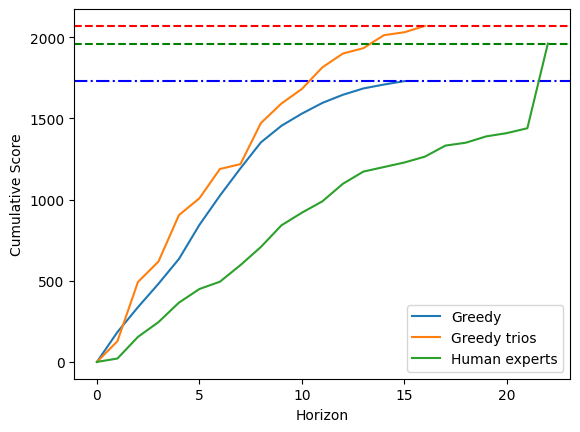

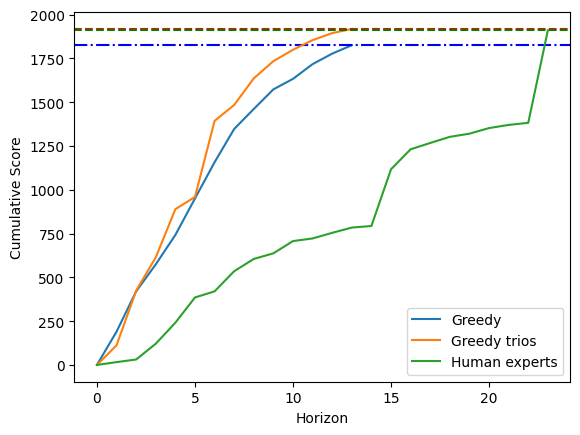

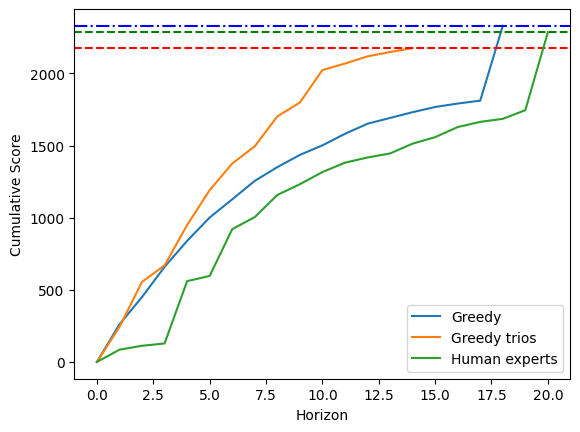

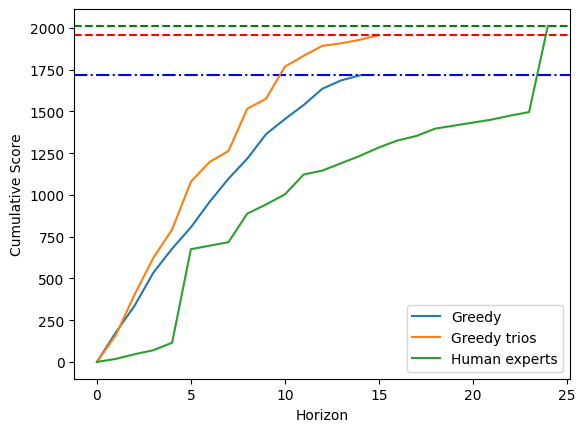

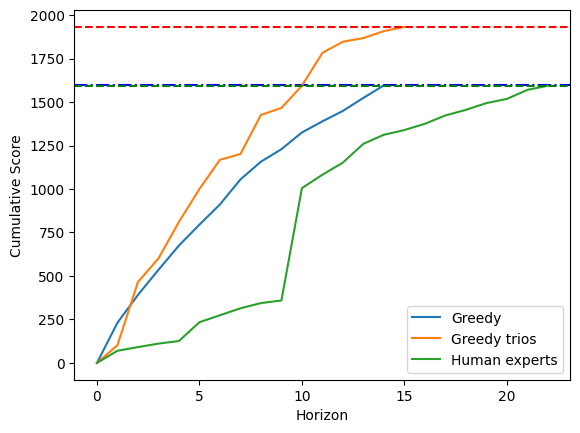

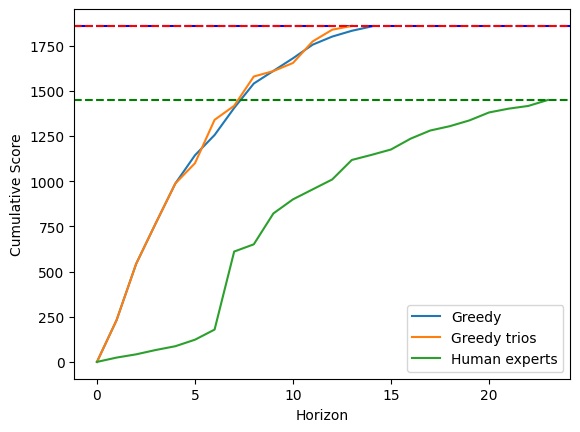

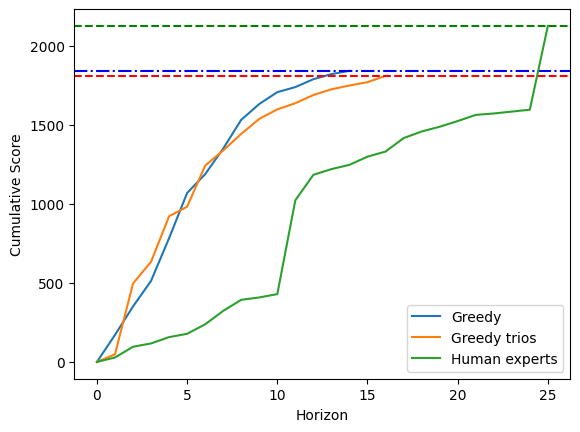

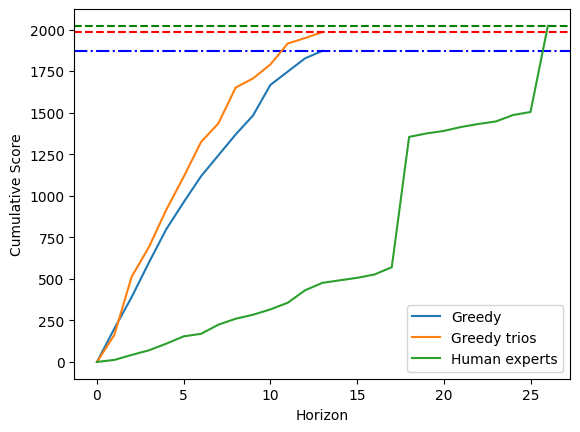

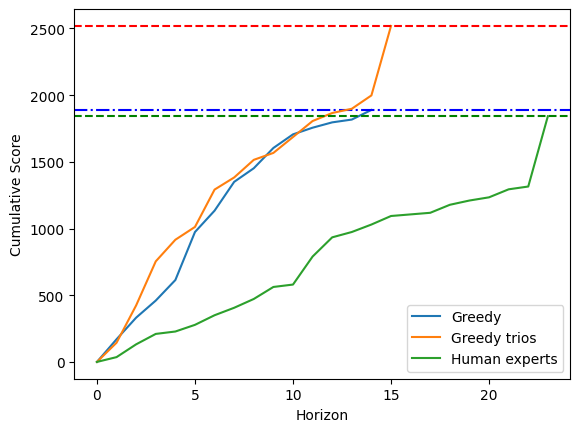

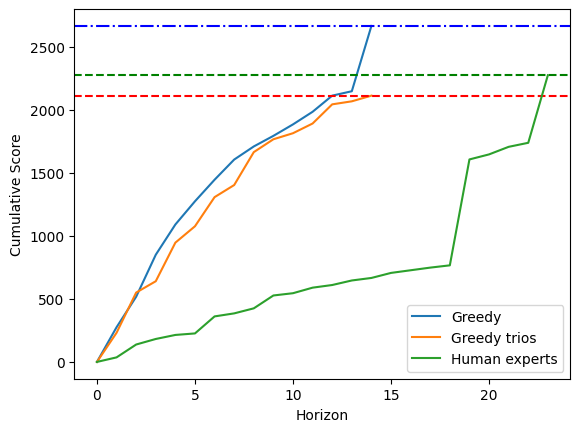

In [27]:
for i in range(10):
    plt.figure();
    plt.plot(range(len(cumulative_score_game_greedy[i])), cumulative_score_game_greedy[i], label="Greedy");
    plt.axhline(y=cumulative_score_game_greedy[i][-1], color='b', linestyle='-.');
    plt.plot(range(len(cumulative_score_game[i])), cumulative_score_game[i], label="Greedy trios");
    plt.axhline(y=cumulative_score_game[i][-1], color='r', linestyle='--');
    plt.plot(range(len(cumulative_score_human[i])), cumulative_score_human[i], label="Human experts");
    plt.axhline(y=cumulative_score_human[i][-1], color='g', linestyle='--');
    plt.xlabel("Horizon");
    plt.ylabel("Cumulative Score");
    plt.legend();
    plt.savefig(f"figure{i}.pdf")

In [35]:
B3 = []
for result in Best_result3:
    comb, score = result
    _ = 0
    for word in comb:
        _ += len(word)
    if _ == 108:
        B3.append((comb, score, 1))
    else:
        B3.append((comb, score, 0))

In [36]:
B3

[(['geolatry',
   'spiritualisms',
   'zerebas',
   'schnorkeled',
   'headnote',
   'endophagy',
   'joe',
   'bituminises',
   'whilom',
   'quoth',
   'whittle',
   'jumbo',
   'gox',
   'queen',
   'eft',
   'qua'],
  2069,
  0),
 (['studenty',
   'endoskeletons',
   'hairstreak',
   'gaillardias',
   'pulps',
   'phosphokinases',
   'dovecot',
   'toxaemia',
   'tampion',
   'crwth',
   'threw',
   'fusc',
   'bow'],
  1918,
  0),
 (['alluvials',
   'semiconductor',
   'mirzas',
   'whirligigs',
   'headworkers',
   'hairlock',
   'ironless',
   'whipsawed',
   'upwind',
   'mazourkas',
   'drupe',
   'uprun',
   'hip',
   'aff'],
  2175,
  0),
 (['quannets',
   'chalkface',
   'aftershaves',
   'coauthored',
   'bandolining',
   'popoffs',
   'cauld',
   'photoactive',
   'kavas',
   'zooecium',
   'witty',
   'curdy',
   'egg',
   'goy',
   'crue'],
  1957,
  0),
 (['lipide',
   'militarized',
   'inforced',
   'embarkment',
   'chainlets',
   'jahvism',
   'jog',
   'gazehound'

In [15]:
board = [
    ["c", "a", "k", "e"],
    ["d", "a", "m", "n"],
    ["l", "o", "o", "k"],
    ["w", "h", "e", "n"]
]
initial_state = WordSoup_state(board)

In [22]:
%%time
_ = ExhaustiveSearch(initial_state, step=3)
_

CPU times: user 10.8 s, sys: 62.5 ms, total: 10.8 s
Wall time: 11 s


In [26]:
_[0].word_lst

['nonmodal', 'eke', 'whack']